<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# DSI7 Capstone Project - Findings & Technical Report


---

## Index

- [Executive Summary](#executive-summary)
- [Model Walk-through](#model-walk-through)
- [Statistical Analysis](#statistical-analysis)
- [Appendix](#appendix)

<a id="executive-summary"></a>
## Executive Summary

### Goals

The Route Analysis Project is intended to provide an additional possible layer of information to route calculations and recommendations and ultimately recommend safer routes for drivers. Most navigation apps and websites focus on providing the shortest and fastest routes for users, taking into consideration distance, time and traffic. However, there’s another factor that might be of higher importance for users depending on city, time and mode of transport: route safety. In cities where driving is the principal method of transportation drivers need a reliable route recommendation that will avoid dangerous areas and roads, especially when the driver follows blindly the routes that navigation systems provide.

### Metrics and findings

This project takes into consideration two datasets: 
- Los Angeles Crime Data from 2010 to 2019: Used to obtain crime data and crime rates for crime risk calculation.
- Los Angeles City Driving Network: Used to obtain the edges (streets), nodes (intersections), directions, distances and travel time.

Both datasets are included in a network analysis that is used to provide routes to get from point A to point B that not only take into consideration the length of the route, but also the added factor of crime rate.

### Risks and challenges

<a id="model-walk-through"></a>
## Model Walk-through

### EDA

In [1]:
import numpy as np
import pandas as pd
import networkx as nx
import osmnx as ox
import geopandas as gpd
from shapely.geometry import Point, Polygon
import pyproj
import requests
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
from tqdm import tqdm
from ast import literal_eval
import seaborn as sns
from IPython.display import IFrame
import pickle
ox.config(use_cache=True, log_console=True)
ox.__version__

'0.8.2'

#### Los Angeles Crime Dataset from 2010 to 2019

**Initial Approach**

The first step taken when looking at the crime data to be used is understanding what the dataset includes in terms of size, features, datatypes, null values, among others. It's important to look at the datatype of each feature to make sure it makes sense and is as expected.

The most important features in the dataframe are the following:
- Date Occurred: Provides guidance as to which observations (crimes) are more recent and thus, more relevant.
- Time Occurred: Provides guidance as to which hours of the day are more dangerous and should add weight to the riskyness of certain roads.
- Crime Code Description: Provides guidance regarding the type of crime committed and which should be more relevant when determining the riskyness of a road.
- Location: Provides the location of a committed crime in terms of latitude and longitude and is used for determining which roads are more dangerous than others.

In [232]:
la_crime_2010 = pd.read_csv('/Users/jessicatong/Downloads/Crime_Data_from_2010_to_Present-2.csv')

In [233]:
la_crime_2010.shape

(1893805, 26)

In [234]:
la_crime_2010.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1893805 entries, 0 to 1893804
Data columns (total 26 columns):
DR Number                 int64
Date Reported             object
Date Occurred             object
Time Occurred             int64
Area ID                   int64
Area Name                 object
Reporting District        int64
Crime Code                int64
Crime Code Description    object
MO Codes                  object
Victim Age                float64
Victim Sex                object
Victim Descent            object
Premise Code              float64
Premise Description       object
Weapon Used Code          float64
Weapon Description        object
Status Code               object
Status Description        object
Crime Code 1              float64
Crime Code 2              float64
Crime Code 3              float64
Crime Code 4              float64
Address                   object
Cross Street              object
Location                  object
dtypes: float64(7), int64(5

In [235]:
la_crime_2010.head()

,DR Number,Date Reported,Date Occurred,Time Occurred,Area ID,Area Name,Reporting District,Crime Code,Crime Code Description,MO Codes,...,Weapon Description,Status Code,Status Description,Crime Code 1,Crime Code 2,Crime Code 3,Crime Code 4,Address,Cross Street,Location
0,1208575,03/14/2013,03/11/2013,1800,12,77th Street,1241,626,INTIMATE PARTNER - SIMPLE ASSAULT,0416 0446 1243 2000,...,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",AO,Adult Other,626.0,NaN,NaN,NaN,6300 BRYNHURST AV,NaN,"(33.9829, -118.3338)"
1,102005556,01/25/2010,01/22/2010,2300,20,Olympic,2071,510,VEHICLE - STOLEN,NaN,...,NaN,IC,Invest Cont,510.0,NaN,NaN,NaN,VAN NESS,15TH,"(34.0454, -118.3157)"
2,418,03/19/2013,03/18/2013,2030,18,Southeast,1823,510,VEHICLE - STOLEN,NaN,...,NaN,IC,Invest Cont,510.0,NaN,NaN,NaN,200 E 104TH ST,NaN,"(33.942, -118.2717)"
3,101822289,11/11/2010,11/10/2010,1800,18,Southeast,1803,510,VEHICLE - STOLEN,NaN,...,NaN,IC,Invest Cont,510.0,NaN,NaN,NaN,88TH,WALL,"(33.9572, -118.2717)"
4,42104479,01/11/2014,01/04/2014,2300,21,Topanga,2133,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329,...,NaN,IC,Invest Cont,745.0,NaN,NaN,NaN,7200 CIRRUS WY,NaN,"(34.2009, -118.6369)"


In [237]:
la_crime_2010.isnull().sum()

DR Number                       0
Date Reported                   0
Date Occurred                   0
Time Occurred                   0
Area ID                         0
Area Name                       0
Reporting District              0
Crime Code                      0
Crime Code Description        362
MO Codes                   203695
Victim Age                 149361
Victim Sex                 174355
Victim Descent             174397
Premise Code                   84
Premise Description          3232
Weapon Used Code          1261665
Weapon Description        1261666
Status Code                     2
Status Description              0
Crime Code 1                    8
Crime Code 2              1771539
Crime Code 3              1890852
Crime Code 4              1893714
Address                         0
Cross Street              1577680
Location                        9
dtype: int64

As shown above, there are several features of the dataframe that have null values for more than 50% or a significant portion of the observations. These features are not very relevant for the analysis performed in this project so they're removed from the dataframe. The remaining null values represent a very small percentage of total observations (<1%) and belong to features that are essencial for the model (location, crime description, among others) hence they will be dropped so no errors arrise from having null values in the data.

In [238]:
# Drop unnecessary features with null values

la_crime_2010.drop(columns=['MO Codes', 'Victim Age', 'Victim Sex', 'Victim Descent',
                         'Premise Code', 'Premise Description', 'Weapon Used Code',
                         'Weapon Description', 'Crime Code 1', 'Crime Code 2', 'Crime Code 3', 'Crime Code 4',
                         'Cross Street'],inplace=True)

In [245]:
# Drop remaining observations with null values

la_crime_2010.dropna(inplace=True)

In [246]:
# Check that no null values remain in the dataframe

la_crime_2010.isnull().sum()

dr_number                 0
date_reported             0
date_occurred             0
time_occurred             0
area_id                   0
area_name                 0
reporting_district        0
crime_code                0
crime_code_description    0
status_code               0
status_description        0
address                   0
location                  0
year_occurred             0
dtype: int64

The remaining columns are renamed for easier navigation by replacing spaces with under scores and uppercase letters for lowercase letters.

In [240]:
la_crime_2010.columns=['dr_number', 'date_reported', 'date_occurred', 'time_occurred', 
                       'area_id', 'area_name', 'reporting_district', 'crime_code', 
                       'crime_code_description', 'status_code', 'status_description', 'address', 'location']

A new column is added at the end of the dataframe that contains only the year in which the crime was committed. The purpose of the column is to make the navigation and subsetting of the dataframe easier.

In [242]:
la_crime_2010['year_occurred'] = [int(la_crime_2010.date_occurred[i][-4:]) for i in range(0,len(la_crime_2010))]

In [248]:
# Converting the year_occurred column to integer

la_crime_2010['year_occurred'] = [int(year) for year in la_crime_2010.year_occurred]

In [247]:
la_crime_2010.head()

,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred
0,1208575,03/14/2013,03/11/2013,1800,12,77th Street,1241,626,INTIMATE PARTNER - SIMPLE ASSAULT,AO,Adult Other,6300 BRYNHURST AV,"(33.9829, -118.3338)",2013
1,102005556,01/25/2010,01/22/2010,2300,20,Olympic,2071,510,VEHICLE - STOLEN,IC,Invest Cont,VAN NESS,"(34.0454, -118.3157)",2010
2,418,03/19/2013,03/18/2013,2030,18,Southeast,1823,510,VEHICLE - STOLEN,IC,Invest Cont,200 E 104TH ST,"(33.942, -118.2717)",2013
3,101822289,11/11/2010,11/10/2010,1800,18,Southeast,1803,510,VEHICLE - STOLEN,IC,Invest Cont,88TH,"(33.9572, -118.2717)",2010
4,42104479,01/11/2014,01/04/2014,2300,21,Topanga,2133,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),IC,Invest Cont,7200 CIRRUS WY,"(34.2009, -118.6369)",2014


In [550]:
la_crime_2010.columns

Index(['dr_number', 'date_reported', 'date_occurred', 'time_occurred',
       'area_id', 'area_name', 'reporting_district', 'crime_code',
       'crime_code_description', 'status_code', 'status_description',
       'address', 'location', 'year_occurred'],
      dtype='object')

In [551]:
la_crime_locations = la_crime_2010.drop(columns=['dr_number', 'date_reported',
       'area_id','status_code', 'status_description','address',])

In [576]:
la_crime_locations['loc'] = [literal_eval(x) for x in la_crime_2010['location']]

In [577]:
la_crime_locations['lat'] = [x for x,y in la_crime_locations['loc']]

In [578]:
la_crime_locations['lon'] = [y for x,y in la_crime_locations['loc']]

In [579]:
la_crime_locations.head()

,date_occurred,time_occurred,area_name,reporting_district,crime_code,crime_code_description,location,year_occurred,loc,lat,lon
0,03/11/2013,1800,77th Street,1241,626,INTIMATE PARTNER - SIMPLE ASSAULT,"(33.9829, -118.3338)",2013,"(33.9829, -118.3338)",33.9829,-118.3338
1,01/22/2010,2300,Olympic,2071,510,VEHICLE - STOLEN,"(34.0454, -118.3157)",2010,"(34.0454, -118.3157)",34.0454,-118.3157
2,03/18/2013,2030,Southeast,1823,510,VEHICLE - STOLEN,"(33.942, -118.2717)",2013,"(33.942, -118.2717)",33.9420,-118.2717
3,11/10/2010,1800,Southeast,1803,510,VEHICLE - STOLEN,"(33.9572, -118.2717)",2010,"(33.9572, -118.2717)",33.9572,-118.2717
4,01/04/2014,2300,Topanga,2133,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),"(34.2009, -118.6369)",2014,"(34.2009, -118.6369)",34.2009,-118.6369


In [580]:
la_crime_locations.to_csv('la_crime_locations.csv')

In [ ]:
# Add graphs to visualize the distribution of crimes in LA, correlation between time/hour of the day and # of crimes

**Subset the dataframe**

The latest dataframe (la_crime_2010) consists of approximately 1.8 million observations, which will be inconvenient for the initial modeling phases since the size of it will cause functions to run extremelly slow. For this reason, subsets of the dataframe have to be created to develop the model and, once the model is finished, apply it to the entire dataset. The dataframe will be subsetted based on two factors: Year in which the crime occured and type of crime committed.

*1. Year of crime committed:*

The crime dataset will be further subset in two groups:

- Crimes committed from 2017 to 2019:

In [249]:
# Subset the dataframe

la_crime_2017 = la_crime_2010[la_crime_2010['year_occurred']>=2017]

In [250]:
# Review number of observations per year

la_crime_2017.year_occurred.value_counts()

2017    230930
2018    225344
2019       986
Name: year_occurred, dtype: int64

In [251]:
# Save the new dataset to a .csv file

la_crime_2017.to_csv('la_crime_2017.csv')

In [264]:

la_crime_2017_new = pd.read_csv('./la_crime_2017.csv')

In [265]:
la_crime_2017_new.head()

,Unnamed: 0,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred
0,1308849,170209449,04/22/2017,04/21/2017,1930,2,Rampart,201,510,VEHICLE - STOLEN,IC,Invest Cont,ALEXANDRIA,"(34.0886, -118.2979)",2017
1,1382571,170206243,02/14/2017,02/11/2017,1700,2,Rampart,275,510,VEHICLE - STOLEN,IC,Invest Cont,OLYMPIC,"(34.0512, -118.2787)",2017
2,1383139,170311599,04/25/2017,04/25/2017,745,3,Southwest,325,510,VEHICLE - STOLEN,IC,Invest Cont,VERMONT,"(34.0328, -118.2915)",2017
3,1383420,170408264,04/07/2017,04/07/2017,1,4,Hollenbeck,421,510,VEHICLE - STOLEN,IC,Invest Cont,ALHAMBRA,"(34.0676, -118.2202)",2017
4,1383515,170508584,04/10/2017,04/08/2017,730,5,Harbor,566,510,VEHICLE - STOLEN,IC,Invest Cont,10TH,"(33.7347, -118.2842)",2017


- Crimes committed from 2018 to 2019:

This subset was created since the crime data from 2017 to 2019 subset was too big to add to the network analysis that will be performed.

In [283]:
# Subset the dataframe

la_crime_2018 = la_crime_2010[la_crime_2010['year_occurred']>=2018]

In [284]:
# Review number of observations per year

la_crime_2018.year_occurred.value_counts()

2018    225344
2019       986
Name: year_occurred, dtype: int64

In [286]:
# Save the new dataset to a .csv file

la_crime_2018.to_csv('la_crime_2018.csv')

In [287]:
la_crime_2018_new = pd.read_csv('./la_crime_2018.csv')

In [288]:
la_crime_2018_new.head()

,Unnamed: 0,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred
0,1614213,170326543,04/13/2018,04/13/2018,1955,7,Wilshire,776,510,VEHICLE - STOLEN,IC,Invest Cont,LOMITA,"(34.0459, -118.3374)",2018
1,1640525,171616979,02/25/2018,02/25/2018,940,16,Foothill,1698,510,VEHICLE - STOLEN,AO,Adult Other,ARMINTA,"(34.2141, -118.3604)",2018
2,1649274,180404084,01/03/2018,01/01/2018,2200,4,Hollenbeck,461,510,VEHICLE - STOLEN,IC,Invest Cont,1600 E 3RD ST,"(34.0452, -118.223)",2018
3,1649528,181204193,01/03/2018,01/02/2018,1930,12,77th Street,1239,510,VEHICLE - STOLEN,IC,Invest Cont,1100 W 60TH PL,"(33.985, -118.2937)",2018
4,1650014,180104010,01/01/2018,01/01/2018,250,1,Central,157,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,5TH ST,"(34.0435, -118.2427)",2018


In [ ]:
# Consider adding graphs that show how crimes vary from year to year

*2. Type of crime committed:* 

The crime dataset includes all crimes committed in Los Angeles, California since 2010, not only crimes that are relevant for the analysis of how risky roads really for the purpose of driving. Because of this, all crime descriptions are used to classify the entire dataset into 4 categories:
- crime_risk_0: crime descriptions that have no effect on road safety; assigned risk factor: 0.
- crime_risk_1: crime descriptions that have low impact on road safety; assigned risk factor: 1.
- crime_risk_2: crime descriptions that have medium impact on road safety; assigned risk factor: 2.
- crime_risk_3: crime descriptions that have high impact on road safety; assigned risk factor: 3.

In [311]:
crime_risk_0 = {'crime': ['VANDALISM - MISDEAMEANOR ($399 OR UNDER)','THROWING OBJECT AT MOVING VEHICLE',
                          'OTHER MISCELLANEOUS CRIME','INDECENT EXPOSURE','BOMB SCARE','EXTORTION','DISTURBING THE PEACE',
                          'CRUELTY TO ANIMALS','SEXUAL PENTRATION WITH A FOREIGN OBJECT','THEFT OF IDENTITY',
                          'VIOLATION OF COURT ORDER','LETTERS, LEWD','FALSE IMPRISONMENT','LEWD CONDUCT','PROWLER','PIMPING',
                          'BEASTIALITY, CRIME AGAINST NATURE SEXUAL ASSLT WITH ANIM0065','PEEPING TOM','SEX, UNLAWFUL',
                          'ORAL COPULATION','THREATENING PHONE CALLS/LETTERS','DISHONEST EMPLOYEE - PETTY THEFT',
                          'UNAUTHORIZED COMPUTER ACCESS','BUNCO, ATTEMPT','BRIBERY','CREDIT CARDS, FRAUD USE ($950 & UNDER',
                          'PICKPOCKET, ATTEMPT','FALSE POLICE REPORT','ABORTION/ILLEGAL','CONTRIBUTING','DISRUPT SCHOOL',
                          'FAILURE TO DISPERSE','CONTEMPT OF COURT','BIGAMY','DOCUMENT WORTHLESS ($200 & UNDER)',
                          'DISHONEST EMPLOYEE ATTEMPTED THEFT','INCEST (SEXUAL ACTS BETWEEN BLOOD RELATIVES)',
                          'CHILD ABUSE (PHYSICAL) - SIMPLE ASSAULT','SEX,UNLAWFUL(INC MUTUAL CONSENT, PENETRATION W/ FRGN OBJ0059',
                          'REPLICA FIREARMS(SALE,DISPLAY,MANUFACTURE OR DISTRIBUTE)',
                          'LETTERS, LEWD  -  TELEPHONE CALLS, LEWD','SEXUAL PENETRATION W/FOREIGN OBJECT','STALKING',
                          'DOCUMENT FORGERY / STOLEN FELONY','RESISTING ARREST','COUNTERFEIT',
                          'REPLICA FIREARMS(SALE,DISPLAY,MANUFACTURE OR DISTRIBUTE)0132',
                          'DEFRAUDING INNKEEPER/THEFT OF SERVICES, $400 & UNDER',
                          'CRIMINAL THREATS - NO WEAPON DISPLAYED',
                          'VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS) 0114',
                          'CHILD NEGLECT (SEE 300 W.I.C.)','CHILD ANNOYING (17YRS & UNDER)',
                          'SEXUAL PENTRATION WITH A FOREIGN OBJECT','PICKPOCKET',
                          'CRM AGNST CHLD (13 OR UNDER) (14-15 & SUSP 10 YRS OLDER)0060',
                          'CREDIT CARDS, FRAUD USE ($950.01 & OVER)','SHOPLIFTING - ATTEMPT','ILLEGAL DUMPING',
                          'CRM AGNST CHLD (13 OR UNDER) (14-15 & SUSP 10 YRS OLDER)','PURSE SNATCHING - ATTEMPT',
                          'DISHONEST EMPLOYEE - GRAND THEFT','INTIMATE PARTNER - AGGRAVATED ASSAULT',
                          'INTIMATE PARTNER - SIMPLE ASSAULT','DEFRAUDING INNKEEPER/THEFT OF SERVICES, OVER $400',
                          'THEFT, COIN MACHINE - PETTY ($950 & UNDER)','LEWD/LASCIVIOUS ACTS WITH CHILD',
                          'BOAT - STOLEN','INCITING A RIOT','PANDERING','LYNCHING - ATTEMPTED','CONSPIRACY',
                          'CHILD ABANDONMENT','CONTEMPT OF COURT','GRAND THEFT / INSURANCE FRAUD','LYNCHING',
                          'CHILD ABUSE (PHYSICAL) - AGGRAVATED ASSAULT','DRUNK ROLL - ATTEMPT','ATTEMPTED ROBBERY',
                          'SODOMY/SEXUAL CONTACT B/W PENIS OF ONE PERS TO ANUS OTH','CHILD PORNOGRAPHY','TRESPASSING',
                          'EMBEZZLEMENT, PETTY THEFT ($950 & UNDER)','FIREARMS RESTRAINING ORDER (FIREARMS RO)',
                          'BEASTIALITY, CRIME AGAINST NATURE SEXUAL ASSLT WITH ANIM',
                          'EMBEZZLEMENT, GRAND THEFT ($950.01 & OVER)'],'risk':0}
crime_risk_1 = {'crime': ['SHOPLIFTING - PETTY THEFT ($950 & UNDER)','BIKE - STOLEN','BURGLARY','OTHER ASSAULT',
                          'THEFT PLAIN - ATTEMPT','BRANDISH WEAPON','ARSON','BURGLARY, ATTEMPTED','BUNCO, GRAND THEFT',
                          'BIKE - ATTEMPTED STOLEN','THEFT FROM PERSON - ATTEMPT','DRIVING WITHOUT OWNER CONSENT (DWOC)',
                          'KIDNAPPING - GRAND ATTEMPT','RECKLESS DRIVING','TRAIN WRECKING','DRUGS, TO A MINOR',
                          'TELEPHONE PROPERTY - DAMAGE','TILL TAP - ATTEMPT','THEFT, COIN MACHINE - ATTEMPT',
                          'VANDALISM - FELONY ($400 & OVER, ALL CHURCH VANDALISMS)',
                          'SODOMY/SEXUAL CONTACT B/W PENIS OF ONE PERS TO ANUS OTH 0007=02'],'risk':1}
crime_risk_2 = {'crime': ['THEFT PLAIN - PETTY ($950 & UNDER)','BATTERY - SIMPLE ASSAULT','ROBBERY',
                          'BURGLARY FROM VEHICLE','TILL TAP - PETTY ($950 & UNDER)',
                          'SHOPLIFTING-GRAND THEFT ($950.01 & OVER)','THEFT, PERSON','BATTERY POLICE (SIMPLE)',
                          'BURGLARY FROM VEHICLE, ATTEMPTED','KIDNAPPING','CHILD STEALING',
                          'WEAPONS POSSESSION/BOMBING','DRUNK ROLL','VEHICLE - ATTEMPT STOLEN',
                          'THEFT, COIN MACHINE - GRAND ($950.01 & OVER)','PETTY THEFT - AUTO REPAIR'],'risk':2}
crime_risk_3 = {'crime': ['VANDALISM - MISDEAMEANOR ($399 OR UNDER)',
                          'THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LIVESTK,PROD0036', 
                          'ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT','BATTERY WITH SEXUAL CONTACT',
                          'RAPE, FORCIBLE','THEFT FROM MOTOR VEHICLE - GRAND ($400 AND OVER)',
                          'SHOTS FIRED AT INHABITED DWELLING','THEFT FROM MOTOR VEHICLE - PETTY ($950 & UNDER)',
                          'DISCHARGE FIREARMS/SHOTS FIRED','ASSAULT WITH DEADLY WEAPON ON POLICE OFFICER',
                          'SHOTS FIRED AT MOVING VEHICLE, TRAIN OR AIRCRAFT','GRAND THEFT / AUTO REPAIR',
                          'MANSLAUGHTER, NEGLIGENT','TILL TAP - GRAND THEFT ($950.01 & OVER)',
                          'THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LIVESTK,PROD','VEHICLE - STOLEN',
                          'HUMAN TRAFFICKING - INVOLUNTARY SERVITUDE','HUMAN TRAFFICKING - COMMERCIAL SEX ACTS'],'risk':3}

In [312]:
# With a for loop, add a column to each of the dataframes (2017 and 2018) that includes the risk level per 
# crime committed.

crime_risk_list = []
for crime in tqdm(la_crime_2017_new['crime_code_description']):
    if crime in crime_risk_0['crime']:
        crime_risk_list.append(crime_risk_0['risk'])
    elif crime in crime_risk_1['crime']:
        crime_risk_list.append(crime_risk_1['risk'])
    elif crime in crime_risk_2['crime']:
        crime_risk_list.append(crime_risk_2['risk'])
    elif crime in crime_risk_3['crime']:
        crime_risk_list.append(crime_risk_3['risk'])
    else:
        crime_risk_list.append(crime_risk_1['risk'])
la_crime_2017_new['crime_risk'] = crime_risk_list











  0%|          | 0/457260 [00:00<?, ?it/s]









  0%|          | 1/457260 [00:00<90:11:23,  1.41it/s]









  6%|▋         | 28995/457260 [00:00<59:07:47,  2.01it/s]









 16%|█▌        | 72440/457260 [00:00<37:11:31,  2.87it/s]









 24%|██▍       | 110339/457260 [00:01<23:28:14,  4.11it/s]









 35%|███▌      | 160481/457260 [00:01<14:03:17,  5.87it/s]









 46%|████▋     | 211700/457260 [00:01<8:08:25,  8.38it/s] 









 57%|█████▋    | 261539/457260 [00:01<4:32:30, 11.97it/s]









 67%|██████▋   | 305432/457260 [00:01<2:27:58, 17.10it/s]









 78%|███████▊  | 355968/457260 [00:01<1:09:06, 24.43it/s]









 89%|████████▊ | 405641/457260 [00:01<24:39, 34.90it/s]  









100%|██████████| 457260/457260 [00:01<00:00, 267659.10it/s]

In [313]:
la_crime_2017_risk = la_crime_2017_new[la_crime_2017_new['crime_risk'] >= 1]

In [314]:
len(la_crime_2017_risk)

319066

In [315]:
la_crime_2017_risk.to_csv('la_crime_2017_fv.csv')

In [296]:
la_crime_2018_new.crime_risk.value_counts()

2    83986
0    62674
1    43572
3    36098
Name: crime_risk, dtype: int64

In [588]:
la_crime_2018_risk2 = la_crime_2018_new[la_crime_2018_new['crime_risk'] >= 1]

In [589]:
la_crime_2018_risk2.to_csv('la_crime_2018_fv2.csv')

In [590]:
la_crime_2018_risk2.tail()

,Unnamed: 0,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred,crime_risk
226324,1893799,192104096,01/03/2019,12/04/2018,1335,21,Topanga,2177,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,5700 OWENSMOUTH AV,"(34.1744, -118.6016)",2018,2
226325,1893800,192104101,01/03/2019,01/03/2019,500,21,Topanga,2103,310,BURGLARY,IC,Invest Cont,22400 MALDEN ST,"(34.2236, -118.6158)",2019,1
226326,1893801,192104103,01/03/2019,01/03/2019,446,21,Topanga,2134,310,BURGLARY,IC,Invest Cont,22200 SHERMAN WY,"(34.201, -118.6103)",2019,1
226327,1893802,192104105,01/03/2019,01/03/2019,1905,21,Topanga,2189,310,BURGLARY,IC,Invest Cont,20000 WELLS DR,"(34.1648, -118.5771)",2019,1
226328,1893803,192104109,01/04/2019,01/04/2019,700,21,Topanga,2129,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,19800 STAGG ST,"(34.2108, -118.5648)",2019,2


In [591]:
la_crime_2018_risk2.columns

Index(['Unnamed: 0', 'dr_number', 'date_reported', 'date_occurred',
       'time_occurred', 'area_id', 'area_name', 'reporting_district',
       'crime_code', 'crime_code_description', 'status_code',
       'status_description', 'address', 'location', 'year_occurred',
       'crime_risk'],
      dtype='object')

In [592]:
la_crime_locations = la_crime_2018_risk2.drop(columns=['Unnamed: 0', 'dr_number', 'date_reported', 'date_occurred',
       'time_occurred', 'reporting_district', 'status_code',
       'status_description', 'address', 'nearest_node', 'node_only', 'distance_only'])

KeyError: "labels ['nearest_node' 'node_only' 'distance_only'] not contained in axis"

In [583]:
la_crime_locations['loc'] = [literal_eval(x) for x in la_crime_2018_risk2['location']]

In [584]:
la_crime_locations['lat'] = [x for x,y in la_crime_locations['loc']]

In [585]:
la_crime_locations['lon'] = [y for x,y in la_crime_locations['loc']]

In [586]:
la_crime_locations.head()

,area_id,area_name,crime_code,crime_code_description,location,year_occurred,crime_risk,loc,lat,lon
0,7,Wilshire,510,VEHICLE - STOLEN,"(34.0459, -118.3374)",2018,2,"(34.0459, -118.3374)",34.0459,-118.3374
1,16,Foothill,510,VEHICLE - STOLEN,"(34.2141, -118.3604)",2018,2,"(34.2141, -118.3604)",34.2141,-118.3604
2,4,Hollenbeck,510,VEHICLE - STOLEN,"(34.0452, -118.223)",2018,2,"(34.0452, -118.223)",34.0452,-118.2230
3,12,77th Street,510,VEHICLE - STOLEN,"(33.985, -118.2937)",2018,2,"(33.985, -118.2937)",33.9850,-118.2937
4,1,Central,440,THEFT PLAIN - PETTY ($950 & UNDER),"(34.0435, -118.2427)",2018,2,"(34.0435, -118.2427)",34.0435,-118.2427


In [587]:
la_crime_locations.to_csv('la_crime_locations.csv')

In [ ]:
la_crime_locations = la_crime_2010.drop(columns=['dr_number', 'date_reported',
       'area_id','status_code', 'status_description','address',])

la_crime_locations['loc'] = [literal_eval(x) for x in la_crime_2010['location']]

la_crime_locations['lat'] = [x for x,y in la_crime_locations['loc']]

la_crime_locations['lon'] = [y for x,y in la_crime_locations['loc']]

la_crime_locations.head()

la_crime_locations.to_csv('la_crime_locations.csv')

#### Los Angeles Road Network

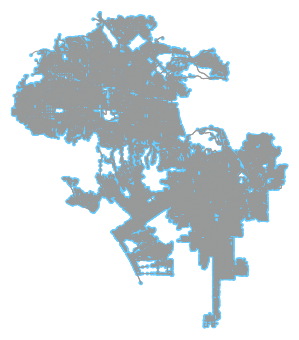

In [3]:
LA = ox.graph_from_place('Los Angeles, California, USA', network_type='drive')
fig, ax = ox.plot_graph(LA)

In [340]:
LA_network = pd.DataFrame(list(LA.edges()),columns=['start_node','end_node'])

In [341]:
LA_network['edge'] = [(LA_network.start_node[i],LA_network.end_node[i]) for i in range(0,len(LA_network))]

In [345]:
LA_network['edge_crime'] = (LA_network['start_node_weight'] + LA_network['end_node_weight'])/2

In [343]:
LA_network['start_node_weight'] = 1

In [344]:
LA_network['end_node_weight'] = 1

In [346]:
LA_network.head()

,start_node,end_node,edge,edge_crime,start_node_weight,end_node_weight
0,122814468,122814472,"(122814468, 122814472)",1.0,1,1
1,122814468,123152289,"(122814468, 123152289)",1.0,1,1
2,122814468,122659220,"(122814468, 122659220)",1.0,1,1
3,1842872326,1842872352,"(1842872326, 1842872352)",1.0,1,1
4,1842872326,1842872317,"(1842872326, 1842872317)",1.0,1,1


<a id="statistical-analysis"></a>
## Statistical Analysis

### Model Selection: Network Analysis

In [3]:
# Start and end point
start = (34.223756, -118.526886)
end = (34.045628, -118.423420)
center = ((start[0]+end[0])/2, (start[1]+end[1])/2)

In [1]:
class RouteModel:
    from ast import literal_eval
    
    def __init__(self, start_latlong, end_latlong, route_safety_importance):
        '''
        
        
        Inputs
        ----------------
        start_latlong: tuple, (lat, long) signifying route start location.
        end_latlong: tuple, (lat, long) signifying route end location.
        route_safety_importance: float, between 0.0 and 1.0, 0.0 for no importance to 
        safety, 1.0 for full safety importance.
        '''
        self.safety = route_safety_importance
        self.start = start_latlong
        self.end = end_latlong
        self.center = ((self.start[0]+self.end[0])/2, (self.start[1]+self.end[1])/2)
        
        # Use the latitude and longitude of the start and end points to create a boundary box that uses the further 
        # north, south, east and west latitude and longitude plus a proportional buffer to create a smaller graph for
        # displaying the routes calculated
        
        if self.start[0]<self.end[0]:
            s_edge = self.start[0] - (self.end[0]-self.start[0])*0.1
            n_edge = self.end[0] + (self.end[0]-self.start[0])*0.1
        else:
            n_edge = self.start[0] + (self.start[0]-self.end[0])*0.1
            s_edge = self.end[0] - (self.start[0]-self.end[0])*0.1
        if self.start[1]<self.end[1]:
            w_edge = self.start[1] - (self.end[1]-self.start[1])*0.1
            e_edge = self.end[1] + (self.end[1]-self.start[1])*0.1
        else:
            e_edge = self.start[1] + (self.start[1]-self.end[1])*0.1
            w_edge = self.end[1] - (self.start[1]-self.end[1])*0.1 

        self.bbox = (n_edge,s_edge,e_edge,w_edge)
        
        geom = [Point(xy) for xy in [self.start, self.end, self.center]]
        gdf = gpd.GeoDataFrame(geometry=geom,crs={'init':'epsg:4326'})
        gdf.index = ['start', 'end', 'center']
        
        wgs84 = pyproj.Proj(init='epsg:4326')
        utm10s = pyproj.Proj(init='epsg:32611')

        utf_coords = []
        for lat, long in [x.coords[0] for x in gdf.geometry]:
            c = pyproj.transform(wgs84, utm10s, long, lat)
            utf_coords.append(Point(c))

        gdf = gpd.GeoDataFrame(geometry=utf_coords,crs={'init':'epsg:32611'})
        gdf.index = ['start', 'end', 'center']
        
        s_dist = []
        e_dist = []
        c_dist = []

        for x in gdf.index:
            for y in gdf.index:
                if x=='start':
                    s_dist.append(gdf.loc[x, 'geometry'].distance(gdf.loc[y, 'geometry']))
                elif x=='end':
                    e_dist.append(gdf.loc[x, 'geometry'].distance(gdf.loc[y, 'geometry']))
                else:
                    c_dist.append(gdf.loc[x, 'geometry'].distance(gdf.loc[y, 'geometry']))

        gdf['dist_to_start'] = s_dist
        gdf['dist_to_end'] = e_dist
        gdf['dist_to_center'] = c_dist
        
        self.map_extent = gdf['dist_to_center']['start'] + 500
        
        self.weights = pd.read_csv('./LA_weights.csv')
        self.weights.edge = [literal_eval(x) for x in self.weights.edge]
        
        with open('la_graph.pkl', 'rb') as f:
            self.G = pickle.load(f)
    
        for start_, end_ in list(self.weights.edge):
            self.G[start_][end_][0]['weight']=(self.G[start_][end_][0]['crime_risk']*self.safety) + self.G[start_][end_][0]['length']
    
    def plot_map_extent(self):
    # Plots the reduced graph using the created boundary box with the start and end points
        fig, ax = ox.plot_graph(self.G,bbox=self.bbox, fig_height=10)
        plt.show()
            
    def plot_shortest_route(self):
    # Calculates the shortest route from start point to end point taking only the length of the edges as the weight
    # and plots the route on the reduced graph using the boundary box
        orig_node = ox.get_nearest_node(self.G, self.start)
        dest_node = ox.get_nearest_node(self.G, self.end)
        route = nx.shortest_path(self.G, orig_node, dest_node, weight='length')
        #print('Path Length:',nx.shortest_path_length(self.G, orig_node, dest_node, weight='length'))
        fig, ax = ox.plot_graph_route(self.G, route,bbox=self.bbox, node_size=0, fig_height=15)
        plt.show()      
    
    def plot_safety_weighted_route(self):
    # Calculates the shortest route from start point to end point using the safety risk, safety factor and length as 
    # the weight and plots the route on the reduced graph using the boundary box
        
        orig_node = ox.get_nearest_node(self.G, self.start)
        dest_node = ox.get_nearest_node(self.G, self.end)
        
        route = nx.shortest_path(self.G, 
                                 orig_node, 
                                 dest_node, 
                                 weight='weight')
        #print('Path Length:',nx.shortest_path_length(self.G, orig_node, dest_node, weight='weight'))
        fig, ax = ox.plot_graph_route(self.G,route, bbox=self.bbox,node_size=0, fig_height=15)
        plt.show()
        
    def plot_two_routes(self):
    # Plots the shortest route and safest route on the same map for comparison purposes and prints the total length of
    # both routes
        
        orig_node = ox.get_nearest_node(self.G, self.start)
        dest_node = ox.get_nearest_node(self.G, self.end)
        route1 = nx.shortest_path(self.G, orig_node, dest_node, weight='length')
        route2 = nx.shortest_path(self.G, 
                                 orig_node, 
                                 dest_node, 
                                 weight='weight')

        
        print('Shortest Path Length:',nx.shortest_path_length(self.G, orig_node, dest_node, weight='length'))
        print('Safer Path Length:',nx.shortest_path_length(self.G, orig_node, dest_node, weight='weight'))
              
        rc1 = ['r'] * (len(route1) - 1)
        rc2 = ['b'] * len(route2)
        rc = rc1 + rc2
        nc = ['r', 'r', 'b', 'b']

        # plot the routes
        fig, ax = ox.plot_graph_routes(self.G, [route1, route2],bbox=self.bbox,
                                       route_color=rc, orig_dest_node_color=nc, node_size=0,fig_height=15)

In [6]:
test = RouteModel(start_latlong=start,end_latlong=end,
                   route_safety_importance=0.1)

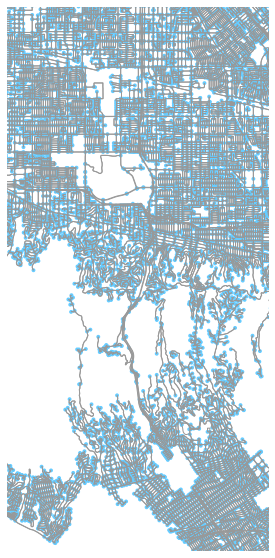

In [7]:
test.plot_map_extent()

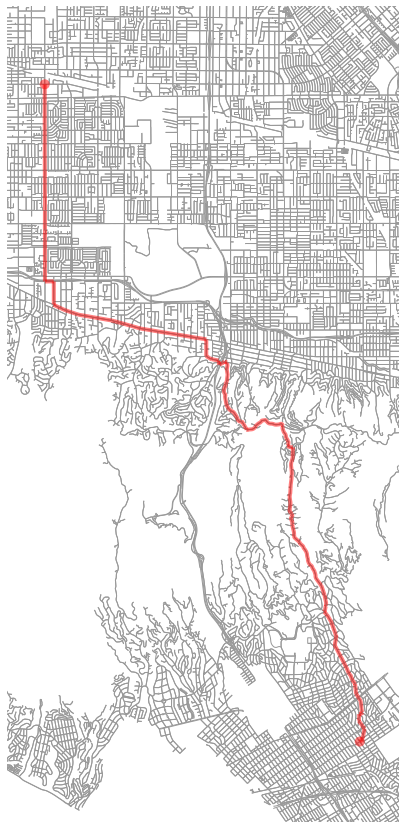

In [8]:
test.plot_shortest_route()

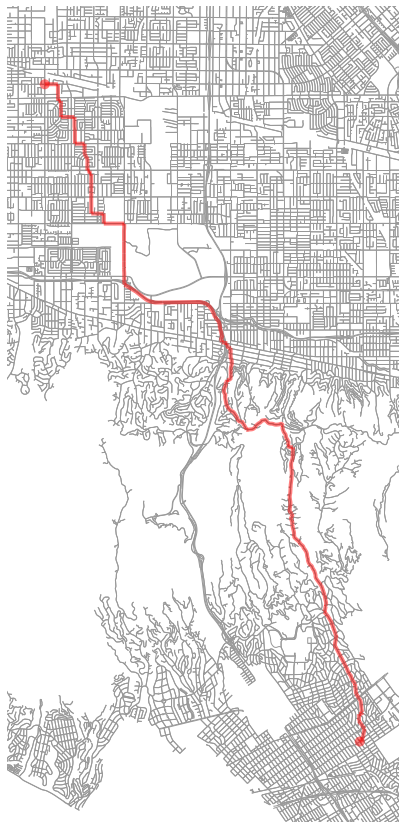

In [9]:
test.plot_safety_weighted_route()

In [19]:
print(test.G)

Los Angeles, California, USA


In [23]:
for i in test.G:
    for j in test.G[i]:
        print(test.G[i][j][0]['length'])

402.498
101.19
99.24300000000001
79.733
34.577
402.498
49.204
101.221
93.142
108.545
116.61099999999999
98.225
41.451
75.083
49.025000000000006
41.451
16.476
79.733
178.84199999999998
16.476
112.166
111.84299999999999
150.226
115.562
338.79999999999995
38.081
216.371
67.158
221.768
271.44499999999994
202.939
202.20999999999998
116.121
113.994
45.416
39.124
508.465
16.181
258.426
251.72
201.808
201.82
113.994
113.17500000000001
164.181
136.924
158.704
210.078
107.64500000000001
119.965
112.926
203.03
15.813
408.41400000000004
151.012
176.54000000000002
466.81600000000003
138.467
47.621
90.55000000000001
202.14100000000002
557.476
98.422
100.626
56.753
31.937
203.588
103.608
123.02
90.55000000000001
103.608
38.651
108.51400000000001
190.305
79.055
161.785
104.39
108.51400000000001
138.467
118.421
10.756
86.268
78.22
96.662
95.65700000000001
189.555
78.22
70.286
93.095
102.702
103.89
200.352
202.021
93.017
205.648
227.966
93.144
101.921
99.114
198.623
202.762
103.556
101.921
199.49
202.63

62.548
80.741
114.469
202.03500000000003
109.30799999999999
119.60300000000001
202.32
119.60300000000001
111.851
119.35400000000001
249.803
32.817
184.35299999999998
201.452
113.39099999999999
79.413
39.326
50.534
83.862
133.689
189.53199999999998
35.772
156.733
66.041
247.455
56.802
66.041
56.802
32.196
60.782
1142.6519999999998
56.013000000000005
56.352000000000004
84.766
99.83
224.22199999999998
65.803
25.597
224.22199999999998
80.65299999999999
247.94599999999997
301.461
45.11
61.376000000000005
32.595
205.0
44.934
61.376000000000005
111.326
44.934
61.432
204.41
61.432
107.033
78.359
100.331
40.779
204.399
77.709
107.03299999999999
108.316
77.709
21.704
205.382
21.704
104.013
59.393
37.039
103.697
377.497
103.76400000000001
100.245
91.775
251.345
403.089
98.949
100.245
70.117
57.562
204.482
227.906
144.466
96.919
233.274
86.401
404.172
102.11500000000001
201.458
98.949
106.64
96.919
102.154
106.64
90.154
125.364
405.6
90.723
107.94200000000001
533.3
70.376
79.276
201.458
202.202999

233.175
112.114
98.318
221.613
234.25400000000002
177.891
221.613
111.752
98.557
12.322
63.681000000000004
111.56
99.209
177.891
180.325
112.063
200.609
97.724
180.325
164.741
20.068
132.17000000000002
20.068
111.371
98.902
200.1
200.609
200.1
98.677
109.646
203.732
82.971
97.212
201.86399999999998
96.243
203.966
201.86399999999998
32.196
247.699
75.702
62.069
200.107
100.33
111.186
139.573
62.069
182.965
56.878
54.152
152.741
135.781
276.83799999999997
206.192
358.212
164.899
47.782
106.185
107.043
202.39800000000002
106.185
103.71600000000001
108.21300000000001
196.798
102.867
109.783
202.39800000000002
196.798
73.971
56.878
41.525
71.759
307.67099999999994
307.67100000000005
229.292
90.215
198.47799999999998
169.22
272.67
229.29199999999997
191.478
272.67
109.379
99.578
309.312
71.233
70.535
309.312
222.007
53.979
25.766
109.436
100.494
171.528
165.00900000000001
97.148
217.962
103.738
104.456
855.491
216.43
235.733
81.474
25.393
104.233
220.674
50.811
103.62700000000001
204.8760000

175.317
80.844
82.74799999999999
84.937
299.847
300.88200000000006
84.986
14.16
125.626
106.165
353.88
60.83799999999999
741.6800000000001
14.995
300.88200000000006
106.416
235.679
93.877
156.347
94.45400000000001
76.773
90.03399999999999
578.5369999999999
469.593
235.679
223.92399999999998
92.72
110.21499999999999
65.066
159.05
80.554
238.879
223.92399999999998
86.039
144.893
625.773
76.773
44.158
159.05
32.936
89.504
53.76
53.76
76.626
123.281
130.616
130.616
152.868
268.033
100.61699999999999
43.328
259.46
65.69800000000001
72.06200000000001
28.637
158.332
220.061
83.838
390.05899999999997
104.18100000000001
223.804
220.061
234.472
140.827
63.459
16.942
97.021
223.804
100.575
212.512
399.039
215.161
8.189
132.848
47.246
309.556
416.981
99.494
80.101
223.534
107.761
78.451
215.161
217.096
402.59799999999996
67.208
80.101
98.844
140.466
48.254
400.98
217.096
140.466
5.059
103.337
387.18600000000004
299.59
60.083
48.254
271.536
401.897
76.88
78.138
8.771
76.88
363.03499999999997
401.84

129.179
46.893
79.239
78.669
46.893
83.80699999999999
55.746
126.918
230.341
200.673
201.325
100.42099999999999
100.565
202.169
200.673
98.24600000000001
104.72399999999999
112.886
96.225
147.443
112.886
202.169
100.528
103.114
200.803
80.52499999999999
122.062
70.656
54.823
75.561
76.156
80.525
463.97799999999995
62.773
54.823
130.061
111.979
176.288
196.548
99.477
191.822
179.936
39.736
75.614
75.614
187.93599999999998
154.808
94.194
69.111
101.728
296.07599999999996
305.49
94.194
77.159
158.394
142.994
49.332
105.676
100.458
12.968
296.076
100.047
101.701
100.254
199.978
142.994
100.165
199.978
301.69499999999994
284.148
98.416
100.148
198.476
103.226
101.096
57.607
67.508
57.607
123.155
111.673
129.11
128.125
113.98400000000001
67.508
24.306
382.48699999999997
219.544
4.515
160.119
134.194
4.815
220.334
160.119
134.194
100.257
100.514
55.813
211.107
205.171
80.06
194.168
111.753
105.766
189.341
183.16699999999997
8.685
281.012
101.207
281.012
176.302
99.711
414.43100000000004
1046.

60.126
383.907
154.77599999999998
131.927
60.126
158.845
409.257
140.721
81.14
85.995
14.541
49.966
9.698
100.992
140.721
200.691
150.373
44.192
45.445
39.422
100.567
100.992
121.271
151.723
89.561
105.304
47.283
106.645
199.71699999999998
48.232
384.46000000000004
139.43900000000002
82.425
207.141
89.561
125.541
100.309
106.645
130.289
104.856
201.27100000000002
98.373
182.735
73.78899999999999
148.665
72.813
129.51999999999998
527.333
207.141
200.384
97.491
200.745
72.813
81.988
203.62399999999997
306.096
97.491
406.297
97.199
300.55
103.342
390.846
300.55
306.096
97.821
100.983
200.744
106.001
106.999
135.357
386.865
60.877
106.001
96.168
24.274
22.965
55.062
24.274
386.487
52.383
55.062
24.329
182.735
111.46699999999998
68.157
385.462
60.188
52.383
140.786
126.753
97.186
14.256
134.588
140.786
92.417
129.50300000000001
83.22399999999999
203.624
134.126
45.644
266.166
56.675000000000004
196.302
47.655
199.099
103.079
102.191
322.977
83.44399999999999
83.224
126.934
56.67500000000000

66.702
158.367
974.8770000000001
582.0480000000001
171.562
92.603
90.341
338.02700000000004
106.629
40.476
16.929
325.871
717.95
382.11699999999996
39.182
106.629
98.38599999999998
63.066
120.756
402.96
90.391
85.114
402.96
90.316
84.724
46.295
250.296
99.021
99.324
46.295
60.265
76.999
9.88
14.945
74.529
250.296
98.211
102.54
43.028999999999996
48.725
87.986
213.856
48.725
389.217
773.483
323.213
78.615
78.17
29.563
29.563
94.242
134.18099999999998
156.552
201.318
245.59
104.08600000000001
114.863
114.863
151.82500000000002
424.16600000000005
97.513
197.299
123.521
187.147
96.798
95.21
90.505
187.147
95.985
188.906
104.123
90.505
189.454
93.271
199.909
201.95999999999998
214.46900000000002
190.843
82.477
93.271
108.795
199.963
118.19999999999999
37.11
108.795
202.876
198.995
107.35
93.582
223.137
107.35
93.582
113.91999999999999
260.423
96.07499999999999
82.129
51.916
73.041
51.916
102.439
134.136
84.184
88.701
102.568
96.07499999999999
101.094
98.534
88.701
524.232
134.323
84.831
93.

95.301
93.33
412.715
92.703
303.873
277.182
95.117
82.768
247.202
303.873
80.72899999999998
60.192
260.615
114.596
266.71700000000004
186.748
155.139
176.27
155.139
99.706
103.924
176.27
101.696
101.753
268.991
96.218
94.143
204.89499999999998
33.6
202.188
166.665
110.871
4.693
99.37
198.92399999999998
110.871
202.514
94.78200000000001
99.05199999999999
34.391
103.106
240.722
4.983
55.686
4.983
264.145
110.008
49.277
160.632
49.277
97.273
189.086
35.984
377.278
400.18300000000005
122.633
318.13100000000003
181.499
146.499
323.598
33.385000000000005
59.089999999999996
194.67000000000002
50.368
180.146
393.964
11.134
110.68499999999999
69.532
131.619
110.685
93.59100000000001
131.619
110.53800000000001
122.633
87.204
125.724
311.80400000000003
125.684
49.409
18.267
238.0
121.761
140.954
68.93
42.284
55.587
83.115
79.21000000000001
175.39600000000002
83.115
38.227999999999994
89.791
81.714
38.227999999999994
331.227
58.159
27.048000000000002
239.784
37.097
374.4430000000001
77.49799999999

202.70999999999998
203.22899999999998
109.488
108.351
201.242
108.115
109.392
202.70999999999998
201.764
195.53699999999998
198.56900000000002
202.408
134.273
120.211
151.231
294.219
150.85899999999998
95.66300000000001
29.159000000000002
21.448999999999998
56.811
109.1
115.467
130.76999999999998
115.467
100.591
202.342
101.271
195.071
39.928
29.845
80.117
216.752
240.87199999999999
98.71199999999999
95.851
111.892
258.647
269.418
107.431
166.43499999999997
92.62299999999999
111.892
10.981
398.90799999999996
52.583
14.024
28.189
264.08
48.226
14.024
112.425
15.021
134.273
74.312
166.43499999999997
50.684
242.922
100.231
279.423
110.97299999999998
65.08099999999999
45.252
101.021
140.245
279.42299999999994
142.867
104.196
63.531
143.57
78.388
174.844
33.153
142.867
96.907
90.356
20.66
94.02
94.02
47.352
99.462
202.064
113.664
81.305
81.305
30.0
99.453
104.574
254.45399999999998
299.851
47.346000000000004
49.568
188.64399999999998
97.031
265.27299999999997
56.654
88.729
220.409
99.882
22

80.56700000000001
128.2
44.72
275.337
170.189
44.72
8.702
91.813
246.432
77.255
8.702
274.008
302.774
138.13400000000001
264.43
108.471
470.645
264.43
401.781
90.949
274.554
9.001999999999999
9.001999999999999
83.572
44.195
77.199
110.477
48.438
53.867000000000004
37.351000000000006
99.675
99.994
203.31
200.238
69.366
58.415
99.775
119.904
203.31
102.282
121.001
84.099
99.837
21.891
215.921
98.984
144.129
102.754
121.001
102.378
99.842
199.981
25.684
58.952
25.684
202.41299999999998
40.201
18.02
148.777
101.298
21.643
40.201
100.197
111.722
162.534
198.062
99.876
199.981
100.888
98.545
105.922
178.37400000000002
104.311
98.545
184.57
26.421
104.311
23.534
26.421
43.155
330.779
204.113
198.062
99.90899999999999
100.631
56.406
109.13399999999999
204.113
201.06900000000002
99.945
100.494
53.429
260.90099999999995
285.39099999999996
15.158
175.304
15.245
521.0079999999999
45.913
41.145
59.556000000000004
45.913
157.59
157.59
118.691
115.806
113.594
203.402
213.332
47.424
68.387
117.697
141

331.20799999999997
43.713
59.233000000000004
96.60300000000001
237.208
128.997
3.981
191.527
156.464
170.42000000000002
245.06100000000004
36.25
49.32
57.124
93.213
97.833
140.483
98.654
310.523
83.767
119.902
192.742
188.89100000000002
95.84
94.694
106.819
28.313
139.218
417.331
110.009
59.347
146.09900000000002
686.0689999999998
126.98
75.767
77.836
185.89
129.162
65.412
272.498
102.962
130.364
132.865
303.411
257.567
65.412
18.149
80.446
96.662
116.95
43.461
116.95
87.394
350.186
97.452
96.995
266.365
87.394
113.866
97.754
18.149
249.798
95.494
5.949
89.46199999999999
149.749
33.252
248.755
94.635
97.754
249.782
98.541
94.635
91.445
98.541
85.145
31.652
156.318
218.646
100.078
359.629
86.288
102.702
371.94400000000013
84.387
86.288
298.363
12.698
56.743
89.616
83.646
83.62
83.534
89.81899999999999
95.205
207.179
180.925
258.99899999999997
466.369
394.745
93.082
108.381
401.545
401.904
201.65
190.964
398.862
404.206
104.542
201.65
59.281
104.542
25.309
23.752
92.169
65.803
63.053
88.

97.438
35.214
29.757
155.958
276.36
96.767
103.261
155.958
132.524
278.604
234.266
55.993
183.432
135.214
234.266
84.862
85.386
135.214
55.958
376.723
168.45999999999998
238.81199999999998
77.964
55.24399999999999
289.748
18.621
276.36
181.727
77.125
38.628
199.269
152.598
122.409
125.608
77.125
125.608
108.85
86.775
190.939
18.621
163.053
132.801
235.857
142.65200000000002
145.90900000000002
130.795
237.78
235.857
254.5
163.053
384.34600000000006
186.10899999999998
123.846
162.167
10.004
32.072
363.458
410.946
74.574
236.757
143.014
285.90500000000003
35.19
91.781
303.07800000000003
99.369
191.94400000000002
143.01399999999998
52.546
246.385
139.557
104.915
133.443
207.34199999999998
281.00300000000004
249.75799999999998
92.369
184.887
72.398
202.77700000000002
290.48
208.168
200.392
142.905
395.2380000000001
132.511
100.644
108.124
98.512
202.77700000000002
52.473
128.87
465.64300000000003
101.1
100.644
201.905
201.29500000000002
184.887
24.678
101.1
200.332
57.778999999999996
24.678

121.31
114.592
44.296
39.463
39.463
59.198
225.519
97.664
208.75400000000002
211.507
99.614
211.74499999999998
87.433
438.894
95.155
208.75400000000002
75.768
87.433
87.596
75.768
30.787
88.196
105.062
95.52000000000001
64.965
64.965
131.006
128.441
88.196
102.615
105.705
56.14
101.12
95.426
102.624
105.705
114.888
95.426
97.735
114.888
205.756
94.085
109.20599999999999
200.363
205.756
96.602
109.16499999999999
217.133
27.943
200.035
200.363
95.459
107.157
56.699
200.035
98.898
104.117
56.699
135.537
344.502
13.059
121.244
127.242
97.003
76.483
738.176
127.242
40.787
101.89599999999999
116.212
146.983
30.628
156.296
98.485
105.509
101.038
98.48500000000001
593.831
134.361
156.296
48.56
175.2
182.18
64.579
112.198
204.514
102.797
101.912
110.531
9.473
89.38
31.397
58.766
114.46700000000001
204.514
82.973
18.625999999999998
115.106
114.46700000000001
91.027
196.399
175.024
88.658
91.027
196.747
128.625
75.364
47.136
115.10600000000001
128.675
214.80700000000002
93.271
78.163
128.675
116.

64.60499999999999
136.671
45.247
197.595
459.377
64.60499999999999
288.646
133.357
199.08
205.12
136.671
134.735
133.357
199.413
204.233
134.735
72.115
70.276
67.125
262.209
38.21
103.796
85.43700000000001
256.79200000000003
151.396
123.262
89.914
207.348
100.657
100.151
72.391
156.968
319.827
76.84
76.891
206.609
72.391
202.209
201.118
101.689
100.42099999999999
199.899
202.209
102.701
98.24600000000001
199.899
100.134
100.528
202.05100000000002
102.365
176.40200000000002
101.879
179.409
198.682
201.78500000000003
115.344
113.03
201.989
111.575
199.001
113.03
201.793
111.575
112.341
198.878
106.566
15.015
112.341
135.626
198.219
204.505
280.25
86.88300000000001
82.263
135.626
47.286
198.431
100.412
21.163
199.30200000000002
293.772
403.047
95.186
92.058
100.412
198.452
205.017
99.481
27.855
130.856
66.86200000000001
73.68
130.856
99.164
26.032
94.863
92.851
259.17900000000003
225.398
100.787
237.96999999999997
222.94199999999998
100.56700000000001
120.345
104.237
103.874
120.096
120.3

15.337
33.979
124.99600000000001
156.00400000000002
26.058
123.959
414.08700000000005
57.047
26.058
112.24900000000001
74.644
150.00400000000002
57.047
410.9870000000001
188.745
32.765
244.047
171.696
97.633
3.162
308.205
296.535
247.47500000000002
139.213
95.795
43.791
244.04700000000003
180.47199999999998
328.94800000000004
170.48699999999997
138.48000000000002
68.503
75.921
48.811
198.526
318.601
166.25699999999998
311.806
114.071
119.54599999999999
34.288
90.393
34.288
241.623
216.13600000000002
156.062
168.74099999999999
328.9480000000001
138.708
123.959
114.071
170.54500000000002
42.57000000000001
366.77299999999997
158.582
97.03
381.44
105.768
66.126
48.811
42.57000000000001
166.257
19.738
66.126
384.652
149.363
85.35
21.329
382.911
149.363
406.92000000000013
59.568
60.498
205.369
85.35
21.316
382.04499999999996
97.03
80.106
124.324
47.154
227.24699999999999
112.971
60.766
45.999
280.352
59.466
95.761
107.904
390.18499999999995
403.219
97.19
207.803
60.094
45.999
40.234
53.76
18

416.143
97.536
381.71999999999997
389.01400000000007
78.53
690.681
57.496
54.577
160.35199999999998
46.252
244.28400000000002
158.79
195.068
243.311
358.69699999999995
401.776
48.704
52.474
113.547
401.776
42.144
55.386
480.452
137.18900000000002
65.855
243.31100000000004
100.767
162.488
90.924
17.616
6.971
60.635
122.76500000000001
150.876
436.944
54.321
132.881
114.71600000000001
490.78000000000003
1056.466
154.026
400.837
93.235
100.12700000000001
57.577
57.577
81.813
80.975
76.856
61.635999999999996
56.295
321.376
76.414
56.295
225.779
165.25799999999998
21.413
110.971
84.696
82.418
200.372
202.197
62.495999999999995
104.106
21.413
132.62899999999996
367.592
67.845
124.636
48.109
264.339
162.59
104.106
88.343
264.339
101.461
98.89099999999999
88.343
11.613
71.918
48.182
80.899
11.134
47.368
71.86
51.879999999999995
71.86
97.17
329.372
110.475
299.142
99.556
102.556
97.17
137.499
101.215
105.479
155.467
137.499
199.712
106.817
114.339
200.295
201.936
134.092
134.88
93.816
94.562
214

97.77600000000001
97.273
85.065
463.75
48.632999999999996
54.285
155.528
80.17
228.35899999999998
32.714
88.236
398.734
273.977
30.066
398.7339999999999
93.654
104.579
156.72
109.902
63.705
77.429
77.393
218.071
89.971
113.644
45.763
89.971
32.36
50.737
97.69
245.264
174.704
75.792
113.293
96.865
97.69
274.548
96.865
242.35
96.991
24.312
242.004
96.991
70.46
200.111
124.641
50.965
98.269
230.0
86.727
64.997
98.568
98.269
231.296
98.568
98.118
229.387
100.757
108.341
134.17399999999998
95.695
108.341
86.299
18.025
410.202
228.973
81.161
63.014
407.411
26.82
198.883
34.227
98.219
103.525
61.435
34.227
77.712
104.75500000000001
44.524
118.323
155.48
107.628
124.71600000000001
303.783
92.317
88.373
303.783
93.104
73.378
106.329
54.88
114.818
548.0169999999999
35.112
26.784
50.842
246.241
143.78300000000002
200.05
158.634
77.339
32.36
158.634
332.625
105.14000000000001
53.867
64.693
200.342
96.398
64.561
224.906
99.999
183.354
191.125
79.738
199.548
78.766
12.628
14.09
99.49199999999999
48.

22.741
151.827
93.01599999999999
167.647
137.44
193.012
113.556
91.383
159.058
112.84599999999999
159.058
90.98400000000001
93.321
89.45599999999999
441.60200000000003
388.56100000000004
152.679
224.527
30.353
69.773
80.662
89.45599999999999
304.90599999999995
224.527
33.703
67.259
44.959
109.557
121.11600000000001
55.729
80.662
95.06400000000001
285.758
158.464
101.452
100.007
285.758
69.773
63.856
44.959
55.729
312.422
153.567
32.436
292.48299999999995
414.51800000000003
28.261
109.483
185.497
105.03099999999999
312.422
132.471
120.06
108.757
201.452
125.00000000000001
133.813
114.129
74.598
34.193
134.984
152.30999999999997
61.587
26.621
520.0189999999999
34.739
273.67599999999993
104.732
61.587
95.895
294.55
220.492
219.33499999999998
99.969
95.895
218.67
220.193
90.121
99.969
218.866
313.21500000000003
81.196
126.795
126.795
445.478
348.14599999999996
117.614
141.135
73.886
117.614
10.808
103.393
119.413
116.21
201.491
62.237
350.31499999999994
993.932
97.51
194.59700000000004
283

84.483
92.751
51.201
126.025
19.833
33.571
288.852
95.986
96.768
290.564
288.852
97.805
94.533
273.31100000000004
132.611
135.468
189.472
290.564
98.951
92.265
236.89
288.306
98.449
100.733
217.949
236.89
96.373
97.506
179.003
217.949
87.143
93.774
179.003
90.134
94.278
126.575
89.1
45.916
202.206
160.747
202.138
202.206
90.313
97.284
202.138
65.96300000000001
101.297
56.178
56.178
165.571
32.598
90.967
81.003
302.185
305.89899999999994
97.919
61.071
26.752
302.185
91.885
81.515
203.52399999999997
97.919
62.302
101.066
61.077
106.468
101.066
113.564
169.985
115.40899999999999
169.985
199.351
25.272
83.519
199.351
26.752
81.379
40.521
114.233
114.577
203.777
207.044
64.024
195.35700000000003
82.12199999999999
198.578
124.5
66.898
192.928
43.73
43.147000000000006
82.122
57.675
200.281
86.74
91.88
200.28099999999998
279.95
104.026
156.11
91.386
99.74600000000001
116.342
155.823
116.342
110.81899999999999
105.963
156.11
99.618
91.418
97.111
141.498
54.596
95.738
110.81899999999999
148.865


55.584
88.062
200.741
203.859
95.986
105.068
55.584
477.06399999999996
113.28599999999999
86.27900000000001
97.785
95.986
201.21699999999998
201.951
202.634
199.992
103.965
101.658
476.14500000000004
86.279
152.79399999999998
68.441
200.476
92.852
98.337
101.658
97.785
199.679
203.46
96.4
92.852
200.213
96.554
242.35
66.508
550.3019999999999
474.01200000000006
65.74799999999999
68.539
200.763
106.41
95.387
103.005
96.554
242.004
139.851
106.41
200.792
109.339
126.02
169.12
385.029
103.005
26.549
64.596
203.05
88.379
201.366
112.461
101.52799999999999
201.242
203.587
114.929
122.36
91.988
65.39699999999999
92.636
155.531
91.988
94.005
262.403
287.91
114.42
200.052
109.646
105.878
175.633
200.229
117.434
91.169
105.878
175.489
202.156
92.636
190.374
32.504999999999995
78.418
32.504999999999995
179.796
98.181
93.852
200.533
96.732
91.169
198.561
97.492
94.657
198.339
99.835
98.403
178.268
184.751
1.541
96.673
177.468
186.163
98.053
97.837
97.626
186.669
108.152
97.837
186.843
108.152
186.

63.285
32.908
141.41400000000002
57.592
99.42
141.41400000000002
117.25800000000001
201.297
201.297
100.249
189.274
105.363
8.907
90.346
434.225
355.00700000000006
63.696
76.599
94.356
102.555
81.44
269.2
57.128
119.118
105.684
44.163
81.44
15.371
57.128
15.371
124.1
44.163
26.208
124.1
49.937
26.208
9.368
50.572
9.368
124.236
229.276
32.209
376.07899999999995
242.88799999999998
188.005
413.493
54.339
87.582
502.9629999999999
840.533
190.015
304.93199999999996
43.418
71.822
93.059
55.13
201.233
71.822
100.502
100.584
201.233
204.849
98.309
99.754
38.257999999999996
72.737
111.74699999999999
43.946
93.059
99.61099999999999
17.487
190.01500000000001
217.686
14.456
105.34700000000001
184.018
20.36
41.452
173.5
174.28600000000003
39.933
78.068
41.452
30.457
374.421
54.339
118.97500000000001
93.371
133.60899999999998
123.881
88.264
243.237
28.163999999999998
16.942
13.809999999999999
469.491
241.22199999999998
57.831999999999994
93.396
89.617
156.906
101.254
248.44000000000003
300.987
71.64

223.07
14.379
26.331999999999997
52.061
91.16499999999999
199.09900000000002
90.832
119.674
282.58299999999997
46.147
58.563
15.0
62.64699999999999
549.0279999999999
58.563
90.758
89.583
124.919
202.25
8.749
106.644
132.191
94.562
78.721
173.538
122.79899999999999
77.22
214.904
96.929
173.538
12.379
82.194
109.54299999999999
93.74
283.501
86.492
98.88900000000001
32.26
90.976
403.828
132.964
96.929
120.952
45.199
118.56
216.431
232.74200000000002
302.296
102.223
98.88900000000001
104.19
120.952
98.439
109.54299999999999
298.144
118.56
127.38900000000001
16.229
102.063
400.49699999999996
102.22299999999998
302.53
97.746
99.413
236.904
99.43299999999999
100.495
99.413
183.779
100.187
101.92300000000002
86.769
59.952
103.33500000000001
183.779
249.241
134.12900000000002
103.33500000000001
200.38799999999998
134.88
201.147
200.359
201.149
298.22
84.853
84.387
200.3
134.882
201.529
202.01299999999998
268.98
200.78
122.215
202.013
122.215
173.832
80.553
101.388
198.767
269.771
80.553
63.142


108.078
96.57999999999998
18.373
244.274
79.136
35.163
106.444
79.136
35.163
61.405
244.26299999999998
51.859
107.008
61.405
51.859
151.161
49.349999999999994
99.994
79.461
201.26600000000002
201.896
111.681
81.41
53.219
59.31400000000001
16.519
201.26600000000002
78.55
102.282
143.203
101.48
346.679
27.142
102.378
173.887
53.636
151.069
146.428
100.888
202.911
46.726
100.631
102.50999999999999
346.67900000000003
142.577
284.485
232.592
64.777
142.414
11.694
136.64100000000002
142.724
136.618
12.023
96.662
155.168
213.752
202.911
100.494
102.945
203.02200000000002
136.618
56.06
64.866
142.577
142.37
284.49
104.994
82.374
226.824
46.928
88.938
67.771
372.35800000000006
98.55
298.762
122.63300000000001
107.483
94.059
136.506
136.132
81.86
94.37
281.401
104.178
104.969
308.629
22.422
18.965
94.725
191.044
93.856
97.822
201.016
289.185
100.44200000000001
100.446
40.675
193.639
246.489
223.887
93.58
98.128
103.145
97.182
106.961
148.238
44.067
106.436
110.20400000000001
106.18
90.074
95.471

96.99199999999999
86.844
282.235
94.796
91.536
85.227
283.398
75.414
74.53099999999999
236.82300000000004
224.31800000000004
94.796
88.376
93.111
83.698
27.891
431.229
207.248
108.106
104.63
85.421
83.698
40.678
126.67
112.23600000000002
309.90000000000003
139.381
49.053
260.283
231.005
95.517
139.381
73.343
190.906
142.289
100.517
248.69500000000005
75.997
524.8689999999999
111.382
89.69
132.35
255.461
240.18
132.35
79.929
248.094
441.207
70.762
58.141
234.224
98.665
25.64
102.365
45.19
77.536
45.19
58.141
97.805
82.71300000000001
69.8
46.45
76.678
87.363
69.8
96.251
100.56
73.058
45.049
289.403
96.251
39.93
89.686
21.348
68.541
100.081
147.61499999999998
1124.947
281.968
80.717
402.78399999999993
124.969
137.58499999999998
248.775
5.352
27.201
532.1610000000001
315.32
527.543
142.224
37.729
47.85
1603.4060000000004
532.1610000000001
327.64199999999994
72.95
250.111
282.235
113.598
99.836
191.85700000000003
73.638
175.944
56.074
92.553
127.16099999999999
180.52799999999996
105.161
407

496.16799999999995
56.582
384.252
287.063
126.264
127.504
210.25
56.582
158.123
123.39999999999999
359.579
126.264
174.394
338.15500000000003
160.205
375.239
360.361
174.394
87.588
126.032
158.123
140.25
87.702
126.032
80.151
102.524
94.387
94.712
155.49200000000002
91.21799999999999
85.033
15.698
54.879
110.521
155.49200000000002
162.793
186.278
188.62099999999998
196.19
115.988
62.793
395.477
96.026
81.167
105.857
4.515
4.815
116.501
156.98
103.381
96.026
396.244
352.028
195.966
103.381
65.56
54.879
563.846
409.41700000000003
403.325
355.928
195.966
200.32
137.773
208.06499999999997
289.04600000000005
126.37700000000001
201.53300000000002
100.02799999999999
95.609
112.265
359.963
91.549
31.196
24.802
94.472
316.617
538.53
713.36
23.328
316.617
88.93299999999999
101.111
202.197
205.08900000000003
60.306
400.976
110.68299999999999
366.62199999999996
91.549
203.339
110.68299999999999
293.266
199.661
407.818
185.82999999999998
202.815
151.038
558.646
38.972
249.435
347.703
80.496
400.27


170.67000000000002
255.514
168.195
213.801
101.388
101.15599999999999
1259.771
866.9300000000001
77.578
241.33299999999997
249.37900000000002
391.498
718.083
102.712
104.57900000000001
83.928
261.197
86.817
141.131
71.559
87.159
141.131
45.171
108.726
101.422
259.952
91.77
65.342
80.359
185.006
52.629
49.631
91.77
98.241
245.66799999999998
199.054
201.695
248.737
133.449
115.041
201.722
201.931
91.154
132.563
133.384
11.444
143.636
201.722
91.498
100.619
93.068
121.318
196.95999999999998
26.382
11.929
86.037
120.138
32.641999999999996
11.706
116.08699999999999
11.69
42.754999999999995
101.632
102.712
87.412
8.724
992.7299999999998
11.65
206.427
107.054
115.26500000000001
201.60399999999998
204.94600000000003
139.772
57.501
392.41999999999996
435.957
55.372
74.606
247.733
326.731
158.292
53.802
142.298
262.33
392.42
121.94099999999999
201.792
131.782
124.828
437.899
220.405
132.534
128.223
31.134
241.121
87.058
177.847
220.405
119.03200000000001
241.121
120.367
94.879
204.46300000000002

217.448
97.348
100.834
376.153
94.53
93.163
382.00300000000004
157.935
99.66
98.72
243.34199999999998
185.787
95.584
98.961
190.844
143.791
164.922
505.351
237.01
260.00500000000005
110.713
112.99900000000001
178.581
185.787
96.673
99.835
121.699
143.791
216.13600000000002
126.10699999999999
143.791
109.692
171.131
178.581
98.301
98.005
168.818
126.10699999999999
42.577
168.818
185.26699999999997
108.251
157.173
90.779
114.283
163.846
85.265
384.18000000000006
103.757
276.775
124.71799999999999
184.041
80.06800000000001
64.099
121.872
103.757
32.055
277.75
183.777
121.272
79.68100000000001
92.226
175.097
143.791
158.009
129.43
207.149
95.812
45.013000000000005
317.00800000000004
83.858
45.013000000000005
158.009
50.306000000000004
250.23899999999998
175.898
63.06999999999999
108.34299999999999
175.898
149.382
208.64700000000005
105.547
83.735
134.874
105.547
88.422
89.109
113.82
18.325
95.15899999999999
223.75900000000001
16.173
115.895
223.75900000000001
16.173
61.122
567.426
96.992
6

89.795
26.562
87.947
117.626
145.005
69.814
37.883
89.662
284.062
134.535
401.772
134.333
104.686
106.276
138.30599999999998
40.977
299.225
76.751
7.488
89.402
64.44500000000001
403.65099999999995
83.375
64.44500000000001
39.667
102.133
113.82
103.963
340.95300000000003
195.532
168.86
39.667
97.21
11.858
165.171
97.179
92.961
200.272
246.157
160.92
46.542
72.42
394.99100000000004
72.41999999999999
87.15200000000002
259.723
40.15
137.387
45.849
104.949
77.794
47.22
201.275
101.035
100.245
178.375
201.275
100.242
100.242
399.035
96.674
96.74699999999999
141.328
122.488
112.90700000000001
49.224
421.50199999999995
122.488
19.608
99.234
22.898
101.81
201.277
19.608
253.314
99.676
37.569
105.807
421.502
253.314
201.43
100.621
99.865
44.196
99.234
100.242
202.143
37.569
166.69
156.649
258.104
44.196
66.306
399.035
96.963
99.382
84.731
77.704
264.51300000000003
41.009
104.153
156.649
208.244
258.104
90.769
202.859
94.669
102.748
298.98
297.77
103.113
102.694
298.888
298.19
83.142
303.985
98.6

219.65599999999998
101.06800000000001
102.65299999999999
101.066
202.43800000000002
80.494
84.022
98.984
0.814
202.954
80.494
85.056
103.983
176.667
167.751
135.483
49.675
85.056
102.89099999999999
103.983
179.99099999999999
165.77800000000002
102.161
105.676
49.675
134.949
63.132
105.67599999999999
87.414
37.292
294.056
88.586
167.231
101.43100000000001
102.89099999999999
182.082
59.914
60.606
87.414
85.131
84.865
166.488
101.812
101.43100000000001
185.25799999999998
60.606
101.466
201.315
178.34199999999998
431.687
142.111
49.678
126.439
109.71
198.291
184.597
81.224
142.111
49.329
15.28
97.542
84.419
81.446
81.224
224.77100000000002
82.713
82.861
219.079
124.001
171.882
276.83799999999997
152.741
185.60399999999998
99.397
109.71
93.874
399.57000000000005
100.968
99.397
400.313
431.687
138.45999999999998
38.971000000000004
67.428
99.389
100.968
400.346
135.059
48.109
367.592
133.227
80.2
16.287
79.369
7.094
138.829
96.28500000000001
73.59
25.975
105.0
143.509
281.49299999999994
185.6

202.368
251.872
96.486
97.342
202.551
251.811
199.736
101.29
101.276
96.409
96.486
201.234
252.902
113.547
30.761
217.891
218.109
285.849
97.24499999999999
92.52000000000001
351.179
71.96600000000001
106.16
92.744
351.179
106.199
92.028
93.502
120.116
100.72300000000001
161.83499999999998
388.994
255.297
107.245
80.661
452.245
20.647
16.028
100.782
103.715
254.93200000000002
200.93800000000002
99.97800000000001
103.715
200.849
202.168
42.066
57.722
332.108
101.621
99.97800000000001
199.99599999999998
203.406
301.51
21.428
98.351
61.196
130.848
19.217
96.684
141.423
60.694
100.625
101.621
200.744
206.42900000000003
100.555
100.625
202.40699999999998
201.293
172.45
20.174
222.852
41.204
56.132
57.722
18.201
91.25
102.148
100.088
202.39000000000001
199.935
95.863
21.351
224.507
174.954
105.444
41.204
95.06800000000001
149.363
21.798000000000002
96.117
102.148
201.31400000000002
194.58
98.389
179.137
219.423
104.909
105.444
218.356
14.625
102.57
193.894
95.89500000000001
104.50399999999999

199.769
94.126
182.976
193.581
82.292
84.706
196.29999999999998
59.257
165.073
274.418
200.763
200.792
95.25
96.707
85.475
84.993
181.10600000000002
21.32
182.976
88.902
33.553
327.222
96.673
199.603
204.122
210.511
21.32
83.179
96.292
126.317
96.368
100.965
79.045
126.317
259.529
87.78
88.932
409.282
210.511
83.115
108.796
192.714
17.815
202.131
85.354
83.387
18.059
202.88299999999998
37.821
28.175
122.722
82.062
192.714
103.988
113.159
140.789
110.744
22.173
49.176
37.704
83.356
104.01100000000001
358.893
253.765
159.761
253.765
214.841
400.14
358.893
160.531
215.18099999999998
202.273
77.898
78.817
275.139
148.54500000000002
301.186
74.155
66.523
67.735
679.292
76.845
77.898
409.93899999999996
483.331
93.242
267.26800000000003
108.924
91.21700000000001
76.845
99.09299999999999
105.523
345.287
75.88
99.093
358.29699999999997
78.964
75.88
80.45
78.964
84.657
67.8
80.044
84.657
45.872
59.349999999999994
49.827
80.45
78.513
675.917
49.827
397.827
233.177
616.066
318.952
52.346
8.463
71.

87.363
65.399
77.338
117.746
262.688
44.26
37.444
117.746
93.43100000000001
93.507
118.178
182.477
246.432
119.388
29.984
77.134
219.349
80.76
117.226
319.287
417.71500000000003
218.486
117.226
87.748
200.981
120.248
182.477
89.93
221.197
218.486
98.502
101.009
29.984
11.449
81.625
221.197
100.28
101.032
98.955
51.553
175.834
97.024
98.955
113.802
70.505
121.157
64.417
67.94
299.87
136.502
105.104
81.161
80.471
105.104
51.24
100.122
55.134
100.122
110.587
57.518
202.11599999999999
109.03
110.587
200.216
109.604
109.03
200.142
130.275
103.918
204.006
228.62
112.235
109.604
99.319
200.068
106.209
112.235
99.541
93.854
205.239
195.89
116.259
109.549
108.241
109.975
74.743
199.867
108.241
52.627
199.879
108.218
115.32
42.625
108.855
108.218
94.476
202.547
169.243
116.454
168.711
108.967
109.619
98.819
201.635
272.457
139.058
71.353
110.948
108.967
83.926
201.328
109.629
110.948
48.334
201.004
152.004
211.34000000000003
82.386
85.265
61.969
239.878
400.342
59.845
51.683
84.222
85.265
62.144

400.74800000000005
26.401
58.986
169.131
57.247
169.131
60.126000000000005
351.21500000000003
170.66799999999998
181.538
570.3860000000001
113.08100000000002
40.324
57.247
256.739
42.993
181.53799999999998
80.52199999999999
51.878
285.977
95.629
67.888
51.878
40.324
196.711
251.0
196.711
90.128
256.739
53.792
58.986
61.688
169.334
56.078
195.287
169.334
60.126000000000005
71.78800000000001
31.385
38.372
34.835
175.377
95.985
407.96000000000004
108.216
34.835
133.827
75.93
21.983
56.586
90.137
145.547
15.365
82.785
33.998
56.078
400.74800000000005
37.527
56.564
90.069
61.688
38.14
248.23900000000003
58.15
56.394
187.04
58.15
56.394
125.01599999999999
85.011
71.78800000000001
75.16900000000001
85.011
53.147
90.128
62.444
126.062
334.902
77.836
56.586
36.246
90.069
153.608
117.97800000000001
75.16900000000001
18.897
80.905
334.90200000000004
57.833
53.147
251.00000000000003
16.042
56.564
55.919
90.137
53.558
65.24
62.443999999999996
55.919
19.468
145.547
51.771
45.358
216.149
197.013
62.7

344.075
79.309
43.401
94.101
209.686
300.887
140.565
199.74
98.697
201.765
242.26
201.59
52.073
34.793
36.03
37.372
79.118
107.824
112.644
193.387
36.03
107.824
100.34
296.608
106.603
59.196
99.791
110.17599999999999
201.383
101.456
102.184
110.17599999999999
219.896
100.611
99.959
228.06
90.407
93.045
291.71299999999997
219.76
219.896
100.661
100.427
215.87
223.345
100.802
101.371
113.874
202.382
140.701
123.175
76.824
78.122
123.175
291.639
159.928
112.864
73.725
92.491
17.656
287.409
106.98899999999999
269.308
120.69800000000001
96.468
92.491
215.623
199.562
27.5
52.042
223.056
98.277
153.664
195.446
223.056
96.464
98.559
23.161
26.559
168.71699999999998
187.59999999999997
126.66499999999999
89.928
43.301
177.17100000000002
12.831
29.922
268.11199999999997
88.734
91.147
204.984
201.774
89.928
120.636
134.922
11.576
405.982
92.268
75.587
178.778
403.861
91.24799999999999
77.081
105.286
36.478
31.766000000000002
35.987
540.097
121.736
201.744
75.768
54.588
197.127
14.202
93.199
14.066

100.62199999999999
76.242
105.093
61.507000000000005
122.894
35.532
56.591
249.537
117.85499999999999
208.91800000000003
402.699
401.366
199.527
286.521
126.638
105.444
104.625
98.04899999999999
412.543
402.699
124.505
106.482
148.28000000000003
127.148
108.355
73.274
96.54
386.879
146.648
403.60699999999997
200.60399999999998
402.513
200.673
49.137
212.68
401.356
402.513
124.36
101.66
109.255
33.994
129.982
99.585
199.453
24.635
100.87
102.157
123.806
101.007
199.453
203.451
102.915
100.544
118.378
109.899
102.81200000000001
619.7790000000001
405.829
400.401
156.031
264.915
128.021
204.066
246.578
56.673
122.618
92.898
63.658
110.34
74.059
195.379
156.096
206.346
190.38799999999998
176.99
97.193
163.957
401.93
530.9509999999999
398.21999999999997
127.274
58.133
111.184
67.066
177.597
109.618
94.042
112.907
183.958
111.942
68.08
67.066
113.696
41.533
69.978
233.279
83.283
68.08
115.19200000000001
117.615
37.736
16.584
178.426
100.36
195.28699999999998
123.75
102.054
83.283
105.828
400.

89.735
84.051
47.508
98.396
5.925
412.76599999999996
98.762
33.24
21.647
219.13600000000002
89.735
91.00800000000001
67.747
91.008
388.054
218.202
67.747
217.23000000000002
87.78399999999999
48.185
188.459
247.97500000000002
220.23
99.42
87.78399999999999
94.627
11.552
164.754
102.93299999999999
221.19799999999998
98.18299999999999
99.42
154.556
133.832
106.568
219.454
98.18299999999999
96.874
219.71699999999998
43.301
96.874
65.878
223.546
43.301
83.774
185.707
129.404
109.282
189.727
96.27600000000001
39.359
189.773
80.536
80.481
202.72
729.378
111.69800000000001
49.575
205.777
125.245
111.69800000000001
65.03500000000001
121.452
220.96699999999998
94.349
220.96699999999998
242.166
129.955
295.126
191.614
11.427
67.235
191.614
100.624
136.519
191.243
170.687
79.251
191.243
90.473
11.427
61.095
157.099
133.856
61.637
18.636
116.667
54.596
28.99
196.692
67.779
118.339
116.667
52.522
131.331
150.43099999999998
12.27
196.05200000000002
658.662
306.97
311.917
150.06
206.392
100.9269999999

37.187
10.287
105.23100000000001
8.644
32.743
12.121
298.571
8.924
12.41
164.909
55.122
121.917
78.188
70.972
39.227000000000004
32.601
63.197
132.46099999999998
101.233
113.982
136.541
109.066
276.50800000000004
101.233
89.712
98.225
113.178
83.308
276.50800000000004
188.933
97.046
79.666
82.812
281.291
110.885
78.273
95.15799999999999
337.484
19.128
97.673
112.698
8.274
97.673
73.675
81.303
109.528
335.858
8.274
111.898
73.675
342.958
19.79
69.916
112.527
18.377
65.929
18.377
117.13499999999999
88.946
58.231
118.88
36.228
338.807
38.206
36.228
1099.381
694.8010000000002
447.4030000000001
197.733
402.995
405.418
105.09700000000001
381.488
134.119
78.682
140.606
91.191
109.172
20.816
381.836
106.681
213.03
22.106
176.35699999999997
21.808
134.119
72.154
21.383
381.555
78.682
92.01
136.714
102.107
239.441
381.78
86.399
106.681
381.644
92.01
86.399
79.927
21.127
285.015
401.40799999999996
204.876
99.297
100.84299999999999
178.212
37.538
400.352
103.35600000000001
38.818
64.132
38.204
100

200.986
200.811
98.448
100.409
101.432
200.846
200.487
307.742
309.46
437.28099999999995
101.012
100.409
201.129
201.07100000000003
81.521
204.30399999999997
77.57300000000001
101.133
101.012
201.927
196.94
105.592
101.133
200.931
200.885
95.517
105.592
90.669
202.697
483.4809999999999
204.30399999999997
203.187
95.517
100.404
95.638
307.742
194.90200000000002
99.687
203.187
99.962
299.41200000000003
42.031
15.558
24.567999999999998
21.908
83.485
287.495
100.899
99.687
137.9
151.088
445.282
165.203
100.279
100.899
98.35
201.305
181.85
102.655
100.279
200.448
340.89
100.716
103.929
102.655
201.941
201.36
100.158
140.713
340.89
96.02
78.053
200.753
92.395
99.484
201.941
140.713
102.012
164.478
201.355
200.753
96.327
101.077
201.355
93.597
302.473
99.863
84.869
346.452
314.972
136.316
10.432
82.038
125.01899999999999
148.724
187.635
159.149
132.666
200.72899999999996
350.85
206.661
98.248
132.666
91.051
148.724
289.217
128.20199999999997
127.819
226.177
98.248
136.923
63.596
24.163
136.92

201.502
201.111
102.066
100.598
201.626
201.424
101.866
102.066
201.683
201.436
134.916
48.671
55.512
102.656
101.866
201.899
201.289
101.265
102.656
201.808
201.291
101.711
101.265
201.876
201.636
101.711
201.642
201.793
102.766
201.023
98.587
101.566
200.489
104.257
98.587
99.586
104.257
103.966
99.642
95.599
199.784
99.586
99.429
96.975
199.784
72.628
94.413
260.797
239.383
27.759
106.567
116.893
27.759
320.60499999999996
176.62900000000002
301.78200000000004
94.136
320.398
107.40899999999999
214.859
155.512
162.417
23.281
84.332
65.246
101.776
23.281
169.185
108.025
101.776
119.424
258.286
105.92699999999999
162.334
98.315
108.025
266.992
66.092
41.811
103.424
98.315
219.121
192.198
101.898
48.67100000000001
102.146
103.424
168.772
102.146
119.047
156.167
97.369
9.516
403.356
19.55
97.962
193.523
220.457
19.55
202.783
114.785
220.457
80.776
103.843
106.817
101.871
201.26
95.142
90.546
241.169
359.806
86.502
114.744
26.59
203.275
241.16899999999998
88.66499999999999
91.507
81.457
41

17.824
106.93
127.753
162.074
108.604
286.432
100.6
246.837
99.31
103.021
47.599
107.55
246.837
83.431
56.924
286.72999999999996
107.55
6.003
605.9809999999999
164.235
240.196
94.497
94.069
240.905
171.396
14.974
93.826
14.974
309.135
96.612
473.52799999999996
404.006
199.31199999999998
137.68699999999998
101.549
300.659
40.28
101.256
53.051
300.659
197.186
200.647
291.64700000000005
59.801
58.424
121.206
77.203
108.575
197.186
99.43
115.81800000000001
6.392
114.46800000000002
110.513
108.575
204.49
59.801
120.7
90.798
73.869
144.49699999999999
60.581999999999994
13.231
189.18
69.352
110.513
199.471
69.352
41.146
372.247
252.225
92.923
91.146
372.247
91.986
89.977
68.126
166.49200000000002
255.849
335.111
319.21500000000003
335.1110000000001
470.527
285.851
101.347
184.69799999999998
134.11700000000002
146.428
466.01000000000005
53.636
46.726
151.069
466.01
122.86700000000002
230.01
209.77900000000002
10.476
388.451
159.001
31.294
210.861
55.643
175.282
56.839
14.244
90.96199999999999


269.82
221.97200000000004
21.662
244.30400000000003
90.253
292.025
29.484
93.827
29.484
165.42
102.889
93.827
166.856
99.26
111.195
102.889
391.491
105.113
111.195
448.695
98.667
105.113
98.388
100.157
122.764
45.606
56.91
99.867
87.49799999999999
56.91
15.521
209.56099999999998
142.281
75.18199999999999
200.697
100.248
100.239
209.56100000000004
202.332
99.456
101.11
387.445
46.352
56.832
387.445
197.175
15.521
35.138
95.706
143.686
94.134
89.713
143.686
93.453
19.029
313.714
104.07999999999998
39.150000000000006
73.886
899.738
665.6830000000001
300.492
96.95400000000001
103.797
391.131
135.322
200.211
135.322
99.336
103.2
403.961
200.211
100.201
102.289
403.961
49.499
46.352
286.54
101.826
101.044
112.26599999999999
93.782
73.578
207.932
104.192
72.04999999999998
81.572
218.45600000000002
42.308
73.886
159.872
188.598
197.786
59.382000000000005
269.463
89.463
144.029
174.013
95.528
292.70300000000003
90.629
334.838
245.442
144.029
94.407
156.13
187.688
201.623
245.442
99.412
101.124


101.19800000000001
100.158
17.758
105.203
109.77199999999999
403.283
400.337
96.709
403.283
402.192
202.89999999999998
56.105000000000004
122.41999999999999
205.269
97.9
200.544
285.88199999999995
253.167
29.954
19.543
1110.79
30.291
21.316
735.577
293.26399999999995
55.474
47.584
127.55100000000002
232.424
760.3629999999998
601.28
153.564
89.91
232.42400000000004
196.013
75.806
392.71799999999996
47.655
38.624
39.393
82.092
133.201
196.013
205.118
358.08799999999997
12.706
322.055
435.518
153.535
117.656
205.118
49.79
142.043
140.59500000000003
96.369
285.059
117.656
578.904
510.6569999999999
273.57300000000004
95.67099999999999
84.219
285.05899999999997
399.99199999999996
161.809
399.992
100.607
78.18299999999999
62.385
99.943
161.809
161.08700000000002
5.829
204.351
116.586
290.42499999999995
204.351
4.157
86.036
60.22
104.447
37.616
196.494
89.47200000000001
91.577
31.482
69.902
49.993
129.291
106.329
301.38
278.067
53.717
69.902
89.814
271.427
129.291
315.029
145.698
273.232999999

119.213
133.346
211.15399999999997
285.938
118.439
45.837999999999994
158.599
83.57000000000001
61.53
126.95400000000001
136.35
81.741
144.777
100.58
204.38
223.659
96.599
100.957
238.32499999999993
61.28
221.08500000000006
24.139
92.571
108.64699999999999
311.294
162.48999999999998
182.85
61.28
98.578
86.727
15.023
182.85
79.327
126.143
82.028
126.143
89.279
81.088
115.556
81.088
249.458
94.371
87.532
249.458
90.573
108.11399999999999
195.407
41.847
97.855
90.691
64.051
203.84
201.388
96.196
96.896
203.84
95.782
92.244
64.051
75.173
24.927
92.829
51.419
164.633
33.466
91.531
185.337
109.428
92.829
163.833
141.885
204.957
92.44399999999999
193.221
72.03399999999999
109.428
131.397
164.649
241.803
104.36699999999999
162.909
328.782
90.534
91.786
214.563
81.372
241.80300000000003
56.685
19.475
62.951
131.751
328.782
92.012
90.66
214.563
9.74
79.493
87.169
100.455
184.193
345.70099999999996
68.11
184.19299999999998
96.396
142.87099999999998
53.523
205.014
125.60300000000001
134.082
125.60

200.41
100.27600000000001
101.122
100.125
193.204
239.606
100.554
100.543
191.458
193.204
101.04
101.6
222.465
185.541
98.587
101.433
337.462
222.465
99.338
99.821
160.631
337.462
167.026
69.342
65.873
167.026
99.851
100.296
160.631
202.234
98.516
100.541
200.68800000000002
67.43
201.611
95.818
290.103
51.329
96.619
47.254000000000005
37.659
64.794
70.298
256.019
70.298
431.51699999999994
980.1059999999999
364.101
281.499
114.675
110.333
288.295
233.077
288.295
107.90699999999998
117.847
177.996
221.726
117.673
108.549
198.213
120.667
119.142
120.667
128.027
198.476
118.392
177.996
119.562
106.104
190.434
116.503
198.74
49.009
114.874
109.691
201.267
195.222
107.138
201.267
117.434
4.589
300.635
89.081
184.287
111.332
33.231
183.10399999999998
242.707
84.247
248.22299999999998
33.231
161.597
123.745
41.732
619.817
415.214
802.9879999999999
428.40099999999995
86.146
99.876
198.36
95.895
199.688
83.822
45.59
190.939
99.905
102.018
329.397
192.395
349.165
323.564
212.73400000000004
203.28

401.41900000000004
158.307
540.8520000000001
311.04200000000003
77.93299999999999
66.683
119.26799999999999
209.15
194.789
101.88
264.74399999999997
540.852
38.037
79.08
380.98199999999997
196.451
33.281
32.694
27.954
264.74399999999997
78.395
74.467
51.155
70.833
46.164
45.078
15.84
50.346999999999994
376.72299999999996
47.525
45.584
122.5
91.558
129.172
25.796
99.397
111.616
99.397
268.794
306.724
107.687
446.284
426.537
245.397
247.455
88.853
99.311
86.322
83.477
64.142
21.163
43.461
245.397
89.456
98.99
156.442
86.322
98.986
39.543
81.79400000000001
56.928
104.63799999999999
220.772
285.1
159.572
86.18299999999999
101.94
85.011
81.79400000000001
330.28
328.072
104.65
137.757
116.624
104.203
218.999
285.1
52.349
82.71300000000001
68.315
415.232
85.011
331.071
42.751999999999995
142.609
155.416
210.87
133.822
96.184
100.512
218.999
305.129
100.184
92.19
284.935
119.30799999999999
403.244
284.935
100.786
99.26599999999999
100.062
102.244
403.244
253.19700000000003
56.327
142.417
396.2

12.785
379.561
90.304
221.123
95.4
232.351
13.805
272.47700000000003
95.4
233.29200000000003
220.56
112.301
13.937
395.475
218.376
97.597
234.687
112.301
219.012
97.176
97.597
233.68200000000002
214.10399999999998
217.448
99.01
97.176
235.103
56.753
219.091
99.01
97.491
233.85600000000002
218.635
99.442
233.887
97.491
218.754
89.95
99.442
233.955
76.727
104.325
54.751999999999995
97.072
89.95
220.361
233.22299999999998
100.954
100.209
200.15699999999998
213.519
220.28
98.016
97.072
232.365
223.795
96.404
94.532
233.875
223.392
103.114
96.404
233.155
226.15
103.114
231.54399999999998
115.283
47.158
171.832
115.283
83.028
83.028
81.523
663.8100000000001
240.80900000000003
39.612
445.318
76.27000000000001
270.753
98.164
339.88700000000006
151.63799999999998
636.961
359.73100000000005
914.0550000000001
70.959
201.129
200.58
108.296
185.301
217.649
154.20100000000002
108.296
109.878
156.96
155.885
109.878
268.794
191.29199999999997
109.524
150.689
155.416
142.09799999999998
109.524
151.827


150.527
54.86
163.379
92.548
102.57900000000001
208.82999999999998
195.446
295.866
102.57900000000001
403.2
392.756
294.828
286.351
91.813
91.432
295.866
96.008
102.643
52.546
252.075
74.414
20.84
294.828
91.776
90.393
198.831
415.493
206.464
135.696
139.67
156.107
135.696
103.238
100.034
100.807
103.238
117.72199999999998
90.585
117.72200000000001
390.392
47.158
99.645
300.965
47.158
572.046
96.041
97.16099999999999
128.131
202.214
201.708
209.71200000000002
83.858
202.04199999999997
202.02100000000002
209.71200000000002
104.35
95.839
317.00800000000004
302.411
95.906
131.978
222.509
302.411
127.808
131.502
92.314
115.198
236.71
91.04
260.178
162.318
88.009
122.551
151.26
118.911
183.212
11.675
76.869
79.385
118.25399999999999
98.371
26.074
92.591
113.15399999999998
199.616
93.895
209.336
201.363
197.47
89.018
177.86
90.825
97.21
96.289
93.312
98.302
128.234
186.653
405.025
109.876
105.926
186.653
108.805
373.499
68.895
260.709
373.499
262.823
90.172
202.681
100.12
103.713
200.099
202

54.133
41.825
74.762
41.825
128.502
35.805
310.571
17.956
17.956
46.913
59.493
59.493
46.913
35.805
58.364
77.176
441.706
311.605
58.364
48.472
75.816
106.518
193.859
77.703
73.978
26.777
48.472
215.87
61.307
72.553
26.856
26.856
31.236
102.66700000000002
71.004
26.777
105.286
26.78
151.627
89.727
102.671
71.004
92.85600000000001
215.841
102.667
31.236
424.822
193.184
52.186
63.052
67.66499999999999
52.186
81.826
159.711
479.06200000000007
85.93
159.711
135.597
28.993
37.815
127.024
43.886
48.53
231.143
85.599
165.065
267.514
42.031
23.747
139.209
165.065
96.306
76.006
96.306
39.062
195.287
174.737
43.886
46.931
108.299
240.725
415.596
25.212
47.398
43.594
12.872
393.602
139.35899999999998
213.64
426.3329999999999
149.289
50.414
47.0
43.594
199.992
203.999
100.115
100.759
46.931
25.785
43.744
202.734
202.634
102.016
97.866
200.575
202.734
49.985
101.00999999999999
99.865
200.575
51.38
45.53
97.954
101.915
201.985
47.259
203.97
101.01
51.777
67.937
40.456
81.19900000000001
67.828
125.24

55.39
45.092
180.1
133.529
141.139
279.398
180.1
122.90099999999998
201.90300000000002
402.13599999999997
403.87399999999997
168.99
401.292
299.874
194.148
382.291
126.003
99.791
203.507
208.922
199.962
216.341
96.669
103.405
300.644
93.908
299.874
94.622
300.644
112.952
409.18399999999997
50.158
30.114
199.474
92.174
54.944
205.01700000000002
29.375999999999998
101.313
252.708
566.341
98.631
62.228
198.699
48.203
204.474
30.114
185.004
97.512
65.011
204.474
209.82100000000003
283.398
299.736
94.498
93.549
252.708
94.194
93.054
300.566
55.809
42.669
204.127
209.82100000000003
256.474
58.994
136.22
204.127
136.337
256.474
136.368
140.358
134.605
132.424
278.95
403.874
128.119
123.19200000000001
173.13299999999998
201.84699999999998
128.333
202.541
201.84699999999998
216.997
112.672
186.401
117.018
265.738
300.707
409.259
217.58
186.221
115.343
112.672
114.639
201.819
15.491
105.295
116.781
199.132
203.685
105.295
202.08
199.995
114.458
127.13900000000001
101.916
186.405
19.559
186.527
4

160.166
267.934
247.04700000000003
102.692
59.12
74.175
79.846
320.463
24.97
108.578
110.568
102.692
12.664
85.852
44.919
232.62
50.273
20.285
67.29700000000001
165.849
232.62
319.556
298.537
15.412
67.297
44.985
71.657
15.412
549.685
85.08
76.223
254.926
165.84900000000002
81.027
307.741
206.567
99.99499999999999
184.077
323.422
135.32999999999998
66.495
91.656
15.69
284.80899999999997
54.834999999999994
128.191
74.63300000000001
501.56600000000003
253.33499999999998
261.14
276.189
88.223
105.315
19.666
11.898
88.03
276.189
301.374
66.495
30.792
93.142
237.97400000000002
60.447
69.97200000000001
14.393
532.473
254.444
112.38600000000001
244.65900000000002
234.85299999999998
182.393
113.88399999999999
234.85299999999998
112.38600000000001
229.23
98.463
242.967
98.463
103.91399999999999
103.914
58.46900000000001
48.211
56.132
161.913
169.076
142.81
198.377
95.494
95.717
198.377
160.252
102.346
99.465
160.252
118.80099999999999
209.999
15.294
14.393
249.228
185.506
17.961
137.481
75.657


203.251
127.35000000000001
201.874
99.32
94.778
198.917
202.131
49.738
98.03
99.32
197.71
202.802
97.163
95.117
197.794
202.827
90.172
96.593
97.163
195.704
203.962
196.433
135.536
206.499
188.821
283.121
188.821
92.531
283.121
98.102
371.03
97.196
98.102
205.577
124.553
93.201
126.64
97.196
126.64
41.448
132.885
56.868
198.949
205.538
135.416
134.635
201.224
204.05899999999997
135.416
200.63
205.38
201.83
98.06200000000001
102.874
107.341
201.83
98.414
103.337
107.341
133.433
111.428
126.12899999999999
203.58
100.34
109.13300000000001
133.433
119.572
159.966
93.201
200.826
126.091
127.828
159.96600000000004
272.88
62.95
163.441
399.12600000000003
101.13999999999999
100.19
76.58
76.58
183.951
114.30600000000001
102.189
161.31
79.52799999999999
409.055
102.98100000000001
100.70400000000001
161.31
65.531
645.886
228.07999999999998
409.055
104.182
104.479
404.443
79.725
213.849
65.531
399.547
100.45400000000001
102.079
404.44300000000004
400.222
399.547
101.455
101.832
403.39500000000004


136.132
114.654
36.062
54.048
322.28899999999993
39.384
180.031
101.037
102.125
163.71800000000002
115.435
191.96
193.63899999999998
488.748
208.67699999999996
83.461
13.364
89.18199999999999
198.845
412.279
202.583
102.538
100.90299999999999
250.791
226.888
107.07799999999999
111.09100000000001
304.799
253.903
56.058
30.119
397.025
402.849
95.863
98.997
102.09
126.86
392.727
137.097
96.818
196.39600000000002
102.68299999999999
100.239
60.304
142.299
97.829
60.304
200.822
188.889
88.367
28.310000000000002
41.899
71.176
201.228
60.971
41.899
197.535
192.49
91.899
102.534
102.30199999999999
198.21999999999997
98.50800000000001
102.645
101.144
203.949
397.44
86.644
63.904
200.944
202.30300000000003
201.563
200.865
92.571
86.64399999999999
201.317
200.998
92.571
91.725
198.436
203.667
97.274
94.17699999999999
59.053999999999995
196.788
204.984
88.846
88.659
155.62099999999998
200.743
90.013
87.066
203.838
98.82
100.587
88.753
203.613
106.125
98.82
242.376
59.063
43.792
95.544
78.526
207.80

100.972
109.485
150.015
100.224
109.74600000000001
109.485
208.76900000000003
151.916
98.686
100.97800000000001
109.74600000000001
33.748
208.76900000000003
56.797000000000004
150.604
100.502
105.6
100.97800000000001
101.1
105.6
101.576
30.023
57.96
103.468
98.092
202.965
201.646
98.469
96.477
202.706
200.319
98.469
202.609
199.962
105.63499999999999
106.134
105.63499999999999
202.26399999999998
199.14000000000001
96.975
98.853
199.477
106.134
99.719
100.719
201.052
202.693
101.747
99.719
201.463
200.453
96.755
101.747
203.365
199.474
39.641
188.735
62.282000000000004
94.419
83.303
188.735
19.26
398.425
62.282
67.116
65.368
259.977
989.157
546.14
398.943
68.23400000000001
64.3
259.97700000000003
414.383
43.893
48.357
101.488
51.156000000000006
196.939
88.508
105.919
108.088
194.447
196.939
106.85
107.471
51.156000000000006
201.916
194.447
108.238
106.41
23.828
47.536
375.858
248.449
91.146
106.077
47.536
56.862
48.357
106.631
65.93
268.463
112.353
55.984
33.142
47.599
261.31
16.438
43.

100.221
171.249
105.031
12.465
241.45600000000005
166.31200000000004
402.82
105.031
201.278
136.071
458.674
128.13
98.318
458.674
103.935
100.257
291.695
402.82
105.771
291.695
105.938
99.555
42.607
235.079
52.061
167.412
301.428
401.32500000000005
135.985
250.41000000000003
401.95199999999994
267.28
123.843
90.38799999999999
135.985
267.28
173.877
102.99799999999999
403.63800000000003
95.749
96.383
403.63800000000003
297.398
128.417
269.15
198.656
200.476
99.421
297.398
95.51
200.476
93.916
106.19200000000001
128.417
67.05
440.631
220.214
110.729
440.63100000000003
93.56
16.357
72.263
143.208
100.15299999999999
110.729
122.60499999999999
286.277
147.917
100.15299999999999
91.275
116.48
147.917
304.562
43.266
237.0
48.292
98.95400000000001
105.055
235.702
40.383
98.95400000000001
130.905
182.384
193.03
221.351
99.175
549.965
272.499
193.03
274.603
333.003
212.44700000000003
220.60699999999994
207.202
137.971
400.39700000000005
212.447
40.215
58.731
92.24000000000001
401.64
401.64
121.6

113.05099999999999
239.449
123.924
274.569
117.375
105.971
90.763
156.237
330.23
230.737
107.471
89.668
454.459
79.69
64.009
180.24699999999999
742.3319999999999
441.84900000000005
102.16499999999999
29.14
68.87
46.739
56.86
149.004
252.77399999999997
56.849999999999994
114.514
209.34400000000002
28.134999999999998
48.275999999999996
103.303
136.414
108.958
135.249
306.637
189.819
125.364
386.629
207.96200000000002
220.077
176.473
75.772
82.292
90.154
211.02
234.613
83.625
83.853
106.958
177.80599999999998
298.446
132.905
48.851
110.99099999999999
106.958
83.264
287.856
69.932
83.052
247.277
287.856
112.50200000000001
289.043
91.363
197.55
241.247
247.277
63.522999999999996
102.01599999999999
207.666
432.10100000000006
55.248000000000005
112.926
8.338
114.19800000000001
99.40299999999999
109.272
109.677
201.456
218.337
186.366
107.941
106.70599999999999
96.383
78.80799999999999
181.16799999999998
137.23
54.882
186.80800000000002
179.882
106.70599999999999
49.94
233.64600000000002
98.40

189.601
174.786
52.51
117.567
135.438
198.219
67.908
20.894
135.981
135.438
114.761
198.43099999999998
96.18
109.456
114.761
246.273
200.44199999999998
202.171
81.338
95.762
244.281
109.456
110.286
200.817
202.171
83.686
145.432
109.005
110.286
201.51399999999998
243.458
117.84300000000002
258.81100000000004
135.981
109.005
199.795
195.796
112.765
40.286
256.65
112.765
147.251
110.88799999999999
209.64600000000002
147.251
12.12
298.933
65.305
399.762
12.12
79.416
106.122
118.88300000000001
172.36399999999998
104.232
10.663
88.988
95.62899999999999
17.532
64.626
201.023
101.059
100.988
77.816
216.771
87.15
222.191
155.248
93.864
80.94999999999999
77.816
34.51
155.248
871.4180000000002
224.204
110.623
104.596
200.40400000000002
110.356
224.204
92.579
217.138
105.909
110.356
201.575
13.093
190.084
270.755
21.05
142.608
440.294
105.909
97.213
104.098
88.815
108.477
115.53
202.764
153.82
153.95600000000002
249.241
105.841
108.477
203.893
199.276
400.179
124.711
401.715
198.264
109.869
108.4

117.84
17.979
112.97099999999999
187.446
19.757
401.362
165.745
48.195
180.793
56.06
87.49799999999999
99.61
165.745
308.676
149.074
140.011
109.016
41.211
104.246
206.363
402.995
416.861
94.681
94.681
71.228
75.867
63.555
109.528
113.711
116.663
405.517
307.801
130.60500000000002
85.642
151.31799999999998
105.303
206.29
197.685
411.261
198.706
139.959
203.37700000000004
132.721
19.16
62.422
125.633
147.87600000000003
258.105
140.011
67.668
138.561
149.07399999999998
386.16
386.96399999999994
312.79699999999997
91.811
142.647
89.814
184.425
112.915
105.99199999999999
260.104
73.973
23.936
78.57800000000002
260.104
81.616
130.86599999999999
142.647
154.608
99.649
100.45
292.583
23.316
38.764
43.845
43.744
38.764
23.316
11.898
12.088
11.898
22.277
99.104
194.71699999999998
101.89
99.286
202.136
194.71699999999998
197.007
99.505
100.625
202.746
23.803
37.126
43.744
3.391
12.088
11.898
12.088
23.803
37.126
11.898
12.088
432.09999999999997
110.416
16.319
43.53
232.351
95.785
89.359000000000

164.721
131.397
102.612
106.605
411.8829999999999
96.983
11.722
71.299
91.851
102.612
419.582
271.937
402.505
87.605
97.867
93.796
91.851
181.647
422.165
192.839
327.47800000000007
195.25899999999996
93.89
93.796
182.86
418.257
402.494
402.505
97.86600000000001
96.281
257.261
402.494
97.858
98.128
93.89
93.801
90.534
328.85999999999996
8.724
326.731
10.976
92.012
99.788
328.85999999999996
109.154
7.929
100.49000000000001
99.788
408.285
280.532
93.775
94.371
100.49000000000001
303.615
29.516
93.775
129.955
388.381
89.531
101.886
93.36
64.614
58.797
129.905
125.202
75.155
57.025
100.781
101.11
100.876
104.893
181.322
177.824
89.308
121.67999999999999
75.155
184.85999999999999
130.535
117.64899999999999
202.064
101.243
199.299
100.678
102.72
286.361
159.899
183.56799999999998
111.07300000000001
91.623
132.248
159.899
94.084
144.801
85.672
204.777
132.248
151.601
85.78999999999999
149.865
199.24300000000002
113.568
121.67999999999999
187.224
81.614
100.781
206.00000000000003
187.2240000000

196.15800000000002
141.752
100.425
201.33300000000003
24.389
357.839
275.179
98.594
90.694
205.078
110.74
134.845
88.142
18.516
205.078
100.44999999999999
118.697
324.626
88.923
101.742
44.907
75.724
44.647999999999996
205.71699999999998
14.717
95.154
51.406
44.647999999999996
276.976
51.406
183.906
17.791
101.063
92.385
496.0319999999999
357.839
148.336
240.797
315.33299999999997
432.53999999999996
252.52
291.479
78.366
114.061
92.113
228.528
107.031
196.793
129.804
201.406
29.346
86.933
91.61
213.324
86.933
89.404
409.52699999999993
216.43
83.932
108.816
125.01899999999999
188.68900000000002
1.755
93.683
255.083
65.368
188.68900000000002
129.744
86.39
38.095
159.651
204.166
186.969
97.768
94.542
255.083
132.865
130.57
97.642
95.73
171.09199999999998
226.928
91.87
99.08
96.262
95.55
8.684
86.928
12.11
496.03200000000015
409.586
78.815
278.551
92.543
140.728
94.20400000000001
189.08100000000002
121.543
103.62
962.7979999999999
210.03699999999998
60.226
14.717
94.696
51.812
289.266
89.1

259.541
154.69400000000002
159.514
86.24600000000001
176.41099999999997
128.644
38.956
64.0
75.227
67.726
371.708
123.40299999999999
53.404
75.227
147.978
206.524
152.668
100.443
124.25
164.08
180.84
88.025
82.464
95.732
354.75
67.726
95.732
291.49
125.782
175.50600000000003
78.211
291.49
80.844
83.868
78.211
384.39
282.679
78.96
95.671
21.436
19.916
233.406
100.607
178.504
81.428
88.025
151.85
139.198
99.943
51.084
46.857
76.13
51.084
17.61
102.026
35.508
129.039
202.34
83.407
100.144
178.392
83.563
81.428
222.289
35.182
95.568
79.343
136.074
91.341
53.844
143.98000000000002
91.341
60.527
4.475
127.553
5.917
358.14000000000004
6.128
1.157
68.417
143.98
99.346
295.289
290.108
186.55200000000002
289.68
82.464
82.907
128.574
96.47800000000001
159.421
92.663
453.193
159.421
379.826
453.193
228.217
105.392
291.725
93.788
98.9
317.179
105.37700000000001
245.20000000000002
8.144
272.463
93.00399999999999
14.472
8.495
69.50999999999999
14.472
70.703
364.9779999999999
65.778
34.466
813.5820000

193.265
170.965
21.16
97.531
139.13
101.513
198.18400000000003
176.32
135.895
134.806
199.27200000000002
49.801
82.81
139.13
59.224
96.682
195.272
204.523
57.567
96.89
204.523
192.622
70.968
94.376
191.029
201.796
105.257
175.633
101.213
101.786
127.59400000000001
67.78
96.008
201.796
239.082
105.03300000000002
101.213
216.678
106.687
97.367
144.497
239.082
105.033
192.88
98.005
98.473
178.268
98.301
177.468
95.692
192.88
93.638
194.903
94.006
100.5
95.692
115.213
311.706
62.414
91.623
406.32400000000007
312.98699999999997
168.921
91.118
111.262
402.43
240.155
168.921
150.17600000000002
355.8999999999999
238.17399999999998
92.521
100.456
95.095
129.831
92.559
401.56
130.03199999999998
129.831
81.886
150.696
172.09699999999998
401.483
120.615
136.161
157.42
60.113
172.09699999999998
126.201
287.91
60.113
192.761
92.895
94.005
192.761
262.855
374.595
264.71900000000005
124.285
76.016
389.262
85.357
138.76
200.43200000000002
203.55700000000002
15.17
154.266
26.688
121.384
85.358
88.878999

69.152
102.274
201.57
77.341
91.55
340.935
272.178
182.90200000000002
150.051
201.777
68.157
101.768
56.548
414.846
99.67599999999999
82.086
76.424
295.182
283.325
38.481
219.65599999999998
430.22700000000003
38.481
38.495
393.85900000000004
92.475
362.196
225.02300000000002
174.646
98.895
36.962
101.06
8.819
120.615
101.06
255.571
268.759
402.302
201.853
98.78
201.677
401.443
8.819
130.03199999999998
169.306
95.504
182.582
97.49000000000001
49.007
141.134
207.865
100.389
271.51
76.892
239.967
6.743
81.638
123.003
22.154
59.142
6.816
189.46499999999997
92.663
55.474
390.70300000000003
103.68
310.244
139.70499999999998
310.244
466.80500000000006
80.867
100.679
160.962
262.188
108.028
109.139
252.006
80.867
183.811
298.933
70.572
269.538
45.416
252.40200000000002
117.615
181.46699999999998
70.572
82.63300000000001
95.528
94.407
39.124
291.736
193.219
82.633
102.34
244.109
268.849
176.982
110.31
94.439
224.133
176.982
83.303
171.298
82.089
5.95
69.475
224.133
57.738
100.98
100.411
188.315

10.021
10.113
276.671
8.154
96.61
85.832
551.522
51.937999999999995
52.916999999999994
281.508
87.288
39.982
92.305
102.267
190.844
102.267
326.017
102.511
76.551
456.942
381.37199999999996
94.38
256.918
87.027
87.795
202.706
99.483
102.84
202.706
101.283
101.311
203.53400000000002
115.557
95.62400000000001
203.534
207.986
108.16499999999999
94.70400000000001
115.813
287.711
207.98600000000002
48.994
85.126
295.699
89.812
3.024
248.518
200.342
98.66
103.947
66.758
83.226
136.35
200.342
96.285
104.69
109.586
91.329
34.793
250.146
165.3
66.758
96.396
403.994
102.298
98.683
403.994
102.202
97.668
25.074
7.226
218.20100000000002
201.83
105.99199999999999
294.64200000000005
136.652
201.51899999999998
201.83
106.80699999999999
27.667
94.485
94.197
201.51899999999998
106.706
81.963
50.222
96.51400000000001
95.702
107.858
110.948
83.736
95.702
112.815
84.83
193.524
99.539
100.315
124.11900000000001
197.796
102.103
59.234
155.724
81.531
81.865
155.08
87.101
81.531
113.449
118.325
88.673
239.16


245.02
86.857
382.04499999999996
32.882000000000005
10.265
213.162
75.79299999999999
298.71
7.226
215.953
153.764
110.488
392.133
213.162
72.671
108.112
392.133
100.271
116.066
202.142
203.95600000000002
164.40400000000002
104.384
160.89100000000002
135.892
25.726
28.82
78.652
202.11
74.206
72.671
101.057
201.307
201.305
101.057
100.253
22.311
136.449
174.486
109.517
403.383
200.91699999999997
200.51399999999998
100.253
69.233
138.941
110.228
28.82
101.117
403.383
201.295
200.117
100.832
101.117
199.324
201.293
138.941
106.426
113.775
126.19
42.967
137.113
126.19
109.21799999999999
262.962
56.012
456.85800000000006
102.167
56.012
88.264
79.065
181.988
73.316
63.312000000000005
181.988
81.236
88.106
164.785
71.468
258.041
92.14099999999999
77.375
124.45699999999998
101.139
132.318
89.509
38.223
46.515
71.46799999999999
102.713
87.889
92.85400000000001
93.274
169.901
466.27
84.72
306.728
95.095
195.217
258.04099999999994
95.054
196.961
19.726
125.018
265.28999999999996
154.42000000000002

101.302
62.014
29.43
107.176
251.98900000000003
435.56399999999996
71.396
90.241
3.26
100.452
129.04
103.999
45.578
10.125
109.774
64.714
104.13499999999999
320.45300000000003
206.931
65.008
60.868
206.931
207.334
102.07900000000001
167.845
99.833
670.0849999999998
149.095
58.194
428.639
143.887
207.132
72.078
54.933
670.0849999999999
147.211
206.30900000000003
99.854
147.211
98.094
131.103
92.937
206.172
80.607
206.42700000000002
79.353
207.087
19.954
206.141
129.04
90.205
206.42499999999998
252.488
305.814
94.153
204.726
35.645
37.651
205.0
100.7
135.31300000000002
124.419
98.559
72.879
209.95700000000002
204.38
103.367
98.169
86.675
194.993
184.867
70.973
184.867
456.409
238.376
21.663
232.655
68.974
251.03499999999997
63.757
203.53099999999998
118.76
110.536
184.52200000000002
284.213
74.807
112.90100000000001
16.334
9.567
144.861
252.488
45.578
39.614
95.688
89.094
3.949
217.538
98.587
105.591
43.299
278.23
44.4
111.216
11.613
188.953
98.004
201.959
240.538
211.627
31.649
62.054
7

160.559
115.694
193.551
115.057
202.722
202.722
118.29400000000001
30.951
201.199
202.323
114.929
112.461
76.07900000000001
13.928
66.255
199.322
180.537
25.791
76.681
219.53300000000002
219.34099999999998
115.737
114.509
179.208
13.741
87.143
14.625
82.907
180.994
69.994
18.774
34.944
350.221
117.211
89.059
19.444
7.882
8.558
30.749
73.147
133.52
19.444
31.945
18.774
30.445999999999998
6.288
80.761
693.078
120.82799999999999
113.60499999999999
128.455
110.89500000000001
38.143
30.17
308.34299999999996
113.60499999999999
52.611
6.976
27.119999999999997
86.236
79.493
1040.7649999999999
413.747
43.203
79.493
33.406
278.446
264.699
174.03699999999998
233.82199999999997
77.542
332.696
256.93
196.38799999999998
347.413
109.443
62.56
149.322
489.57200000000006
52.352000000000004
347.413
110.791
61.327999999999996
567.4359999999999
264.915
371.986
742.1540000000002
358.671
63.345
371.98599999999993
489.572
186.70700000000002
261.317
47.283
53.725
97.698
98.013
93.154
51.097
52.285
53.725
48.9

308.399
97.821
93.088
298.428
126.44899999999998
110.727
225.77199999999996
230.098
83.084
238.83
111.533
177.923
54.827
94.269
262.012
21.482
96.5
38.316
36.397
94.66
94.672
361.315
23.578
46.907
484.523
31.547
81.413
81.958
31.547
79.279
16.104
212.581
212.772
80.682
83.82
338.365
374.061
106.725
16.104
182.066
87.499
278.509
185.746
77.096
213.222
1209.752
789.54
79.279
178.401
197.955
213.22199999999998
38.604
305.12
212.772
81.0
79.654
200.893
101.154
100.298
121.221
118.72399999999999
287.014
198.98000000000002
83.199
91.995
287.495
5.686
94.965
22.706
113.026
85.746
83.199
288.165
140.244
200.882
101.213
101.154
193.593
197.09600000000003
95.664
108.971
260.491
174.344
91.56700000000001
95.66400000000002
274.32900000000006
56.543
91.567
106.809
177.267
75.146
56.543
82.263
85.746
289.627
64.237
75.77799999999999
130.856
82.263
289.68
64.237
100.502
200.45700000000002
101.213
504.66999999999996
101.21000000000001
200.536
141.892
112.02799999999999
303.866
504.66999999999996
102.7

90.674
35.298
83.514
178.928
209.662
200.832
98.799
101.762
199.529
201.941
134.89000000000001
136.457
30.400999999999996
8.85
42.793000000000006
202.033
50.785
52.654
49.93
50.785
402.589
202.403
54.664
49.93
112.793
404.052
45.501
54.664
199.711
101.346
45.501
99.322
110.79599999999999
365.473
354.848
193.599
101.868
99.322
455.254
354.373
251.872
354.45
98.643
101.868
252.902
96.228
96.496
357.572
17.786
116.321
390.27600000000007
98.6
132.434
175.59300000000002
137.582
97.234
101.769
270.078
89.059
404.113
100.821
101.769
204.69
187.333
100.656
100.821
403.90700000000004
206.514
100.656
404.487
205.409
98.99799999999999
104.12799999999999
98.99799999999999
277.68
205.511
405.028
403.382
99.52099999999999
104.12799999999999
92.871
118.175
96.718
403.348
100.85999999999999
101.381
96.806
92.871
97.463
267.994
404.225
100.85999999999999
102.18799999999999
131.74599999999998
277.66299999999995
158.872
403.855
403.427
90.327
100.409
94.352
96.806
264.09200000000004
201.961
403.295
93.92

13.006
242.296
47.942
47.942
439.305
62.495999999999995
342.827
202.239
242.296
113.994
115.951
202.123
113.572
202.239
113.152
201.506
202.123
114.14
114.439
202.637
104.368
99.849
200.551
200.485
202.637
103.821
99.767
344.76
159.904
318.601
203.318
169.122
150.474
344.76
151.929
68.671
151.929
109.2
201.69
113.201
86.958
46.68
175.70100000000002
96.61
124.601
92.25999999999999
51.937999999999995
124.601
1380.059
51.531
259.079
33.024
103.566
13.006
211.04899999999998
557.838
151.907
248.433
94.905
107.061
203.639
151.907
96.696
105.827
236.52999999999997
110.875
295.364
185.353
50.959
104.064
101.81
297.199
71.523
50.959
99.782
82.042
98.285
158.962
536.079
91.34
61.122
54.405
91.476
67.428
66.545
155.644
159.58800000000002
243.75400000000002
86.471
287.152
98.075
553.688
118.205
68.432
118.205
117.001
114.049
289.429
109.983
121.038
124.12599999999999
215.74099999999999
88.804
91.809
176.978
71.601
35.752
65.517
105.392
105.392
259.079
183.84
294.588
339.45899999999995
300.259
130.

173.507
119.61800000000001
20.934
85.09
338.81399999999996
424.37399999999997
20.934
75.104
59.36
23.011
202.63799999999998
164.671
243.948
843.5350000000001
178.575
93.299
91.227
198.923
178.575
91.433
89.45
148.893
198.923
89.744
148.893
189.544
202.63799999999998
152.68
203.084
52.509
203.08400000000003
31.033
191.99199999999996
127.84
80.536
218.754
9.905
207.82399999999998
341.963
200.263
199.873
104.127
105.507
19.103
110.646
89.03899999999999
99.193
33.908
202.613
246.436
72.124
114.12800000000001
245.563
70.953
113.89999999999999
114.12800000000001
248.367
68.432
113.89999999999999
117.04399999999998
33.908
72.121
117.044
105.34100000000001
246.118
126.665
101.51
144.106
212.902
104.408
42.439
44.715
26.16
46.652
33.506
40.045
85.06700000000001
20.759999999999998
42.439
54.269000000000005
48.115
101.29399999999998
80.044
59.349999999999994
105.341
101.29400000000001
403.261
402.505
107.563
96.281
95.07
11.583
256.471
403.261
98.128
105.141
12.623
22.131
181.184
187.785
213.1770

169.641
77.883
131.974
277.486
109.946
461.125
101.215
83.824
101.215
55.469
168.358
187.71300000000002
131.974
102.172
37.741
83.824
43.969
37.741
337.95399999999995
69.5
43.969
103.046
69.5
17.381
280.036
103.992
98.991
17.381
105.059
98.991
221.3
95.173
31.788
238.37
184.81400000000002
217.183
44.871
54.171
71.501
129.982
92.757
48.663
334.145
68.791
58.620000000000005
611.211
980.4169999999999
92.564
102.731
429.60599999999994
53.247
51.086
14.895
59.275999999999996
173.948
219.349
75.523
224.572
94.199
228.815
75.928
551.6279999999999
78.645
150.81199999999998
97.95
62.32
62.32000000000001
63.186
85.40700000000001
177.649
308.022
189.901
58.782000000000004
144.419
308.022
826.8810000000001
190.801
62.99
167.605
118.506
26.899
829.047
53.836
429.606
80.81700000000001
240.613
62.99
267.56899999999996
61.949
48.248
53.836
29.862
252.072
12.972
111.563
70.173
14.024
597.173
116.438
14.024
148.233
18.101
129.712
129.484
352.33900000000006
172.109
105.732
14.209
10.742
159.2469999999999

204.58
85.883
88.153
237.893
58.369
200.72899999999998
143.588
90.018
237.893
68.044
200.437
68.044
100.398
102.157
88.889
200.437
100.849
103.361
88.889
103.17
97.939
198.56799999999998
55.145999999999994
198.56799999999998
102.648
99.38400000000001
55.145999999999994
929.0489999999999
732.6210000000001
263.121
102.869
103.01
230.63799999999998
226.35500000000002
88.959
208.149
45.421
42.2
366.02200000000005
208.149
116.586
69.10300000000001
255.087
85.533
155.576
485.694
370.153
76.108
187.019
76.108
67.306
108.08
187.019
150.286
108.08
156.998
228.055
55.244
62.52
200.513
84.86699999999999
236.676
270.529
97.922
73.237
73.237
57.288
89.814
121.872
159.686
241.62900000000002
184.041
80.359
37.758
206.39
143.934
11.777
29.384
0.723
206.39
254.52600000000004
45.036
29.384
82.172
53.309999999999995
76.217
45.036
84.973
90.337
93.549
212.02900000000002
803.8570000000001
471.45300000000003
44.598
68.345
51.766
68.345
84.455
110.52
29.736
84.455
96.581
110.52
32.422
96.97
328.363
64.964
98

88.462
90.101
76.973
658.348
76.973
241.26600000000002
184.254
132.148
237.81799999999998
19.682
12.529
97.32499999999999
76.477
76.87700000000001
109.42099999999999
76.477
91.591
19.682
97.904
90.794
96.668
252.264
70.438
158.44799999999998
96.66799999999999
80.451
158.448
131.972
78.985
306.669
119.815
57.366
87.787
87.787
77.938
15.089
146.099
371.257
79.416
13.8
190.392
92.184
44.966
97.524
246.157
103.689
245.72400000000002
106.135
14.336
67.755
88.17500000000001
51.62
183.998
7.726
367.3960000000001
78.718
16.867
204.385
140.606
425.07200000000006
414.916
41.353
69.008
54.898
54.898
172.809
351.592
101.062
71.323
16.519
568.119
89.785
82.804
44.017
88.645
91.083
44.017
45.681
318.78999999999996
322.067
56.497
13.285
198.89999999999998
116.401
73.721
77.625
322.138
98.051
178.485
177.712
90.696
90.91
56.497
71.28
250.38
178.485
96.229
102.458
89.712
2.068
104.895
322.138
250.38
100.025
100.289
13.78
88.915
14.248
136.803
89.29
1.935
175.788
89.377
78.946
346.89300000000003
197.935

100.955
97.501
230.287
89.54700000000001
201.786
101.711
402.20099999999996
401.96000000000004
119.161
117.544
290.169
173.797
543.703
97.529
101.588
288.809
166.871
246.886
89.234
79.282
45.12
105.046
31.032
212.009
6.094
120.721
246.381
120.721
122.161
126.854
173.674
215.794
52.518
1232.4560000000001
36.753
52.518
25.568
212.024
111.27900000000001
65.082
82.378
192.113
432.977
102.314
3.154
95.506
72.608
339.459
112.916
223.65300000000002
437.6650000000001
643.7350000000001
63.102000000000004
434.58000000000004
437.6650000000001
195.55800000000002
143.509
47.227000000000004
101.868
285.35800000000006
515.543
643.735
101.86800000000001
294.155
285.35800000000006
90.08500000000001
258.039
104.60499999999999
120.018
494.327
434.58000000000004
55.051
36.328
45.88
124.306
494.327
218.367
127.575
11.164
219.589
218.367
53.469
112.33500000000001
72.679
500.586
134.454
308.403
224.98
219.589
125.395
113.708
224.98
36.606
124.046
175.794
72.67899999999999
130.623
165.55100000000002
45.88
148

61.883
219.30199999999996
38.316
137.643
95.66799999999999
23.725
123.849
211.473
75.816
77.176
403.65099999999995
137.643
197.462
99.738
202.119
96.03200000000001
93.441
151.474
109.936
196.727
99.738
100.262
202.164
96.03200000000001
202.43099999999998
117.836
177.17100000000002
108.723
117.836
111.632
102.168
189.601
99.359
103.957
102.168
70.598
103.957
363.183
402.418
180.445
102.184
99.0
180.445
278.718
104.246
100.276
378.991
108.17000000000002
100.276
94.738
248.394
108.17000000000002
99.473
196.594
201.336
94.738
97.902
201.336
200.544
117.553
194.124
95.612
99.791
84.38300000000001
101.952
43.086
291.992
78.639
78.655
15.18
84.52600000000001
337.738
93.913
268.235
247.416
159.434
254.29399999999998
80.55199999999999
337.738
112.895
78.03
266.154
94.73
112.895
593.8309999999999
200.509
195.705
94.73
197.417
195.705
104.987
104.991
197.417
98.67399999999999
199.706
108.471
98.67399999999999
86.987
76.803
47.471
412.773
411.6
470.64500000000004
135.33
75.519
86.987
164.426
75.51

292.143
52.89
47.37
107.457
101.905
156.735
202.058
107.457
156.675
114.565
200.32
155.407
115.008
114.565
201.559
98.279
200.352
155.57800000000003
115.612
82.067
45.078
449.4879999999999
639.1039999999999
147.97
114.537
205.555
202.132
100.278
100.269
98.895
91.376
311.828
108.679
314.068
148.352
108.679
76.536
490.7270000000001
225.919
32.012
78.129
160.428
165.00900000000001
13.611
217.23000000000002
67.062
201.15800000000002
104.02600000000001
101.099
106.497
32.012
51.802
147.058
82.702
91.736
67.062
218.202
184.134
165.842
106.497
101.59
102.963
201.41000000000003
200.228
220.23
97.073
79.963
99.577
198.309
72.974
223.406
87.807
105.278
156.741
103.777
46.54
367.84499999999997
9.496
56.721000000000004
63.754
398.5469999999999
185.974
72.974
128.532
80.472
82.702
319.017
401.499
13.611
79.963
101.869
60.965
200.825
176.099
126.25
80.265
200.147
47.13
138.115
264.438
276.709
47.38
170.921
186.733
109.375
105.979
140.424
126.25000000000001
139.599
200.82
135.458
140.424
239.7119999

98.98400000000001
162.14600000000002
102.295
232.989
108.129
106.21
134.521
134.521
59.049
50.295
104.191
102.357
53.6
106.21
115.562
195.828
28.091
91.618
9.643
84.40799999999999
118.021
119.549
159.238
95.571
264.32099999999997
100.617
58.175
53.885
227.67
98.71
88.081
95.571
96.979
235.859
631.743
238.355
66.643
49.934
273.96999999999997
66.643
72.684
197.155
161.59
96.979
99.782
208.65499999999997
98.398
240.142
96.85900000000001
282.211
145.57399999999998
42.627
97.159
107.379
210.853
119.549
77.168
112.207
200.516
98.921
102.449
274.216
200.516
99.022
100.227
66.772
130.311
274.216
172.349
130.311
101.682
97.515
226.9
123.605
96.811
165.33499999999998
244.745
124.889
68.755
165.33499999999998
198.195
81.67099999999999
61.861000000000004
244.297
76.808
71.523
59.046
138.56400000000002
233.53199999999998
610.951
656.6170000000001
211.063
398.21999999999997
41.261
262.188
101.903
26.373
94.188
94.34
56.959
160.962
80.976
101.903
26.373
64.156
55.771
25.486
188.745
80.976
118.068
71.

407.602
626.0450000000001
93.33
184.17
106.16900000000001
1043.967
50.242
117.39699999999999
27.589
109.035
29.253
36.643
50.242
143.37
222.007
326.711
143.37
44.852000000000004
783.82
87.128
326.711
159.502
87.128
140.087
246.297
185.19199999999998
140.087
77.172
189.184
444.76800000000003
411.53100000000006
536.9629999999999
609.1559999999998
8.463
6.585
158.80599999999998
98.906
110.108
126.208
132.023
536.9630000000001
1998.2499999999993
95.901
127.653
98.906
127.396
99.42699999999999
95.91499999999999
666.299
85.829
10.898
183.485
219.573
38.839
71.129
58.123
38.839
183.871
220.412
52.021
58.123
44.945
52.021
183.171
81.031
219.71
64.725
44.945
76.927
33.327
220.223
20.6
76.927
183.843
284.90999999999997
104.66300000000001
188.955
213.611
139.209
105.012
154.26700000000002
105.454
134.593
74.215
420.148
702.5550000000001
331.49699999999996
153.093
56.32
42.779
153.093
56.659
43.406
127.21399999999998
183.80899999999997
119.975
83.024
24.986
35.148
224.584
79.51
30.909
188.718
201.

223.506
104.497
84.293
178.613
101.62700000000001
230.50500000000002
56.791
67.7
91.748
223.506
56.791
106.643
278.819
106.964
58.416
91.146
80.506
58.416
31.968
142.745
106.96399999999998
15.047
107.21600000000001
107.071
81.946
15.047
96.461
45.096
27.929
223.286
344.992
262.918
127.70500000000001
153.764
57.319
248.841
27.929
429.383
516.251
46.05
145.474
78.505
125.52
74.206
344.992
672.839
258.46000000000004
130.611
86.857
382.91100000000006
36.371
131.691
102.32999999999998
42.639
101.041
42.639
167.392
97.1
75.708
34.356
36.885
96.555
70.64699999999999
72.559
167.392
211.10000000000002
321.014
62.214999999999996
132.886
28.023000000000003
90.266
373.502
98.184
222.214
259.46000000000004
56.524
138.173
362.55100000000004
98.476
89.135
419.603
440.457
362.551
107.559
66.203
99.529
100.077
103.658
103.658
31.692999999999998
118.247
100.501
91.973
118.247
124.50099999999999
100.501
96.16
72.32
70.80199999999999
96.16
60.57
72.096
97.731
96.985
185.385
104.245
47.378
91.023
90.693
29

74.381
76.529
140.744
49.69
43.995
107.488
45.596
43.995
54.29
44.29
74.38099999999999
54.29
44.29
232.063
202.385
54.36
49.69
73.885
119.248
30.727
304.466
97.655
101.765
73.885
75.627
100.393
95.25
315.333
73.575
75.627
89.849
101.765
36.603
111.309
85.809
83.332
85.809
81.502
232.063
238.443
132.60399999999998
83.332
100.796
98.176
99.589
98.176
573.3530000000001
63.222
81.502
20.62
63.222
20.62
44.264
216.262
44.264
101.496
278.928
129.36599999999999
238.44300000000004
63.659
15.278
319.932
88.994
132.60399999999998
170.545
277.99300000000005
207.48399999999998
104.20599999999999
12.313
319.932
63.659000000000006
64.214
380.68899999999996
97.178
88.994
55.806
130.888
104.378
38.843
104.378
115.93
144.432
38.843
54.967
78.84700000000001
144.432
151.356
149.69299999999998
91.161
89.83600000000001
95.538
39.152
196.719
94.334
91.742
91.161
51.49
196.719
93.329
51.49
517.2399999999999
41.035999999999994
340.72299999999996
380.68899999999996
64.214
63.193000000000005
418.006
100.439
97.

102.538
62.477999999999994
70.449
102.538
115.64
99.837
100.864
115.64
271.496
520.4649999999999
110.268
62.477999999999994
257.887
383.065
341.897
77.381
78.96
242.959
248.781
215.104
41.584
118.39
265.886
100.766
110.268
598.482
68.606
15.649
53.184999999999995
520.465
202.224
99.494
101.067
201.33200000000002
53.184999999999995
197.29399999999998
68.606
202.554
101.858
100.275
200.99599999999998
203.558
200.734
101.067
100.469
43.699
99.741
233.64600000000002
301.10900000000004
106.47800000000001
147.12900000000002
51.316
70.551
179.075
234.104
46.716
55.62
146.044
46.716
324.994
84.296
179.07500000000002
373.801
307.527
100.64
96.662
156.378
483.63999999999993
233.654
254.063
138.979
139.609
117.223
7.139
127.40499999999999
38.582
803.401
202.203
92.458
272.228
74.135
142.57500000000002
142.803
142.57500000000002
67.67
430.60800000000006
159.402
96.305
93.608
105.993
209.395
201.86599999999999
199.76
50.262
226.88399999999996
234.10399999999998
113.044
84.83
149.89000000000001
122.

35.548
74.596
62.228
47.85
204.315
67.937
74.596
204.097
32.514
31.039
177.029
95.162
99.955
150.193
94.254
22.302
100.378
198.882
52.522
83.339
22.302
49.024
83.339
197.711
54.976
58.261
49.024
86.406
99.382
200.88400000000001
204.594
62.841
104.35300000000001
125.498
86.406
202.45
30.951
100.728
118.294
204.861
455.565
104.35300000000001
143.34000000000003
146.34799999999998
191.92899999999997
176.327
227.71800000000002
508.5420000000001
455.565
148.16
125.613
88.861
102.282
193.996
207.76600000000002
222.142
382.744
906.4030000000001
303.92600000000004
93.388
100.188
206.489
194.604
96.491
100.568
195.994
206.466
184.069
147.311
147.517
184.069
75.795
88.74300000000001
101.44800000000001
251.86200000000002
225.33700000000002
91.469
89.901
215.562
235.47400000000002
302.563
140.754
21.116
216.946
101.426
251.86199999999997
199.54
106.271
56.256
84.86200000000001
161.903
106.271
21.116
113.78899999999999
101.07900000000001
101.83
402.231
202.186
134.046
400.427
262.679
401.38200000000

380.918
175.379
56.063
62.031
105.375
52.996
49.343999999999994
49.426
108.305
236.909
46.973
68.243
131.039
81.202
70.078
357.638
81.202
372.434
193.087
72.357
438.26099999999997
64.157
18.658
258.863
111.41900000000001
340.724
150.99999999999997
121.954
47.215
38.394
80.628
70.454
101.58
143.475
210.519
87.197
230.77499999999998
160.24
69.536
331.335
436.256
75.727
72.533
46.905
121.619
83.223
87.197
107.826
58.774
201.964
292.03
59.939
66.237
135.278
60.725
90.799
89.386
300.56
60.084
90.505
90.906
279.41499999999996
92.723
210.519
75.727
200.935
82.829
82.537
292.21299999999997
96.00200000000001
82.537
85.451
296.66499999999996
100.752
9.51
31.074
34.836
315.751
83.066
97.514
6.284
145.352
91.34100000000001
105.375
140.109
183.65000000000003
82.435
93.917
296.66499999999996
200.935
103.142
261.926
76.43900000000001
105.922
100.197
169.185
270.541
59.682
60.636
181.005
33.983
197.46699999999998
149.683
95.108
102.955
184.35299999999998
176.065
5.526
123.281
17.347
144.509
253.34
97.

53.967
248.773
102.339
186.014
239.03
84.328
250.32299999999998
148.808
165.71800000000002
62.163
348.50800000000004
413.13500000000005
91.215
289.289
351.168
165.71800000000002
57.337999999999994
90.087
259.931
102.646
100.146
100.626
90.346
35.53
267.958
221.647
35.53
6.003
197.096
250.38600000000002
176.38299999999998
348.91599999999994
368.19100000000003
210.64399999999998
20.58
179.625
113.40899999999998
44.243
66.267
194.202
20.58
110.247
54.864
121.294
192.144
103.402
348.916
22.836
60.99
54.864
110.641
72.596
94.57300000000001
93.526
177.61100000000002
13.29
150.164
391.022
89.48
285.745
262.851
113.628
108.036
28.023
282.9
266.146
98.13300000000001
113.628
46.855
139.465
243.42800000000003
259.219
308.67600000000004
109.484
98.13300000000001
121.929
402.75800000000004
122.929
84.195
188.47
245.911
109.484
326.1
113.026
79.126
52.17
164.977
121.929
287.224
89.096
373.23699999999997
139.535
102.83699999999999
330.417
43.571
52.17
373.23699999999997
181.648
90.25
109.13
73.465
13

113.802
104.15
117.74
81.272
392.834
56.262
177.712
92.027
102.745
104.15
87.736
212.095
38.496
103.704
214.824
38.496
156.465
20.682
404.987
202.235
276.086
2.847
103.768
397.0129999999999
613.4200000000001
72.592
137.582
181.481
463.16700000000003
300.626
101.748
104.166
106.44
88.613
60.17400000000001
114.203
50.628
196.58999999999997
0.478
106.44
397.01300000000003
104.381
199.728
103.063
202.15699999999998
57.968
87.797
27.033
193.618
57.968
96.581
193.618
103.469
113.826
229.04700000000003
86.766
90.719
84.42099999999999
32.015
86.65599999999999
258.055
86.766
409.966
285.977
209.676
105.97399999999999
121.159
209.676
417.085
22.881
100.206
302.687
100.53800000000001
22.881
103.365
199.635
393.02500000000003
191.34699999999998
142.857
197.031
86.16499999999999
106.635
27.033
48.592
87.398
228.01600000000002
99.96400000000001
105.97399999999999
96.304
104.381
202.289
102.908
104.868
96.304
204.474
96.71
331.95000000000005
114.203
125.67099999999999
46.735
209.28199999999998
36.852

9.49
214.155
100.123
102.569
203.451
84.886
113.756
258.863
113.756
87.831
195.70600000000002
330.89400000000006
87.084
84.886
259.733
89.544
87.084
257.457
291.913
89.544
405.15900000000005
179.31400000000002
81.315
222.91
207.44400000000002
20.553
319.255
220.003
213.143
99.113
94.58800000000001
99.113
219.808
116.92999999999999
91.464
219.02
213.871
94.58800000000001
100.123
202.655
102.411
100.718
91.464
113.422
129.103
89.681
100.718
126.826
215.141
99.146
89.681
211.173
215.052
129.103
137.113
298.71
196.198
99.146
213.936
218.391
220.804
196.198
221.059
213.149
38.04
194.63900000000004
220.804
221.826
212.348
149.342
97.798
101.765
149.342
109.54
97.798
220.451
210.061
41.998999999999995
113.341
109.54
210.493
105.67
113.341
218.625
213.27800000000002
183.968
91.585
284.20000000000005
52.443
105.67
213.428
52.443
155.885
25.796
115.253
22.759
75.138
106.007
109.156
75.138
252.725
67.725
91.024
110.171
109.15599999999999
91.024
132.905
216.20299999999997
111.616
46.113
110.171
16

53.981
83.26
204.801
67.727
97.209
90.8
174.762
18.322
34.632
115.83099999999999
53.981
308.9200000000001
98.637
78.191
308.92
94.372
275.098
57.295
109.527
111.137
68.52
286.841
106.476
107.745
82.485
122.947
362.6600000000001
180.433
287.03
106.476
128.19299999999998
210.095
204.058
64.307
37.129
112.88900000000001
210.095
207.158
194.284
96.221
95.832
162.457
121.608
31.378999999999998
13.576
75.986
83.044
193.913
207.858
95.882
95.987
186.68200000000002
1722.5749999999998
12.492
193.378
121.608
207.496
195.85000000000002
95.987
100.212
12.492
113.374
95.484
74.003
90.691
100.212
195.02800000000002
195.236
51.80799999999999
100.898
99.59400000000001
3.296
350.343
109.63
113.038
293.738
132.118
293.738
128.971
77.159
225.454
241.389
67.879
102.58899999999998
273.148
205.233
112.55600000000001
115.055
124.40299999999999
110.596
209.577
193.511
132.016
161.67499999999998
39.977999999999994
124.40299999999999
78.298
36.131
212.418
89.33
109.069
115.652
88.345
106.583
167.489
235.157
88.

78.56
101.344
316.137
100.876
316.137
101.189
59.543
111.876
111.45899999999999
38.504
3.345
213.853
190.399
10.842
371.249
85.388
205.36
197.27700000000002
110.563
32.704
311.798
53.699
32.704
103.276
145.072
288.38800000000003
119.272
119.456
103.453
191.45499999999998
167.596
54.598
96.684
88.968
167.596
201.942
135.182
146.657
54.598
110.995
56.122
206.35999999999999
89.848
8.904
52.022
262.672
251.903
104.912
109.468
229.502
337.09299999999996
19.604
139.274
57.14
87.943
55.921
203.363
139.274
142.844
185.18099999999998
106.777
190.575
158.447
146.35899999999998
105.536
252.071
203.363
34.964
39.613
158.447
127.828
306.108
163.399
111.882
112.77300000000001
73.884
267.31199999999995
311.079
177.08100000000002
113.771
106.822
306.108
215.093
288.982
85.525
41.631
35.543
160.032
85.525
106.791
112.044
112.145
295.45699999999994
215.093
46.925
36.873999999999995
97.026
79.30199999999999
79.30199999999999
36.873999999999995
89.25200000000001
369.616
149.661
272.287
369.616
101.211
185

992.4089999999999
318.246
226.377
108.408
89.337
90.741
145.919
201.455
99.677
100.66
109.351
96.743
203.639
109.351
49.607
89.337
145.88
119.169
1052.728
96.743
200.65
98.727
203.321
98.727
709.855
829.0469999999999
254.727
88.006
114.427
114.094
201.137
254.727
118.479
284.823
259.719
84.55199999999999
92.532
92.22
117.04899999999999
207.506
91.55
85.676
79.39
268.701
268.844
12.291
56.911
132.027
85.676
263.836
191.88
157.844
296.489
103.257
105.828
141.718
157.844
355.9
256.846
28.002
122.545
88.511
204.097
73.37
67.467
202.397
18.625
86.511
163.184
146.871
198.584
123.291
197.495
202.397
92.092
91.883
96.907
114.512
199.442
60.393
58.415
223.479
197.495
91.569
92.485
223.479
91.058
92.026
207.02000000000004
200.231
104.84199999999998
114.512
86.711
207.02
88.087
85.222
61.533
88.087
164.177
568.893
337.592
34.618
407.42799999999994
23.495
199.015
278.9
34.618
31.593
309.708
398.945
236.07099999999997
93.999
88.349
85.222
14.488
310.695
83.301
111.12899999999999
92.543
100.209
91.3

66.016
164.855
376.127
4.97
31.963
104.516
214.51
91.539
56.962999999999994
78.682
77.771
214.51
92.77600000000001
15.518
117.39399999999998
97.485
186.63
273.799
102.855
33.941
109.035
43.351
46.557
169.14
172.997
126.552
188.424
369.74600000000004
115.443
126.552
161.884
314.14300000000003
8.372
188.161
30.953
157.09300000000002
159.824
81.843
8.372
250.89499999999998
58.622
159.824
420.008
80.277
14.754
10.696
415.354
101.252
75.955
64.307
14.754
11.098
105.445
101.252
396.1650000000001
131.73399999999998
71.769
167.208
115.586
45.067
52.073
451.47099999999995
60.405
116.228
106.511
234.719
451.471
116.228
63.635
117.544
54.15
73.726
204.817
219.428
128.796
211.526
44.005
79.491
117.11699999999999
121.302
199.05800000000002
187.561
189.279
122.78
116.512
199.058
115.831
119.981
184.24699999999999
207.637
119.375
118.493
184.247
187.766
72.607
91.329
228.474
109.165
118.414
120.19
190.649
187.766
141.839
66.092
227.80199999999996
153.589
15.518
32.716
42.626000000000005
96.762
93.935

98.658
41.566
150.53300000000002
38.928
84.26
79.908
75.476
388.9939999999999
199.861
62.569
78.267
579.615
84.789
84.099
129.52
126.034
81.98
83.116
126.034
87.066
196.382
201.58
102.15299999999999
202.263
103.88399999999999
105.60300000000001
103.713
206.079
200.553
199.96699999999998
83.436
176.83700000000002
148.82299999999998
155.62800000000001
148.82299999999998
28.291
96.956
96.647
228.793
71.635
96.956
227.644
25.078
71.635
106.12299999999999
257.384
163.567
37.331
25.078
328.027
65.354
37.331
76.726
19.964
78.269
130.663
110.875
65.354
118.949
278.048
47.139
96.241
84.01400000000001
16.519
69.527
119.148
47.139
86.499
16.519
375.04099999999994
18.475
155.77700000000002
86.499
107.376
293.23
116.738
95.082
107.376
286.615
89.835
89.778
263.4
228.51100000000002
21.948
13.098
102.22300000000001
135.595
115.182
114.941
93.333
94.611
195.761
66.505
11.875
38.727
195.761
94.73500000000001
92.66399999999999
154.551
212.704
91.384
51.716
95.832
96.863
312.543
24.508
49.143
252.392
197

237.524
49.956
161.585
105.02799999999999
201.236
237.524
107.837
224.838
88.013
141.494
201.236
51.239
201.125
106.483
277.381
90.046
46.675000000000004
202.722
91.86
98.297
88.013
221.27100000000002
109.454
201.125
82.128
91.86
199.39499999999998
132.523
96.923
325.68899999999996
85.84
107.41499999999999
95.849
325.68899999999996
105.923
19.252
283.123
189.03400000000002
13.404
178.102
14.876999999999999
105.423
138.059
149.304
19.103
43.745
138.059
89.755
319.555
47.303
29.276
89.755
319.368
59.824
29.276
49.607
89.017
59.824
319.42
86.244
89.017
317.996
50.062
68.539
86.244
98.877
49.185
76.464
202.722
142.288
68.539
107.931
19.734
2682.7569999999996
73.35
239.152
102.336
282.655
231.19
15.822
362.155
10.81
31.46
90.525
31.46
67.878
80.991
52.989
67.878
52.989
153.829
213.801
101.288
100.599
153.829
53.265
53.265
29.708
169.23499999999999
132.947
148.937
111.351
20.21
84.645
169.23499999999999
88.901
75.244
78.60300000000001
84.457
154.708
101.601
20.21
317.809
84.457
421.703000000

200.796
278.60200000000003
65.425
131.846
204.54800000000003
144.214
210.29699999999997
44.161
31.759
224.337
238.414
124.095
117.358
221.814
240.689
100.014
100.806
17.108
98.10900000000001
255.69799999999998
90.548
342.248
14.84
134.459
121.47
212.485
134.459
142.844
146.539
116.479
94.435
83.074
103.831
98.397
308.12
87.782
239.647
105.536
112.611
212.485
97.147
97.331
201.116
201.741
196.747
89.931
90.791
102.322
184.454
430.95200000000006
246.803
235.158
112.77300000000001
117.47200000000001
102.322
185.54899999999998
201.253
108.186
97.331
106.822
118.78
207.075
246.803
136.22199999999998
195.02100000000002
95.846
97.134
78.544
185.54899999999998
207.075
112.145
117.325
291.47499999999997
26.067
291.475
130.87
302.224
52.449
306.824
98.397
99.365
143.675
208.734
224.25300000000001
342.353
224.25300000000001
136.15
56.328
127.148
65.81
127.74699999999999
106.982
32.631
87.57
204.49800000000002
438.582
197.38
164.545
308.284
136.15
386.753
81.617
83.074
50.564
185.375
191.303999999

198.047
301.112
97.236
259.931
103.333
162.845
91.395
89.744
198.605
87.569
153.869
26.899
62.237
70.26
110.98599999999999
551.244
669.191
162.978
62.237
97.897
91.768
181.189
106.073
106.812
201.836
108.761
88.873
66.283
543.203
105.199
93.674
241.173
279.487
53.567
73.812
102.317
100.048
186.525
195.895
221.884
241.173
100.806
96.061
117.154
114.91
192.845
193.016
99.835
336.839
110.585
108.42
217.416
106.812
197.982
200.14299999999997
107.836
195.895
205.332
99.096
102.7
50.857
188.009
201.31
107.624
103.685
305.337
250.79600000000002
110.148
109.646
115.283
12.8
103.46500000000002
226.82
97.818
101.596
97.38
148.942
274.355
127.208
83.65799999999999
243.133
283.07
17.27
107.15
283.769
103.465
103.685
106.073
201.276
108.42
271.719
104.599
295.718
83.658
197.80999999999997
86.33099999999999
93.526
160.738
239.98499999999999
424.70900000000006
42.44
240.76
198.52
94.75
226.82
102.646
115.806
115.883
268.463
36.083
90.527
104.41
313.602
199.291
95.099
93.493
231.56900000000002
212.349

410.66599999999994
17.444
170.08800000000002
82.101
170.43599999999998
11.456
128.595
103.787
38.019
61.053
106.21600000000001
102.01599999999999
255.178
15.493
168.66899999999998
54.306000000000004
14.958
188.99399999999997
15.124
517.295
131.555
15.977
143.61900000000003
376.904
100.689
87.556
703.593
85.634
347.538
845.7570000000002
15.49
197.13799999999998
107.271
152.844
160.728
103.69
99.358
132.148
162.85
87.827
13.169
318.68899999999996
11.769
14.35
192.798
9.938
42.340999999999994
5.712
29.182000000000002
47.053000000000004
5.712
46.676
87.246
10.826
14.798
9.938
1023.087
136.603
282.963
11.456
225.39399999999998
148.67399999999998
82.90899999999999
21.25
170.485
59.298
20.161
29.635
94.183
94.183
109.607
177.83
73.434
44.735
109.607
108.095
174.558
110.20400000000001
108.095
272.674
107.46100000000001
106.436
96.675
94.389
263.172
81.073
94.389
41.642
81.073
80.924
81.539
18.937
393.18399999999997
95.357
160.004
181.32500000000005
111.851
322.10400000000004
83.93
44.735
63.76

222.525
397.72900000000004
151.226
120.43700000000001
76.097
244.387
161.513
84.298
82.884
124.988
294.875
136.162
123.905
392.727
396.58799999999997
211.935
93.494
59.488
95.873
96.306
196.243
165.91899999999998
95.873
202.643
98.076
99.187
200.707
95.951
98.817
202.643
227.65
136.93800000000002
676.0380000000001
200.707
116.072
98.211
97.483
196.951
198.046
111.835
113.4
57.246
205.45600000000002
211.935
42.423
43.652
113.4
176.516
399.78
102.79
105.825
177.86
201.363
92.181
96.464
259.151
42.428
57.266
178.19
202.521
91.124
92.181
178.413
202.574
91.214
91.124
284.143
302.483
89.675
77.915
296.57399999999996
257.198
78.473
312.813
273.849
83.12
78.171
160.298
174.139
101.421
83.12
160.298
175.137
98.944
101.421
159.801
173.902
98.709
98.944
159.318
174.393
103.401
98.709
402.91499999999996
367.397
119.17099999999999
61.748
13.29
112.924
153.343
42.423
111.799
43.652
155.349
14.8
151.49799999999996
8.48
169.838
355.052
124.733
42.414
63.969
421.255
14.848
219.971
49.461
248.935999999

108.26
103.563
402.305
181.70200000000003
189.263
458.921
441.186
110.98599999999999
97.285
200.315
103.612
106.011
89.639
174.255
203.64800000000002
5.8
555.7669999999999
458.921
200.57600000000002
103.01100000000001
97.745
101.467
28.901
201.541
89.103
28.901
88.831
199.864
88.831
84.333
200.50799999999998
90.225
63.20400000000001
98.881
127.594
95.939
87.868
202.799
22.224
194.554
126.261
73.382
134.52599999999998
126.452
59.201
137.742
73.965
103.623
59.201
90.641
347.313
84.037
78.48
57.96
340.53
84.329
144.005
1344.9230000000002
148.808
74.095
130.15
550.692
88.87899999999999
154.28300000000002
279.583
65.313
101.17
550.692
137.60100000000003
80.132
172.604
184.579
81.16900000000001
156.107
90.784
403.94000000000005
148.05
144.835
173.11599999999996
144.835
122.024
174.288
112.215
165.72899999999998
169.17499999999998
143.52100000000002
63.919
87.7
107.08500000000001
378.82500000000005
266.943
461.33000000000004
173.648
204.69
111.881
42.494
102.243
472.286
487.56299999999993
201

224.537
460.52599999999995
567.913
260.308
49.230000000000004
302.77
168.269
477.006
292.745
195.55799999999996
205.08299999999997
258.93399999999997
29.816
203.539
28.772
21.227
769.59
393.828
29.544
99.63
86.423
54.641
192.395
85.538
549.0249999999999
262.99600000000004
178.035
121.092
61.327999999999996
407.752
111.107
333.10299999999995
176.918
238.41400000000004
104.893
356.572
159.30100000000002
41.793
174.70199999999997
100.371
47.754
238.41400000000002
108.51600000000002
113.161
91.13999999999999
10.556
100.806
67.149
110.517
67.149
146.044
195.88699999999997
110.517
445.927
115.281
376.61999999999995
122.74700000000001
213.21799999999996
117.70599999999999
122.747
243.114
204.188
118.47800000000001
118.826
108.51599999999999
163.047
137.31799999999998
44.275
290.947
139.527
98.519
139.527
195.887
108.51899999999999
290.947
94.014
89.78899999999999
111.956
46.902
14.817
184.041
32.015
97.267
197.183
195.696
103.59
228.3
18.503
76.668
81.247
16.913
296.51300000000003
32.72100000

226.888
303.817
103.89599999999999
111.472
51.799
22.45
19.546
57.574
131.539
151.231
99.678
100.467
179.18
91.231
287.21
53.775
156.48000000000002
280.50800000000004
127.84
77.706
131.75799999999998
177.789
91.231
141.537
122.292
73.834
70.63
126.84
219.534
219.534
80.379
79.587
53.149
53.149
82.611
116.02099999999999
99.095
79.32799999999999
66.73899999999999
64.26599999999999
200.741
77.833
70.389
200.741
155.563
66.26
47.215
136.621
122.29199999999999
337.26399999999995
32.319
103.303
193.93099999999995
140.384
80.106
90.103
227.24699999999999
136.054
136.621
34.9
150.721
166.42000000000002
89.328
557.798
111.848
228.46200000000002
108.26899999999999
150.527
228.46200000000002
116.834
68.243
150.52700000000002
43.668000000000006
83.734
178.20199999999997
27.868
128.577
15.303999999999998
221.89700000000002
14.503
15.963999999999999
81.585
471.0580000000001
73.583
50.06
146.123
29.506999999999998
160.972
46.598
97.50999999999999
350.315
46.598
348.999
186.328
108.52100000000002
239.

96.491
210.01200000000003
104.026
92.066
405.038
187.21
94.366
187.21
96.067
101.202
22.79
66.386
54.852999999999994
124.71
87.599
184.402
43.933
116.82999999999998
108.345
557.1809999999999
201.544
202.164
99.47899999999998
98.531
202.999
201.544
99.476
96.312
201.196
202.999
99.465
97.248
29.372
80.17999999999999
21.729
202.42
201.196
99.463
97.384
89.199
115.584
85.024
191.18
210.338
99.468
98.336
266.467
272.328
179.72899999999998
111.051
126.487
101.83000000000001
11.645
59.524
311.798
40.721
26.597
66.693
42.527
108.345
266.467
160.32600000000002
151.516
87.601
83.666
68.619
67.98
35.602
29.727
151.516
89.015
134.852
68.619
33.087
30.613999999999997
33.455
83.767
96.739
157.761
30.613999999999997
97.879
96.739
240.889
98.231
97.879
301.39500000000004
202.054
200.976
101.698
101.817
39.543
98.231
148.64100000000002
246.164
96.795
110.614
156.88799999999998
98.986
75.657
205.351
202.054
101.014
3.954
3.163
101.817
197.128
114.537
193.87099999999998
73.75800000000001
120.851
100.891

107.106
233.704
108.475
107.673
202.428
201.736
94.854
99.77199999999999
108.14099999999999
136.022
112.892
202.428
200.497
97.515
97.945
109.399
122.07900000000001
112.607
200.588
138.282
112.518
246.436
117.801
289.545
113.219
112.518
293.758
245.563
113.219
289.429
248.367
121.144
164.44099999999997
504.205
292.861
111.713
203.521
99.57
99.68
121.144
99.711
143.47
371.076
204.789
203.521
98.694
100.681
204.789
97.211
123.618
105.38
142.074
127.075
105.38
84.351
506.7499999999999
66.663
86.542
308.719
166.526
237.404
98.658
401.704
166.526
97.866
98.657
256.473
401.704
97.399
97.858
503.84399999999994
58.071
93.381
256.473
100.072
97.068
101.73599999999999
115.01
177.69
190.825
115.01
111.022
90.945
14.458
191.031
43.021
103.498
106.971
202.839
36.645
81.08
44.211
180.224
56.831999999999994
387.89
333.337
42.147
36.36
14.409
172.407
86.095
138.172
88.13900000000001
85.201
160.16799999999998
128.485
81.252
130.16899999999998
145.056
70.262
91.4
200.813
128.041
128.121
65.913
91.4
62.1

84.966
379.06399999999996
58.366
77.076
137.313
63.753
374.089
406.22499999999997
55.57599999999999
94.066
93.211
105.199
240.689
281.131
52.104
56.054
140.262
123.085
110.763
117.154
192.337
192.93
95.431
106.451
106.339
350.39099999999996
233.594
56.054
87.016
95.056
194.649
103.46
458.981
156.076
85.406
31.476
290.293
33.396
112.24699999999999
290.293
135.954
12.585
576.181
84.319
69.307
130.385
146.044
305.15900000000005
21.255
95.546
472.09000000000003
463.85
687.6519999999999
98.565
163.209
115.233
280.678
35.352999999999994
395.496
83.295
139.535
184.416
372.51300000000003
44.412
703.773
433.318
29.529
29.529
385.80100000000004
40.677
85.414
114.98
86.49200000000002
69.36
309.279
491.29200000000003
187.382
172.926
135.21300000000002
172.98000000000002
48.834
485.10600000000005
124.27100000000002
13.719
488.581
14.86
1.541
945.958
289.572
99.93100000000001
389.79499999999996
41.299
28.019
915.2489999999999
510.55899999999997
1430.623
298.153
115.525
32.888000000000005
1055.413
13

39.94
92.67
102.003
39.94
88.273
51.617999999999995
67.278
88.273
438.49699999999996
89.83200000000001
82.375
44.885
170.639
83.912
99.263
303.78000000000003
98.186
205.968
100.059
97.577
201.276
98.671
191.96800000000002
51.568
44.821
266.393
49.333000000000006
260.43899999999996
266.3929999999999
91.643
144.702
68.324
138.607
79.46
76.647
294.448
138.607
270.837
192.64100000000002
226.88400000000001
174.814
119.512
113.277
270.21700000000004
36.497
112.24600000000001
121.01599999999999
204.66500000000002
226.88400000000001
36.497
71.358
240.04500000000002
97.783
10.589
71.358
203.37199999999999
116.81700000000001
17.387999999999998
16.057
343.711
118.268
118.072
10.589
111.313
70.592
12.103
51.474000000000004
88.925
59.28
91.266
103.33
96.82
63.734
199.61599999999999
207.466
405.087
96.123
292.52500000000003
108.53399999999999
296.32000000000005
42.414
42.563
71.809
175.33499999999998
41.121
98.651
42.563
12.319
98.54399999999998
155.031
47.346000000000004
44.335
288.08
213.682000000

111.353
92.979
65.855
96.714
100.44
111.221
18.763
13.371
55.476
191.95999999999998
171.742
187.82
97.08099999999999
102.231
173.609
281.797
245.697
97.08099999999999
188.02700000000002
121.807
123.57199999999999
173.609
21.473
99.10300000000001
123.599
97.209
186.324
203.52300000000002
313.254
106.474
282.73999999999995
188.242
131.24099999999999
186.324
93.59200000000001
148.221
85.516
422.85
85.528
85.516
341.15
257.566
182.396
95.322
93.592
255.117
185.221
96.58600000000001
95.322
355.385
182.514
96.586
96.749
9.034
103.485
108.678
104.833
203.087
96.749
300.207
201.733
201.177
89.893
89.821
201.968
92.414
88.153
201.476
105.868
106.793
200.185
203.087
14.634
81.137
461.836
99.798
203.087
198.54999999999998
86.57300000000001
95.147
91.27
217.877
198.18900000000002
52.929
86.112
88.914
94.327
14.634
402.175
11.275
546.425
52.929
79.303
82.968
377.796
80.004
263.041
87.435
245.52200000000002
82.556
188.423
204.22400000000002
134.364
36.261
117.571
326.26300000000003
78.337
9.251
309.

333.16700000000003
232.133
115.588
51.097
94.058
103.881
115.588
226.165
184.579
89.383
89.305
357.30100000000004
152.637
21.075
103.41499999999999
94.376
150.848
50.517
101.951
21.075
92.021
172.604
88.767
38.657
151.567
94.325
77.222
59.4
216.75
342.62199999999996
31.453
31.453
87.943
263.947
301.647
61.977
80.938
95.611
631.708
271.137
101.69
70.59
72.206
84.711
15.126
224.036
263.947
424.6400000000001
114.0
456.871
631.7080000000001
89.18199999999999
365.464
109.20700000000001
95.327
39.84
98.228
370.499
123.481
77.569
144.893
108.452
99.663
98.228
62.405
97.436
82.78
40.499
51.943
51.13999999999999
109.596
72.811
99.663
234.72600000000003
93.825
100.257
68.931
32.001
532.111
122.172
117.382
532.111
51.13999999999999
110.823
51.048
108.73299999999999
14.882
15.730999999999998
139.64000000000001
72.811
55.137
121.162
94.115
135.981
18.186
15.730999999999998
300.291
110.251
257.16200000000003
108.85
14.882000000000001
108.138
239.759
55.137
188.775
105.04
160.00400000000002
212.828
1

269.96500000000003
77.59
105.729
168.423
18.164
140.942
39.209
254.144
168.423
39.5
221.266
210.963
95.233
116.128
149.588
230.116
97.29499999999999
109.993
127.374
97.403
132.02300000000002
401.60699999999997
205.981
197.696
107.532
97.883
194.30499999999998
226.92
303.244
85.854
86.494
207.005
259.857
122.291
99.658
9.577
127.374
264.37
77.557
57.112
109.423
9.577
124.859
97.755
30.326999999999998
125.97800000000001
96.748
100.13300000000001
410.21
264.37
94.498
124.34
30.066
94.628
96.408
93.16
124.34
193.42
126.208
125.97800000000001
97.126
94.628
71.24
188.04
242.065
97.88
108.517
230.883
226.67200000000003
97.126
187.189
180.101
82.162
80.039
439.702
94.273
94.196
349.17600000000004
362.98199999999997
73.238
83.889
104.853
70.76
54.18
245.82700000000003
13.556
133.85299999999998
99.03399999999999
169.21699999999998
88.85499999999999
408.49699999999996
128.232
315.903
94.751
254.89100000000002
169.217
95.552
174.399
226.00400000000002
113.277
13.556
162.24
70.07
281.016
144.069
82

583.0740000000001
504.9609999999999
146.602
61.32
147.082
246.71599999999998
36.034
372.872
147.082
10.887
44.11
372.87199999999996
54.713
73.35
311.703
268.572
237.644
311.703
84.757
109.827
148.231
148.231
100.88000000000001
157.27
201.224
136.336
134.357
44.747
44.747
76.54400000000001
47.823
86.214
293.26399999999995
350.77299999999997
99.016
211.952
223.35399999999998
943.769
99.016
145.21300000000002
943.769
798.3779999999999
717.5640000000001
440.551
70.299
60.394999999999996
628.765
187.202
67.752
143.41899999999998
66.154
236.484
34.661
147.476
143.41899999999998
192.144
202.493
195.213
104.253
106.311
48.664
230.45600000000002
56.605999999999995
103.087
58.098
429.53099999999995
76.797
103.087
202.493
96.01
110.642
202.736
219.761
111.703
94.28
203.685
202.81900000000002
100.653
99.34700000000001
103.478
100.896
417.71500000000003
16.704
106.299
121.428
152.93200000000002
119.887
117.23499999999999
192.252
97.174
185.30399999999995
197.273
87.49799999999999
117.235
61.2179999

200.465
100.228
98.59
149.776
57.288
155.048
155.048
170.49
96.673
200.987
200.841
102.156
99.42
102.156
100.676
199.31199999999998
38.959
72.44
97.30900000000001
96.09899999999999
317.81899999999996
146.796
235.368
96.099
134.96599999999998
72.44
235.368
129.032
97.80499999999999
34.515
99.83399999999999
28.27
34.491
159.33700000000002
101.236
115.001
56.092999999999996
110.555
61.42
61.513
75.702
112.34100000000001
90.773
54.219
222.36899999999997
54.219
175.877
99.92
443.869
140.764
213.81099999999998
82.96900000000001
41.92100000000001
9.1
152.39100000000002
175.877
244.28099999999998
203.90300000000002
201.295
28.847
49.549
83.369
154.69100000000003
96.806
220.804
213.81099999999998
92.10799999999999
308.564
115.14300000000001
70.762
27.853
246.98400000000004
128.512
379.542
69.66300000000001
271.571
21.608
119.202
181.60399999999998
199.227
204.697
73.973
13.049
57.598
117.406
222.618
180.772
97.712
167.378
181.559
221.823
97.712
100.947
100.78
191.828
211.56
100.947
201.297
100.

92.816
82.666
32.84
17.845
283.086
226.817
82.297
195.22299999999998
171.32
20.343
32.839999999999996
296.61400000000003
94.11
405.85200000000003
236.75699999999998
400.921
306.714
83.852
102.752
44.694
94.11
52.133
65.981
480.938
179.095
99.088
113.089
15.285
95.312
109.279
179.095
98.168
109.934
186.061
49.478
41.365
146.019
237.78
44.694
142.65200000000002
146.898
72.816
75.901
133.284
192.56199999999998
111.308
133.284
104.991
97.286
174.273
223.682
104.991
180.942
225.705
58.024
156.955
121.558
207.12
204.111
156.955
309.97700000000003
229.507
21.814
117.58200000000001
78.84700000000001
101.38399999999999
117.894
25.214
115.324
78.59100000000001
54.967
151.356
43.495999999999995
170.42
117.466
65.519
123.896
88.13900000000001
160.738
353.583
159.231
353.583
98.419
239.985
134.452
275.837
288.276
95.639
86.283
89.005
304.466
150.054
199.148
92.537
222.857
100.80000000000001
236.99899999999997
20.356
101.244
349.71500000000003
20.356
149.383
128.096
138.236
149.383
224.0859999999999

152.202
122.489
246.742
67.021
111.924
196.63
107.194
111.37800000000001
95.778
127.443
156.00400000000002
47.509
145.355
106.63
32.249
53.097
47.509
52.937
31.039
94.035
283.471
110.875
321.716
62.855999999999995
62.855999999999995
157.72
110.123
313.76899999999995
197.255
110.12299999999999
108.26899999999999
132.222
119.25599999999999
159.303
111.848
104.465
230.05700000000002
34.804
297.767
330.619
114.988
55.26
242.84199999999998
100.543
105.16400000000002
104.465
244.09899999999996
119.161
236.229
108.346
197.08999999999997
89.787
193.821
299.786
116.998
193.821
108.959
45.247
197.08999999999995
97.439
30.128999999999998
81.412
130.96
178.975
144.60799999999998
98.74099999999999
108.54399999999998
81.412
114.686
51.825
143.32399999999998
135.33100000000002
97.286
78.021
424.6059999999999
66.41900000000001
126.131
172.79500000000002
125.85799999999999
97.286
233.619
75.709
44.332
78.021
109.673
108.706
266.019
6.594
79.087
195.31799999999998
197.407
157.718
88.65
98.894
194.799
96

199.959
110.28399999999999
402.067
49.095
281.215
168.7
124.553
115.914
57.81
41.01
100.268
200.533
401.964
53.889
58.766
57.81
266.943
287.694
115.99600000000001
30.543
101.847
200.533
101.71000000000001
403.196
129.993
30.709
77.086
80.196
80.196
51.039
110.024
73.97200000000001
155.004
324.164
12.0
135.515
217.53
121.733
336.31600000000003
125.565
363.549
121.733
101.08500000000001
843.3190000000001
412.54999999999995
142.933
46.626000000000005
52.388999999999996
397.31800000000004
363.549
100.74100000000001
1323.995
343.81100000000004
10.827
96.861
135.428
108.855
397.318
100.747
19.74
87.633
103.574
300.804
379.742
102.84400000000001
93.67
300.804
88.422
102.181
98.314
92.092
46.626
101.17
91.225
92.092
105.358
105.87299999999999
91.225
104.212
97.899
301.586
148.336
105.803
301.586
97.39099999999999
17.61
87.119
67.878
97.88
149.984
231.296
19.917
112.307
225.248
89.911
352.807
19.841
87.711
112.307
209.333
503.84400000000005
128.37699999999998
100.52000000000001
370.769
101.8189

160.501
232.017
285.221
96.028
98.919
124.071
232.017
79.592
30.602
119.078
257.962
16.393
92.21799999999999
282.582
116.635
113.221
97.06899999999999
117.398
54.63799999999999
28.352
73.778
227.692
51.039
180.54500000000002
105.557
227.692
187.656
96.395
105.557
204.15800000000002
97.573
132.153
241.347
107.45100000000001
97.57300000000001
188.602
96.395
158.85500000000002
120.076
113.958
120.076
159.657
188.095
96.408
188.509
113.958
157.93099999999998
187.132
92.892
96.408
159.091
186.969
99.609
92.892
159.651
106.827
98.33
187.698
158.836
186.901
108.715
106.827
159.566
95.235
108.715
188.388
158.582
186.477
95.235
53.010999999999996
95.383
53.010999999999996
184.61
124.071
70.905
106.73599999999999
202.827
171.882
97.53
94.739
115.077
116.172
98.483
155.214
97.731
96.128
197.794
225.023
35.509
75.974
107.45100000000001
116.635
99.576
116.886
92.688
11.3
116.896
115.077
97.06899999999999
116.886
178.502
114.798
166.445
215.873
96.18
202.809
104.24000000000001
81.131
99.576
201.497


In [11]:
weird_list_weight = []
weird_list_length = []
weird_list_i = []
weird_list_j = []
for i in test.G:
    for j in test.G[i]:
        weird_list_weight.append(test.G[i][j][0]['weight'])
        weird_list_length.append(test.G[i][j][0]['length'])
        weird_list_i.append(i)
        weird_list_j.append(j)
        
df_test_weird = pd.DataFrame(weird_list_weight, columns=['weight'])
df_test_weird['i'] = weird_list_i
df_test_weird['j'] = weird_list_j
df_test_weird['length'] = weird_list_length
df_test_weird['delta'] = df_test_weird['weight'] - df_test_weird['length']
df_test_weird[df_test_weird['delta']<=0.1]['delta'].value_counts()


#         if (test.G[i][j][0]['weight'] - test.G[i][j][0]['length']) <= 0:
#             print('i: ',i)
#             print('j: ',j,)
#             print('weight: ',test.G[i][j][0]['weight'])
#             print('length: ',test.G[i][j][0]['length'])


0.1    24758
0.1     1412
0.1      169
0.1       16
0.1        7
0.1        4
Name: delta, dtype: int64

In [27]:
orig_node = ox.get_nearest_node(test.G, test.start)
dest_node = ox.get_nearest_node(test.G, test.end)
df_test_edges = pd.DataFrame(nx.shortest_path(test.G, orig_node, dest_node, weight='length'),columns=['start_node'])[:-1]
df_test_edges['end_node'] = nx.shortest_path(test.G, orig_node, dest_node, weight='length')[1:]
df_test_edges.head()

,start_node,end_node
0,122845859,123014607
1,123014607,123014606
2,123014606,123014598
3,123014598,123014596
4,123014596,123014593


In [28]:
len(df_test_edges)

147

In [29]:
len(nx.shortest_path(test.G, orig_node, dest_node, weight='length'))

148

In [15]:
df_weird_weights = pd.merge(df_test_edges,df_test_weird, left_on = ['start_node','end_node'], right_on = ['i','j'], how = 'inner')
print('weight:',sum(df_weird_weights['weight']))
print('length:',sum(df_weird_weights['length']))
print('delta:',sum(df_weird_weights['delta']))
print(len(df_weird_weights))

weight: 27338.192
length: 27245.89200000001
delta: 92.29999999999983
147


In [31]:
df_test_safe_edges = pd.DataFrame(nx.shortest_path(test.G, orig_node, dest_node, weight='weight'),columns=['start_node'])[:-1]
df_test_safe_edges['end_node'] = nx.shortest_path(test.G, orig_node, dest_node, weight='weight')[1:]
df_test_safe_edges.head()

,start_node,end_node
0,122845859,122845857
1,122845857,122755787
2,122755787,122720475
3,122720475,122720472
4,122720472,122720470


In [32]:
df_weird_weights2 = pd.merge(df_test_safe_edges,df_test_weird, left_on = ['start_node','end_node'], right_on = ['i','j'], how = 'inner')
print('weight:',sum(df_weird_weights2['weight']))
print('length:',sum(df_weird_weights2['length']))
print('delta:',sum(df_weird_weights2['delta']))
print(len(df_weird_weights2))

weight: 27791.365
length: 27749.465000000007
delta: 41.89999999999991
148


Shortest Path Length: 27245.89200000001
Safer Path Length: 27144.781000000003


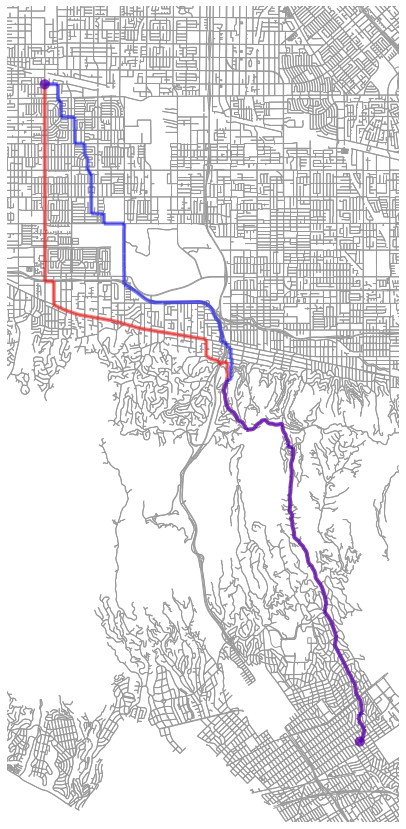

In [30]:
test.plot_two_routes()

In [664]:
dist_risk = {'risk':[0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0],'distance':[27101.942000000006,27144.781000000003,27185.981000000007,27227.181,27268.38099999999,27309.581000000002,27350.781000000003,27391.981000000007,
                                                                              27433.181,27474.38099999999,27515.581000000002]}

In [665]:
distance_vs_risk = pd.DataFrame(dist_risk)

In [666]:
distance_vs_risk

,risk,distance
0,0.0,27101.942
1,0.1,27144.781
2,0.2,27185.981
3,0.3,27227.181
4,0.4,27268.381
5,0.5,27309.581
6,0.6,27350.781
7,0.7,27391.981
8,0.8,27433.181
9,0.9,27474.381


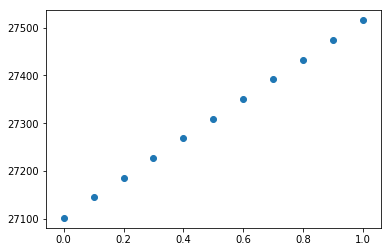

In [667]:
plt.scatter(distance_vs_risk.risk,distance_vs_risk.distance)

In [705]:
# Start and end point
start_1 = (34.045520, -118.208998)
end_1 = (34.074007, -118.341765)
center_1 = ((start[0]+end[0])/2, (start[1]+end[1])/2)

In [745]:
test2 = RouteModel2(start_latlong=start_1,end_latlong=end_1,
                   route_safety_importance=0.4)

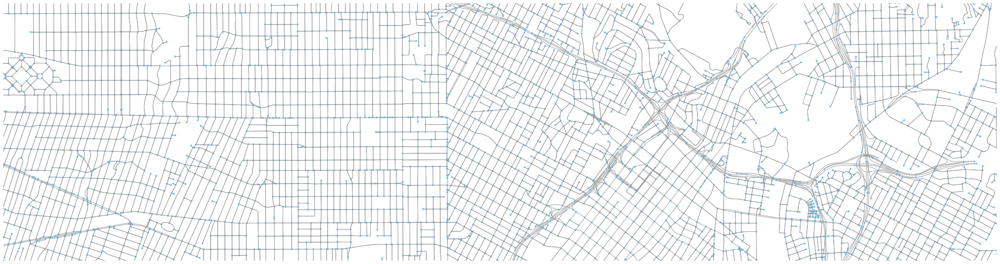

In [707]:
test2.plot_map_extent()

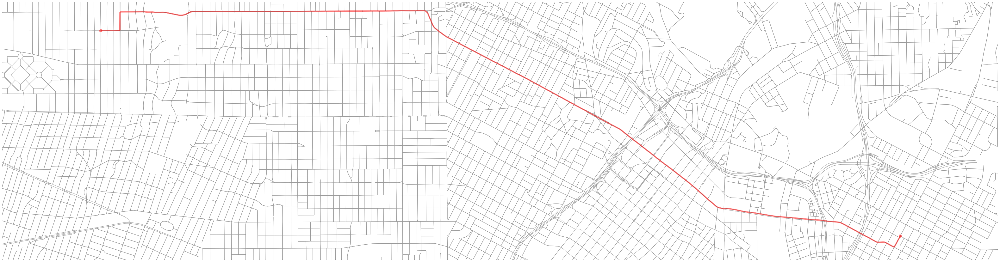

In [708]:
test2.plot_shortest_route()

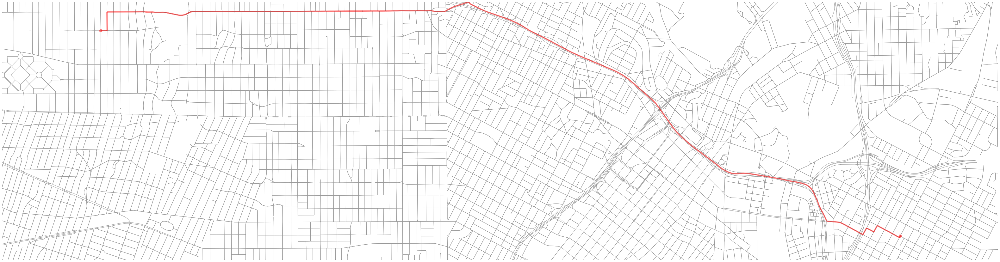

In [709]:
test2.plot_safety_weighted_route()

Shortest Path Length: 13749.380000000001
Safer Path Length: 14332.595000000007


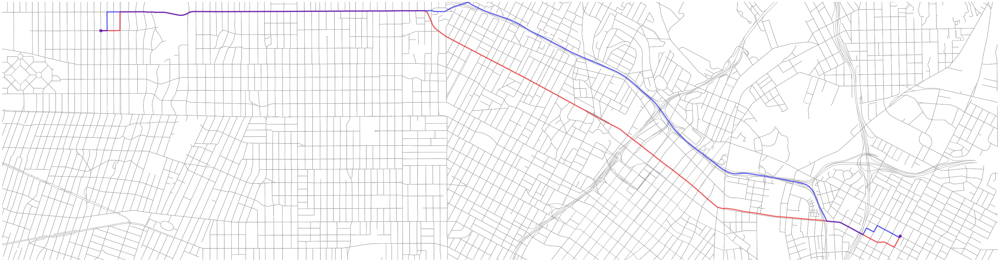

In [746]:
test2.plot_two_routes()

In [747]:
dist_risk = {'risk':[0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1.0],'distance':[13749.380000000001,13943.381999999992,
                                                                              14104.782000000007,14242.094000000001,14332.595000000007,
                                                                              14404.045000000002,14475.494999999992,
                                                                              14546.945000000007,14618.395,
                                                                              14689.845000000008,14761.295000000004]}

In [748]:
distance_vs_risk = pd.DataFrame(dist_risk)

In [749]:
distance_vs_risk

,risk,distance
0,0.0,13749.380
1,0.1,13943.382
2,0.2,14104.782
3,0.3,14242.094
4,0.4,14332.595
5,0.5,14404.045
6,0.6,14475.495
7,0.7,14546.945
8,0.8,14618.395
9,0.9,14689.845


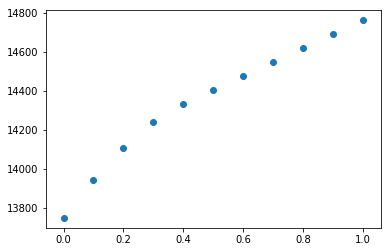

In [750]:
plt.scatter(distance_vs_risk.risk,distance_vs_risk.distance)

Once the final crime subset and the LA network dataset are ready, the next step is to integrate the crime data with the network to take it into consideration when calculating routes.

In order to achieve this, a new column is added to the crime DataFrame that will have the nearest node to each of the crime's locations. The nearest node is added to the column by using a list comprehension with the get_nearest_node function from the OSMnx module. This function uses each of the locations in latitude and longitude and the LA network as inputs and returns a tuple with the node in the network that is closest to the crime and the distance from the node to the crime.

In [318]:
crime['nearest_node'] = [ox.get_nearest_node(LA, literal_eval(loc), return_dist=True) for loc in tqdm(crime['location'])]











  0%|          | 0/319066 [00:00<?, ?it/s]









  0%|          | 1/319066 [00:00<22:14:37,  3.98it/s]









  0%|          | 2/319066 [00:00<18:52:10,  4.70it/s]









  0%|          | 3/319066 [00:00<15:56:31,  5.56it/s]









  0%|          | 4/319066 [00:00<13:51:27,  6.40it/s]









  0%|          | 6/319066 [00:00<12:07:15,  7.31it/s]









  0%|          | 7/319066 [00:00<11:14:06,  7.89it/s]









  0%|          | 8/319066 [00:00<10:44:47,  8.25it/s]









  0%|          | 9/319066 [00:01<10:13:23,  8.67it/s]









  0%|          | 11/319066 [00:01<9:28:41,  9.35it/s]









  0%|          | 12/319066 [00:03<62:29:00,  1.42it/s]









  0%|          | 13/319066 [00:03<46:43:39,  1.90it/s]









  0%|          | 15/319066 [00:03<35:07:41,  2.52it/s]









  0%|          | 17/319066 [00:03<26:53:57,  3.29it/s]









  0%|          | 19/319066 [00:03<21:00:58,  4.22it/s]









  0%|          | 21/319066 [00:05<28:16:23,  3.13it

  0%|          | 271/319066 [00:53<16:16:10,  5.44it/s]









  0%|          | 273/319066 [00:53<13:49:29,  6.41it/s]









  0%|          | 275/319066 [00:53<12:13:28,  7.24it/s]









  0%|          | 276/319066 [00:54<32:03:05,  2.76it/s]









  0%|          | 277/319066 [00:54<25:36:37,  3.46it/s]









  0%|          | 279/319066 [00:55<20:10:43,  4.39it/s]









  0%|          | 281/319066 [00:55<16:22:00,  5.41it/s]









  0%|          | 283/319066 [00:55<13:48:33,  6.41it/s]









  0%|          | 285/319066 [00:56<23:45:19,  3.73it/s]









  0%|          | 287/319066 [00:56<18:49:26,  4.70it/s]









  0%|          | 289/319066 [00:56<15:34:24,  5.69it/s]









  0%|          | 291/319066 [00:57<13:20:16,  6.64it/s]









  0%|          | 293/319066 [00:57<21:50:23,  4.05it/s]









  0%|          | 295/319066 [00:58<17:44:54,  4.99it/s]









  0%|          | 297/319066 [00:58<14:56:30,  5.93it/s]









  0%|          | 299/3190

  0%|          | 508/319066 [01:40<22:30:08,  3.93it/s]









  0%|          | 509/319066 [01:40<19:00:12,  4.66it/s]









  0%|          | 510/319066 [01:40<16:23:00,  5.40it/s]









  0%|          | 511/319066 [01:41<14:41:31,  6.02it/s]









  0%|          | 512/319066 [01:41<13:27:14,  6.58it/s]









  0%|          | 513/319066 [01:41<12:27:52,  7.10it/s]









  0%|          | 514/319066 [01:42<34:56:00,  2.53it/s]









  0%|          | 515/319066 [01:42<27:47:33,  3.18it/s]









  0%|          | 516/319066 [01:42<22:13:27,  3.98it/s]









  0%|          | 517/319066 [01:42<18:37:58,  4.75it/s]









  0%|          | 518/319066 [01:42<16:14:46,  5.45it/s]









  0%|          | 519/319066 [01:42<14:46:20,  5.99it/s]









  0%|          | 520/319066 [01:43<13:39:06,  6.48it/s]









  0%|          | 521/319066 [01:43<12:44:23,  6.95it/s]









  0%|          | 522/319066 [01:44<36:28:03,  2.43it/s]









  0%|          | 523/3190

  0%|          | 698/319066 [02:20<19:23:59,  4.56it/s]









  0%|          | 699/319066 [02:21<17:08:00,  5.16it/s]









  0%|          | 700/319066 [02:21<14:48:30,  5.97it/s]









  0%|          | 701/319066 [02:21<13:01:44,  6.79it/s]









  0%|          | 702/319066 [02:21<11:51:32,  7.46it/s]









  0%|          | 703/319066 [02:21<11:00:28,  8.03it/s]









  0%|          | 704/319066 [02:22<28:15:56,  3.13it/s]









  0%|          | 705/319066 [02:22<22:26:20,  3.94it/s]









  0%|          | 706/319066 [02:22<18:31:03,  4.78it/s]









  0%|          | 707/319066 [02:22<15:47:40,  5.60it/s]









  0%|          | 709/319066 [02:22<13:20:05,  6.63it/s]









  0%|          | 711/319066 [02:22<11:29:32,  7.69it/s]









  0%|          | 713/319066 [02:23<20:55:02,  4.23it/s]









  0%|          | 715/319066 [02:24<16:55:36,  5.22it/s]









  0%|          | 717/319066 [02:24<14:05:49,  6.27it/s]









  0%|          | 719/3190

  0%|          | 991/319066 [03:15<12:08:13,  7.28it/s]









  0%|          | 993/319066 [03:16<21:30:41,  4.11it/s]









  0%|          | 994/319066 [03:17<17:43:04,  4.99it/s]









  0%|          | 996/319066 [03:17<14:56:10,  5.92it/s]









  0%|          | 998/319066 [03:17<12:56:45,  6.82it/s]









  0%|          | 999/319066 [03:17<11:42:54,  7.54it/s]









  0%|          | 1000/319066 [03:18<32:16:03,  2.74it/s]









  0%|          | 1002/319066 [03:18<25:05:06,  3.52it/s]









  0%|          | 1004/319066 [03:18<20:03:35,  4.40it/s]









  0%|          | 1006/319066 [03:18<16:32:44,  5.34it/s]









  0%|          | 1008/319066 [03:19<24:44:17,  3.57it/s]









  0%|          | 1010/319066 [03:20<19:48:24,  4.46it/s]









  0%|          | 1012/319066 [03:20<16:23:18,  5.39it/s]









  0%|          | 1014/319066 [03:20<13:57:51,  6.33it/s]









  0%|          | 1015/319066 [03:20<12:31:38,  7.05it/s]









  0%|          |

  0%|          | 1300/319066 [04:14<16:08:01,  5.47it/s]









  0%|          | 1302/319066 [04:14<13:47:28,  6.40it/s]









  0%|          | 1304/319066 [04:15<22:50:45,  3.86it/s]









  0%|          | 1306/319066 [04:15<18:29:24,  4.77it/s]









  0%|          | 1308/319066 [04:15<15:25:58,  5.72it/s]









  0%|          | 1310/319066 [04:16<13:24:27,  6.58it/s]









  0%|          | 1312/319066 [04:16<11:54:01,  7.42it/s]









  0%|          | 1313/319066 [04:17<32:20:04,  2.73it/s]









  0%|          | 1315/319066 [04:17<25:06:37,  3.52it/s]









  0%|          | 1317/319066 [04:17<20:04:07,  4.40it/s]









  0%|          | 1319/319066 [04:17<16:32:25,  5.34it/s]









  0%|          | 1321/319066 [04:18<24:39:16,  3.58it/s]









  0%|          | 1323/319066 [04:18<19:44:24,  4.47it/s]









  0%|          | 1325/319066 [04:19<16:18:05,  5.41it/s]









  0%|          | 1326/319066 [04:19<14:04:20,  6.27it/s]









  0%|     

  1%|          | 1605/319066 [05:11<14:49:33,  5.95it/s]









  1%|          | 1607/319066 [05:12<12:49:50,  6.87it/s]









  1%|          | 1609/319066 [05:13<22:02:22,  4.00it/s]









  1%|          | 1611/319066 [05:13<17:55:03,  4.92it/s]









  1%|          | 1613/319066 [05:13<15:02:47,  5.86it/s]









  1%|          | 1615/319066 [05:13<13:01:05,  6.77it/s]









  1%|          | 1617/319066 [05:14<22:16:23,  3.96it/s]









  1%|          | 1618/319066 [05:14<18:15:30,  4.83it/s]









  1%|          | 1620/319066 [05:14<15:15:10,  5.78it/s]









  1%|          | 1622/319066 [05:15<13:06:01,  6.73it/s]









  1%|          | 1623/319066 [05:15<11:49:09,  7.46it/s]









  1%|          | 1625/319066 [05:16<21:31:33,  4.10it/s]









  1%|          | 1627/319066 [05:16<17:33:02,  5.02it/s]









  1%|          | 1629/319066 [05:16<14:45:04,  5.98it/s]









  1%|          | 1631/319066 [05:16<12:48:02,  6.89it/s]









  1%|     

  1%|          | 1870/319066 [06:02<13:36:18,  6.48it/s]









  1%|          | 1871/319066 [06:03<12:32:06,  7.03it/s]









  1%|          | 1872/319066 [06:04<32:59:53,  2.67it/s]









  1%|          | 1874/319066 [06:04<25:18:57,  3.48it/s]









  1%|          | 1876/319066 [06:04<20:12:17,  4.36it/s]









  1%|          | 1877/319066 [06:04<17:08:10,  5.14it/s]









  1%|          | 1878/319066 [06:04<14:49:47,  5.94it/s]









  1%|          | 1879/319066 [06:04<13:23:04,  6.58it/s]









  1%|          | 1880/319066 [06:04<12:10:20,  7.24it/s]









  1%|          | 1881/319066 [06:05<34:51:36,  2.53it/s]









  1%|          | 1882/319066 [06:05<27:26:26,  3.21it/s]









  1%|          | 1883/319066 [06:06<22:12:15,  3.97it/s]









  1%|          | 1884/319066 [06:06<18:33:56,  4.75it/s]









  1%|          | 1885/319066 [06:06<15:51:50,  5.55it/s]









  1%|          | 1886/319066 [06:06<14:11:09,  6.21it/s]









  1%|     

  1%|          | 2063/319066 [06:43<26:28:59,  3.32it/s]









  1%|          | 2065/319066 [06:43<21:09:53,  4.16it/s]









  1%|          | 2067/319066 [06:43<17:06:00,  5.15it/s]









  1%|          | 2069/319066 [06:43<14:12:06,  6.20it/s]









  1%|          | 2070/319066 [06:44<33:39:18,  2.62it/s]









  1%|          | 2071/319066 [06:44<26:27:18,  3.33it/s]









  1%|          | 2072/319066 [06:44<21:23:54,  4.11it/s]









  1%|          | 2073/319066 [06:44<18:02:58,  4.88it/s]









  1%|          | 2074/319066 [06:44<15:34:42,  5.65it/s]









  1%|          | 2075/319066 [06:45<13:50:31,  6.36it/s]









  1%|          | 2076/319066 [06:45<12:34:06,  7.01it/s]









  1%|          | 2077/319066 [06:45<11:48:21,  7.46it/s]









  1%|          | 2078/319066 [06:46<33:45:02,  2.61it/s]









  1%|          | 2079/319066 [06:46<26:29:08,  3.32it/s]









  1%|          | 2080/319066 [06:46<21:33:44,  4.08it/s]









  1%|     

  1%|          | 2258/319066 [07:22<13:53:53,  6.33it/s]









  1%|          | 2260/319066 [07:23<23:15:34,  3.78it/s]









  1%|          | 2261/319066 [07:23<19:20:03,  4.55it/s]









  1%|          | 2262/319066 [07:23<16:31:16,  5.33it/s]









  1%|          | 2263/319066 [07:23<14:33:47,  6.04it/s]









  1%|          | 2264/319066 [07:23<13:09:08,  6.69it/s]









  1%|          | 2265/319066 [07:23<12:10:00,  7.23it/s]









  1%|          | 2266/319066 [07:23<11:30:57,  7.64it/s]









  1%|          | 2267/319066 [07:24<34:07:37,  2.58it/s]









  1%|          | 2268/319066 [07:24<26:46:43,  3.29it/s]









  1%|          | 2269/319066 [07:24<21:25:05,  4.11it/s]









  1%|          | 2271/319066 [07:25<17:15:33,  5.10it/s]









  1%|          | 2273/319066 [07:25<14:19:20,  6.14it/s]









  1%|          | 2275/319066 [07:25<12:21:39,  7.12it/s]









  1%|          | 2277/319066 [07:26<22:47:37,  3.86it/s]









  1%|     

  1%|          | 2462/319066 [08:04<13:30:08,  6.51it/s]









  1%|          | 2463/319066 [08:04<12:11:26,  7.21it/s]









  1%|          | 2464/319066 [08:04<11:32:49,  7.62it/s]









  1%|          | 2465/319066 [08:05<32:40:59,  2.69it/s]









  1%|          | 2466/319066 [08:05<26:03:16,  3.38it/s]









  1%|          | 2467/319066 [08:06<21:15:08,  4.14it/s]









  1%|          | 2468/319066 [08:06<17:42:13,  4.97it/s]









  1%|          | 2469/319066 [08:06<15:32:30,  5.66it/s]









  1%|          | 2470/319066 [08:06<13:52:58,  6.33it/s]









  1%|          | 2471/319066 [08:06<12:45:24,  6.89it/s]









  1%|          | 2472/319066 [08:06<11:50:02,  7.43it/s]









  1%|          | 2473/319066 [08:07<34:11:55,  2.57it/s]









  1%|          | 2474/319066 [08:07<26:52:41,  3.27it/s]









  1%|          | 2475/319066 [08:07<21:30:05,  4.09it/s]









  1%|          | 2477/319066 [08:08<17:27:25,  5.04it/s]









  1%|     

  1%|          | 2666/319066 [08:46<15:28:17,  5.68it/s]









  1%|          | 2667/319066 [08:46<13:31:22,  6.50it/s]









  1%|          | 2668/319066 [08:47<12:20:38,  7.12it/s]









  1%|          | 2669/319066 [08:47<11:34:41,  7.59it/s]









  1%|          | 2670/319066 [08:48<31:39:47,  2.78it/s]









  1%|          | 2672/319066 [08:48<24:19:25,  3.61it/s]









  1%|          | 2674/319066 [08:48<19:27:55,  4.52it/s]









  1%|          | 2675/319066 [08:48<16:34:41,  5.30it/s]









  1%|          | 2676/319066 [08:48<14:26:38,  6.08it/s]









  1%|          | 2677/319066 [08:48<13:03:22,  6.73it/s]









  1%|          | 2678/319066 [08:48<12:06:25,  7.26it/s]









  1%|          | 2679/319066 [08:49<33:50:31,  2.60it/s]









  1%|          | 2680/319066 [08:49<26:25:18,  3.33it/s]









  1%|          | 2681/319066 [08:50<21:26:29,  4.10it/s]









  1%|          | 2682/319066 [08:50<17:51:24,  4.92it/s]









  1%|     

  1%|          | 2865/319066 [09:26<12:53:59,  6.81it/s]









  1%|          | 2866/319066 [09:26<11:54:45,  7.37it/s]









  1%|          | 2867/319066 [09:27<11:17:04,  7.78it/s]









  1%|          | 2868/319066 [09:28<32:59:08,  2.66it/s]









  1%|          | 2869/319066 [09:28<25:56:57,  3.38it/s]









  1%|          | 2870/319066 [09:28<21:10:35,  4.15it/s]









  1%|          | 2871/319066 [09:28<17:33:57,  5.00it/s]









  1%|          | 2872/319066 [09:28<15:19:05,  5.73it/s]









  1%|          | 2873/319066 [09:28<13:49:08,  6.36it/s]









  1%|          | 2874/319066 [09:28<12:28:20,  7.04it/s]









  1%|          | 2875/319066 [09:28<11:32:40,  7.61it/s]









  1%|          | 2876/319066 [09:29<30:29:31,  2.88it/s]









  1%|          | 2878/319066 [09:29<23:33:01,  3.73it/s]









  1%|          | 2880/319066 [09:30<19:01:18,  4.62it/s]









  1%|          | 2881/319066 [09:30<16:13:20,  5.41it/s]









  1%|     

  1%|          | 3063/319066 [10:07<14:21:30,  6.11it/s]









  1%|          | 3064/319066 [10:07<13:05:40,  6.70it/s]









  1%|          | 3065/319066 [10:07<12:05:43,  7.26it/s]









  1%|          | 3066/319066 [10:08<31:17:34,  2.81it/s]









  1%|          | 3068/319066 [10:08<24:07:02,  3.64it/s]









  1%|          | 3070/319066 [10:08<19:19:01,  4.54it/s]









  1%|          | 3071/319066 [10:08<16:22:36,  5.36it/s]









  1%|          | 3072/319066 [10:08<14:21:29,  6.11it/s]









  1%|          | 3073/319066 [10:08<13:10:33,  6.66it/s]









  1%|          | 3074/319066 [10:09<35:16:17,  2.49it/s]









  1%|          | 3075/319066 [10:10<27:39:53,  3.17it/s]









  1%|          | 3076/319066 [10:10<22:12:37,  3.95it/s]









  1%|          | 3077/319066 [10:10<18:36:40,  4.72it/s]









  1%|          | 3078/319066 [10:10<16:05:10,  5.46it/s]









  1%|          | 3079/319066 [10:10<14:03:39,  6.24it/s]









  1%|     

  1%|          | 3272/319066 [10:49<21:14:47,  4.13it/s]









  1%|          | 3274/319066 [10:49<17:22:11,  5.05it/s]









  1%|          | 3275/319066 [10:49<14:49:39,  5.92it/s]









  1%|          | 3277/319066 [10:50<12:50:43,  6.83it/s]









  1%|          | 3279/319066 [10:50<11:28:41,  7.64it/s]









  1%|          | 3280/319066 [10:51<31:41:27,  2.77it/s]









  1%|          | 3282/319066 [10:51<24:39:36,  3.56it/s]









  1%|          | 3284/319066 [10:51<19:45:07,  4.44it/s]









  1%|          | 3286/319066 [10:51<16:18:40,  5.38it/s]









  1%|          | 3288/319066 [10:52<24:22:15,  3.60it/s]









  1%|          | 3289/319066 [10:52<19:42:59,  4.45it/s]









  1%|          | 3291/319066 [10:53<16:14:49,  5.40it/s]









  1%|          | 3293/319066 [10:53<13:49:52,  6.34it/s]









  1%|          | 3294/319066 [10:53<12:19:02,  7.12it/s]









  1%|          | 3296/319066 [10:54<21:38:00,  4.05it/s]









  1%|     

  1%|          | 3578/319066 [11:47<16:53:52,  5.19it/s]









  1%|          | 3580/319066 [11:48<14:01:04,  6.25it/s]









  1%|          | 3582/319066 [11:48<12:18:07,  7.12it/s]









  1%|          | 3583/319066 [11:48<11:25:27,  7.67it/s]









  1%|          | 3584/319066 [11:49<30:09:59,  2.91it/s]









  1%|          | 3585/319066 [11:49<23:44:53,  3.69it/s]









  1%|          | 3587/319066 [11:49<19:03:35,  4.60it/s]









  1%|          | 3589/319066 [11:49<15:50:31,  5.53it/s]









  1%|          | 3591/319066 [11:49<13:37:53,  6.43it/s]









  1%|          | 3592/319066 [11:50<12:12:24,  7.18it/s]









  1%|          | 3593/319066 [11:50<32:22:05,  2.71it/s]









  1%|          | 3595/319066 [11:51<25:07:45,  3.49it/s]









  1%|          | 3596/319066 [11:51<20:15:00,  4.33it/s]









  1%|          | 3598/319066 [11:51<16:39:55,  5.26it/s]









  1%|          | 3600/319066 [11:51<14:07:42,  6.20it/s]









  1%|     

  1%|          | 3876/319066 [12:44<20:11:39,  4.34it/s]









  1%|          | 3878/319066 [12:45<16:37:48,  5.26it/s]









  1%|          | 3880/319066 [12:45<14:08:06,  6.19it/s]









  1%|          | 3881/319066 [12:46<33:12:07,  2.64it/s]









  1%|          | 3883/319066 [12:46<25:45:58,  3.40it/s]









  1%|          | 3885/319066 [12:46<20:32:28,  4.26it/s]









  1%|          | 3887/319066 [12:46<16:35:58,  5.27it/s]









  1%|          | 3889/319066 [12:47<24:41:42,  3.55it/s]









  1%|          | 3891/319066 [12:47<19:45:49,  4.43it/s]









  1%|          | 3893/319066 [12:48<16:19:09,  5.36it/s]









  1%|          | 3895/319066 [12:48<13:53:45,  6.30it/s]









  1%|          | 3897/319066 [12:49<22:43:52,  3.85it/s]









  1%|          | 3899/319066 [12:49<18:21:22,  4.77it/s]









  1%|          | 3901/319066 [12:49<15:17:26,  5.73it/s]









  1%|          | 3902/319066 [12:49<13:20:18,  6.56it/s]









  1%|     

  1%|▏         | 4169/319066 [13:40<18:02:41,  4.85it/s]









  1%|▏         | 4171/319066 [13:40<14:56:23,  5.85it/s]









  1%|▏         | 4173/319066 [13:41<12:47:51,  6.83it/s]









  1%|▏         | 4175/319066 [13:41<11:17:20,  7.75it/s]









  1%|▏         | 4177/319066 [13:42<20:15:52,  4.32it/s]









  1%|▏         | 4179/319066 [13:42<16:31:24,  5.29it/s]









  1%|▏         | 4181/319066 [13:42<13:56:06,  6.28it/s]









  1%|▏         | 4183/319066 [13:42<12:06:56,  7.22it/s]









  1%|▏         | 4185/319066 [13:43<20:49:50,  4.20it/s]









  1%|▏         | 4187/319066 [13:43<16:56:33,  5.16it/s]









  1%|▏         | 4189/319066 [13:44<14:10:55,  6.17it/s]









  1%|▏         | 4191/319066 [13:44<12:23:22,  7.06it/s]









  1%|▏         | 4192/319066 [13:44<11:21:06,  7.70it/s]









  1%|▏         | 4193/319066 [13:45<30:56:53,  2.83it/s]









  1%|▏         | 4195/319066 [13:45<23:51:18,  3.67it/s]









  1%|▏    

  1%|▏         | 4505/319066 [14:40<12:02:41,  7.25it/s]









  1%|▏         | 4506/319066 [14:41<30:51:48,  2.83it/s]









  1%|▏         | 4508/319066 [14:41<24:00:05,  3.64it/s]









  1%|▏         | 4510/319066 [14:42<19:11:40,  4.55it/s]









  1%|▏         | 4512/319066 [14:42<15:47:40,  5.53it/s]









  1%|▏         | 4514/319066 [14:43<23:35:23,  3.70it/s]









  1%|▏         | 4516/319066 [14:43<18:55:31,  4.62it/s]









  1%|▏         | 4518/319066 [14:43<15:35:53,  5.60it/s]









  1%|▏         | 4520/319066 [14:43<13:14:43,  6.60it/s]









  1%|▏         | 4522/319066 [14:43<11:38:46,  7.50it/s]









  1%|▏         | 4524/319066 [14:44<20:30:18,  4.26it/s]









  1%|▏         | 4526/319066 [14:45<16:43:19,  5.22it/s]









  1%|▏         | 4528/319066 [14:45<14:02:42,  6.22it/s]









  1%|▏         | 4530/319066 [14:45<12:11:42,  7.16it/s]









  1%|▏         | 4531/319066 [14:46<30:53:49,  2.83it/s]









  1%|▏    

  2%|▏         | 4833/319066 [15:40<15:41:29,  5.56it/s]









  2%|▏         | 4835/319066 [15:41<23:33:06,  3.71it/s]









  2%|▏         | 4837/319066 [15:42<18:52:57,  4.62it/s]









  2%|▏         | 4839/319066 [15:42<15:34:07,  5.61it/s]









  2%|▏         | 4841/319066 [15:42<13:14:06,  6.59it/s]









  2%|▏         | 4843/319066 [15:42<11:37:10,  7.51it/s]









  2%|▏         | 4845/319066 [15:43<20:32:17,  4.25it/s]









  2%|▏         | 4847/319066 [15:43<16:42:36,  5.22it/s]









  2%|▏         | 4849/319066 [15:43<14:03:08,  6.21it/s]









  2%|▏         | 4851/319066 [15:44<12:10:11,  7.17it/s]









  2%|▏         | 4853/319066 [15:45<20:47:49,  4.20it/s]









  2%|▏         | 4855/319066 [15:45<16:54:17,  5.16it/s]









  2%|▏         | 4857/319066 [15:45<14:09:59,  6.16it/s]









  2%|▏         | 4859/319066 [15:45<12:14:57,  7.13it/s]









  2%|▏         | 4860/319066 [15:46<31:01:21,  2.81it/s]









  2%|▏    

  2%|▏         | 5151/319066 [16:39<16:49:01,  5.19it/s]









  2%|▏         | 5153/319066 [16:39<14:06:00,  6.18it/s]









  2%|▏         | 5155/319066 [16:39<12:11:25,  7.15it/s]









  2%|▏         | 5157/319066 [16:40<21:01:24,  4.15it/s]









  2%|▏         | 5159/319066 [16:40<17:02:30,  5.12it/s]









  2%|▏         | 5161/319066 [16:40<14:17:19,  6.10it/s]









  2%|▏         | 5163/319066 [16:41<12:20:16,  7.07it/s]









  2%|▏         | 5165/319066 [16:42<20:54:28,  4.17it/s]









  2%|▏         | 5167/319066 [16:42<16:57:52,  5.14it/s]









  2%|▏         | 5169/319066 [16:42<14:12:53,  6.13it/s]









  2%|▏         | 5171/319066 [16:42<12:16:56,  7.10it/s]









  2%|▏         | 5173/319066 [16:43<20:56:20,  4.16it/s]









  2%|▏         | 5175/319066 [16:43<17:07:15,  5.09it/s]









  2%|▏         | 5177/319066 [16:43<14:19:22,  6.09it/s]









  2%|▏         | 5179/319066 [16:44<12:24:40,  7.03it/s]









  2%|▏    

  2%|▏         | 5481/319066 [17:39<15:10:12,  5.74it/s]









  2%|▏         | 5483/319066 [17:39<12:58:35,  6.71it/s]









  2%|▏         | 5485/319066 [17:40<11:28:19,  7.59it/s]









  2%|▏         | 5487/319066 [17:40<20:20:18,  4.28it/s]









  2%|▏         | 5489/319066 [17:41<16:33:41,  5.26it/s]









  2%|▏         | 5491/319066 [17:41<13:53:56,  6.27it/s]









  2%|▏         | 5493/319066 [17:41<12:07:45,  7.18it/s]









  2%|▏         | 5495/319066 [17:42<20:55:25,  4.16it/s]









  2%|▏         | 5497/319066 [17:42<16:57:28,  5.14it/s]









  2%|▏         | 5499/319066 [17:42<14:14:10,  6.12it/s]









  2%|▏         | 5500/319066 [17:42<12:38:18,  6.89it/s]









  2%|▏         | 5501/319066 [17:43<11:33:43,  7.53it/s]









  2%|▏         | 5502/319066 [17:43<27:28:50,  3.17it/s]









  2%|▏         | 5504/319066 [17:43<21:19:49,  4.08it/s]









  2%|▏         | 5506/319066 [17:44<17:01:13,  5.12it/s]









  2%|▏    

  2%|▏         | 5810/319066 [18:39<16:33:16,  5.26it/s]









  2%|▏         | 5812/319066 [18:39<13:55:24,  6.25it/s]









  2%|▏         | 5814/319066 [18:39<12:01:25,  7.24it/s]









  2%|▏         | 5816/319066 [18:40<20:31:19,  4.24it/s]









  2%|▏         | 5818/319066 [18:41<16:41:04,  5.22it/s]









  2%|▏         | 5820/319066 [18:41<14:03:43,  6.19it/s]









  2%|▏         | 5822/319066 [18:41<12:14:13,  7.11it/s]









  2%|▏         | 5823/319066 [18:42<30:59:46,  2.81it/s]









  2%|▏         | 5825/319066 [18:42<24:03:24,  3.62it/s]









  2%|▏         | 5827/319066 [18:42<19:12:05,  4.53it/s]









  2%|▏         | 5829/319066 [18:42<15:48:13,  5.51it/s]









  2%|▏         | 5831/319066 [18:43<21:14:34,  4.10it/s]









  2%|▏         | 5833/319066 [18:43<17:00:02,  5.12it/s]









  2%|▏         | 5835/319066 [18:43<13:59:00,  6.22it/s]









  2%|▏         | 5837/319066 [18:44<11:53:08,  7.32it/s]









  2%|▏    

  2%|▏         | 6139/319066 [19:39<16:58:04,  5.12it/s]









  2%|▏         | 6141/319066 [19:39<14:14:00,  6.11it/s]









  2%|▏         | 6143/319066 [19:39<12:20:02,  7.05it/s]









  2%|▏         | 6144/319066 [19:40<31:05:22,  2.80it/s]









  2%|▏         | 6146/319066 [19:40<24:06:23,  3.61it/s]









  2%|▏         | 6148/319066 [19:41<19:17:17,  4.51it/s]









  2%|▏         | 6150/319066 [19:41<15:55:56,  5.46it/s]









  2%|▏         | 6152/319066 [19:42<23:30:06,  3.70it/s]









  2%|▏         | 6154/319066 [19:42<18:48:07,  4.62it/s]









  2%|▏         | 6156/319066 [19:42<15:29:06,  5.61it/s]









  2%|▏         | 6158/319066 [19:42<13:08:33,  6.61it/s]









  2%|▏         | 6160/319066 [19:42<11:31:28,  7.54it/s]









  2%|▏         | 6162/319066 [19:43<20:18:21,  4.28it/s]









  2%|▏         | 6164/319066 [19:44<16:33:15,  5.25it/s]









  2%|▏         | 6166/319066 [19:44<13:56:04,  6.24it/s]









  2%|▏    

  2%|▏         | 6464/319066 [20:38<12:10:40,  7.13it/s]









  2%|▏         | 6466/319066 [20:39<20:50:24,  4.17it/s]









  2%|▏         | 6468/319066 [20:39<16:54:19,  5.14it/s]









  2%|▏         | 6470/319066 [20:39<14:13:39,  6.10it/s]









  2%|▏         | 6472/319066 [20:39<12:21:28,  7.03it/s]









  2%|▏         | 6473/319066 [20:40<31:11:08,  2.78it/s]









  2%|▏         | 6475/319066 [20:41<24:09:37,  3.59it/s]









  2%|▏         | 6477/319066 [20:41<19:16:29,  4.50it/s]









  2%|▏         | 6479/319066 [20:41<15:51:05,  5.48it/s]









  2%|▏         | 6481/319066 [20:41<13:33:45,  6.40it/s]









  2%|▏         | 6482/319066 [20:42<31:44:27,  2.74it/s]









  2%|▏         | 6484/319066 [20:42<24:34:23,  3.53it/s]









  2%|▏         | 6486/319066 [20:42<19:32:29,  4.44it/s]









  2%|▏         | 6488/319066 [20:42<16:02:13,  5.41it/s]









  2%|▏         | 6490/319066 [20:43<23:29:36,  3.70it/s]









  2%|▏    

  2%|▏         | 6797/319066 [21:39<16:54:59,  5.13it/s]









  2%|▏         | 6799/319066 [21:39<14:08:21,  6.13it/s]









  2%|▏         | 6801/319066 [21:40<12:14:59,  7.08it/s]









  2%|▏         | 6803/319066 [21:41<20:47:22,  4.17it/s]









  2%|▏         | 6805/319066 [21:41<16:51:25,  5.15it/s]









  2%|▏         | 6807/319066 [21:41<14:05:13,  6.16it/s]









  2%|▏         | 6809/319066 [21:41<12:14:37,  7.08it/s]









  2%|▏         | 6811/319066 [21:42<20:49:07,  4.17it/s]









  2%|▏         | 6813/319066 [21:42<16:54:40,  5.13it/s]









  2%|▏         | 6815/319066 [21:42<14:10:14,  6.12it/s]









  2%|▏         | 6817/319066 [21:43<12:16:14,  7.07it/s]









  2%|▏         | 6819/319066 [21:43<20:54:24,  4.15it/s]









  2%|▏         | 6821/319066 [21:44<17:00:00,  5.10it/s]









  2%|▏         | 6823/319066 [21:44<14:14:36,  6.09it/s]









  2%|▏         | 6825/319066 [21:44<12:20:14,  7.03it/s]









  2%|▏    

  2%|▏         | 7087/319066 [22:33<14:12:47,  6.10it/s]









  2%|▏         | 7089/319066 [22:34<12:13:28,  7.09it/s]









  2%|▏         | 7091/319066 [22:35<20:55:53,  4.14it/s]









  2%|▏         | 7093/319066 [22:35<17:04:00,  5.08it/s]









  2%|▏         | 7095/319066 [22:35<14:19:00,  6.05it/s]









  2%|▏         | 7097/319066 [22:35<12:24:51,  6.98it/s]









  2%|▏         | 7099/319066 [22:36<20:57:51,  4.13it/s]









  2%|▏         | 7101/319066 [22:36<17:01:09,  5.09it/s]









  2%|▏         | 7103/319066 [22:36<14:14:55,  6.08it/s]









  2%|▏         | 7105/319066 [22:37<12:18:42,  7.04it/s]









  2%|▏         | 7107/319066 [22:38<21:00:55,  4.12it/s]









  2%|▏         | 7109/319066 [22:38<17:07:06,  5.06it/s]









  2%|▏         | 7111/319066 [22:38<14:20:21,  6.04it/s]









  2%|▏         | 7113/319066 [22:38<12:21:42,  7.01it/s]









  2%|▏         | 7115/319066 [22:39<21:08:41,  4.10it/s]









  2%|▏    

  2%|▏         | 7419/319066 [23:34<12:28:29,  6.94it/s]









  2%|▏         | 7421/319066 [23:35<21:41:31,  3.99it/s]









  2%|▏         | 7422/319066 [23:35<17:48:56,  4.86it/s]









  2%|▏         | 7424/319066 [23:35<14:57:01,  5.79it/s]









  2%|▏         | 7425/319066 [23:35<13:04:13,  6.62it/s]









  2%|▏         | 7427/319066 [23:35<11:37:46,  7.44it/s]









  2%|▏         | 7428/319066 [23:36<30:50:41,  2.81it/s]









  2%|▏         | 7430/319066 [23:36<23:56:32,  3.62it/s]









  2%|▏         | 7432/319066 [23:37<19:12:32,  4.51it/s]









  2%|▏         | 7434/319066 [23:37<15:54:47,  5.44it/s]









  2%|▏         | 7436/319066 [23:38<23:57:44,  3.61it/s]









  2%|▏         | 7438/319066 [23:38<19:14:31,  4.50it/s]









  2%|▏         | 7440/319066 [23:38<15:50:46,  5.46it/s]









  2%|▏         | 7442/319066 [23:38<13:29:48,  6.41it/s]









  2%|▏         | 7444/319066 [23:39<11:51:32,  7.30it/s]









  2%|▏    

  2%|▏         | 7747/319066 [24:34<12:12:45,  7.08it/s]









  2%|▏         | 7749/319066 [24:35<20:43:39,  4.17it/s]









  2%|▏         | 7751/319066 [24:35<16:47:59,  5.15it/s]









  2%|▏         | 7753/319066 [24:35<14:06:20,  6.13it/s]









  2%|▏         | 7755/319066 [24:35<12:11:05,  7.10it/s]









  2%|▏         | 7757/319066 [24:36<20:51:45,  4.14it/s]









  2%|▏         | 7759/319066 [24:36<16:55:46,  5.11it/s]









  2%|▏         | 7761/319066 [24:36<14:15:22,  6.07it/s]









  2%|▏         | 7763/319066 [24:37<12:15:23,  7.06it/s]









  2%|▏         | 7765/319066 [24:37<10:52:47,  7.95it/s]









  2%|▏         | 7767/319066 [24:38<19:47:32,  4.37it/s]









  2%|▏         | 7769/319066 [24:38<16:12:05,  5.34it/s]









  2%|▏         | 7771/319066 [24:38<13:37:23,  6.35it/s]









  2%|▏         | 7773/319066 [24:38<11:54:57,  7.26it/s]









  2%|▏         | 7774/319066 [24:39<30:23:45,  2.84it/s]









  2%|▏    

  3%|▎         | 8080/319066 [25:35<15:58:35,  5.41it/s]









  3%|▎         | 8082/319066 [25:35<13:17:33,  6.50it/s]









  3%|▎         | 8084/319066 [25:35<11:22:20,  7.60it/s]









  3%|▎         | 8086/319066 [25:35<10:00:53,  8.63it/s]









  3%|▎         | 8088/319066 [25:36<19:14:31,  4.49it/s]









  3%|▎         | 8090/319066 [25:36<15:47:39,  5.47it/s]









  3%|▎         | 8092/319066 [25:36<13:21:48,  6.46it/s]









  3%|▎         | 8094/319066 [25:36<11:39:14,  7.41it/s]









  3%|▎         | 8096/319066 [25:37<20:22:30,  4.24it/s]









  3%|▎         | 8098/319066 [25:38<16:33:37,  5.22it/s]









  3%|▎         | 8100/319066 [25:38<13:58:33,  6.18it/s]









  3%|▎         | 8102/319066 [25:38<12:08:48,  7.11it/s]









  3%|▎         | 8103/319066 [25:39<30:23:34,  2.84it/s]









  3%|▎         | 8105/319066 [25:39<23:37:32,  3.66it/s]









  3%|▎         | 8107/319066 [25:39<18:49:58,  4.59it/s]









  3%|▎    

  3%|▎         | 8411/319066 [26:35<16:02:00,  5.38it/s]









  3%|▎         | 8413/319066 [26:35<13:27:33,  6.41it/s]









  3%|▎         | 8415/319066 [26:35<11:45:50,  7.34it/s]









  3%|▎         | 8417/319066 [26:36<20:26:06,  4.22it/s]









  3%|▎         | 8419/319066 [26:36<16:40:27,  5.18it/s]









  3%|▎         | 8421/319066 [26:36<14:01:28,  6.15it/s]









  3%|▎         | 8423/319066 [26:36<12:06:13,  7.13it/s]









  3%|▎         | 8424/319066 [26:37<30:27:36,  2.83it/s]









  3%|▎         | 8426/319066 [26:37<23:36:58,  3.65it/s]









  3%|▎         | 8428/319066 [26:38<18:47:34,  4.59it/s]









  3%|▎         | 8430/319066 [26:38<15:25:12,  5.60it/s]









  3%|▎         | 8432/319066 [26:39<22:36:21,  3.82it/s]









  3%|▎         | 8434/319066 [26:39<18:10:35,  4.75it/s]









  3%|▎         | 8436/319066 [26:39<15:01:52,  5.74it/s]









  3%|▎         | 8438/319066 [26:39<12:49:23,  6.73it/s]









  3%|▎    

  3%|▎         | 8743/319066 [27:35<12:12:22,  7.06it/s]









  3%|▎         | 8745/319066 [27:36<20:38:08,  4.18it/s]









  3%|▎         | 8747/319066 [27:36<16:43:18,  5.15it/s]









  3%|▎         | 8749/319066 [27:36<14:00:10,  6.16it/s]









  3%|▎         | 8751/319066 [27:36<12:07:32,  7.11it/s]









  3%|▎         | 8753/319066 [27:37<20:43:01,  4.16it/s]









  3%|▎         | 8755/319066 [27:37<16:46:48,  5.14it/s]









  3%|▎         | 8757/319066 [27:37<14:02:37,  6.14it/s]









  3%|▎         | 8759/319066 [27:38<12:06:48,  7.12it/s]









  3%|▎         | 8761/319066 [27:39<20:47:13,  4.15it/s]









  3%|▎         | 8763/319066 [27:39<16:55:36,  5.09it/s]









  3%|▎         | 8765/319066 [27:39<14:11:55,  6.07it/s]









  3%|▎         | 8767/319066 [27:39<12:14:18,  7.04it/s]









  3%|▎         | 8769/319066 [27:40<20:56:28,  4.12it/s]









  3%|▎         | 8771/319066 [27:40<16:55:48,  5.09it/s]









  3%|▎    

  3%|▎         | 9081/319066 [28:36<12:05:01,  7.13it/s]









  3%|▎         | 9083/319066 [28:37<20:34:46,  4.18it/s]









  3%|▎         | 9085/319066 [28:37<16:43:03,  5.15it/s]









  3%|▎         | 9087/319066 [28:37<13:59:06,  6.16it/s]









  3%|▎         | 9089/319066 [28:37<12:08:38,  7.09it/s]









  3%|▎         | 9090/319066 [28:38<30:58:59,  2.78it/s]









  3%|▎         | 9092/319066 [28:39<24:00:27,  3.59it/s]









  3%|▎         | 9094/319066 [28:39<19:07:07,  4.50it/s]









  3%|▎         | 9096/319066 [28:39<15:43:06,  5.48it/s]









  3%|▎         | 9098/319066 [28:39<13:20:34,  6.45it/s]









  3%|▎         | 9100/319066 [28:40<21:29:36,  4.01it/s]









  3%|▎         | 9102/319066 [28:40<17:20:36,  4.96it/s]









  3%|▎         | 9104/319066 [28:40<14:25:35,  5.97it/s]









  3%|▎         | 9106/319066 [28:41<12:23:58,  6.94it/s]









  3%|▎         | 9108/319066 [28:42<20:52:52,  4.12it/s]









  3%|▎    

  3%|▎         | 9413/319066 [29:37<16:31:30,  5.21it/s]









  3%|▎         | 9415/319066 [29:37<13:56:58,  6.17it/s]









  3%|▎         | 9417/319066 [29:38<12:07:50,  7.09it/s]









  3%|▎         | 9419/319066 [29:38<10:47:51,  7.97it/s]









  3%|▎         | 9421/319066 [29:39<19:44:47,  4.36it/s]









  3%|▎         | 9423/319066 [29:39<16:10:07,  5.32it/s]









  3%|▎         | 9425/319066 [29:39<13:35:45,  6.33it/s]









  3%|▎         | 9427/319066 [29:39<11:49:52,  7.27it/s]









  3%|▎         | 9429/319066 [29:40<20:25:52,  4.21it/s]









  3%|▎         | 9431/319066 [29:40<16:40:11,  5.16it/s]









  3%|▎         | 9433/319066 [29:41<13:58:25,  6.16it/s]









  3%|▎         | 9435/319066 [29:41<12:06:08,  7.11it/s]









  3%|▎         | 9436/319066 [29:42<30:50:49,  2.79it/s]









  3%|▎         | 9438/319066 [29:42<23:55:32,  3.59it/s]









  3%|▎         | 9440/319066 [29:42<19:01:49,  4.52it/s]









  3%|▎    

  3%|▎         | 9746/319066 [30:37<13:47:00,  6.23it/s]









  3%|▎         | 9748/319066 [30:37<11:57:55,  7.18it/s]









  3%|▎         | 9750/319066 [30:38<20:34:38,  4.18it/s]









  3%|▎         | 9752/319066 [30:38<16:44:59,  5.13it/s]









  3%|▎         | 9754/319066 [30:39<14:06:51,  6.09it/s]









  3%|▎         | 9756/319066 [30:39<12:10:26,  7.06it/s]









  3%|▎         | 9757/319066 [30:40<30:38:19,  2.80it/s]









  3%|▎         | 9759/319066 [30:40<23:44:37,  3.62it/s]









  3%|▎         | 9761/319066 [30:40<18:56:44,  4.53it/s]









  3%|▎         | 9763/319066 [30:40<15:32:34,  5.53it/s]









  3%|▎         | 9765/319066 [30:40<13:12:14,  6.51it/s]









  3%|▎         | 9767/319066 [30:41<21:20:02,  4.03it/s]









  3%|▎         | 9769/319066 [30:41<17:14:09,  4.98it/s]









  3%|▎         | 9771/319066 [30:42<14:21:34,  5.98it/s]









  3%|▎         | 9773/319066 [30:42<12:24:58,  6.92it/s]









  3%|▎    

  3%|▎         | 10082/319066 [31:38<14:00:56,  6.12it/s]









  3%|▎         | 10084/319066 [31:38<12:12:12,  7.03it/s]









  3%|▎         | 10086/319066 [31:39<10:48:52,  7.94it/s]









  3%|▎         | 10088/319066 [31:39<19:47:23,  4.34it/s]









  3%|▎         | 10090/319066 [31:40<16:09:47,  5.31it/s]









  3%|▎         | 10092/319066 [31:40<13:36:55,  6.30it/s]









  3%|▎         | 10094/319066 [31:40<11:48:28,  7.27it/s]









  3%|▎         | 10096/319066 [31:41<20:24:12,  4.21it/s]









  3%|▎         | 10098/319066 [31:41<16:33:42,  5.18it/s]









  3%|▎         | 10100/319066 [31:41<13:55:25,  6.16it/s]









  3%|▎         | 10102/319066 [31:42<12:01:16,  7.14it/s]









  3%|▎         | 10104/319066 [31:42<20:36:51,  4.16it/s]









  3%|▎         | 10106/319066 [31:43<16:46:16,  5.12it/s]









  3%|▎         | 10108/319066 [31:43<14:08:47,  6.07it/s]









  3%|▎         | 10110/319066 [31:43<12:09:56,  7.05it/s]






  3%|▎         | 10340/319066 [32:27<10:42:35,  8.01it/s]









  3%|▎         | 10341/319066 [32:27<10:18:13,  8.32it/s]









  3%|▎         | 10342/319066 [32:28<31:41:52,  2.71it/s]









  3%|▎         | 10343/319066 [32:28<24:55:27,  3.44it/s]









  3%|▎         | 10344/319066 [32:28<20:14:58,  4.23it/s]









  3%|▎         | 10345/319066 [32:28<16:44:56,  5.12it/s]









  3%|▎         | 10346/319066 [32:28<14:34:22,  5.88it/s]









  3%|▎         | 10347/319066 [32:28<12:50:16,  6.68it/s]









  3%|▎         | 10348/319066 [32:28<11:43:40,  7.31it/s]









  3%|▎         | 10350/319066 [32:29<19:14:44,  4.46it/s]









  3%|▎         | 10352/319066 [32:29<15:46:02,  5.44it/s]









  3%|▎         | 10353/319066 [32:29<13:46:44,  6.22it/s]









  3%|▎         | 10354/319066 [32:29<12:27:32,  6.88it/s]









  3%|▎         | 10355/319066 [32:30<11:21:53,  7.55it/s]









  3%|▎         | 10356/319066 [32:30<10:48:51,  7.93it/s]






  3%|▎         | 10548/319066 [33:08<29:25:18,  2.91it/s]









  3%|▎         | 10550/319066 [33:09<22:40:34,  3.78it/s]









  3%|▎         | 10552/319066 [33:09<17:56:19,  4.78it/s]









  3%|▎         | 10553/319066 [33:09<15:24:53,  5.56it/s]









  3%|▎         | 10554/319066 [33:09<13:23:20,  6.40it/s]









  3%|▎         | 10555/319066 [33:09<12:21:31,  6.93it/s]









  3%|▎         | 10556/319066 [33:10<32:13:56,  2.66it/s]









  3%|▎         | 10557/319066 [33:10<25:20:34,  3.38it/s]









  3%|▎         | 10558/319066 [33:10<20:19:45,  4.22it/s]









  3%|▎         | 10559/319066 [33:10<16:55:31,  5.06it/s]









  3%|▎         | 10560/319066 [33:10<14:33:24,  5.89it/s]









  3%|▎         | 10561/319066 [33:10<12:54:57,  6.63it/s]









  3%|▎         | 10563/319066 [33:11<11:39:47,  7.35it/s]









  3%|▎         | 10564/319066 [33:12<32:27:17,  2.64it/s]









  3%|▎         | 10566/319066 [33:12<25:08:49,  3.41it/s]






  3%|▎         | 10766/319066 [33:52<13:26:58,  6.37it/s]









  3%|▎         | 10767/319066 [33:52<12:23:52,  6.91it/s]









  3%|▎         | 10768/319066 [33:52<11:21:21,  7.54it/s]









  3%|▎         | 10769/319066 [33:52<10:48:19,  7.93it/s]









  3%|▎         | 10770/319066 [33:53<32:44:14,  2.62it/s]









  3%|▎         | 10771/319066 [33:53<25:48:56,  3.32it/s]









  3%|▎         | 10773/319066 [33:53<20:20:22,  4.21it/s]









  3%|▎         | 10775/319066 [33:53<16:21:51,  5.23it/s]









  3%|▎         | 10777/319066 [33:53<13:31:06,  6.33it/s]









  3%|▎         | 10779/319066 [33:54<22:24:45,  3.82it/s]









  3%|▎         | 10780/319066 [33:55<18:31:56,  4.62it/s]









  3%|▎         | 10781/319066 [33:55<15:48:36,  5.42it/s]









  3%|▎         | 10782/319066 [33:55<13:56:06,  6.15it/s]









  3%|▎         | 10783/319066 [33:55<12:42:43,  6.74it/s]









  3%|▎         | 10784/319066 [33:55<11:31:26,  7.43it/s]






  3%|▎         | 10996/319066 [34:37<13:34:46,  6.30it/s]









  3%|▎         | 10997/319066 [34:37<12:18:01,  6.96it/s]









  3%|▎         | 10998/319066 [34:37<11:21:52,  7.53it/s]









  3%|▎         | 10999/319066 [34:37<10:46:20,  7.94it/s]









  3%|▎         | 11000/319066 [34:38<32:49:39,  2.61it/s]









  3%|▎         | 11001/319066 [34:39<25:59:47,  3.29it/s]









  3%|▎         | 11002/319066 [34:39<20:59:03,  4.08it/s]









  3%|▎         | 11003/319066 [34:39<17:33:33,  4.87it/s]









  3%|▎         | 11005/319066 [34:39<14:38:48,  5.84it/s]









  3%|▎         | 11007/319066 [34:39<12:31:39,  6.83it/s]









  3%|▎         | 11008/319066 [34:40<29:21:17,  2.92it/s]









  3%|▎         | 11009/319066 [34:40<23:16:04,  3.68it/s]









  3%|▎         | 11010/319066 [34:40<18:59:56,  4.50it/s]









  3%|▎         | 11011/319066 [34:40<16:07:11,  5.31it/s]









  3%|▎         | 11012/319066 [34:40<14:04:22,  6.08it/s]






  4%|▎         | 11198/319066 [35:17<27:44:42,  3.08it/s]









  4%|▎         | 11200/319066 [35:17<21:28:42,  3.98it/s]









  4%|▎         | 11202/319066 [35:17<17:20:29,  4.93it/s]









  4%|▎         | 11203/319066 [35:18<14:51:09,  5.76it/s]









  4%|▎         | 11204/319066 [35:18<13:05:31,  6.53it/s]









  4%|▎         | 11206/319066 [35:19<22:17:08,  3.84it/s]









  4%|▎         | 11207/319066 [35:19<18:31:11,  4.62it/s]









  4%|▎         | 11208/319066 [35:19<15:33:14,  5.50it/s]









  4%|▎         | 11209/319066 [35:19<13:46:28,  6.21it/s]









  4%|▎         | 11210/319066 [35:19<12:34:10,  6.80it/s]









  4%|▎         | 11211/319066 [35:19<11:24:38,  7.49it/s]









  4%|▎         | 11212/319066 [35:19<10:35:57,  8.07it/s]









  4%|▎         | 11213/319066 [35:19<10:08:24,  8.43it/s]









  4%|▎         | 11214/319066 [35:20<30:52:45,  2.77it/s]









  4%|▎         | 11216/319066 [35:21<23:53:57,  3.58it/s]






  4%|▎         | 11400/319066 [35:57<11:41:57,  7.30it/s]









  4%|▎         | 11401/319066 [35:57<10:55:00,  7.83it/s]









  4%|▎         | 11402/319066 [35:57<10:25:55,  8.19it/s]









  4%|▎         | 11403/319066 [35:57<9:59:34,  8.55it/s] 









  4%|▎         | 11404/319066 [35:58<30:18:01,  2.82it/s]









  4%|▎         | 11406/319066 [35:58<23:23:44,  3.65it/s]









  4%|▎         | 11408/319066 [35:58<18:25:49,  4.64it/s]









  4%|▎         | 11410/319066 [35:58<14:57:33,  5.71it/s]









  4%|▎         | 11412/319066 [35:59<23:15:47,  3.67it/s]









  4%|▎         | 11413/319066 [35:59<19:12:45,  4.45it/s]









  4%|▎         | 11414/319066 [36:00<16:27:12,  5.19it/s]









  4%|▎         | 11415/319066 [36:00<14:16:24,  5.99it/s]









  4%|▎         | 11416/319066 [36:00<12:34:53,  6.79it/s]









  4%|▎         | 11417/319066 [36:00<11:22:35,  7.51it/s]









  4%|▎         | 11418/319066 [36:00<10:46:48,  7.93it/s]






  4%|▎         | 11606/319066 [36:38<12:15:12,  6.97it/s]









  4%|▎         | 11607/319066 [36:38<11:27:44,  7.45it/s]









  4%|▎         | 11608/319066 [36:38<10:38:14,  8.03it/s]









  4%|▎         | 11609/319066 [36:39<32:13:58,  2.65it/s]









  4%|▎         | 11610/319066 [36:39<25:28:10,  3.35it/s]









  4%|▎         | 11611/319066 [36:39<20:33:24,  4.15it/s]









  4%|▎         | 11613/319066 [36:39<16:48:39,  5.08it/s]









  4%|▎         | 11615/319066 [36:40<13:47:41,  6.19it/s]









  4%|▎         | 11617/319066 [36:40<11:38:39,  7.33it/s]









  4%|▎         | 11619/319066 [36:41<20:33:41,  4.15it/s]









  4%|▎         | 11620/319066 [36:41<17:22:20,  4.92it/s]









  4%|▎         | 11621/319066 [36:41<14:52:36,  5.74it/s]









  4%|▎         | 11622/319066 [36:41<13:10:41,  6.48it/s]









  4%|▎         | 11623/319066 [36:41<12:04:50,  7.07it/s]









  4%|▎         | 11624/319066 [36:41<11:16:55,  7.57it/s]






  4%|▎         | 11870/319066 [37:28<13:01:01,  6.56it/s]









  4%|▎         | 11872/319066 [37:29<21:17:59,  4.01it/s]









  4%|▎         | 11874/319066 [37:29<17:12:04,  4.96it/s]









  4%|▎         | 11876/319066 [37:29<14:21:20,  5.94it/s]









  4%|▎         | 11878/319066 [37:29<12:21:54,  6.90it/s]









  4%|▎         | 11880/319066 [37:30<11:00:42,  7.75it/s]









  4%|▎         | 11882/319066 [37:30<19:41:37,  4.33it/s]









  4%|▎         | 11884/319066 [37:31<16:06:15,  5.30it/s]









  4%|▎         | 11886/319066 [37:31<13:38:04,  6.26it/s]









  4%|▎         | 11888/319066 [37:31<11:49:56,  7.21it/s]









  4%|▎         | 11889/319066 [37:32<30:22:40,  2.81it/s]









  4%|▎         | 11891/319066 [37:32<23:31:48,  3.63it/s]









  4%|▎         | 11893/319066 [37:32<18:44:18,  4.55it/s]









  4%|▎         | 11895/319066 [37:32<15:21:51,  5.55it/s]









  4%|▎         | 11897/319066 [37:33<22:58:09,  3.71it/s]






  4%|▍         | 12197/319066 [38:27<18:59:36,  4.49it/s]









  4%|▍         | 12199/319066 [38:27<15:35:25,  5.47it/s]









  4%|▍         | 12201/319066 [38:27<13:09:58,  6.47it/s]









  4%|▍         | 12203/319066 [38:28<21:15:28,  4.01it/s]









  4%|▍         | 12205/319066 [38:29<17:10:13,  4.96it/s]









  4%|▍         | 12207/319066 [38:29<14:25:35,  5.91it/s]









  4%|▍         | 12209/319066 [38:29<12:23:56,  6.87it/s]









  4%|▍         | 12210/319066 [38:30<30:42:14,  2.78it/s]









  4%|▍         | 12212/319066 [38:30<23:46:23,  3.59it/s]









  4%|▍         | 12214/319066 [38:30<18:56:31,  4.50it/s]









  4%|▍         | 12216/319066 [38:30<15:31:14,  5.49it/s]









  4%|▍         | 12218/319066 [38:31<23:21:40,  3.65it/s]









  4%|▍         | 12220/319066 [38:31<18:37:45,  4.58it/s]









  4%|▍         | 12222/319066 [38:32<15:22:50,  5.54it/s]









  4%|▍         | 12224/319066 [38:32<13:04:41,  6.52it/s]






  4%|▍         | 12528/319066 [39:27<13:29:43,  6.31it/s]









  4%|▍         | 12530/319066 [39:27<11:45:01,  7.25it/s]









  4%|▍         | 12531/319066 [39:28<30:10:54,  2.82it/s]









  4%|▍         | 12533/319066 [39:28<23:24:30,  3.64it/s]









  4%|▍         | 12535/319066 [39:28<18:42:44,  4.55it/s]









  4%|▍         | 12537/319066 [39:28<15:23:22,  5.53it/s]









  4%|▍         | 12539/319066 [39:29<22:58:09,  3.71it/s]









  4%|▍         | 12541/319066 [39:29<18:22:31,  4.63it/s]









  4%|▍         | 12543/319066 [39:30<15:12:24,  5.60it/s]









  4%|▍         | 12545/319066 [39:30<12:58:19,  6.56it/s]









  4%|▍         | 12547/319066 [39:30<11:21:23,  7.50it/s]









  4%|▍         | 12549/319066 [39:31<20:02:02,  4.25it/s]









  4%|▍         | 12551/319066 [39:31<16:20:33,  5.21it/s]









  4%|▍         | 12553/319066 [39:31<13:43:02,  6.21it/s]









  4%|▍         | 12555/319066 [39:31<11:54:52,  7.15it/s]






  4%|▍         | 12855/319066 [40:27<16:25:34,  5.18it/s]









  4%|▍         | 12857/319066 [40:27<13:49:04,  6.16it/s]









  4%|▍         | 12859/319066 [40:27<11:55:30,  7.13it/s]









  4%|▍         | 12860/319066 [40:28<30:30:04,  2.79it/s]









  4%|▍         | 12862/319066 [40:28<23:41:30,  3.59it/s]









  4%|▍         | 12864/319066 [40:29<18:53:56,  4.50it/s]









  4%|▍         | 12866/319066 [40:29<15:36:02,  5.45it/s]









  4%|▍         | 12868/319066 [40:29<13:17:13,  6.40it/s]









  4%|▍         | 12869/319066 [40:30<31:06:26,  2.73it/s]









  4%|▍         | 12871/319066 [40:30<24:02:07,  3.54it/s]









  4%|▍         | 12873/319066 [40:30<19:06:26,  4.45it/s]









  4%|▍         | 12875/319066 [40:30<15:40:01,  5.43it/s]









  4%|▍         | 12877/319066 [40:31<23:06:42,  3.68it/s]









  4%|▍         | 12879/319066 [40:32<18:28:26,  4.60it/s]









  4%|▍         | 12881/319066 [40:32<15:12:05,  5.59it/s]






  4%|▍         | 13181/319066 [41:27<22:56:11,  3.70it/s]









  4%|▍         | 13183/319066 [41:27<18:21:14,  4.63it/s]









  4%|▍         | 13185/319066 [41:27<15:05:55,  5.63it/s]









  4%|▍         | 13187/319066 [41:27<12:51:09,  6.61it/s]









  4%|▍         | 13189/319066 [41:28<11:18:44,  7.51it/s]









  4%|▍         | 13191/319066 [41:28<19:59:18,  4.25it/s]









  4%|▍         | 13193/319066 [41:29<16:19:16,  5.21it/s]









  4%|▍         | 13195/319066 [41:29<13:42:07,  6.20it/s]









  4%|▍         | 13197/319066 [41:29<11:52:47,  7.15it/s]









  4%|▍         | 13198/319066 [41:30<30:13:50,  2.81it/s]









  4%|▍         | 13200/319066 [41:30<23:26:06,  3.63it/s]









  4%|▍         | 13202/319066 [41:30<18:40:26,  4.55it/s]









  4%|▍         | 13204/319066 [41:30<15:28:42,  5.49it/s]









  4%|▍         | 13206/319066 [41:31<22:52:41,  3.71it/s]









  4%|▍         | 13208/319066 [41:32<18:17:46,  4.64it/s]






  4%|▍         | 13469/319066 [42:20<31:22:00,  2.71it/s]









  4%|▍         | 13471/319066 [42:20<24:03:13,  3.53it/s]









  4%|▍         | 13473/319066 [42:20<18:49:24,  4.51it/s]









  4%|▍         | 13475/319066 [42:20<15:25:18,  5.50it/s]









  4%|▍         | 13477/319066 [42:21<24:28:33,  3.47it/s]









  4%|▍         | 13478/319066 [42:21<20:18:07,  4.18it/s]









  4%|▍         | 13479/319066 [42:21<17:01:58,  4.98it/s]









  4%|▍         | 13480/319066 [42:22<14:35:08,  5.82it/s]









  4%|▍         | 13481/319066 [42:22<12:58:11,  6.54it/s]









  4%|▍         | 13482/319066 [42:22<11:54:49,  7.12it/s]









  4%|▍         | 13483/319066 [42:22<11:11:42,  7.58it/s]









  4%|▍         | 13484/319066 [42:22<10:37:59,  7.98it/s]









  4%|▍         | 13485/319066 [42:22<10:16:39,  8.26it/s]









  4%|▍         | 13486/319066 [42:23<30:31:39,  2.78it/s]









  4%|▍         | 13488/319066 [42:23<23:22:39,  3.63it/s]






  4%|▍         | 13683/319066 [43:11<23:26:52,  3.62it/s]









  4%|▍         | 13685/319066 [43:12<18:40:29,  4.54it/s]









  4%|▍         | 13687/319066 [43:12<15:21:08,  5.53it/s]









  4%|▍         | 13689/319066 [43:12<13:04:01,  6.49it/s]









  4%|▍         | 13691/319066 [43:13<21:25:07,  3.96it/s]









  4%|▍         | 13693/319066 [43:13<17:18:24,  4.90it/s]









  4%|▍         | 13695/319066 [43:13<14:23:47,  5.89it/s]









  4%|▍         | 13697/319066 [43:14<12:21:55,  6.86it/s]









  4%|▍         | 13699/319066 [43:14<11:01:58,  7.69it/s]









  4%|▍         | 13701/319066 [43:15<19:35:01,  4.33it/s]









  4%|▍         | 13703/319066 [43:15<15:47:13,  5.37it/s]









  4%|▍         | 13705/319066 [43:15<13:02:11,  6.51it/s]









  4%|▍         | 13707/319066 [43:15<11:08:31,  7.61it/s]









  4%|▍         | 13709/319066 [43:16<19:45:23,  4.29it/s]









  4%|▍         | 13711/319066 [43:16<16:08:40,  5.25it/s]






  4%|▍         | 14003/319066 [1:19:12<18283:59:56, 215.77s/it]









  4%|▍         | 14004/319066 [1:19:13<12828:43:01, 151.39s/it]









  4%|▍         | 14005/319066 [1:19:13<8982:56:23, 106.01s/it] 









  4%|▍         | 14006/319066 [1:19:14<6290:38:42, 74.24s/it] 









  4%|▍         | 14008/319066 [1:19:14<4405:50:06, 51.99s/it]









  4%|▍         | 14010/319066 [1:19:14<3086:26:17, 36.42s/it]









  4%|▍         | 14012/319066 [1:19:15<2172:45:52, 25.64s/it]









  4%|▍         | 14014/319066 [1:19:15<1523:21:48, 17.98s/it]









  4%|▍         | 14016/319066 [1:19:15<1068:42:28, 12.61s/it]









  4%|▍         | 14018/319066 [1:19:16<750:36:40,  8.86s/it] 









  4%|▍         | 14019/319066 [1:19:16<528:36:10,  6.24s/it]









  4%|▍         | 14020/319066 [1:19:16<372:40:40,  4.40s/it]









  4%|▍         | 14021/319066 [1:19:16<279:57:20,  3.30s/it]









  4%|▍         | 14023/319066 [1:19:17<198:05:00,  2.34s/it]









  4

  4%|▍         | 14214/319066 [1:20:03<15:46:11,  5.37it/s]









  4%|▍         | 14215/319066 [1:20:03<14:30:36,  5.84it/s]









  4%|▍         | 14216/319066 [1:20:03<13:30:08,  6.27it/s]









  4%|▍         | 14217/319066 [1:20:03<12:19:33,  6.87it/s]









  4%|▍         | 14218/319066 [1:20:04<33:18:07,  2.54it/s]









  4%|▍         | 14219/319066 [1:20:04<26:06:43,  3.24it/s]









  4%|▍         | 14220/319066 [1:20:04<21:01:19,  4.03it/s]









  4%|▍         | 14222/319066 [1:20:05<17:01:38,  4.97it/s]









  4%|▍         | 14224/319066 [1:20:05<14:17:17,  5.93it/s]









  4%|▍         | 14225/319066 [1:20:05<12:40:52,  6.68it/s]









  4%|▍         | 14226/319066 [1:20:06<32:01:29,  2.64it/s]









  4%|▍         | 14227/319066 [1:20:06<25:28:12,  3.32it/s]









  4%|▍         | 14228/319066 [1:20:06<20:49:51,  4.06it/s]









  4%|▍         | 14229/319066 [1:20:06<17:22:47,  4.87it/s]









  4%|▍         | 14230/319066 [1:2

  5%|▍         | 14386/319066 [1:20:39<18:04:16,  4.68it/s]









  5%|▍         | 14387/319066 [1:20:39<15:45:18,  5.37it/s]









  5%|▍         | 14388/319066 [1:20:40<13:54:14,  6.09it/s]









  5%|▍         | 14389/319066 [1:20:40<12:49:59,  6.59it/s]









  5%|▍         | 14390/319066 [1:20:40<11:59:55,  7.05it/s]









  5%|▍         | 14391/319066 [1:20:41<32:49:32,  2.58it/s]









  5%|▍         | 14392/319066 [1:20:41<25:36:22,  3.31it/s]









  5%|▍         | 14393/319066 [1:20:41<20:29:12,  4.13it/s]









  5%|▍         | 14394/319066 [1:20:41<17:08:43,  4.94it/s]









  5%|▍         | 14396/319066 [1:20:41<14:18:01,  5.92it/s]









  5%|▍         | 14398/319066 [1:20:41<12:20:11,  6.86it/s]









  5%|▍         | 14400/319066 [1:20:42<21:02:53,  4.02it/s]









  5%|▍         | 14401/319066 [1:20:43<17:53:20,  4.73it/s]









  5%|▍         | 14402/319066 [1:20:43<15:23:38,  5.50it/s]









  5%|▍         | 14403/319066 [1:2

  5%|▍         | 14564/319066 [1:21:17<35:03:33,  2.41it/s]









  5%|▍         | 14565/319066 [1:21:17<27:47:17,  3.04it/s]









  5%|▍         | 14566/319066 [1:21:17<22:41:27,  3.73it/s]









  5%|▍         | 14567/319066 [1:21:17<18:40:19,  4.53it/s]









  5%|▍         | 14568/319066 [1:21:18<16:16:07,  5.20it/s]









  5%|▍         | 14569/319066 [1:21:18<14:16:08,  5.93it/s]









  5%|▍         | 14570/319066 [1:21:18<13:04:33,  6.47it/s]









  5%|▍         | 14571/319066 [1:21:18<12:22:33,  6.83it/s]









  5%|▍         | 14572/319066 [1:21:19<33:26:35,  2.53it/s]









  5%|▍         | 14573/319066 [1:21:19<26:32:48,  3.19it/s]









  5%|▍         | 14574/319066 [1:21:19<21:32:56,  3.93it/s]









  5%|▍         | 14575/319066 [1:21:19<17:56:35,  4.71it/s]









  5%|▍         | 14576/319066 [1:21:19<15:31:02,  5.45it/s]









  5%|▍         | 14577/319066 [1:21:20<13:44:05,  6.16it/s]









  5%|▍         | 14578/319066 [1:2

  5%|▍         | 14737/319066 [1:21:54<32:32:03,  2.60it/s]









  5%|▍         | 14738/319066 [1:21:54<25:46:25,  3.28it/s]









  5%|▍         | 14739/319066 [1:21:54<21:03:00,  4.02it/s]









  5%|▍         | 14740/319066 [1:21:54<17:49:35,  4.74it/s]









  5%|▍         | 14741/319066 [1:21:54<15:33:02,  5.44it/s]









  5%|▍         | 14742/319066 [1:21:55<13:52:20,  6.09it/s]









  5%|▍         | 14743/319066 [1:21:55<12:30:27,  6.76it/s]









  5%|▍         | 14745/319066 [1:21:56<20:22:19,  4.15it/s]









  5%|▍         | 14746/319066 [1:21:56<17:12:41,  4.91it/s]









  5%|▍         | 14747/319066 [1:21:56<15:04:20,  5.61it/s]









  5%|▍         | 14748/319066 [1:21:56<13:42:28,  6.17it/s]









  5%|▍         | 14749/319066 [1:21:56<12:36:24,  6.71it/s]









  5%|▍         | 14750/319066 [1:21:56<11:51:28,  7.13it/s]









  5%|▍         | 14751/319066 [1:21:56<11:20:03,  7.46it/s]









  5%|▍         | 14752/319066 [1:2

  5%|▍         | 14906/319066 [1:22:30<14:09:53,  5.96it/s]









  5%|▍         | 14908/319066 [1:22:30<12:15:06,  6.90it/s]









  5%|▍         | 14910/319066 [1:22:31<21:42:19,  3.89it/s]









  5%|▍         | 14911/319066 [1:22:31<18:19:19,  4.61it/s]









  5%|▍         | 14912/319066 [1:22:31<15:39:24,  5.40it/s]









  5%|▍         | 14913/319066 [1:22:31<13:56:21,  6.06it/s]









  5%|▍         | 14914/319066 [1:22:31<12:28:44,  6.77it/s]









  5%|▍         | 14915/319066 [1:22:31<11:42:42,  7.21it/s]









  5%|▍         | 14916/319066 [1:22:32<11:06:54,  7.60it/s]









  5%|▍         | 14917/319066 [1:22:32<10:42:32,  7.89it/s]









  5%|▍         | 14918/319066 [1:22:33<32:16:16,  2.62it/s]









  5%|▍         | 14919/319066 [1:22:33<25:37:28,  3.30it/s]









  5%|▍         | 14920/319066 [1:22:33<20:39:45,  4.09it/s]









  5%|▍         | 14921/319066 [1:22:33<17:11:04,  4.92it/s]









  5%|▍         | 14923/319066 [1:2

  5%|▍         | 15080/319066 [1:23:06<12:20:53,  6.84it/s]









  5%|▍         | 15081/319066 [1:23:06<11:36:23,  7.28it/s]









  5%|▍         | 15082/319066 [1:23:07<32:09:51,  2.63it/s]









  5%|▍         | 15083/319066 [1:23:07<25:37:28,  3.30it/s]









  5%|▍         | 15084/319066 [1:23:08<20:52:35,  4.04it/s]









  5%|▍         | 15085/319066 [1:23:08<17:36:41,  4.79it/s]









  5%|▍         | 15086/319066 [1:23:08<15:17:23,  5.52it/s]









  5%|▍         | 15087/319066 [1:23:08<13:31:11,  6.25it/s]









  5%|▍         | 15089/319066 [1:23:08<11:52:08,  7.11it/s]









  5%|▍         | 15091/319066 [1:23:09<19:32:36,  4.32it/s]









  5%|▍         | 15092/319066 [1:23:09<16:33:56,  5.10it/s]









  5%|▍         | 15093/319066 [1:23:09<14:26:40,  5.85it/s]









  5%|▍         | 15094/319066 [1:23:09<13:08:38,  6.42it/s]









  5%|▍         | 15095/319066 [1:23:09<12:02:15,  7.01it/s]









  5%|▍         | 15096/319066 [1:2

  5%|▍         | 15249/319066 [1:23:42<21:06:18,  4.00it/s]









  5%|▍         | 15250/319066 [1:23:42<17:37:39,  4.79it/s]









  5%|▍         | 15251/319066 [1:23:42<15:20:50,  5.50it/s]









  5%|▍         | 15252/319066 [1:23:43<13:40:32,  6.17it/s]









  5%|▍         | 15253/319066 [1:23:43<12:27:39,  6.77it/s]









  5%|▍         | 15254/319066 [1:23:43<11:49:05,  7.14it/s]









  5%|▍         | 15255/319066 [1:23:43<11:12:01,  7.53it/s]









  5%|▍         | 15256/319066 [1:23:44<29:49:54,  2.83it/s]









  5%|▍         | 15257/319066 [1:23:44<23:36:41,  3.57it/s]









  5%|▍         | 15258/319066 [1:23:44<19:15:09,  4.38it/s]









  5%|▍         | 15259/319066 [1:23:44<16:09:02,  5.23it/s]









  5%|▍         | 15260/319066 [1:23:44<14:03:21,  6.00it/s]









  5%|▍         | 15261/319066 [1:23:44<12:37:10,  6.69it/s]









  5%|▍         | 15262/319066 [1:23:44<11:48:50,  7.14it/s]









  5%|▍         | 15263/319066 [1:2

  5%|▍         | 15420/319066 [1:24:19<22:14:38,  3.79it/s]









  5%|▍         | 15421/319066 [1:24:19<18:34:06,  4.54it/s]









  5%|▍         | 15422/319066 [1:24:19<15:50:48,  5.32it/s]









  5%|▍         | 15423/319066 [1:24:19<13:56:42,  6.05it/s]









  5%|▍         | 15424/319066 [1:24:19<12:26:41,  6.78it/s]









  5%|▍         | 15425/319066 [1:24:19<11:31:07,  7.32it/s]









  5%|▍         | 15426/319066 [1:24:19<10:47:53,  7.81it/s]









  5%|▍         | 15427/319066 [1:24:19<10:34:00,  7.98it/s]









  5%|▍         | 15428/319066 [1:24:20<32:00:39,  2.63it/s]









  5%|▍         | 15429/319066 [1:24:20<25:27:45,  3.31it/s]









  5%|▍         | 15430/319066 [1:24:21<20:50:59,  4.05it/s]









  5%|▍         | 15431/319066 [1:24:21<18:02:14,  4.68it/s]









  5%|▍         | 15432/319066 [1:24:21<15:23:30,  5.48it/s]









  5%|▍         | 15433/319066 [1:24:21<13:35:14,  6.21it/s]









  5%|▍         | 15435/319066 [1:2

  5%|▍         | 15591/319066 [1:24:54<12:52:41,  6.55it/s]









  5%|▍         | 15592/319066 [1:24:54<11:54:13,  7.08it/s]









  5%|▍         | 15593/319066 [1:24:55<33:01:50,  2.55it/s]









  5%|▍         | 15594/319066 [1:24:56<26:09:02,  3.22it/s]









  5%|▍         | 15595/319066 [1:24:56<20:58:37,  4.02it/s]









  5%|▍         | 15596/319066 [1:24:56<17:30:36,  4.81it/s]









  5%|▍         | 15598/319066 [1:24:56<14:36:27,  5.77it/s]









  5%|▍         | 15600/319066 [1:24:56<12:30:06,  6.74it/s]









  5%|▍         | 15601/319066 [1:24:57<30:54:38,  2.73it/s]









  5%|▍         | 15602/319066 [1:24:57<24:38:05,  3.42it/s]









  5%|▍         | 15603/319066 [1:24:57<20:14:05,  4.17it/s]









  5%|▍         | 15604/319066 [1:24:57<17:11:23,  4.90it/s]









  5%|▍         | 15605/319066 [1:24:57<14:55:00,  5.65it/s]









  5%|▍         | 15606/319066 [1:24:58<13:16:49,  6.35it/s]









  5%|▍         | 15607/319066 [1:2

  5%|▍         | 15761/319066 [1:25:31<17:06:45,  4.92it/s]









  5%|▍         | 15762/319066 [1:25:31<14:50:15,  5.68it/s]









  5%|▍         | 15763/319066 [1:25:31<13:19:46,  6.32it/s]









  5%|▍         | 15764/319066 [1:25:31<12:23:09,  6.80it/s]









  5%|▍         | 15765/319066 [1:25:31<11:40:49,  7.21it/s]









  5%|▍         | 15766/319066 [1:25:32<32:42:09,  2.58it/s]









  5%|▍         | 15767/319066 [1:25:32<25:50:06,  3.26it/s]









  5%|▍         | 15768/319066 [1:25:32<21:28:51,  3.92it/s]









  5%|▍         | 15769/319066 [1:25:33<17:49:20,  4.73it/s]









  5%|▍         | 15770/319066 [1:25:33<15:17:15,  5.51it/s]









  5%|▍         | 15771/319066 [1:25:33<13:38:31,  6.18it/s]









  5%|▍         | 15772/319066 [1:25:33<12:24:38,  6.79it/s]









  5%|▍         | 15773/319066 [1:25:33<11:30:44,  7.32it/s]









  5%|▍         | 15774/319066 [1:25:34<31:55:01,  2.64it/s]









  5%|▍         | 15776/319066 [1:2

  5%|▍         | 15936/319066 [1:26:08<12:33:28,  6.71it/s]









  5%|▍         | 15937/319066 [1:26:08<11:41:53,  7.20it/s]









  5%|▍         | 15938/319066 [1:26:09<30:55:13,  2.72it/s]









  5%|▍         | 15939/319066 [1:26:09<24:19:32,  3.46it/s]









  5%|▍         | 15940/319066 [1:26:09<19:40:39,  4.28it/s]









  5%|▍         | 15941/319066 [1:26:09<16:27:07,  5.12it/s]









  5%|▍         | 15942/319066 [1:26:09<14:12:43,  5.92it/s]









  5%|▍         | 15943/319066 [1:26:09<13:04:09,  6.44it/s]









  5%|▍         | 15944/319066 [1:26:09<12:12:50,  6.89it/s]









  5%|▍         | 15945/319066 [1:26:10<11:33:34,  7.28it/s]









  5%|▍         | 15946/319066 [1:26:10<11:00:12,  7.65it/s]









  5%|▍         | 15947/319066 [1:26:11<32:10:51,  2.62it/s]









  5%|▍         | 15948/319066 [1:26:11<25:40:06,  3.28it/s]









  5%|▍         | 15949/319066 [1:26:11<21:04:23,  4.00it/s]









  5%|▍         | 15950/319066 [1:2

  5%|▌         | 16110/319066 [1:26:45<11:46:54,  7.14it/s]









  5%|▌         | 16111/319066 [1:26:45<11:13:57,  7.49it/s]









  5%|▌         | 16112/319066 [1:26:46<31:40:40,  2.66it/s]









  5%|▌         | 16113/319066 [1:26:46<24:55:26,  3.38it/s]









  5%|▌         | 16114/319066 [1:26:46<20:04:06,  4.19it/s]









  5%|▌         | 16115/319066 [1:26:46<16:47:34,  5.01it/s]









  5%|▌         | 16116/319066 [1:26:46<14:36:18,  5.76it/s]









  5%|▌         | 16117/319066 [1:26:46<12:58:01,  6.49it/s]









  5%|▌         | 16118/319066 [1:26:46<11:51:48,  7.09it/s]









  5%|▌         | 16119/319066 [1:26:46<11:12:19,  7.51it/s]









  5%|▌         | 16120/319066 [1:26:47<31:40:20,  2.66it/s]









  5%|▌         | 16121/319066 [1:26:48<25:16:28,  3.33it/s]









  5%|▌         | 16122/319066 [1:26:48<20:42:02,  4.07it/s]









  5%|▌         | 16123/319066 [1:26:48<17:26:08,  4.83it/s]









  5%|▌         | 16124/319066 [1:2

  5%|▌         | 16277/319066 [1:27:22<24:53:02,  3.38it/s]









  5%|▌         | 16278/319066 [1:27:22<20:18:35,  4.14it/s]









  5%|▌         | 16279/319066 [1:27:22<17:18:25,  4.86it/s]









  5%|▌         | 16280/319066 [1:27:22<15:03:20,  5.59it/s]









  5%|▌         | 16281/319066 [1:27:22<13:21:40,  6.29it/s]









  5%|▌         | 16282/319066 [1:27:22<12:24:49,  6.78it/s]









  5%|▌         | 16283/319066 [1:27:22<11:27:54,  7.34it/s]









  5%|▌         | 16284/319066 [1:27:23<32:42:06,  2.57it/s]









  5%|▌         | 16285/319066 [1:27:23<25:58:05,  3.24it/s]









  5%|▌         | 16286/319066 [1:27:23<21:03:44,  3.99it/s]









  5%|▌         | 16287/319066 [1:27:24<17:55:40,  4.69it/s]









  5%|▌         | 16288/319066 [1:27:24<15:26:57,  5.44it/s]









  5%|▌         | 16289/319066 [1:27:24<13:48:49,  6.09it/s]









  5%|▌         | 16290/319066 [1:27:24<12:17:32,  6.84it/s]









  5%|▌         | 16291/319066 [1:2

  5%|▌         | 16445/319066 [1:27:57<14:21:28,  5.85it/s]









  5%|▌         | 16446/319066 [1:27:57<13:04:28,  6.43it/s]









  5%|▌         | 16447/319066 [1:27:57<12:01:11,  6.99it/s]









  5%|▌         | 16448/319066 [1:27:57<11:18:21,  7.44it/s]









  5%|▌         | 16449/319066 [1:27:58<32:12:36,  2.61it/s]









  5%|▌         | 16450/319066 [1:27:58<25:41:42,  3.27it/s]









  5%|▌         | 16451/319066 [1:27:58<20:59:59,  4.00it/s]









  5%|▌         | 16452/319066 [1:27:59<17:46:14,  4.73it/s]









  5%|▌         | 16453/319066 [1:27:59<15:27:03,  5.44it/s]









  5%|▌         | 16454/319066 [1:27:59<13:45:23,  6.11it/s]









  5%|▌         | 16455/319066 [1:27:59<12:33:59,  6.69it/s]









  5%|▌         | 16456/319066 [1:27:59<11:34:52,  7.26it/s]









  5%|▌         | 16457/319066 [1:28:00<29:34:13,  2.84it/s]









  5%|▌         | 16458/319066 [1:28:00<23:20:15,  3.60it/s]









  5%|▌         | 16459/319066 [1:2

  5%|▌         | 16618/319066 [1:28:33<15:01:05,  5.59it/s]









  5%|▌         | 16619/319066 [1:28:33<13:21:22,  6.29it/s]









  5%|▌         | 16620/319066 [1:28:33<12:13:02,  6.88it/s]









  5%|▌         | 16621/319066 [1:28:34<11:25:11,  7.36it/s]









  5%|▌         | 16622/319066 [1:28:34<30:37:34,  2.74it/s]









  5%|▌         | 16624/319066 [1:28:35<23:41:49,  3.55it/s]









  5%|▌         | 16626/319066 [1:28:35<18:52:00,  4.45it/s]









  5%|▌         | 16627/319066 [1:28:35<15:49:47,  5.31it/s]









  5%|▌         | 16628/319066 [1:28:35<13:40:06,  6.15it/s]









  5%|▌         | 16629/319066 [1:28:35<12:16:03,  6.85it/s]









  5%|▌         | 16630/319066 [1:28:36<33:11:21,  2.53it/s]









  5%|▌         | 16631/319066 [1:28:36<26:35:14,  3.16it/s]









  5%|▌         | 16632/319066 [1:28:36<21:21:00,  3.93it/s]









  5%|▌         | 16633/319066 [1:28:36<17:47:46,  4.72it/s]









  5%|▌         | 16634/319066 [1:2

  5%|▌         | 16792/319066 [1:29:09<11:29:03,  7.31it/s]









  5%|▌         | 16793/319066 [1:29:09<10:45:34,  7.80it/s]









  5%|▌         | 16794/319066 [1:29:10<30:55:20,  2.72it/s]









  5%|▌         | 16795/319066 [1:29:10<24:36:10,  3.41it/s]









  5%|▌         | 16796/319066 [1:29:10<20:08:58,  4.17it/s]









  5%|▌         | 16797/319066 [1:29:11<16:41:58,  5.03it/s]









  5%|▌         | 16798/319066 [1:29:11<14:43:26,  5.70it/s]









  5%|▌         | 16799/319066 [1:29:11<13:04:42,  6.42it/s]









  5%|▌         | 16800/319066 [1:29:11<12:00:06,  7.00it/s]









  5%|▌         | 16801/319066 [1:29:11<11:04:17,  7.58it/s]









  5%|▌         | 16802/319066 [1:29:11<10:38:03,  7.90it/s]









  5%|▌         | 16803/319066 [1:29:12<31:23:59,  2.67it/s]









  5%|▌         | 16804/319066 [1:29:12<24:55:21,  3.37it/s]









  5%|▌         | 16805/319066 [1:29:12<20:15:39,  4.14it/s]









  5%|▌         | 16806/319066 [1:2

  5%|▌         | 16972/319066 [1:29:46<15:48:06,  5.31it/s]









  5%|▌         | 16973/319066 [1:29:46<13:39:15,  6.15it/s]









  5%|▌         | 16974/319066 [1:29:46<12:05:36,  6.94it/s]









  5%|▌         | 16975/319066 [1:29:46<11:00:43,  7.62it/s]









  5%|▌         | 16976/319066 [1:29:47<27:56:10,  3.00it/s]









  5%|▌         | 16977/319066 [1:29:47<22:19:33,  3.76it/s]









  5%|▌         | 16978/319066 [1:29:47<18:27:11,  4.55it/s]









  5%|▌         | 16979/319066 [1:29:47<15:44:47,  5.33it/s]









  5%|▌         | 16980/319066 [1:29:47<13:47:35,  6.08it/s]









  5%|▌         | 16981/319066 [1:29:48<12:21:26,  6.79it/s]









  5%|▌         | 16983/319066 [1:29:48<11:07:55,  7.54it/s]









  5%|▌         | 16984/319066 [1:29:49<30:58:36,  2.71it/s]









  5%|▌         | 16985/319066 [1:29:49<24:19:46,  3.45it/s]









  5%|▌         | 16986/319066 [1:29:49<19:50:30,  4.23it/s]









  5%|▌         | 16987/319066 [1:2

  5%|▌         | 17172/319066 [1:30:25<12:14:00,  6.85it/s]









  5%|▌         | 17173/319066 [1:30:26<29:47:08,  2.82it/s]









  5%|▌         | 17175/319066 [1:30:26<23:09:08,  3.62it/s]









  5%|▌         | 17177/319066 [1:30:27<18:25:27,  4.55it/s]









  5%|▌         | 17179/319066 [1:30:27<15:08:21,  5.54it/s]









  5%|▌         | 17180/319066 [1:30:27<13:09:37,  6.37it/s]









  5%|▌         | 17182/319066 [1:30:28<21:14:02,  3.95it/s]









  5%|▌         | 17183/319066 [1:30:28<17:45:27,  4.72it/s]









  5%|▌         | 17184/319066 [1:30:28<15:06:50,  5.55it/s]









  5%|▌         | 17185/319066 [1:30:28<13:14:04,  6.34it/s]









  5%|▌         | 17187/319066 [1:30:28<11:41:22,  7.17it/s]









  5%|▌         | 17188/319066 [1:30:28<10:48:41,  7.76it/s]









  5%|▌         | 17190/319066 [1:30:29<20:11:03,  4.15it/s]









  5%|▌         | 17191/319066 [1:30:30<16:58:06,  4.94it/s]









  5%|▌         | 17192/319066 [1:3

  5%|▌         | 17391/319066 [1:31:09<16:37:59,  5.04it/s]









  5%|▌         | 17393/319066 [1:31:09<14:07:26,  5.93it/s]









  5%|▌         | 17395/319066 [1:31:09<12:18:50,  6.81it/s]









  5%|▌         | 17396/319066 [1:31:10<32:33:33,  2.57it/s]









  5%|▌         | 17397/319066 [1:31:10<25:36:52,  3.27it/s]









  5%|▌         | 17398/319066 [1:31:10<20:40:49,  4.05it/s]









  5%|▌         | 17399/319066 [1:31:10<17:12:12,  4.87it/s]









  5%|▌         | 17400/319066 [1:31:10<14:54:11,  5.62it/s]









  5%|▌         | 17401/319066 [1:31:11<13:02:38,  6.42it/s]









  5%|▌         | 17402/319066 [1:31:11<11:55:15,  7.03it/s]









  5%|▌         | 17404/319066 [1:31:12<20:44:13,  4.04it/s]









  5%|▌         | 17406/319066 [1:31:12<16:47:15,  4.99it/s]









  5%|▌         | 17408/319066 [1:31:12<13:59:48,  5.99it/s]









  5%|▌         | 17410/319066 [1:31:12<12:03:38,  6.95it/s]









  5%|▌         | 17412/319066 [1:3

  6%|▌         | 17624/319066 [1:31:54<11:39:47,  7.18it/s]









  6%|▌         | 17625/319066 [1:31:54<10:44:18,  7.80it/s]









  6%|▌         | 17626/319066 [1:31:55<30:48:05,  2.72it/s]









  6%|▌         | 17627/319066 [1:31:55<24:25:37,  3.43it/s]









  6%|▌         | 17628/319066 [1:31:55<20:01:13,  4.18it/s]









  6%|▌         | 17629/319066 [1:31:55<16:40:17,  5.02it/s]









  6%|▌         | 17631/319066 [1:31:56<14:19:44,  5.84it/s]









  6%|▌         | 17633/319066 [1:31:56<12:32:08,  6.68it/s]









  6%|▌         | 17634/319066 [1:31:57<32:20:23,  2.59it/s]









  6%|▌         | 17635/319066 [1:31:57<25:37:31,  3.27it/s]









  6%|▌         | 17636/319066 [1:31:57<20:46:29,  4.03it/s]









  6%|▌         | 17637/319066 [1:31:57<17:10:49,  4.87it/s]









  6%|▌         | 17638/319066 [1:31:57<14:48:20,  5.66it/s]









  6%|▌         | 17639/319066 [1:31:57<13:00:47,  6.43it/s]









  6%|▌         | 17640/319066 [1:3

  6%|▌         | 17848/319066 [1:32:39<20:55:26,  4.00it/s]









  6%|▌         | 17850/319066 [1:32:39<16:55:12,  4.95it/s]









  6%|▌         | 17852/319066 [1:32:39<14:01:32,  5.97it/s]









  6%|▌         | 17853/319066 [1:32:39<12:20:30,  6.78it/s]









  6%|▌         | 17854/319066 [1:32:39<11:27:18,  7.30it/s]









  6%|▌         | 17855/319066 [1:32:39<10:39:49,  7.85it/s]









  6%|▌         | 17856/319066 [1:32:40<30:45:18,  2.72it/s]









  6%|▌         | 17857/319066 [1:32:40<24:06:32,  3.47it/s]









  6%|▌         | 17858/319066 [1:32:40<19:46:16,  4.23it/s]









  6%|▌         | 17859/319066 [1:32:41<16:29:30,  5.07it/s]









  6%|▌         | 17860/319066 [1:32:41<14:18:16,  5.85it/s]









  6%|▌         | 17861/319066 [1:32:41<12:39:08,  6.61it/s]









  6%|▌         | 17862/319066 [1:32:41<11:22:53,  7.35it/s]









  6%|▌         | 17864/319066 [1:32:42<21:03:54,  3.97it/s]









  6%|▌         | 17865/319066 [1:3

  6%|▌         | 18078/319066 [1:33:23<33:09:22,  2.52it/s]









  6%|▌         | 18079/319066 [1:33:23<25:52:01,  3.23it/s]









  6%|▌         | 18080/319066 [1:33:23<20:49:54,  4.01it/s]









  6%|▌         | 18081/319066 [1:33:24<17:07:23,  4.88it/s]









  6%|▌         | 18083/319066 [1:33:24<14:35:43,  5.73it/s]









  6%|▌         | 18085/319066 [1:33:24<12:29:31,  6.69it/s]









  6%|▌         | 18087/319066 [1:33:25<18:59:55,  4.40it/s]









  6%|▌         | 18089/319066 [1:33:25<15:16:09,  5.48it/s]









  6%|▌         | 18091/319066 [1:33:25<12:36:12,  6.63it/s]









  6%|▌         | 18093/319066 [1:33:25<10:46:28,  7.76it/s]









  6%|▌         | 18095/319066 [1:33:26<19:04:14,  4.38it/s]









  6%|▌         | 18097/319066 [1:33:26<15:32:34,  5.38it/s]









  6%|▌         | 18099/319066 [1:33:26<13:19:24,  6.27it/s]









  6%|▌         | 18100/319066 [1:33:27<11:53:41,  7.03it/s]









  6%|▌         | 18102/319066 [1:3

  6%|▌         | 18324/319066 [1:34:10<12:19:14,  6.78it/s]









  6%|▌         | 18326/319066 [1:34:11<20:15:18,  4.12it/s]









  6%|▌         | 18328/319066 [1:34:11<16:26:17,  5.08it/s]









  6%|▌         | 18330/319066 [1:34:11<13:44:24,  6.08it/s]









  6%|▌         | 18332/319066 [1:34:11<11:47:34,  7.08it/s]









  6%|▌         | 18334/319066 [1:34:12<19:38:46,  4.25it/s]









  6%|▌         | 18336/319066 [1:34:12<16:02:14,  5.21it/s]









  6%|▌         | 18338/319066 [1:34:13<13:33:12,  6.16it/s]









  6%|▌         | 18339/319066 [1:34:13<12:14:10,  6.83it/s]









  6%|▌         | 18341/319066 [1:34:13<10:56:36,  7.63it/s]









  6%|▌         | 18342/319066 [1:34:14<30:21:33,  2.75it/s]









  6%|▌         | 18343/319066 [1:34:14<23:56:58,  3.49it/s]









  6%|▌         | 18344/319066 [1:34:14<19:17:00,  4.33it/s]









  6%|▌         | 18345/319066 [1:34:14<16:06:19,  5.19it/s]









  6%|▌         | 18347/319066 [1:3

  6%|▌         | 18561/319066 [1:34:56<11:22:42,  7.34it/s]









  6%|▌         | 18562/319066 [1:34:56<10:33:25,  7.91it/s]









  6%|▌         | 18563/319066 [1:34:56<10:00:17,  8.34it/s]









  6%|▌         | 18564/319066 [1:34:57<30:40:27,  2.72it/s]









  6%|▌         | 18565/319066 [1:34:57<24:14:18,  3.44it/s]









  6%|▌         | 18567/319066 [1:34:57<19:23:58,  4.30it/s]









  6%|▌         | 18568/319066 [1:34:57<16:10:37,  5.16it/s]









  6%|▌         | 18569/319066 [1:34:57<13:57:12,  5.98it/s]









  6%|▌         | 18571/319066 [1:34:57<11:50:52,  7.05it/s]









  6%|▌         | 18573/319066 [1:34:58<18:03:51,  4.62it/s]









  6%|▌         | 18575/319066 [1:34:58<14:37:00,  5.71it/s]









  6%|▌         | 18577/319066 [1:34:59<12:16:22,  6.80it/s]









  6%|▌         | 18579/319066 [1:34:59<10:35:22,  7.88it/s]









  6%|▌         | 18581/319066 [1:35:00<18:42:15,  4.46it/s]









  6%|▌         | 18582/319066 [1:3

  6%|▌         | 18803/319066 [1:35:42<20:29:41,  4.07it/s]









  6%|▌         | 18804/319066 [1:35:43<16:57:34,  4.92it/s]









  6%|▌         | 18805/319066 [1:35:43<14:28:02,  5.77it/s]









  6%|▌         | 18807/319066 [1:35:43<12:37:25,  6.61it/s]









  6%|▌         | 18809/319066 [1:35:43<11:15:10,  7.41it/s]









  6%|▌         | 18810/319066 [1:35:43<10:31:39,  7.92it/s]









  6%|▌         | 18811/319066 [1:35:44<30:04:14,  2.77it/s]









  6%|▌         | 18812/319066 [1:35:44<23:36:46,  3.53it/s]









  6%|▌         | 18814/319066 [1:35:44<18:57:22,  4.40it/s]









  6%|▌         | 18815/319066 [1:35:44<15:49:09,  5.27it/s]









  6%|▌         | 18817/319066 [1:35:45<13:35:25,  6.14it/s]









  6%|▌         | 18819/319066 [1:35:46<22:06:42,  3.77it/s]









  6%|▌         | 18820/319066 [1:35:46<17:58:49,  4.64it/s]









  6%|▌         | 18821/319066 [1:35:46<15:09:59,  5.50it/s]









  6%|▌         | 18823/319066 [1:3

  6%|▌         | 19058/319066 [1:36:31<19:46:27,  4.21it/s]









  6%|▌         | 19059/319066 [1:36:31<16:24:23,  5.08it/s]









  6%|▌         | 19061/319066 [1:36:31<13:51:29,  6.01it/s]









  6%|▌         | 19063/319066 [1:36:32<12:02:22,  6.92it/s]









  6%|▌         | 19064/319066 [1:36:32<11:02:47,  7.54it/s]









  6%|▌         | 19065/319066 [1:36:32<10:14:13,  8.14it/s]









  6%|▌         | 19066/319066 [1:36:33<29:39:55,  2.81it/s]









  6%|▌         | 19068/319066 [1:36:33<23:11:12,  3.59it/s]









  6%|▌         | 19069/319066 [1:36:33<18:52:21,  4.42it/s]









  6%|▌         | 19071/319066 [1:36:33<15:30:59,  5.37it/s]









  6%|▌         | 19072/319066 [1:36:33<13:23:11,  6.22it/s]









  6%|▌         | 19074/319066 [1:36:33<11:41:59,  7.12it/s]









  6%|▌         | 19075/319066 [1:36:34<30:15:36,  2.75it/s]









  6%|▌         | 19076/319066 [1:36:34<23:43:36,  3.51it/s]









  6%|▌         | 19077/319066 [1:3

  6%|▌         | 19311/319066 [1:37:18<12:01:15,  6.93it/s]









  6%|▌         | 19313/319066 [1:37:19<19:41:10,  4.23it/s]









  6%|▌         | 19315/319066 [1:37:20<15:59:36,  5.21it/s]









  6%|▌         | 19317/319066 [1:37:20<13:20:30,  6.24it/s]









  6%|▌         | 19319/319066 [1:37:20<11:32:58,  7.21it/s]









  6%|▌         | 19321/319066 [1:37:20<10:27:39,  7.96it/s]









  6%|▌         | 19323/319066 [1:37:21<19:40:20,  4.23it/s]









  6%|▌         | 19324/319066 [1:37:21<16:19:34,  5.10it/s]









  6%|▌         | 19325/319066 [1:37:21<13:59:04,  5.95it/s]









  6%|▌         | 19327/319066 [1:37:21<12:12:01,  6.82it/s]









  6%|▌         | 19328/319066 [1:37:22<11:13:43,  7.41it/s]









  6%|▌         | 19329/319066 [1:37:22<10:22:14,  8.03it/s]









  6%|▌         | 19330/319066 [1:37:23<29:17:40,  2.84it/s]









  6%|▌         | 19331/319066 [1:37:23<23:00:47,  3.62it/s]









  6%|▌         | 19332/319066 [1:3

  6%|▌         | 19578/319066 [1:38:10<23:37:16,  3.52it/s]









  6%|▌         | 19580/319066 [1:38:10<18:45:37,  4.43it/s]









  6%|▌         | 19582/319066 [1:38:10<15:21:53,  5.41it/s]









  6%|▌         | 19584/319066 [1:38:10<12:54:28,  6.44it/s]









  6%|▌         | 19586/319066 [1:38:11<20:13:48,  4.11it/s]









  6%|▌         | 19588/319066 [1:38:11<16:19:23,  5.10it/s]









  6%|▌         | 19590/319066 [1:38:11<13:37:34,  6.10it/s]









  6%|▌         | 19592/319066 [1:38:12<11:46:55,  7.06it/s]









  6%|▌         | 19594/319066 [1:38:13<20:14:42,  4.11it/s]









  6%|▌         | 19595/319066 [1:38:13<16:44:22,  4.97it/s]









  6%|▌         | 19596/319066 [1:38:13<14:14:26,  5.84it/s]









  6%|▌         | 19597/319066 [1:38:13<12:30:20,  6.65it/s]









  6%|▌         | 19598/319066 [1:38:13<11:19:25,  7.35it/s]









  6%|▌         | 19600/319066 [1:38:13<10:19:56,  8.05it/s]









  6%|▌         | 19601/319066 [1:3

  6%|▌         | 19832/319066 [1:38:58<19:12:49,  4.33it/s]









  6%|▌         | 19834/319066 [1:38:59<15:40:57,  5.30it/s]









  6%|▌         | 19835/319066 [1:38:59<13:30:38,  6.15it/s]









  6%|▌         | 19836/319066 [1:38:59<12:04:55,  6.88it/s]









  6%|▌         | 19837/319066 [1:38:59<10:57:58,  7.58it/s]









  6%|▌         | 19838/319066 [1:38:59<10:12:38,  8.14it/s]









  6%|▌         | 19839/319066 [1:38:59<9:42:42,  8.56it/s] 









  6%|▌         | 19840/319066 [1:39:00<29:18:51,  2.84it/s]









  6%|▌         | 19841/319066 [1:39:00<23:02:05,  3.61it/s]









  6%|▌         | 19842/319066 [1:39:00<18:44:07,  4.44it/s]









  6%|▌         | 19844/319066 [1:39:00<15:34:58,  5.33it/s]









  6%|▌         | 19846/319066 [1:39:01<13:21:44,  6.22it/s]









  6%|▌         | 19847/319066 [1:39:01<11:57:03,  6.95it/s]









  6%|▌         | 19848/319066 [1:39:02<30:52:47,  2.69it/s]









  6%|▌         | 19849/319066 [1:3

  6%|▋         | 20066/319066 [1:39:43<13:57:10,  5.95it/s]









  6%|▋         | 20068/319066 [1:39:44<12:06:39,  6.86it/s]









  6%|▋         | 20070/319066 [1:39:44<10:43:26,  7.74it/s]









  6%|▋         | 20072/319066 [1:39:45<18:58:51,  4.38it/s]









  6%|▋         | 20074/319066 [1:39:45<15:39:36,  5.30it/s]









  6%|▋         | 20076/319066 [1:39:45<13:25:42,  6.18it/s]









  6%|▋         | 20077/319066 [1:39:45<12:10:56,  6.82it/s]









  6%|▋         | 20078/319066 [1:39:45<11:14:39,  7.39it/s]









  6%|▋         | 20079/319066 [1:39:46<30:43:00,  2.70it/s]









  6%|▋         | 20080/319066 [1:39:46<24:07:24,  3.44it/s]









  6%|▋         | 20081/319066 [1:39:46<19:25:02,  4.28it/s]









  6%|▋         | 20082/319066 [1:39:47<16:16:12,  5.10it/s]









  6%|▋         | 20083/319066 [1:39:47<14:05:10,  5.90it/s]









  6%|▋         | 20084/319066 [1:39:47<12:33:53,  6.61it/s]









  6%|▋         | 20085/319066 [1:3

  6%|▋         | 20317/319066 [1:40:32<30:00:17,  2.77it/s]









  6%|▋         | 20318/319066 [1:40:32<23:48:00,  3.49it/s]









  6%|▋         | 20319/319066 [1:40:32<19:21:11,  4.29it/s]









  6%|▋         | 20320/319066 [1:40:32<16:18:10,  5.09it/s]









  6%|▋         | 20322/319066 [1:40:32<13:50:27,  6.00it/s]









  6%|▋         | 20324/319066 [1:40:32<12:04:48,  6.87it/s]









  6%|▋         | 20325/319066 [1:40:33<31:33:19,  2.63it/s]









  6%|▋         | 20326/319066 [1:40:33<24:47:04,  3.35it/s]









  6%|▋         | 20327/319066 [1:40:33<20:02:49,  4.14it/s]









  6%|▋         | 20328/319066 [1:40:34<16:34:47,  5.01it/s]









  6%|▋         | 20329/319066 [1:40:34<14:18:22,  5.80it/s]









  6%|▋         | 20330/319066 [1:40:34<12:38:06,  6.57it/s]









  6%|▋         | 20331/319066 [1:40:34<11:23:08,  7.29it/s]









  6%|▋         | 20332/319066 [1:40:34<10:38:12,  7.80it/s]









  6%|▋         | 20333/319066 [1:4

  6%|▋         | 20486/319066 [1:41:09<18:58:12,  4.37it/s]









  6%|▋         | 20487/319066 [1:41:09<17:02:21,  4.87it/s]









  6%|▋         | 20488/319066 [1:41:09<15:47:09,  5.25it/s]









  6%|▋         | 20489/319066 [1:41:09<14:47:57,  5.60it/s]









  6%|▋         | 20490/319066 [1:41:10<38:57:03,  2.13it/s]









  6%|▋         | 20491/319066 [1:41:10<31:13:27,  2.66it/s]









  6%|▋         | 20492/319066 [1:41:11<25:44:24,  3.22it/s]









  6%|▋         | 20493/319066 [1:41:11<21:58:43,  3.77it/s]









  6%|▋         | 20494/319066 [1:41:11<19:35:34,  4.23it/s]









  6%|▋         | 20495/319066 [1:41:11<17:44:22,  4.68it/s]









  6%|▋         | 20496/319066 [1:41:11<16:19:05,  5.08it/s]









  6%|▋         | 20497/319066 [1:41:11<15:21:07,  5.40it/s]









  6%|▋         | 20498/319066 [1:41:13<40:13:54,  2.06it/s]









  6%|▋         | 20499/319066 [1:41:13<32:20:24,  2.56it/s]









  6%|▋         | 20500/319066 [1:4

  6%|▋         | 20650/319066 [1:42:56<69:53:00,  1.19it/s]









  6%|▋         | 20651/319066 [1:42:56<62:08:00,  1.33it/s]









  6%|▋         | 20652/319066 [1:42:57<56:31:13,  1.47it/s]









  6%|▋         | 20653/319066 [1:42:57<52:24:18,  1.58it/s]









  6%|▋         | 20654/319066 [1:42:58<50:45:23,  1.63it/s]









  6%|▋         | 20655/319066 [1:43:01<113:50:52,  1.37s/it]









  6%|▋         | 20656/319066 [1:43:02<92:35:58,  1.12s/it] 









  6%|▋         | 20657/319066 [1:43:02<77:55:45,  1.06it/s]









  6%|▋         | 20658/319066 [1:43:03<68:55:07,  1.20it/s]









  6%|▋         | 20659/319066 [1:43:03<61:40:57,  1.34it/s]









  6%|▋         | 20660/319066 [1:43:04<56:12:07,  1.47it/s]









  6%|▋         | 20661/319066 [1:43:04<52:15:44,  1.59it/s]









  6%|▋         | 20662/319066 [1:43:05<49:12:23,  1.68it/s]









  6%|▋         | 20663/319066 [1:43:08<113:19:49,  1.37s/it]









  6%|▋         | 20664/319066 [

  7%|▋         | 20814/319066 [1:44:20<28:13:50,  2.93it/s]









  7%|▋         | 20815/319066 [1:44:20<24:06:09,  3.44it/s]









  7%|▋         | 20816/319066 [1:44:20<21:04:20,  3.93it/s]









  7%|▋         | 20817/319066 [1:44:20<18:55:31,  4.38it/s]









  7%|▋         | 20818/319066 [1:44:20<17:31:11,  4.73it/s]









  7%|▋         | 20819/319066 [1:44:21<16:41:19,  4.96it/s]









  7%|▋         | 20820/319066 [1:44:22<41:55:37,  1.98it/s]









  7%|▋         | 20821/319066 [1:44:22<33:25:26,  2.48it/s]









  7%|▋         | 20822/319066 [1:44:22<27:27:24,  3.02it/s]









  7%|▋         | 20823/319066 [1:44:22<23:14:20,  3.56it/s]









  7%|▋         | 20824/319066 [1:44:23<20:22:21,  4.07it/s]









  7%|▋         | 20825/319066 [1:44:23<18:13:52,  4.54it/s]









  7%|▋         | 20826/319066 [1:44:23<16:43:50,  4.95it/s]









  7%|▋         | 20827/319066 [1:44:23<15:45:12,  5.26it/s]









  7%|▋         | 20828/319066 [1:4

  7%|▋         | 20978/319066 [1:45:01<25:44:00,  3.22it/s]









  7%|▋         | 20979/319066 [1:45:01<21:14:06,  3.90it/s]









  7%|▋         | 20980/319066 [1:45:01<18:14:25,  4.54it/s]









  7%|▋         | 20981/319066 [1:45:01<15:57:02,  5.19it/s]









  7%|▋         | 20982/319066 [1:45:01<14:15:55,  5.80it/s]









  7%|▋         | 20983/319066 [1:45:01<13:07:47,  6.31it/s]









  7%|▋         | 20984/319066 [1:45:01<12:16:06,  6.75it/s]









  7%|▋         | 20985/319066 [1:45:02<32:10:27,  2.57it/s]









  7%|▋         | 20986/319066 [1:45:03<25:53:33,  3.20it/s]









  7%|▋         | 20987/319066 [1:45:03<21:14:44,  3.90it/s]









  7%|▋         | 20988/319066 [1:45:03<18:01:35,  4.59it/s]









  7%|▋         | 20989/319066 [1:45:03<15:43:14,  5.27it/s]









  7%|▋         | 20990/319066 [1:45:03<14:07:00,  5.87it/s]









  7%|▋         | 20991/319066 [1:45:03<13:01:18,  6.36it/s]









  7%|▋         | 20992/319066 [1:4

  7%|▋         | 21142/319066 [1:45:37<24:47:26,  3.34it/s]









  7%|▋         | 21143/319066 [1:45:37<20:28:11,  4.04it/s]









  7%|▋         | 21144/319066 [1:45:37<17:29:41,  4.73it/s]









  7%|▋         | 21145/319066 [1:45:37<15:14:34,  5.43it/s]









  7%|▋         | 21146/319066 [1:45:38<13:35:37,  6.09it/s]









  7%|▋         | 21147/319066 [1:45:38<12:30:33,  6.62it/s]









  7%|▋         | 21148/319066 [1:45:38<11:48:07,  7.01it/s]









  7%|▋         | 21149/319066 [1:45:39<31:37:31,  2.62it/s]









  7%|▋         | 21150/319066 [1:45:39<25:08:22,  3.29it/s]









  7%|▋         | 21151/319066 [1:45:39<20:36:53,  4.01it/s]









  7%|▋         | 21152/319066 [1:45:39<17:30:51,  4.72it/s]









  7%|▋         | 21153/319066 [1:45:39<15:13:29,  5.44it/s]









  7%|▋         | 21154/319066 [1:45:39<13:44:13,  6.02it/s]









  7%|▋         | 21155/319066 [1:45:39<12:30:31,  6.62it/s]









  7%|▋         | 21156/319066 [1:4

  7%|▋         | 21306/319066 [1:46:13<31:30:49,  2.62it/s]









  7%|▋         | 21307/319066 [1:46:13<25:10:01,  3.29it/s]









  7%|▋         | 21308/319066 [1:46:13<20:43:38,  3.99it/s]









  7%|▋         | 21309/319066 [1:46:13<17:29:50,  4.73it/s]









  7%|▋         | 21310/319066 [1:46:13<15:10:22,  5.45it/s]









  7%|▋         | 21311/319066 [1:46:14<13:34:13,  6.09it/s]









  7%|▋         | 21312/319066 [1:46:14<12:33:30,  6.59it/s]









  7%|▋         | 21313/319066 [1:46:14<11:43:38,  7.05it/s]









  7%|▋         | 21314/319066 [1:46:15<31:49:12,  2.60it/s]









  7%|▋         | 21315/319066 [1:46:15<25:20:26,  3.26it/s]









  7%|▋         | 21316/319066 [1:46:15<20:35:35,  4.02it/s]









  7%|▋         | 21317/319066 [1:46:15<17:24:42,  4.75it/s]









  7%|▋         | 21318/319066 [1:46:15<15:06:58,  5.47it/s]









  7%|▋         | 21319/319066 [1:46:15<13:36:41,  6.08it/s]









  7%|▋         | 21320/319066 [1:4

  7%|▋         | 21470/319066 [1:46:48<31:44:47,  2.60it/s]









  7%|▋         | 21471/319066 [1:46:48<25:20:34,  3.26it/s]









  7%|▋         | 21472/319066 [1:46:48<20:38:55,  4.00it/s]









  7%|▋         | 21473/319066 [1:46:49<17:18:27,  4.78it/s]









  7%|▋         | 21474/319066 [1:46:49<15:00:02,  5.51it/s]









  7%|▋         | 21475/319066 [1:46:49<13:21:15,  6.19it/s]









  7%|▋         | 21476/319066 [1:46:49<12:16:01,  6.74it/s]









  7%|▋         | 21477/319066 [1:46:49<11:40:57,  7.08it/s]









  7%|▋         | 21478/319066 [1:46:49<11:06:30,  7.44it/s]









  7%|▋         | 21479/319066 [1:46:50<29:40:58,  2.78it/s]









  7%|▋         | 21480/319066 [1:46:50<23:40:09,  3.49it/s]









  7%|▋         | 21481/319066 [1:46:50<19:34:42,  4.22it/s]









  7%|▋         | 21482/319066 [1:46:50<16:40:06,  4.96it/s]









  7%|▋         | 21483/319066 [1:46:51<14:36:51,  5.66it/s]









  7%|▋         | 21484/319066 [1:4

  7%|▋         | 21634/319066 [1:47:24<12:39:29,  6.53it/s]









  7%|▋         | 21635/319066 [1:47:25<32:59:06,  2.50it/s]









  7%|▋         | 21636/319066 [1:47:25<26:19:19,  3.14it/s]









  7%|▋         | 21637/319066 [1:47:25<21:43:11,  3.80it/s]









  7%|▋         | 21638/319066 [1:47:25<18:24:27,  4.49it/s]









  7%|▋         | 21639/319066 [1:47:25<16:04:09,  5.14it/s]









  7%|▋         | 21640/319066 [1:47:25<14:26:17,  5.72it/s]









  7%|▋         | 21641/319066 [1:47:26<13:19:19,  6.20it/s]









  7%|▋         | 21642/319066 [1:47:26<12:40:47,  6.52it/s]









  7%|▋         | 21643/319066 [1:47:26<12:18:36,  6.71it/s]









  7%|▋         | 21644/319066 [1:47:27<32:27:17,  2.55it/s]









  7%|▋         | 21645/319066 [1:47:27<25:54:39,  3.19it/s]









  7%|▋         | 21646/319066 [1:47:27<21:19:35,  3.87it/s]









  7%|▋         | 21647/319066 [1:47:27<18:03:03,  4.58it/s]









  7%|▋         | 21648/319066 [1:4

  7%|▋         | 21798/319066 [1:48:05<15:05:42,  5.47it/s]









  7%|▋         | 21799/319066 [1:48:05<14:25:26,  5.72it/s]









  7%|▋         | 21800/319066 [1:48:06<37:49:49,  2.18it/s]









  7%|▋         | 21801/319066 [1:48:06<30:08:57,  2.74it/s]









  7%|▋         | 21802/319066 [1:48:06<25:13:31,  3.27it/s]









  7%|▋         | 21803/319066 [1:48:06<21:35:53,  3.82it/s]









  7%|▋         | 21804/319066 [1:48:07<19:08:00,  4.32it/s]









  7%|▋         | 21805/319066 [1:48:07<17:18:06,  4.77it/s]









  7%|▋         | 21806/319066 [1:48:07<16:07:30,  5.12it/s]









  7%|▋         | 21807/319066 [1:48:07<15:11:54,  5.43it/s]









  7%|▋         | 21808/319066 [1:48:08<39:22:28,  2.10it/s]









  7%|▋         | 21809/319066 [1:48:08<31:33:22,  2.62it/s]









  7%|▋         | 21810/319066 [1:48:09<26:08:03,  3.16it/s]









  7%|▋         | 21811/319066 [1:48:09<22:18:13,  3.70it/s]









  7%|▋         | 21812/319066 [1:4

  7%|▋         | 21962/319066 [1:48:55<19:12:52,  4.30it/s]









  7%|▋         | 21963/319066 [1:48:55<18:10:56,  4.54it/s]









  7%|▋         | 21964/319066 [1:48:55<17:48:20,  4.63it/s]









  7%|▋         | 21965/319066 [1:48:57<45:46:37,  1.80it/s]









  7%|▋         | 21966/319066 [1:48:57<36:47:22,  2.24it/s]









  7%|▋         | 21967/319066 [1:48:57<30:34:34,  2.70it/s]









  7%|▋         | 21968/319066 [1:48:57<26:02:21,  3.17it/s]









  7%|▋         | 21969/319066 [1:48:57<22:59:25,  3.59it/s]









  7%|▋         | 21970/319066 [1:48:58<20:47:15,  3.97it/s]









  7%|▋         | 21971/319066 [1:48:58<19:18:22,  4.27it/s]









  7%|▋         | 21972/319066 [1:48:58<18:21:41,  4.49it/s]









  7%|▋         | 21973/319066 [1:48:59<47:18:47,  1.74it/s]









  7%|▋         | 21974/319066 [1:49:00<38:14:09,  2.16it/s]









  7%|▋         | 21975/319066 [1:49:00<32:04:07,  2.57it/s]









  7%|▋         | 21976/319066 [1:4

  7%|▋         | 22126/319066 [1:49:52<19:23:46,  4.25it/s]









  7%|▋         | 22127/319066 [1:49:52<18:10:34,  4.54it/s]









  7%|▋         | 22128/319066 [1:49:52<17:03:14,  4.84it/s]









  7%|▋         | 22129/319066 [1:49:53<42:22:49,  1.95it/s]









  7%|▋         | 22130/319066 [1:49:54<33:56:18,  2.43it/s]









  7%|▋         | 22131/319066 [1:49:54<28:02:11,  2.94it/s]









  7%|▋         | 22132/319066 [1:49:54<24:04:55,  3.43it/s]









  7%|▋         | 22133/319066 [1:49:54<21:07:13,  3.91it/s]









  7%|▋         | 22134/319066 [1:49:54<19:01:35,  4.34it/s]









  7%|▋         | 22135/319066 [1:49:55<17:34:49,  4.69it/s]









  7%|▋         | 22136/319066 [1:49:55<16:46:41,  4.92it/s]









  7%|▋         | 22137/319066 [1:49:56<43:08:54,  1.91it/s]









  7%|▋         | 22138/319066 [1:49:56<34:57:48,  2.36it/s]









  7%|▋         | 22139/319066 [1:49:56<28:58:12,  2.85it/s]









  7%|▋         | 22140/319066 [1:4

  7%|▋         | 22290/319066 [1:50:42<19:34:01,  4.21it/s]









  7%|▋         | 22291/319066 [1:50:42<17:41:31,  4.66it/s]









  7%|▋         | 22292/319066 [1:50:42<16:10:24,  5.10it/s]









  7%|▋         | 22293/319066 [1:50:42<15:04:28,  5.47it/s]









  7%|▋         | 22294/319066 [1:50:44<38:10:21,  2.16it/s]









  7%|▋         | 22295/319066 [1:50:44<30:45:00,  2.68it/s]









  7%|▋         | 22296/319066 [1:50:44<25:39:58,  3.21it/s]









  7%|▋         | 22297/319066 [1:50:44<21:46:51,  3.78it/s]









  7%|▋         | 22298/319066 [1:50:44<19:04:51,  4.32it/s]









  7%|▋         | 22299/319066 [1:50:44<17:08:24,  4.81it/s]









  7%|▋         | 22300/319066 [1:50:45<15:52:41,  5.19it/s]









  7%|▋         | 22301/319066 [1:50:45<14:57:11,  5.51it/s]









  7%|▋         | 22302/319066 [1:50:46<38:03:29,  2.17it/s]









  7%|▋         | 22303/319066 [1:50:46<30:45:40,  2.68it/s]









  7%|▋         | 22304/319066 [1:5

  7%|▋         | 22454/319066 [1:51:29<19:55:42,  4.13it/s]









  7%|▋         | 22455/319066 [1:51:29<18:04:54,  4.56it/s]









  7%|▋         | 22456/319066 [1:51:29<16:41:15,  4.94it/s]









  7%|▋         | 22457/319066 [1:51:29<15:41:26,  5.25it/s]









  7%|▋         | 22458/319066 [1:51:31<39:59:19,  2.06it/s]









  7%|▋         | 22459/319066 [1:51:31<32:12:48,  2.56it/s]









  7%|▋         | 22460/319066 [1:51:31<26:40:46,  3.09it/s]









  7%|▋         | 22461/319066 [1:51:31<22:48:17,  3.61it/s]









  7%|▋         | 22462/319066 [1:51:31<19:56:32,  4.13it/s]









  7%|▋         | 22463/319066 [1:51:31<17:57:32,  4.59it/s]









  7%|▋         | 22464/319066 [1:51:32<16:35:22,  4.97it/s]









  7%|▋         | 22465/319066 [1:51:32<15:36:23,  5.28it/s]









  7%|▋         | 22466/319066 [1:51:32<14:51:09,  5.55it/s]









  7%|▋         | 22467/319066 [1:51:33<38:11:58,  2.16it/s]









  7%|▋         | 22468/319066 [1:5

  7%|▋         | 22618/319066 [1:52:14<19:49:52,  4.15it/s]









  7%|▋         | 22619/319066 [1:52:14<17:30:41,  4.70it/s]









  7%|▋         | 22620/319066 [1:52:14<15:43:07,  5.24it/s]









  7%|▋         | 22621/319066 [1:52:14<14:28:04,  5.69it/s]









  7%|▋         | 22622/319066 [1:52:14<13:34:03,  6.07it/s]









  7%|▋         | 22623/319066 [1:52:15<34:29:28,  2.39it/s]









  7%|▋         | 22624/319066 [1:52:15<27:31:36,  2.99it/s]









  7%|▋         | 22625/319066 [1:52:15<22:44:50,  3.62it/s]









  7%|▋         | 22626/319066 [1:52:16<19:25:49,  4.24it/s]









  7%|▋         | 22627/319066 [1:52:16<17:08:10,  4.81it/s]









  7%|▋         | 22628/319066 [1:52:16<15:35:25,  5.28it/s]









  7%|▋         | 22629/319066 [1:52:16<14:32:13,  5.66it/s]









  7%|▋         | 22630/319066 [1:52:16<13:40:12,  6.02it/s]









  7%|▋         | 22631/319066 [1:52:17<35:45:46,  2.30it/s]









  7%|▋         | 22632/319066 [1:5

  7%|▋         | 22782/319066 [1:52:54<18:16:04,  4.51it/s]









  7%|▋         | 22783/319066 [1:52:54<15:59:17,  5.15it/s]









  7%|▋         | 22784/319066 [1:52:54<14:20:10,  5.74it/s]









  7%|▋         | 22785/319066 [1:52:54<13:12:42,  6.23it/s]









  7%|▋         | 22786/319066 [1:52:54<12:22:28,  6.65it/s]









  7%|▋         | 22787/319066 [1:52:54<11:51:26,  6.94it/s]









  7%|▋         | 22788/319066 [1:52:55<32:12:12,  2.56it/s]









  7%|▋         | 22789/319066 [1:52:55<26:01:08,  3.16it/s]









  7%|▋         | 22790/319066 [1:52:55<21:36:24,  3.81it/s]









  7%|▋         | 22791/319066 [1:52:56<18:29:34,  4.45it/s]









  7%|▋         | 22792/319066 [1:52:56<16:30:08,  4.99it/s]









  7%|▋         | 22793/319066 [1:52:56<14:54:57,  5.52it/s]









  7%|▋         | 22794/319066 [1:52:56<13:53:30,  5.92it/s]









  7%|▋         | 22795/319066 [1:52:56<13:04:36,  6.29it/s]









  7%|▋         | 22796/319066 [1:5

  7%|▋         | 22946/319066 [1:53:32<21:25:45,  3.84it/s]









  7%|▋         | 22947/319066 [1:53:32<18:20:19,  4.49it/s]









  7%|▋         | 22948/319066 [1:53:32<15:57:21,  5.16it/s]









  7%|▋         | 22949/319066 [1:53:32<14:16:47,  5.76it/s]









  7%|▋         | 22950/319066 [1:53:32<13:09:18,  6.25it/s]









  7%|▋         | 22951/319066 [1:53:33<12:42:55,  6.47it/s]









  7%|▋         | 22952/319066 [1:53:34<32:18:07,  2.55it/s]









  7%|▋         | 22953/319066 [1:53:34<25:38:26,  3.21it/s]









  7%|▋         | 22954/319066 [1:53:34<21:00:22,  3.92it/s]









  7%|▋         | 22955/319066 [1:53:34<17:41:26,  4.65it/s]









  7%|▋         | 22956/319066 [1:53:34<15:25:19,  5.33it/s]









  7%|▋         | 22957/319066 [1:53:34<13:55:53,  5.90it/s]









  7%|▋         | 22958/319066 [1:53:34<12:55:55,  6.36it/s]









  7%|▋         | 22959/319066 [1:53:34<12:03:40,  6.82it/s]









  7%|▋         | 22960/319066 [1:5

  7%|▋         | 23110/319066 [1:54:09<25:48:18,  3.19it/s]









  7%|▋         | 23111/319066 [1:54:09<21:16:51,  3.86it/s]









  7%|▋         | 23112/319066 [1:54:09<18:14:07,  4.51it/s]









  7%|▋         | 23113/319066 [1:54:09<15:53:31,  5.17it/s]









  7%|▋         | 23114/319066 [1:54:10<14:18:00,  5.75it/s]









  7%|▋         | 23115/319066 [1:54:10<13:12:54,  6.22it/s]









  7%|▋         | 23116/319066 [1:54:10<12:21:36,  6.65it/s]









  7%|▋         | 23117/319066 [1:54:11<32:54:22,  2.50it/s]









  7%|▋         | 23118/319066 [1:54:11<26:44:32,  3.07it/s]









  7%|▋         | 23119/319066 [1:54:11<22:16:58,  3.69it/s]









  7%|▋         | 23120/319066 [1:54:11<18:44:35,  4.39it/s]









  7%|▋         | 23121/319066 [1:54:11<16:16:24,  5.05it/s]









  7%|▋         | 23122/319066 [1:54:11<14:49:07,  5.55it/s]









  7%|▋         | 23123/319066 [1:54:12<13:40:48,  6.01it/s]









  7%|▋         | 23124/319066 [1:5

  7%|▋         | 23274/319066 [1:54:47<26:21:08,  3.12it/s]









  7%|▋         | 23275/319066 [1:54:47<21:50:37,  3.76it/s]









  7%|▋         | 23276/319066 [1:54:47<18:23:28,  4.47it/s]









  7%|▋         | 23277/319066 [1:54:47<16:01:07,  5.13it/s]









  7%|▋         | 23278/319066 [1:54:47<14:21:48,  5.72it/s]









  7%|▋         | 23279/319066 [1:54:47<13:00:29,  6.32it/s]









  7%|▋         | 23280/319066 [1:54:47<12:22:56,  6.64it/s]









  7%|▋         | 23281/319066 [1:54:48<32:20:00,  2.54it/s]









  7%|▋         | 23282/319066 [1:54:48<25:33:08,  3.22it/s]









  7%|▋         | 23283/319066 [1:54:49<21:01:27,  3.91it/s]









  7%|▋         | 23284/319066 [1:54:49<17:45:10,  4.63it/s]









  7%|▋         | 23285/319066 [1:54:49<15:27:50,  5.31it/s]









  7%|▋         | 23286/319066 [1:54:49<13:47:49,  5.95it/s]









  7%|▋         | 23287/319066 [1:54:49<12:44:20,  6.45it/s]









  7%|▋         | 23288/319066 [1:5

  7%|▋         | 23438/319066 [1:55:25<32:53:23,  2.50it/s]









  7%|▋         | 23439/319066 [1:55:25<26:13:16,  3.13it/s]









  7%|▋         | 23440/319066 [1:55:25<21:27:28,  3.83it/s]









  7%|▋         | 23441/319066 [1:55:25<18:12:57,  4.51it/s]









  7%|▋         | 23442/319066 [1:55:25<15:51:32,  5.18it/s]









  7%|▋         | 23443/319066 [1:55:26<14:10:56,  5.79it/s]









  7%|▋         | 23444/319066 [1:55:26<13:04:49,  6.28it/s]









  7%|▋         | 23445/319066 [1:55:26<12:23:06,  6.63it/s]









  7%|▋         | 23446/319066 [1:55:27<32:03:24,  2.56it/s]









  7%|▋         | 23447/319066 [1:55:27<25:32:22,  3.22it/s]









  7%|▋         | 23448/319066 [1:55:27<21:02:08,  3.90it/s]









  7%|▋         | 23449/319066 [1:55:27<17:50:40,  4.60it/s]









  7%|▋         | 23450/319066 [1:55:27<15:36:29,  5.26it/s]









  7%|▋         | 23451/319066 [1:55:27<14:03:35,  5.84it/s]









  7%|▋         | 23452/319066 [1:5

  7%|▋         | 23602/319066 [1:56:05<34:52:16,  2.35it/s]









  7%|▋         | 23603/319066 [1:56:05<28:02:16,  2.93it/s]









  7%|▋         | 23604/319066 [1:56:05<23:06:11,  3.55it/s]









  7%|▋         | 23605/319066 [1:56:05<19:50:09,  4.14it/s]









  7%|▋         | 23606/319066 [1:56:06<17:34:31,  4.67it/s]









  7%|▋         | 23607/319066 [1:56:06<15:50:48,  5.18it/s]









  7%|▋         | 23608/319066 [1:56:06<14:36:33,  5.62it/s]









  7%|▋         | 23609/319066 [1:56:06<13:51:46,  5.92it/s]









  7%|▋         | 23610/319066 [1:56:07<36:17:44,  2.26it/s]









  7%|▋         | 23611/319066 [1:56:07<29:05:33,  2.82it/s]









  7%|▋         | 23612/319066 [1:56:07<24:01:08,  3.42it/s]









  7%|▋         | 23613/319066 [1:56:08<20:17:34,  4.04it/s]









  7%|▋         | 23614/319066 [1:56:08<17:47:37,  4.61it/s]









  7%|▋         | 23615/319066 [1:56:08<15:59:37,  5.13it/s]









  7%|▋         | 23616/319066 [1:5

  7%|▋         | 23766/319066 [1:56:47<14:54:19,  5.50it/s]









  7%|▋         | 23767/319066 [1:56:48<37:57:38,  2.16it/s]









  7%|▋         | 23768/319066 [1:56:48<30:20:38,  2.70it/s]









  7%|▋         | 23769/319066 [1:56:48<24:58:52,  3.28it/s]









  7%|▋         | 23770/319066 [1:56:48<21:14:50,  3.86it/s]









  7%|▋         | 23771/319066 [1:56:48<18:34:34,  4.42it/s]









  7%|▋         | 23772/319066 [1:56:48<16:37:21,  4.93it/s]









  7%|▋         | 23773/319066 [1:56:49<15:21:55,  5.34it/s]









  7%|▋         | 23774/319066 [1:56:49<14:28:20,  5.67it/s]









  7%|▋         | 23775/319066 [1:56:50<37:31:42,  2.19it/s]









  7%|▋         | 23776/319066 [1:56:50<29:56:10,  2.74it/s]









  7%|▋         | 23777/319066 [1:56:50<24:52:53,  3.30it/s]









  7%|▋         | 23778/319066 [1:56:50<21:14:10,  3.86it/s]









  7%|▋         | 23779/319066 [1:56:51<18:27:24,  4.44it/s]









  7%|▋         | 23780/319066 [1:5

  8%|▊         | 23930/319066 [1:57:31<15:36:20,  5.25it/s]









  8%|▊         | 23931/319066 [1:57:32<39:12:41,  2.09it/s]









  8%|▊         | 23932/319066 [1:57:32<31:19:29,  2.62it/s]









  8%|▊         | 23933/319066 [1:57:33<26:08:26,  3.14it/s]









  8%|▊         | 23934/319066 [1:57:33<21:59:43,  3.73it/s]









  8%|▊         | 23935/319066 [1:57:33<19:08:10,  4.28it/s]









  8%|▊         | 23936/319066 [1:57:33<17:07:35,  4.79it/s]









  8%|▊         | 23937/319066 [1:57:33<15:40:59,  5.23it/s]









  8%|▊         | 23938/319066 [1:57:33<14:44:46,  5.56it/s]









  8%|▊         | 23939/319066 [1:57:33<14:01:37,  5.84it/s]









  8%|▊         | 23940/319066 [1:57:35<36:40:23,  2.24it/s]









  8%|▊         | 23941/319066 [1:57:35<29:21:52,  2.79it/s]









  8%|▊         | 23942/319066 [1:57:35<24:13:20,  3.38it/s]









  8%|▊         | 23943/319066 [1:57:35<20:41:48,  3.96it/s]









  8%|▊         | 23944/319066 [1:5

  8%|▊         | 24094/319066 [1:58:18<15:38:03,  5.24it/s]









  8%|▊         | 24095/319066 [1:58:18<14:38:36,  5.60it/s]









  8%|▊         | 24096/319066 [1:58:19<36:30:08,  2.24it/s]









  8%|▊         | 24097/319066 [1:58:19<29:10:01,  2.81it/s]









  8%|▊         | 24098/319066 [1:58:19<23:56:39,  3.42it/s]









  8%|▊         | 24099/319066 [1:58:19<20:17:12,  4.04it/s]









  8%|▊         | 24100/319066 [1:58:19<17:50:36,  4.59it/s]









  8%|▊         | 24101/319066 [1:58:19<15:57:11,  5.14it/s]









  8%|▊         | 24102/319066 [1:58:20<14:41:13,  5.58it/s]









  8%|▊         | 24103/319066 [1:58:20<13:52:17,  5.91it/s]









  8%|▊         | 24104/319066 [1:58:20<13:19:43,  6.15it/s]









  8%|▊         | 24105/319066 [1:58:21<35:24:59,  2.31it/s]









  8%|▊         | 24106/319066 [1:58:21<28:25:39,  2.88it/s]









  8%|▊         | 24107/319066 [1:58:21<23:25:20,  3.50it/s]









  8%|▊         | 24108/319066 [1:5

  8%|▊         | 24258/319066 [1:59:01<15:24:20,  5.32it/s]









  8%|▊         | 24259/319066 [1:59:01<14:33:24,  5.63it/s]









  8%|▊         | 24260/319066 [1:59:02<13:45:18,  5.95it/s]









  8%|▊         | 24261/319066 [1:59:03<36:36:06,  2.24it/s]









  8%|▊         | 24262/319066 [1:59:03<29:26:43,  2.78it/s]









  8%|▊         | 24263/319066 [1:59:03<24:20:18,  3.36it/s]









  8%|▊         | 24264/319066 [1:59:03<20:50:45,  3.93it/s]









  8%|▊         | 24265/319066 [1:59:03<18:22:37,  4.46it/s]









  8%|▊         | 24266/319066 [1:59:03<16:37:34,  4.93it/s]









  8%|▊         | 24267/319066 [1:59:04<15:20:43,  5.34it/s]









  8%|▊         | 24268/319066 [1:59:04<14:28:45,  5.66it/s]









  8%|▊         | 24269/319066 [1:59:05<37:20:51,  2.19it/s]









  8%|▊         | 24270/319066 [1:59:05<29:58:51,  2.73it/s]









  8%|▊         | 24271/319066 [1:59:05<24:49:59,  3.30it/s]









  8%|▊         | 24272/319066 [1:5

  8%|▊         | 24422/319066 [1:59:44<16:15:09,  5.04it/s]









  8%|▊         | 24423/319066 [1:59:44<15:03:31,  5.44it/s]









  8%|▊         | 24424/319066 [1:59:44<14:15:43,  5.74it/s]









  8%|▊         | 24425/319066 [1:59:45<13:28:58,  6.07it/s]









  8%|▊         | 24426/319066 [1:59:46<34:32:25,  2.37it/s]









  8%|▊         | 24427/319066 [1:59:46<27:56:41,  2.93it/s]









  8%|▊         | 24428/319066 [1:59:46<23:08:13,  3.54it/s]









  8%|▊         | 24429/319066 [1:59:46<19:49:33,  4.13it/s]









  8%|▊         | 24430/319066 [1:59:46<17:20:51,  4.72it/s]









  8%|▊         | 24431/319066 [1:59:46<15:31:50,  5.27it/s]









  8%|▊         | 24432/319066 [1:59:46<14:19:23,  5.71it/s]









  8%|▊         | 24433/319066 [1:59:47<13:25:59,  6.09it/s]









  8%|▊         | 24434/319066 [1:59:48<34:30:50,  2.37it/s]









  8%|▊         | 24435/319066 [1:59:48<27:38:42,  2.96it/s]









  8%|▊         | 24436/319066 [1:5

  8%|▊         | 24586/319066 [2:00:24<16:47:55,  4.87it/s]









  8%|▊         | 24587/319066 [2:00:24<15:08:52,  5.40it/s]









  8%|▊         | 24588/319066 [2:00:25<14:01:55,  5.83it/s]









  8%|▊         | 24589/319066 [2:00:25<13:09:39,  6.22it/s]









  8%|▊         | 24590/319066 [2:00:26<33:34:38,  2.44it/s]









  8%|▊         | 24591/319066 [2:00:26<26:49:36,  3.05it/s]









  8%|▊         | 24592/319066 [2:00:26<22:08:12,  3.70it/s]









  8%|▊         | 24593/319066 [2:00:26<18:45:08,  4.36it/s]









  8%|▊         | 24594/319066 [2:00:26<16:21:58,  5.00it/s]









  8%|▊         | 24595/319066 [2:00:26<14:40:52,  5.57it/s]









  8%|▊         | 24596/319066 [2:00:26<13:38:19,  6.00it/s]









  8%|▊         | 24597/319066 [2:00:27<12:42:49,  6.43it/s]









  8%|▊         | 24598/319066 [2:00:28<33:15:33,  2.46it/s]









  8%|▊         | 24599/319066 [2:00:28<26:30:18,  3.09it/s]









  8%|▊         | 24600/319066 [2:0

  8%|▊         | 24750/319066 [2:01:03<18:33:36,  4.40it/s]









  8%|▊         | 24751/319066 [2:01:03<16:08:54,  5.06it/s]









  8%|▊         | 24752/319066 [2:01:03<14:39:07,  5.58it/s]









  8%|▊         | 24753/319066 [2:01:03<13:22:44,  6.11it/s]









  8%|▊         | 24754/319066 [2:01:04<12:44:06,  6.42it/s]









  8%|▊         | 24755/319066 [2:01:05<33:03:53,  2.47it/s]









  8%|▊         | 24756/319066 [2:01:05<26:26:24,  3.09it/s]









  8%|▊         | 24757/319066 [2:01:05<21:37:42,  3.78it/s]









  8%|▊         | 24758/319066 [2:01:05<18:19:47,  4.46it/s]









  8%|▊         | 24759/319066 [2:01:05<15:58:11,  5.12it/s]









  8%|▊         | 24760/319066 [2:01:05<14:31:28,  5.63it/s]









  8%|▊         | 24761/319066 [2:01:05<13:29:29,  6.06it/s]









  8%|▊         | 24762/319066 [2:01:05<12:40:30,  6.45it/s]









  8%|▊         | 24763/319066 [2:01:06<33:19:26,  2.45it/s]









  8%|▊         | 24764/319066 [2:0

  8%|▊         | 24914/319066 [2:01:42<18:30:49,  4.41it/s]









  8%|▊         | 24915/319066 [2:01:43<16:18:03,  5.01it/s]









  8%|▊         | 24916/319066 [2:01:43<14:40:14,  5.57it/s]









  8%|▊         | 24917/319066 [2:01:43<13:24:31,  6.09it/s]









  8%|▊         | 24918/319066 [2:01:43<12:52:00,  6.35it/s]









  8%|▊         | 24919/319066 [2:01:44<33:22:50,  2.45it/s]









  8%|▊         | 24920/319066 [2:01:44<26:54:25,  3.04it/s]









  8%|▊         | 24921/319066 [2:01:44<22:14:46,  3.67it/s]









  8%|▊         | 24922/319066 [2:01:44<18:53:42,  4.32it/s]









  8%|▊         | 24923/319066 [2:01:45<16:21:15,  5.00it/s]









  8%|▊         | 24924/319066 [2:01:45<14:45:14,  5.54it/s]









  8%|▊         | 24925/319066 [2:01:45<13:39:26,  5.98it/s]









  8%|▊         | 24926/319066 [2:01:45<12:43:53,  6.42it/s]









  8%|▊         | 24927/319066 [2:01:45<12:16:12,  6.66it/s]









  8%|▊         | 24928/319066 [2:0

  8%|▊         | 25078/319066 [2:02:22<22:25:19,  3.64it/s]









  8%|▊         | 25079/319066 [2:02:22<19:01:29,  4.29it/s]









  8%|▊         | 25080/319066 [2:02:23<16:38:43,  4.91it/s]









  8%|▊         | 25081/319066 [2:02:23<15:00:29,  5.44it/s]









  8%|▊         | 25082/319066 [2:02:23<13:49:11,  5.91it/s]









  8%|▊         | 25083/319066 [2:02:23<12:59:14,  6.29it/s]









  8%|▊         | 25084/319066 [2:02:24<32:54:30,  2.48it/s]









  8%|▊         | 25085/319066 [2:02:24<26:14:01,  3.11it/s]









  8%|▊         | 25086/319066 [2:02:24<21:36:24,  3.78it/s]









  8%|▊         | 25087/319066 [2:02:24<18:25:21,  4.43it/s]









  8%|▊         | 25088/319066 [2:02:24<16:07:11,  5.07it/s]









  8%|▊         | 25089/319066 [2:02:25<14:31:26,  5.62it/s]









  8%|▊         | 25090/319066 [2:02:25<13:21:19,  6.11it/s]









  8%|▊         | 25091/319066 [2:02:25<12:39:40,  6.45it/s]









  8%|▊         | 25092/319066 [2:0

  8%|▊         | 25242/319066 [2:03:02<22:37:07,  3.61it/s]









  8%|▊         | 25243/319066 [2:03:02<19:11:00,  4.25it/s]









  8%|▊         | 25244/319066 [2:03:02<16:51:34,  4.84it/s]









  8%|▊         | 25245/319066 [2:03:03<15:19:19,  5.33it/s]









  8%|▊         | 25246/319066 [2:03:03<14:08:29,  5.77it/s]









  8%|▊         | 25247/319066 [2:03:03<13:18:01,  6.14it/s]









  8%|▊         | 25248/319066 [2:03:03<12:35:36,  6.48it/s]









  8%|▊         | 25249/319066 [2:03:04<34:03:21,  2.40it/s]









  8%|▊         | 25250/319066 [2:03:04<27:09:31,  3.01it/s]









  8%|▊         | 25251/319066 [2:03:04<22:26:42,  3.64it/s]









  8%|▊         | 25252/319066 [2:03:04<19:06:14,  4.27it/s]









  8%|▊         | 25253/319066 [2:03:05<16:46:32,  4.87it/s]









  8%|▊         | 25254/319066 [2:03:05<15:05:17,  5.41it/s]









  8%|▊         | 25255/319066 [2:03:05<13:57:53,  5.84it/s]









  8%|▊         | 25256/319066 [2:0

  8%|▊         | 25406/319066 [2:03:44<28:24:56,  2.87it/s]









  8%|▊         | 25407/319066 [2:03:44<23:30:17,  3.47it/s]









  8%|▊         | 25408/319066 [2:03:44<20:07:17,  4.05it/s]









  8%|▊         | 25409/319066 [2:03:44<17:42:03,  4.61it/s]









  8%|▊         | 25410/319066 [2:03:44<16:05:00,  5.07it/s]









  8%|▊         | 25411/319066 [2:03:45<14:53:19,  5.48it/s]









  8%|▊         | 25412/319066 [2:03:45<14:05:22,  5.79it/s]









  8%|▊         | 25413/319066 [2:03:46<36:01:57,  2.26it/s]









  8%|▊         | 25414/319066 [2:03:46<28:54:28,  2.82it/s]









  8%|▊         | 25415/319066 [2:03:46<23:53:23,  3.41it/s]









  8%|▊         | 25416/319066 [2:03:46<20:19:43,  4.01it/s]









  8%|▊         | 25417/319066 [2:03:46<17:47:45,  4.58it/s]









  8%|▊         | 25418/319066 [2:03:47<16:01:26,  5.09it/s]









  8%|▊         | 25419/319066 [2:03:47<14:52:51,  5.48it/s]









  8%|▊         | 25420/319066 [2:0

  8%|▊         | 25570/319066 [2:04:26<34:37:26,  2.35it/s]









  8%|▊         | 25571/319066 [2:04:26<27:56:42,  2.92it/s]









  8%|▊         | 25572/319066 [2:04:26<23:11:30,  3.52it/s]









  8%|▊         | 25573/319066 [2:04:26<19:42:28,  4.14it/s]









  8%|▊         | 25574/319066 [2:04:26<17:06:31,  4.77it/s]









  8%|▊         | 25575/319066 [2:04:26<15:20:44,  5.31it/s]









  8%|▊         | 25576/319066 [2:04:27<13:59:58,  5.82it/s]









  8%|▊         | 25577/319066 [2:04:27<13:06:11,  6.22it/s]









  8%|▊         | 25578/319066 [2:04:28<34:06:08,  2.39it/s]









  8%|▊         | 25579/319066 [2:04:28<27:22:43,  2.98it/s]









  8%|▊         | 25580/319066 [2:04:28<22:34:34,  3.61it/s]









  8%|▊         | 25581/319066 [2:04:28<19:12:49,  4.24it/s]









  8%|▊         | 25582/319066 [2:04:28<16:53:39,  4.83it/s]









  8%|▊         | 25583/319066 [2:04:28<15:11:27,  5.37it/s]









  8%|▊         | 25584/319066 [2:0

  8%|▊         | 25734/319066 [2:05:08<35:49:04,  2.27it/s]









  8%|▊         | 25735/319066 [2:05:08<28:39:59,  2.84it/s]









  8%|▊         | 25736/319066 [2:05:08<23:37:37,  3.45it/s]









  8%|▊         | 25737/319066 [2:05:08<20:14:28,  4.03it/s]









  8%|▊         | 25738/319066 [2:05:08<17:48:26,  4.58it/s]









  8%|▊         | 25739/319066 [2:05:08<16:14:46,  5.02it/s]









  8%|▊         | 25740/319066 [2:05:09<15:02:37,  5.42it/s]









  8%|▊         | 25741/319066 [2:05:09<14:14:43,  5.72it/s]









  8%|▊         | 25742/319066 [2:05:10<37:00:23,  2.20it/s]









  8%|▊         | 25743/319066 [2:05:10<29:26:42,  2.77it/s]









  8%|▊         | 25744/319066 [2:05:10<24:23:48,  3.34it/s]









  8%|▊         | 25745/319066 [2:05:10<20:46:36,  3.92it/s]









  8%|▊         | 25746/319066 [2:05:10<18:10:58,  4.48it/s]









  8%|▊         | 25747/319066 [2:05:11<16:24:44,  4.96it/s]









  8%|▊         | 25748/319066 [2:0

  8%|▊         | 25898/319066 [2:05:50<14:06:00,  5.78it/s]









  8%|▊         | 25899/319066 [2:05:51<36:16:46,  2.24it/s]









  8%|▊         | 25900/319066 [2:05:52<29:01:42,  2.81it/s]









  8%|▊         | 25901/319066 [2:05:52<23:50:17,  3.42it/s]









  8%|▊         | 25902/319066 [2:05:52<20:15:10,  4.02it/s]









  8%|▊         | 25903/319066 [2:05:52<17:47:05,  4.58it/s]









  8%|▊         | 25904/319066 [2:05:52<16:24:18,  4.96it/s]









  8%|▊         | 25905/319066 [2:05:52<15:13:34,  5.35it/s]









  8%|▊         | 25906/319066 [2:05:52<14:24:43,  5.65it/s]









  8%|▊         | 25907/319066 [2:05:54<37:18:34,  2.18it/s]









  8%|▊         | 25908/319066 [2:05:54<29:50:21,  2.73it/s]









  8%|▊         | 25909/319066 [2:05:54<24:35:45,  3.31it/s]









  8%|▊         | 25910/319066 [2:05:54<21:00:48,  3.88it/s]









  8%|▊         | 25911/319066 [2:05:54<18:29:08,  4.41it/s]









  8%|▊         | 25912/319066 [2:0

  8%|▊         | 26062/319066 [2:06:34<14:05:57,  5.77it/s]









  8%|▊         | 26063/319066 [2:06:35<35:46:40,  2.27it/s]









  8%|▊         | 26064/319066 [2:06:35<28:36:54,  2.84it/s]









  8%|▊         | 26065/319066 [2:06:35<23:34:51,  3.45it/s]









  8%|▊         | 26066/319066 [2:06:35<20:04:55,  4.05it/s]









  8%|▊         | 26067/319066 [2:06:35<17:38:34,  4.61it/s]









  8%|▊         | 26068/319066 [2:06:36<15:53:17,  5.12it/s]









  8%|▊         | 26069/319066 [2:06:36<14:48:57,  5.49it/s]









  8%|▊         | 26070/319066 [2:06:36<14:09:40,  5.75it/s]









  8%|▊         | 26071/319066 [2:06:37<36:35:52,  2.22it/s]









  8%|▊         | 26072/319066 [2:06:37<29:19:47,  2.77it/s]









  8%|▊         | 26073/319066 [2:06:37<24:08:01,  3.37it/s]









  8%|▊         | 26074/319066 [2:06:37<20:37:40,  3.95it/s]









  8%|▊         | 26075/319066 [2:06:38<18:05:32,  4.50it/s]









  8%|▊         | 26076/319066 [2:0

  8%|▊         | 26226/319066 [2:07:19<15:55:23,  5.11it/s]









  8%|▊         | 26227/319066 [2:07:19<15:03:29,  5.40it/s]









  8%|▊         | 26228/319066 [2:07:20<37:29:26,  2.17it/s]









  8%|▊         | 26229/319066 [2:07:20<29:59:37,  2.71it/s]









  8%|▊         | 26230/319066 [2:07:20<24:40:18,  3.30it/s]









  8%|▊         | 26231/319066 [2:07:20<21:14:38,  3.83it/s]









  8%|▊         | 26232/319066 [2:07:20<18:28:47,  4.40it/s]









  8%|▊         | 26233/319066 [2:07:21<16:45:21,  4.85it/s]









  8%|▊         | 26234/319066 [2:07:21<15:32:51,  5.23it/s]









  8%|▊         | 26235/319066 [2:07:21<14:46:00,  5.51it/s]









  8%|▊         | 26236/319066 [2:07:22<37:08:25,  2.19it/s]









  8%|▊         | 26237/319066 [2:07:22<29:33:28,  2.75it/s]









  8%|▊         | 26238/319066 [2:07:22<24:10:46,  3.36it/s]









  8%|▊         | 26239/319066 [2:07:22<20:16:33,  4.01it/s]









  8%|▊         | 26240/319066 [2:0

  8%|▊         | 26390/319066 [2:08:00<14:41:36,  5.53it/s]









  8%|▊         | 26391/319066 [2:08:01<13:54:31,  5.85it/s]









  8%|▊         | 26392/319066 [2:08:02<36:08:20,  2.25it/s]









  8%|▊         | 26393/319066 [2:08:02<28:51:19,  2.82it/s]









  8%|▊         | 26394/319066 [2:08:02<23:43:03,  3.43it/s]









  8%|▊         | 26395/319066 [2:08:02<20:05:04,  4.05it/s]









  8%|▊         | 26396/319066 [2:08:02<17:30:57,  4.64it/s]









  8%|▊         | 26397/319066 [2:08:02<15:55:20,  5.11it/s]









  8%|▊         | 26398/319066 [2:08:03<14:56:37,  5.44it/s]









  8%|▊         | 26399/319066 [2:08:03<13:55:46,  5.84it/s]









  8%|▊         | 26400/319066 [2:08:03<13:17:50,  6.11it/s]









  8%|▊         | 26401/319066 [2:08:04<34:59:20,  2.32it/s]









  8%|▊         | 26402/319066 [2:08:04<28:04:27,  2.90it/s]









  8%|▊         | 26403/319066 [2:08:04<23:05:28,  3.52it/s]









  8%|▊         | 26404/319066 [2:0

  8%|▊         | 26554/319066 [2:08:41<14:35:38,  5.57it/s]









  8%|▊         | 26555/319066 [2:08:41<13:25:42,  6.05it/s]









  8%|▊         | 26556/319066 [2:08:42<12:33:23,  6.47it/s]









  8%|▊         | 26557/319066 [2:08:42<32:00:56,  2.54it/s]









  8%|▊         | 26558/319066 [2:08:43<25:34:01,  3.18it/s]









  8%|▊         | 26559/319066 [2:08:43<20:58:54,  3.87it/s]









  8%|▊         | 26560/319066 [2:08:43<17:50:26,  4.55it/s]









  8%|▊         | 26561/319066 [2:08:43<15:35:56,  5.21it/s]









  8%|▊         | 26562/319066 [2:08:43<14:01:40,  5.79it/s]









  8%|▊         | 26563/319066 [2:08:43<12:59:40,  6.25it/s]









  8%|▊         | 26564/319066 [2:08:43<12:16:52,  6.62it/s]









  8%|▊         | 26565/319066 [2:08:44<11:41:19,  6.95it/s]









  8%|▊         | 26566/319066 [2:08:44<31:32:16,  2.58it/s]









  8%|▊         | 26567/319066 [2:08:45<25:24:24,  3.20it/s]









  8%|▊         | 26568/319066 [2:0

  8%|▊         | 26718/319066 [2:09:21<15:43:56,  5.16it/s]









  8%|▊         | 26719/319066 [2:09:21<14:38:36,  5.55it/s]









  8%|▊         | 26720/319066 [2:09:21<13:34:03,  5.99it/s]









  8%|▊         | 26721/319066 [2:09:21<12:52:33,  6.31it/s]









  8%|▊         | 26722/319066 [2:09:22<33:01:26,  2.46it/s]









  8%|▊         | 26723/319066 [2:09:22<26:24:57,  3.07it/s]









  8%|▊         | 26724/319066 [2:09:23<21:45:44,  3.73it/s]









  8%|▊         | 26725/319066 [2:09:23<18:24:28,  4.41it/s]









  8%|▊         | 26726/319066 [2:09:23<16:05:32,  5.05it/s]









  8%|▊         | 26727/319066 [2:09:23<14:31:00,  5.59it/s]









  8%|▊         | 26728/319066 [2:09:23<13:24:56,  6.05it/s]









  8%|▊         | 26729/319066 [2:09:23<12:39:58,  6.41it/s]









  8%|▊         | 26730/319066 [2:09:24<32:11:30,  2.52it/s]









  8%|▊         | 26731/319066 [2:09:24<25:39:42,  3.16it/s]









  8%|▊         | 26732/319066 [2:0

  8%|▊         | 26882/319066 [2:10:01<17:05:10,  4.75it/s]









  8%|▊         | 26883/319066 [2:10:01<15:29:56,  5.24it/s]









  8%|▊         | 26884/319066 [2:10:01<14:20:31,  5.66it/s]









  8%|▊         | 26885/319066 [2:10:01<13:30:24,  6.01it/s]









  8%|▊         | 26886/319066 [2:10:01<12:43:34,  6.38it/s]









  8%|▊         | 26887/319066 [2:10:02<33:42:36,  2.41it/s]









  8%|▊         | 26888/319066 [2:10:02<26:56:12,  3.01it/s]









  8%|▊         | 26889/319066 [2:10:03<22:26:11,  3.62it/s]









  8%|▊         | 26890/319066 [2:10:03<19:09:32,  4.24it/s]









  8%|▊         | 26891/319066 [2:10:03<16:49:37,  4.82it/s]









  8%|▊         | 26892/319066 [2:10:03<15:08:35,  5.36it/s]









  8%|▊         | 26893/319066 [2:10:03<13:57:12,  5.82it/s]









  8%|▊         | 26894/319066 [2:10:03<13:04:33,  6.21it/s]









  8%|▊         | 26895/319066 [2:10:04<33:40:17,  2.41it/s]









  8%|▊         | 26896/319066 [2:1

  8%|▊         | 27046/319066 [2:10:42<20:05:25,  4.04it/s]









  8%|▊         | 27047/319066 [2:10:42<17:39:09,  4.60it/s]









  8%|▊         | 27048/319066 [2:10:42<15:48:48,  5.13it/s]









  8%|▊         | 27049/319066 [2:10:42<14:33:21,  5.57it/s]









  8%|▊         | 27050/319066 [2:10:43<13:48:10,  5.88it/s]









  8%|▊         | 27051/319066 [2:10:44<35:14:29,  2.30it/s]









  8%|▊         | 27052/319066 [2:10:44<28:08:07,  2.88it/s]









  8%|▊         | 27053/319066 [2:10:44<23:07:24,  3.51it/s]









  8%|▊         | 27054/319066 [2:10:44<19:45:42,  4.10it/s]









  8%|▊         | 27055/319066 [2:10:44<17:23:42,  4.66it/s]









  8%|▊         | 27056/319066 [2:10:44<15:42:16,  5.16it/s]









  8%|▊         | 27057/319066 [2:10:44<14:28:19,  5.60it/s]









  8%|▊         | 27058/319066 [2:10:45<13:42:51,  5.91it/s]









  8%|▊         | 27059/319066 [2:10:46<34:52:21,  2.33it/s]









  8%|▊         | 27060/319066 [2:1

  9%|▊         | 27210/319066 [2:11:25<24:32:54,  3.30it/s]









  9%|▊         | 27211/319066 [2:11:26<22:04:43,  3.67it/s]









  9%|▊         | 27212/319066 [2:11:26<19:49:24,  4.09it/s]









  9%|▊         | 27213/319066 [2:11:26<18:29:12,  4.39it/s]









  9%|▊         | 27214/319066 [2:11:26<17:18:56,  4.68it/s]









  9%|▊         | 27215/319066 [2:11:26<16:36:26,  4.88it/s]









  9%|▊         | 27216/319066 [2:11:28<40:38:49,  1.99it/s]









  9%|▊         | 27217/319066 [2:11:28<32:21:16,  2.51it/s]









  9%|▊         | 27218/319066 [2:11:28<26:34:57,  3.05it/s]









  9%|▊         | 27219/319066 [2:11:28<22:27:15,  3.61it/s]









  9%|▊         | 27220/319066 [2:11:28<19:43:31,  4.11it/s]









  9%|▊         | 27221/319066 [2:11:28<17:41:45,  4.58it/s]









  9%|▊         | 27222/319066 [2:11:29<16:09:49,  5.02it/s]









  9%|▊         | 27223/319066 [2:11:29<15:11:36,  5.34it/s]









  9%|▊         | 27224/319066 [2:1

  9%|▊         | 27374/319066 [2:12:11<25:13:39,  3.21it/s]









  9%|▊         | 27375/319066 [2:12:11<21:33:24,  3.76it/s]









  9%|▊         | 27376/319066 [2:12:11<19:00:23,  4.26it/s]









  9%|▊         | 27377/319066 [2:12:11<16:57:19,  4.78it/s]









  9%|▊         | 27378/319066 [2:12:11<15:36:17,  5.19it/s]









  9%|▊         | 27379/319066 [2:12:12<14:33:39,  5.56it/s]









  9%|▊         | 27380/319066 [2:12:13<37:39:32,  2.15it/s]









  9%|▊         | 27381/319066 [2:12:13<30:07:45,  2.69it/s]









  9%|▊         | 27382/319066 [2:12:13<24:52:56,  3.26it/s]









  9%|▊         | 27383/319066 [2:12:13<21:10:29,  3.83it/s]









  9%|▊         | 27384/319066 [2:12:13<18:28:21,  4.39it/s]









  9%|▊         | 27385/319066 [2:12:13<16:42:25,  4.85it/s]









  9%|▊         | 27386/319066 [2:12:14<15:30:41,  5.22it/s]









  9%|▊         | 27387/319066 [2:12:14<14:34:13,  5.56it/s]









  9%|▊         | 27388/319066 [2:1

  9%|▊         | 27538/319066 [2:12:55<29:49:25,  2.72it/s]









  9%|▊         | 27539/319066 [2:12:55<24:41:29,  3.28it/s]









  9%|▊         | 27540/319066 [2:12:55<21:00:45,  3.85it/s]









  9%|▊         | 27541/319066 [2:12:55<18:20:37,  4.41it/s]









  9%|▊         | 27542/319066 [2:12:55<16:35:08,  4.88it/s]









  9%|▊         | 27543/319066 [2:12:56<15:15:22,  5.31it/s]









  9%|▊         | 27544/319066 [2:12:56<14:32:28,  5.57it/s]









  9%|▊         | 27545/319066 [2:12:57<37:15:35,  2.17it/s]









  9%|▊         | 27546/319066 [2:12:57<29:54:40,  2.71it/s]









  9%|▊         | 27547/319066 [2:12:57<24:41:18,  3.28it/s]









  9%|▊         | 27548/319066 [2:12:57<21:02:34,  3.85it/s]









  9%|▊         | 27549/319066 [2:12:58<18:22:41,  4.41it/s]









  9%|▊         | 27550/319066 [2:12:58<16:34:14,  4.89it/s]









  9%|▊         | 27551/319066 [2:12:58<15:17:18,  5.30it/s]









  9%|▊         | 27552/319066 [2:1

  9%|▊         | 27702/319066 [2:13:41<32:12:30,  2.51it/s]









  9%|▊         | 27703/319066 [2:13:42<26:34:39,  3.05it/s]









  9%|▊         | 27704/319066 [2:13:42<22:36:00,  3.58it/s]









  9%|▊         | 27705/319066 [2:13:42<19:45:52,  4.09it/s]









  9%|▊         | 27706/319066 [2:13:42<17:29:22,  4.63it/s]









  9%|▊         | 27707/319066 [2:13:42<15:55:33,  5.08it/s]









  9%|▊         | 27708/319066 [2:13:42<14:54:59,  5.43it/s]









  9%|▊         | 27709/319066 [2:13:43<14:10:03,  5.71it/s]









  9%|▊         | 27710/319066 [2:13:44<36:45:33,  2.20it/s]









  9%|▊         | 27711/319066 [2:13:44<29:29:57,  2.74it/s]









  9%|▊         | 27712/319066 [2:13:44<24:19:15,  3.33it/s]









  9%|▊         | 27713/319066 [2:13:44<20:44:53,  3.90it/s]









  9%|▊         | 27714/319066 [2:13:44<18:20:57,  4.41it/s]









  9%|▊         | 27715/319066 [2:13:44<16:34:32,  4.88it/s]









  9%|▊         | 27716/319066 [2:1

  9%|▊         | 27866/319066 [2:14:26<14:44:43,  5.49it/s]









  9%|▊         | 27867/319066 [2:14:27<38:08:16,  2.12it/s]









  9%|▊         | 27868/319066 [2:14:27<30:26:27,  2.66it/s]









  9%|▊         | 27869/319066 [2:14:27<25:00:23,  3.23it/s]









  9%|▊         | 27870/319066 [2:14:27<21:12:39,  3.81it/s]









  9%|▊         | 27871/319066 [2:14:27<18:32:51,  4.36it/s]









  9%|▊         | 27872/319066 [2:14:28<16:41:17,  4.85it/s]









  9%|▊         | 27873/319066 [2:14:28<15:23:37,  5.25it/s]









  9%|▊         | 27874/319066 [2:14:28<14:32:16,  5.56it/s]









  9%|▊         | 27875/319066 [2:14:29<36:46:41,  2.20it/s]









  9%|▊         | 27876/319066 [2:14:29<29:22:32,  2.75it/s]









  9%|▊         | 27877/319066 [2:14:29<24:13:38,  3.34it/s]









  9%|▊         | 27878/319066 [2:14:29<20:32:42,  3.94it/s]









  9%|▊         | 27879/319066 [2:14:30<18:04:35,  4.47it/s]









  9%|▊         | 27880/319066 [2:1

  9%|▉         | 28030/319066 [2:15:10<13:40:32,  5.91it/s]









  9%|▉         | 28031/319066 [2:15:10<13:01:33,  6.21it/s]









  9%|▉         | 28032/319066 [2:15:11<34:09:47,  2.37it/s]









  9%|▉         | 28033/319066 [2:15:11<27:14:29,  2.97it/s]









  9%|▉         | 28034/319066 [2:15:11<22:31:50,  3.59it/s]









  9%|▉         | 28035/319066 [2:15:12<19:27:12,  4.16it/s]









  9%|▉         | 28036/319066 [2:15:12<17:25:48,  4.64it/s]









  9%|▉         | 28037/319066 [2:15:12<16:08:08,  5.01it/s]









  9%|▉         | 28038/319066 [2:15:12<14:50:59,  5.44it/s]









  9%|▉         | 28039/319066 [2:15:12<14:06:36,  5.73it/s]









  9%|▉         | 28040/319066 [2:15:13<34:52:35,  2.32it/s]









  9%|▉         | 28041/319066 [2:15:13<27:59:43,  2.89it/s]









  9%|▉         | 28042/319066 [2:15:14<23:10:59,  3.49it/s]









  9%|▉         | 28043/319066 [2:15:14<19:53:36,  4.06it/s]









  9%|▉         | 28044/319066 [2:1

  9%|▉         | 28194/319066 [2:15:52<14:36:21,  5.53it/s]









  9%|▉         | 28195/319066 [2:15:53<13:52:45,  5.82it/s]









  9%|▉         | 28196/319066 [2:15:54<35:32:47,  2.27it/s]









  9%|▉         | 28197/319066 [2:15:54<28:29:16,  2.84it/s]









  9%|▉         | 28198/319066 [2:15:54<23:21:55,  3.46it/s]









  9%|▉         | 28199/319066 [2:15:54<19:56:55,  4.05it/s]









  9%|▉         | 28200/319066 [2:15:54<17:33:40,  4.60it/s]









  9%|▉         | 28201/319066 [2:15:54<15:39:01,  5.16it/s]









  9%|▉         | 28202/319066 [2:15:54<14:26:56,  5.59it/s]









  9%|▉         | 28203/319066 [2:15:55<13:38:43,  5.92it/s]









  9%|▉         | 28204/319066 [2:15:56<35:49:50,  2.25it/s]









  9%|▉         | 28205/319066 [2:15:56<28:51:12,  2.80it/s]









  9%|▉         | 28206/319066 [2:15:56<23:55:50,  3.38it/s]









  9%|▉         | 28207/319066 [2:15:56<20:12:24,  4.00it/s]









  9%|▉         | 28208/319066 [2:1

  9%|▉         | 28358/319066 [2:16:36<17:41:31,  4.56it/s]









  9%|▉         | 28359/319066 [2:16:36<16:18:14,  4.95it/s]









  9%|▉         | 28360/319066 [2:16:37<15:13:34,  5.30it/s]









  9%|▉         | 28361/319066 [2:16:38<40:06:54,  2.01it/s]









  9%|▉         | 28362/319066 [2:16:38<32:02:38,  2.52it/s]









  9%|▉         | 28363/319066 [2:16:38<26:35:35,  3.04it/s]









  9%|▉         | 28364/319066 [2:16:38<22:40:40,  3.56it/s]









  9%|▉         | 28365/319066 [2:16:38<20:11:22,  4.00it/s]









  9%|▉         | 28366/319066 [2:16:39<18:16:47,  4.42it/s]









  9%|▉         | 28367/319066 [2:16:39<16:53:25,  4.78it/s]









  9%|▉         | 28368/319066 [2:16:39<15:48:34,  5.11it/s]









  9%|▉         | 28369/319066 [2:16:40<40:56:53,  1.97it/s]









  9%|▉         | 28370/319066 [2:16:40<33:01:42,  2.44it/s]









  9%|▉         | 28371/319066 [2:16:41<27:17:52,  2.96it/s]









  9%|▉         | 28372/319066 [2:1

  9%|▉         | 28522/319066 [2:17:27<20:56:07,  3.86it/s]









  9%|▉         | 28523/319066 [2:17:27<19:29:51,  4.14it/s]









  9%|▉         | 28524/319066 [2:17:28<18:21:23,  4.40it/s]









  9%|▉         | 28525/319066 [2:17:29<45:49:56,  1.76it/s]









  9%|▉         | 28526/319066 [2:17:29<36:35:22,  2.21it/s]









  9%|▉         | 28527/319066 [2:17:29<30:29:41,  2.65it/s]









  9%|▉         | 28528/319066 [2:17:30<25:58:51,  3.11it/s]









  9%|▉         | 28529/319066 [2:17:30<22:39:06,  3.56it/s]









  9%|▉         | 28530/319066 [2:17:30<20:29:59,  3.94it/s]









  9%|▉         | 28531/319066 [2:17:30<18:59:30,  4.25it/s]









  9%|▉         | 28532/319066 [2:17:30<18:00:17,  4.48it/s]









  9%|▉         | 28533/319066 [2:17:30<17:09:23,  4.70it/s]









  9%|▉         | 28534/319066 [2:17:32<44:50:48,  1.80it/s]









  9%|▉         | 28535/319066 [2:17:32<36:06:00,  2.24it/s]









  9%|▉         | 28536/319066 [2:1

  9%|▉         | 28686/319066 [2:18:24<23:40:54,  3.41it/s]









  9%|▉         | 28687/319066 [2:18:25<21:29:40,  3.75it/s]









  9%|▉         | 28688/319066 [2:18:25<19:53:10,  4.06it/s]









  9%|▉         | 28689/319066 [2:18:25<18:44:16,  4.30it/s]









  9%|▉         | 28690/319066 [2:18:27<48:02:01,  1.68it/s]









  9%|▉         | 28691/319066 [2:18:27<38:29:27,  2.10it/s]









  9%|▉         | 28692/319066 [2:18:27<31:47:02,  2.54it/s]









  9%|▉         | 28693/319066 [2:18:27<27:11:11,  2.97it/s]









  9%|▉         | 28694/319066 [2:18:27<24:06:37,  3.35it/s]









  9%|▉         | 28695/319066 [2:18:28<21:46:26,  3.70it/s]









  9%|▉         | 28696/319066 [2:18:28<20:08:41,  4.00it/s]









  9%|▉         | 28697/319066 [2:18:28<19:06:37,  4.22it/s]









  9%|▉         | 28698/319066 [2:18:29<47:37:21,  1.69it/s]









  9%|▉         | 28699/319066 [2:18:30<38:08:42,  2.11it/s]









  9%|▉         | 28700/319066 [2:1

  9%|▉         | 28850/319066 [2:19:18<20:17:55,  3.97it/s]









  9%|▉         | 28851/319066 [2:19:19<18:15:29,  4.42it/s]









  9%|▉         | 28852/319066 [2:19:19<16:50:24,  4.79it/s]









  9%|▉         | 28853/319066 [2:19:19<15:47:40,  5.10it/s]









  9%|▉         | 28854/319066 [2:19:19<15:08:47,  5.32it/s]









  9%|▉         | 28855/319066 [2:19:20<39:51:23,  2.02it/s]









  9%|▉         | 28856/319066 [2:19:20<32:16:51,  2.50it/s]









  9%|▉         | 28857/319066 [2:19:21<26:27:53,  3.05it/s]









  9%|▉         | 28858/319066 [2:19:21<22:58:33,  3.51it/s]









  9%|▉         | 28859/319066 [2:19:21<20:50:32,  3.87it/s]









  9%|▉         | 28860/319066 [2:19:21<18:54:50,  4.26it/s]









  9%|▉         | 28861/319066 [2:19:21<17:35:39,  4.58it/s]









  9%|▉         | 28862/319066 [2:19:22<16:40:12,  4.84it/s]









  9%|▉         | 28863/319066 [2:19:23<41:43:38,  1.93it/s]









  9%|▉         | 28864/319066 [2:1

  9%|▉         | 29014/319066 [2:20:06<21:55:52,  3.67it/s]









  9%|▉         | 29015/319066 [2:20:06<19:11:33,  4.20it/s]









  9%|▉         | 29016/319066 [2:20:07<17:14:47,  4.67it/s]









  9%|▉         | 29017/319066 [2:20:07<15:54:41,  5.06it/s]









  9%|▉         | 29018/319066 [2:20:07<15:04:42,  5.34it/s]









  9%|▉         | 29019/319066 [2:20:08<38:16:07,  2.11it/s]









  9%|▉         | 29020/319066 [2:20:08<30:39:09,  2.63it/s]









  9%|▉         | 29021/319066 [2:20:08<25:22:49,  3.17it/s]









  9%|▉         | 29022/319066 [2:20:09<21:43:04,  3.71it/s]









  9%|▉         | 29023/319066 [2:20:09<18:56:32,  4.25it/s]









  9%|▉         | 29024/319066 [2:20:09<17:02:32,  4.73it/s]









  9%|▉         | 29025/319066 [2:20:09<15:41:39,  5.13it/s]









  9%|▉         | 29026/319066 [2:20:09<14:41:56,  5.48it/s]









  9%|▉         | 29027/319066 [2:20:10<37:54:43,  2.13it/s]









  9%|▉         | 29028/319066 [2:2

  9%|▉         | 29178/319066 [2:20:50<24:22:37,  3.30it/s]









  9%|▉         | 29179/319066 [2:20:51<20:47:35,  3.87it/s]









  9%|▉         | 29180/319066 [2:20:51<18:22:32,  4.38it/s]









  9%|▉         | 29181/319066 [2:20:51<16:32:32,  4.87it/s]









  9%|▉         | 29182/319066 [2:20:51<15:07:39,  5.32it/s]









  9%|▉         | 29183/319066 [2:20:51<14:34:31,  5.52it/s]









  9%|▉         | 29184/319066 [2:20:52<38:49:15,  2.07it/s]









  9%|▉         | 29185/319066 [2:20:53<31:00:34,  2.60it/s]









  9%|▉         | 29186/319066 [2:20:53<25:25:07,  3.17it/s]









  9%|▉         | 29187/319066 [2:20:53<21:24:09,  3.76it/s]









  9%|▉         | 29188/319066 [2:20:53<18:51:51,  4.27it/s]









  9%|▉         | 29189/319066 [2:20:53<16:55:25,  4.76it/s]









  9%|▉         | 29190/319066 [2:20:53<15:34:32,  5.17it/s]









  9%|▉         | 29191/319066 [2:20:54<14:37:22,  5.51it/s]









  9%|▉         | 29192/319066 [2:2

  9%|▉         | 29383/319066 [2:59:15<21:31:31,  3.74it/s]









  9%|▉         | 29385/319066 [2:59:15<17:13:32,  4.67it/s]









  9%|▉         | 29387/319066 [2:59:15<14:11:13,  5.67it/s]









  9%|▉         | 29389/319066 [2:59:15<12:14:46,  6.57it/s]









  9%|▉         | 29390/319066 [2:59:16<31:49:23,  2.53it/s]









  9%|▉         | 29391/319066 [2:59:16<25:00:15,  3.22it/s]









  9%|▉         | 29392/319066 [2:59:16<20:31:57,  3.92it/s]









  9%|▉         | 29393/319066 [2:59:16<17:18:31,  4.65it/s]









  9%|▉         | 29394/319066 [2:59:16<14:40:42,  5.48it/s]









  9%|▉         | 29395/319066 [2:59:17<12:51:22,  6.26it/s]









  9%|▉         | 29396/319066 [2:59:17<11:39:29,  6.90it/s]









  9%|▉         | 29397/319066 [2:59:17<10:36:10,  7.59it/s]









  9%|▉         | 29398/319066 [2:59:18<29:55:16,  2.69it/s]









  9%|▉         | 29399/319066 [2:59:18<23:35:42,  3.41it/s]









  9%|▉         | 29401/319066 [2:5

  9%|▉         | 29560/319066 [2:59:51<11:31:44,  6.98it/s]









  9%|▉         | 29561/319066 [2:59:51<10:58:38,  7.33it/s]









  9%|▉         | 29562/319066 [2:59:52<28:16:18,  2.84it/s]









  9%|▉         | 29564/319066 [2:59:52<22:01:28,  3.65it/s]









  9%|▉         | 29566/319066 [2:59:52<17:39:50,  4.55it/s]









  9%|▉         | 29567/319066 [2:59:53<14:47:36,  5.44it/s]









  9%|▉         | 29568/319066 [2:59:53<13:08:15,  6.12it/s]









  9%|▉         | 29569/319066 [2:59:53<12:05:41,  6.65it/s]









  9%|▉         | 29570/319066 [2:59:54<31:25:18,  2.56it/s]









  9%|▉         | 29571/319066 [2:59:54<24:54:53,  3.23it/s]









  9%|▉         | 29572/319066 [2:59:54<20:17:44,  3.96it/s]









  9%|▉         | 29573/319066 [2:59:54<17:01:53,  4.72it/s]









  9%|▉         | 29574/319066 [2:59:54<14:45:23,  5.45it/s]









  9%|▉         | 29575/319066 [2:59:54<13:11:33,  6.10it/s]









  9%|▉         | 29576/319066 [2:5

  9%|▉         | 29735/319066 [3:00:29<30:55:37,  2.60it/s]









  9%|▉         | 29736/319066 [3:00:29<24:36:33,  3.27it/s]









  9%|▉         | 29737/319066 [3:00:29<20:12:06,  3.98it/s]









  9%|▉         | 29738/319066 [3:00:29<16:59:21,  4.73it/s]









  9%|▉         | 29739/319066 [3:00:29<14:44:42,  5.45it/s]









  9%|▉         | 29740/319066 [3:00:29<13:07:33,  6.12it/s]









  9%|▉         | 29741/319066 [3:00:29<11:49:25,  6.80it/s]









  9%|▉         | 29742/319066 [3:00:29<10:52:44,  7.39it/s]









  9%|▉         | 29744/319066 [3:00:30<18:30:24,  4.34it/s]









  9%|▉         | 29746/319066 [3:00:31<15:09:45,  5.30it/s]









  9%|▉         | 29747/319066 [3:00:31<13:09:22,  6.11it/s]









  9%|▉         | 29748/319066 [3:00:31<11:48:04,  6.81it/s]









  9%|▉         | 29749/319066 [3:00:31<10:54:06,  7.37it/s]









  9%|▉         | 29750/319066 [3:00:31<10:14:59,  7.84it/s]









  9%|▉         | 29751/319066 [3:0

  9%|▉         | 29910/319066 [3:01:05<18:09:09,  4.42it/s]









  9%|▉         | 29911/319066 [3:01:05<15:25:06,  5.21it/s]









  9%|▉         | 29912/319066 [3:01:05<13:26:59,  5.97it/s]









  9%|▉         | 29913/319066 [3:01:05<11:58:34,  6.71it/s]









  9%|▉         | 29914/319066 [3:01:05<10:59:22,  7.31it/s]









  9%|▉         | 29915/319066 [3:01:06<10:21:02,  7.76it/s]









  9%|▉         | 29916/319066 [3:01:06<30:17:54,  2.65it/s]









  9%|▉         | 29917/319066 [3:01:07<24:06:57,  3.33it/s]









  9%|▉         | 29918/319066 [3:01:07<19:47:19,  4.06it/s]









  9%|▉         | 29919/319066 [3:01:07<16:31:59,  4.86it/s]









  9%|▉         | 29920/319066 [3:01:07<14:18:29,  5.61it/s]









  9%|▉         | 29921/319066 [3:01:07<12:46:39,  6.29it/s]









  9%|▉         | 29922/319066 [3:01:07<11:45:13,  6.83it/s]









  9%|▉         | 29923/319066 [3:01:07<11:05:32,  7.24it/s]









  9%|▉         | 29924/319066 [3:0

  9%|▉         | 30082/319066 [3:01:42<26:18:03,  3.05it/s]









  9%|▉         | 30083/319066 [3:01:42<21:34:57,  3.72it/s]









  9%|▉         | 30084/319066 [3:01:42<18:06:31,  4.43it/s]









  9%|▉         | 30085/319066 [3:01:43<15:12:27,  5.28it/s]









  9%|▉         | 30086/319066 [3:01:43<13:05:07,  6.13it/s]









  9%|▉         | 30087/319066 [3:01:43<11:59:21,  6.70it/s]









  9%|▉         | 30088/319066 [3:01:43<11:05:29,  7.24it/s]









  9%|▉         | 30089/319066 [3:01:44<28:36:09,  2.81it/s]









  9%|▉         | 30090/319066 [3:01:44<22:44:42,  3.53it/s]









  9%|▉         | 30091/319066 [3:01:44<18:58:53,  4.23it/s]









  9%|▉         | 30092/319066 [3:01:44<16:06:33,  4.98it/s]









  9%|▉         | 30093/319066 [3:01:44<13:54:55,  5.77it/s]









  9%|▉         | 30094/319066 [3:01:44<12:30:05,  6.42it/s]









  9%|▉         | 30095/319066 [3:01:44<11:28:03,  7.00it/s]









  9%|▉         | 30096/319066 [3:0

  9%|▉         | 30249/319066 [3:02:18<15:39:06,  5.13it/s]









  9%|▉         | 30250/319066 [3:02:18<13:47:07,  5.82it/s]









  9%|▉         | 30251/319066 [3:02:18<12:34:16,  6.38it/s]









  9%|▉         | 30252/319066 [3:02:18<11:29:59,  6.98it/s]









  9%|▉         | 30253/319066 [3:02:18<10:40:27,  7.52it/s]









  9%|▉         | 30254/319066 [3:02:19<30:49:06,  2.60it/s]









  9%|▉         | 30255/319066 [3:02:19<24:48:20,  3.23it/s]









  9%|▉         | 30256/319066 [3:02:19<20:04:23,  4.00it/s]









  9%|▉         | 30257/319066 [3:02:19<16:45:12,  4.79it/s]









  9%|▉         | 30258/319066 [3:02:20<14:27:54,  5.55it/s]









  9%|▉         | 30259/319066 [3:02:20<12:52:47,  6.23it/s]









  9%|▉         | 30260/319066 [3:02:20<11:47:52,  6.80it/s]









  9%|▉         | 30261/319066 [3:02:20<11:03:28,  7.25it/s]









  9%|▉         | 30262/319066 [3:02:21<30:53:57,  2.60it/s]









  9%|▉         | 30263/319066 [3:0

 10%|▉         | 30419/319066 [3:02:54<25:19:22,  3.17it/s]









 10%|▉         | 30420/319066 [3:02:54<20:35:34,  3.89it/s]









 10%|▉         | 30421/319066 [3:02:55<17:05:14,  4.69it/s]









 10%|▉         | 30422/319066 [3:02:55<14:39:05,  5.47it/s]









 10%|▉         | 30423/319066 [3:02:55<12:58:03,  6.18it/s]









 10%|▉         | 30424/319066 [3:02:55<11:48:07,  6.79it/s]









 10%|▉         | 30425/319066 [3:02:55<10:57:15,  7.32it/s]









 10%|▉         | 30426/319066 [3:02:56<29:07:35,  2.75it/s]









 10%|▉         | 30427/319066 [3:02:56<23:01:45,  3.48it/s]









 10%|▉         | 30428/319066 [3:02:56<18:39:08,  4.30it/s]









 10%|▉         | 30429/319066 [3:02:56<15:56:43,  5.03it/s]









 10%|▉         | 30430/319066 [3:02:56<13:48:18,  5.81it/s]









 10%|▉         | 30431/319066 [3:02:56<12:21:25,  6.49it/s]









 10%|▉         | 30432/319066 [3:02:57<11:34:55,  6.92it/s]









 10%|▉         | 30433/319066 [3:0

 10%|▉         | 30588/319066 [3:03:30<12:41:26,  6.31it/s]









 10%|▉         | 30589/319066 [3:03:30<11:38:42,  6.88it/s]









 10%|▉         | 30590/319066 [3:03:30<10:47:43,  7.42it/s]









 10%|▉         | 30591/319066 [3:03:31<29:56:30,  2.68it/s]









 10%|▉         | 30592/319066 [3:03:31<23:47:01,  3.37it/s]









 10%|▉         | 30593/319066 [3:03:32<19:39:32,  4.08it/s]









 10%|▉         | 30594/319066 [3:03:32<16:38:06,  4.82it/s]









 10%|▉         | 30595/319066 [3:03:32<14:28:50,  5.53it/s]









 10%|▉         | 30596/319066 [3:03:32<12:50:51,  6.24it/s]









 10%|▉         | 30597/319066 [3:03:32<11:45:27,  6.82it/s]









 10%|▉         | 30598/319066 [3:03:32<11:03:09,  7.25it/s]









 10%|▉         | 30599/319066 [3:03:32<10:25:28,  7.69it/s]









 10%|▉         | 30600/319066 [3:03:33<31:07:24,  2.57it/s]









 10%|▉         | 30601/319066 [3:03:33<24:40:09,  3.25it/s]









 10%|▉         | 30602/319066 [3:0

 10%|▉         | 30757/319066 [3:04:07<23:36:36,  3.39it/s]









 10%|▉         | 30758/319066 [3:04:07<19:26:11,  4.12it/s]









 10%|▉         | 30759/319066 [3:04:07<16:15:41,  4.92it/s]









 10%|▉         | 30760/319066 [3:04:07<14:06:06,  5.68it/s]









 10%|▉         | 30761/319066 [3:04:07<12:31:08,  6.40it/s]









 10%|▉         | 30762/319066 [3:04:07<11:31:34,  6.95it/s]









 10%|▉         | 30763/319066 [3:04:08<10:50:15,  7.39it/s]









 10%|▉         | 30764/319066 [3:04:09<31:42:54,  2.53it/s]









 10%|▉         | 30765/319066 [3:04:09<25:18:18,  3.16it/s]









 10%|▉         | 30766/319066 [3:04:09<20:35:58,  3.89it/s]









 10%|▉         | 30767/319066 [3:04:09<16:57:49,  4.72it/s]









 10%|▉         | 30768/319066 [3:04:09<14:17:45,  5.60it/s]









 10%|▉         | 30769/319066 [3:04:09<12:37:49,  6.34it/s]









 10%|▉         | 30770/319066 [3:04:09<11:16:36,  7.10it/s]









 10%|▉         | 30771/319066 [3:0

 10%|▉         | 30926/319066 [3:04:43<12:54:37,  6.20it/s]









 10%|▉         | 30927/319066 [3:04:43<11:52:37,  6.74it/s]









 10%|▉         | 30928/319066 [3:04:43<10:59:09,  7.29it/s]









 10%|▉         | 30929/319066 [3:04:44<30:06:39,  2.66it/s]









 10%|▉         | 30930/319066 [3:04:44<23:44:08,  3.37it/s]









 10%|▉         | 30931/319066 [3:04:44<19:06:35,  4.19it/s]









 10%|▉         | 30933/319066 [3:04:44<15:38:13,  5.12it/s]









 10%|▉         | 30934/319066 [3:04:44<13:31:36,  5.92it/s]









 10%|▉         | 30935/319066 [3:04:44<12:06:14,  6.61it/s]









 10%|▉         | 30936/319066 [3:04:45<11:07:52,  7.19it/s]









 10%|▉         | 30937/319066 [3:04:45<30:26:11,  2.63it/s]









 10%|▉         | 30938/319066 [3:04:46<24:14:10,  3.30it/s]









 10%|▉         | 30939/319066 [3:04:46<19:46:43,  4.05it/s]









 10%|▉         | 30940/319066 [3:04:46<16:49:21,  4.76it/s]









 10%|▉         | 30941/319066 [3:0

 10%|▉         | 31098/319066 [3:05:19<13:34:08,  5.90it/s]









 10%|▉         | 31099/319066 [3:05:19<12:16:01,  6.52it/s]









 10%|▉         | 31100/319066 [3:05:19<11:20:01,  7.06it/s]









 10%|▉         | 31101/319066 [3:05:20<10:40:27,  7.49it/s]









 10%|▉         | 31102/319066 [3:05:21<29:38:37,  2.70it/s]









 10%|▉         | 31104/319066 [3:05:21<22:58:00,  3.48it/s]









 10%|▉         | 31105/319066 [3:05:21<18:41:32,  4.28it/s]









 10%|▉         | 31106/319066 [3:05:21<15:41:11,  5.10it/s]









 10%|▉         | 31107/319066 [3:05:21<13:34:40,  5.89it/s]









 10%|▉         | 31108/319066 [3:05:21<12:20:53,  6.48it/s]









 10%|▉         | 31109/319066 [3:05:21<11:49:22,  6.77it/s]









 10%|▉         | 31110/319066 [3:05:22<31:10:24,  2.57it/s]









 10%|▉         | 31111/319066 [3:05:22<24:45:30,  3.23it/s]









 10%|▉         | 31112/319066 [3:05:22<20:04:23,  3.98it/s]









 10%|▉         | 31113/319066 [3:0

 10%|▉         | 31274/319066 [3:05:57<31:12:41,  2.56it/s]









 10%|▉         | 31275/319066 [3:05:57<24:35:12,  3.25it/s]









 10%|▉         | 31276/319066 [3:05:57<19:41:25,  4.06it/s]









 10%|▉         | 31277/319066 [3:05:57<16:17:53,  4.90it/s]









 10%|▉         | 31279/319066 [3:05:58<13:44:06,  5.82it/s]









 10%|▉         | 31281/319066 [3:05:58<11:59:27,  6.67it/s]









 10%|▉         | 31282/319066 [3:05:59<28:53:37,  2.77it/s]









 10%|▉         | 31283/319066 [3:05:59<23:04:43,  3.46it/s]









 10%|▉         | 31284/319066 [3:05:59<18:59:02,  4.21it/s]









 10%|▉         | 31285/319066 [3:05:59<16:16:19,  4.91it/s]









 10%|▉         | 31286/319066 [3:05:59<14:16:48,  5.60it/s]









 10%|▉         | 31287/319066 [3:05:59<12:52:16,  6.21it/s]









 10%|▉         | 31288/319066 [3:05:59<11:54:57,  6.71it/s]









 10%|▉         | 31289/319066 [3:05:59<11:09:52,  7.16it/s]









 10%|▉         | 31290/319066 [3:0

 10%|▉         | 31447/319066 [3:06:34<30:56:49,  2.58it/s]









 10%|▉         | 31448/319066 [3:06:34<24:23:48,  3.27it/s]









 10%|▉         | 31449/319066 [3:06:34<19:53:52,  4.02it/s]









 10%|▉         | 31450/319066 [3:06:34<16:25:28,  4.86it/s]









 10%|▉         | 31451/319066 [3:06:34<13:58:43,  5.72it/s]









 10%|▉         | 31452/319066 [3:06:34<12:21:15,  6.47it/s]









 10%|▉         | 31453/319066 [3:06:34<11:07:57,  7.18it/s]









 10%|▉         | 31454/319066 [3:06:34<10:32:06,  7.58it/s]









 10%|▉         | 31455/319066 [3:06:35<9:47:02,  8.17it/s] 









 10%|▉         | 31456/319066 [3:06:35<28:51:36,  2.77it/s]









 10%|▉         | 31457/319066 [3:06:36<22:48:14,  3.50it/s]









 10%|▉         | 31458/319066 [3:06:36<18:27:49,  4.33it/s]









 10%|▉         | 31459/319066 [3:06:36<15:21:18,  5.20it/s]









 10%|▉         | 31461/319066 [3:06:36<12:58:37,  6.16it/s]









 10%|▉         | 31463/319066 [3:0

 10%|▉         | 31640/319066 [3:07:13<16:01:48,  4.98it/s]









 10%|▉         | 31641/319066 [3:07:13<13:50:11,  5.77it/s]









 10%|▉         | 31643/319066 [3:07:13<11:57:52,  6.67it/s]









 10%|▉         | 31644/319066 [3:07:13<10:49:30,  7.38it/s]









 10%|▉         | 31645/319066 [3:07:14<27:57:01,  2.86it/s]









 10%|▉         | 31647/319066 [3:07:14<21:49:37,  3.66it/s]









 10%|▉         | 31649/319066 [3:07:14<17:28:29,  4.57it/s]









 10%|▉         | 31651/319066 [3:07:14<14:34:20,  5.48it/s]









 10%|▉         | 31652/319066 [3:07:14<12:42:55,  6.28it/s]









 10%|▉         | 31653/319066 [3:07:15<31:57:44,  2.50it/s]









 10%|▉         | 31654/319066 [3:07:16<24:58:15,  3.20it/s]









 10%|▉         | 31655/319066 [3:07:16<20:11:54,  3.95it/s]









 10%|▉         | 31656/319066 [3:07:16<16:51:27,  4.74it/s]









 10%|▉         | 31658/319066 [3:07:16<14:10:09,  5.63it/s]









 10%|▉         | 31659/319066 [3:0

 10%|▉         | 31868/319066 [3:07:58<16:51:47,  4.73it/s]









 10%|▉         | 31869/319066 [3:07:58<14:16:42,  5.59it/s]









 10%|▉         | 31871/319066 [3:07:58<12:15:17,  6.51it/s]









 10%|▉         | 31873/319066 [3:07:59<10:44:58,  7.42it/s]









 10%|▉         | 31874/319066 [3:07:59<9:56:44,  8.02it/s] 









 10%|▉         | 31875/319066 [3:08:00<29:25:17,  2.71it/s]









 10%|▉         | 31876/319066 [3:08:00<23:18:05,  3.42it/s]









 10%|▉         | 31877/319066 [3:08:00<18:59:22,  4.20it/s]









 10%|▉         | 31878/319066 [3:08:00<15:48:39,  5.05it/s]









 10%|▉         | 31879/319066 [3:08:00<13:34:29,  5.88it/s]









 10%|▉         | 31880/319066 [3:08:00<12:05:10,  6.60it/s]









 10%|▉         | 31881/319066 [3:08:00<10:59:05,  7.26it/s]









 10%|▉         | 31882/319066 [3:08:00<10:07:16,  7.88it/s]









 10%|▉         | 31883/319066 [3:08:01<9:41:51,  8.23it/s] 









 10%|▉         | 31884/319066 [3:0

 10%|█         | 32112/319066 [3:08:45<10:37:16,  7.50it/s]









 10%|█         | 32114/319066 [3:08:46<19:57:43,  3.99it/s]









 10%|█         | 32115/319066 [3:08:47<16:30:41,  4.83it/s]









 10%|█         | 32116/319066 [3:08:47<14:08:33,  5.64it/s]









 10%|█         | 32117/319066 [3:08:47<12:30:16,  6.37it/s]









 10%|█         | 32118/319066 [3:08:47<11:15:25,  7.08it/s]









 10%|█         | 32120/319066 [3:08:47<10:10:23,  7.84it/s]









 10%|█         | 32122/319066 [3:08:48<19:33:21,  4.08it/s]









 10%|█         | 32123/319066 [3:08:48<16:15:04,  4.90it/s]









 10%|█         | 32124/319066 [3:08:48<13:57:31,  5.71it/s]









 10%|█         | 32125/319066 [3:08:48<12:10:03,  6.55it/s]









 10%|█         | 32126/319066 [3:08:49<10:54:55,  7.30it/s]









 10%|█         | 32127/319066 [3:08:49<10:06:10,  7.89it/s]









 10%|█         | 32129/319066 [3:08:49<9:22:41,  8.50it/s] 









 10%|█         | 32130/319066 [3:0

 10%|█         | 32328/319066 [3:09:29<18:50:22,  4.23it/s]









 10%|█         | 32330/319066 [3:09:29<15:23:51,  5.17it/s]









 10%|█         | 32332/319066 [3:09:30<12:59:00,  6.13it/s]









 10%|█         | 32334/319066 [3:09:30<11:20:01,  7.03it/s]









 10%|█         | 32336/319066 [3:09:31<19:06:10,  4.17it/s]









 10%|█         | 32338/319066 [3:09:31<15:26:52,  5.16it/s]









 10%|█         | 32340/319066 [3:09:31<12:56:20,  6.16it/s]









 10%|█         | 32342/319066 [3:09:31<11:16:23,  7.07it/s]









 10%|█         | 32343/319066 [3:09:31<10:20:45,  7.70it/s]









 10%|█         | 32344/319066 [3:09:32<28:01:17,  2.84it/s]









 10%|█         | 32345/319066 [3:09:32<22:03:37,  3.61it/s]









 10%|█         | 32347/319066 [3:09:32<17:36:53,  4.52it/s]









 10%|█         | 32349/319066 [3:09:33<14:27:00,  5.51it/s]









 10%|█         | 32351/319066 [3:09:33<12:16:13,  6.49it/s]









 10%|█         | 32353/319066 [3:0

 10%|█         | 32586/319066 [3:10:19<15:20:42,  5.19it/s]









 10%|█         | 32588/319066 [3:10:19<12:50:18,  6.20it/s]









 10%|█         | 32590/319066 [3:10:19<10:59:47,  7.24it/s]









 10%|█         | 32592/319066 [3:10:20<18:53:46,  4.21it/s]









 10%|█         | 32594/319066 [3:10:20<15:21:01,  5.18it/s]









 10%|█         | 32596/319066 [3:10:20<12:49:10,  6.21it/s]









 10%|█         | 32598/319066 [3:10:20<11:03:13,  7.20it/s]









 10%|█         | 32600/319066 [3:10:21<19:30:08,  4.08it/s]









 10%|█         | 32601/319066 [3:10:21<16:07:07,  4.94it/s]









 10%|█         | 32602/319066 [3:10:22<13:52:27,  5.74it/s]









 10%|█         | 32604/319066 [3:10:22<11:53:00,  6.70it/s]









 10%|█         | 32606/319066 [3:10:22<10:24:14,  7.65it/s]









 10%|█         | 32608/319066 [3:10:23<19:22:23,  4.11it/s]









 10%|█         | 32609/319066 [3:10:23<15:57:38,  4.99it/s]









 10%|█         | 32610/319066 [3:1

 10%|█         | 32843/319066 [3:11:08<12:28:37,  6.37it/s]









 10%|█         | 32844/319066 [3:11:08<11:18:00,  7.04it/s]









 10%|█         | 32846/319066 [3:11:08<10:03:30,  7.90it/s]









 10%|█         | 32847/319066 [3:11:09<27:50:42,  2.86it/s]









 10%|█         | 32849/319066 [3:11:09<21:36:34,  3.68it/s]









 10%|█         | 32851/319066 [3:11:10<17:14:09,  4.61it/s]









 10%|█         | 32853/319066 [3:11:10<14:08:00,  5.63it/s]









 10%|█         | 32855/319066 [3:11:11<20:41:06,  3.84it/s]









 10%|█         | 32857/319066 [3:11:11<16:53:06,  4.71it/s]









 10%|█         | 32859/319066 [3:11:11<14:03:44,  5.65it/s]









 10%|█         | 32860/319066 [3:11:11<12:25:31,  6.40it/s]









 10%|█         | 32861/319066 [3:11:11<11:07:34,  7.15it/s]









 10%|█         | 32863/319066 [3:11:12<19:33:45,  4.06it/s]









 10%|█         | 32864/319066 [3:11:12<16:10:22,  4.92it/s]









 10%|█         | 32865/319066 [3:1

 10%|█         | 33092/319066 [3:11:56<10:07:23,  7.85it/s]









 10%|█         | 33093/319066 [3:11:57<29:34:49,  2.69it/s]









 10%|█         | 33095/319066 [3:11:57<23:06:50,  3.44it/s]









 10%|█         | 33096/319066 [3:11:57<18:44:37,  4.24it/s]









 10%|█         | 33097/319066 [3:11:57<15:42:27,  5.06it/s]









 10%|█         | 33098/319066 [3:11:58<13:27:27,  5.90it/s]









 10%|█         | 33100/319066 [3:11:58<11:34:16,  6.86it/s]









 10%|█         | 33101/319066 [3:11:59<28:43:39,  2.77it/s]









 10%|█         | 33103/319066 [3:11:59<22:17:22,  3.56it/s]









 10%|█         | 33105/319066 [3:11:59<17:41:22,  4.49it/s]









 10%|█         | 33107/319066 [3:11:59<14:37:11,  5.43it/s]









 10%|█         | 33109/319066 [3:11:59<12:20:28,  6.44it/s]









 10%|█         | 33111/319066 [3:12:00<19:57:20,  3.98it/s]









 10%|█         | 33112/319066 [3:12:00<16:38:59,  4.77it/s]









 10%|█         | 33114/319066 [3:1

 10%|█         | 33353/319066 [3:12:47<13:37:52,  5.82it/s]









 10%|█         | 33355/319066 [3:12:47<11:50:11,  6.71it/s]









 10%|█         | 33357/319066 [3:12:48<20:05:15,  3.95it/s]









 10%|█         | 33359/319066 [3:12:48<16:15:11,  4.88it/s]









 10%|█         | 33361/319066 [3:12:48<13:31:20,  5.87it/s]









 10%|█         | 33363/319066 [3:12:48<11:36:35,  6.84it/s]









 10%|█         | 33365/319066 [3:12:49<19:06:00,  4.16it/s]









 10%|█         | 33367/319066 [3:12:49<15:28:57,  5.13it/s]









 10%|█         | 33368/319066 [3:12:49<13:15:21,  5.99it/s]









 10%|█         | 33369/319066 [3:12:50<11:45:11,  6.75it/s]









 10%|█         | 33371/319066 [3:12:50<10:26:13,  7.60it/s]









 10%|█         | 33373/319066 [3:12:51<19:13:00,  4.13it/s]









 10%|█         | 33375/319066 [3:12:51<15:49:01,  5.02it/s]









 10%|█         | 33376/319066 [3:12:51<13:38:06,  5.82it/s]









 10%|█         | 33377/319066 [3:1

 11%|█         | 33617/319066 [3:13:37<12:10:58,  6.51it/s]









 11%|█         | 33619/319066 [3:13:38<10:54:24,  7.27it/s]









 11%|█         | 33620/319066 [3:13:38<29:36:08,  2.68it/s]









 11%|█         | 33621/319066 [3:13:39<23:10:16,  3.42it/s]









 11%|█         | 33622/319066 [3:13:39<18:43:20,  4.24it/s]









 11%|█         | 33624/319066 [3:13:39<15:27:33,  5.13it/s]









 11%|█         | 33625/319066 [3:13:39<13:20:24,  5.94it/s]









 11%|█         | 33626/319066 [3:13:39<11:51:08,  6.69it/s]









 11%|█         | 33628/319066 [3:13:40<20:24:02,  3.89it/s]









 11%|█         | 33629/319066 [3:13:40<16:53:48,  4.69it/s]









 11%|█         | 33630/319066 [3:13:40<14:15:28,  5.56it/s]









 11%|█         | 33631/319066 [3:13:40<12:36:18,  6.29it/s]









 11%|█         | 33632/319066 [3:13:41<11:23:09,  6.96it/s]









 11%|█         | 33634/319066 [3:13:41<10:22:19,  7.64it/s]









 11%|█         | 33635/319066 [3:1

 11%|█         | 33866/319066 [3:14:25<9:44:04,  8.14it/s] 









 11%|█         | 33867/319066 [3:14:26<27:32:02,  2.88it/s]









 11%|█         | 33868/319066 [3:14:26<21:50:20,  3.63it/s]









 11%|█         | 33869/319066 [3:14:27<17:49:43,  4.44it/s]









 11%|█         | 33870/319066 [3:14:27<14:55:32,  5.31it/s]









 11%|█         | 33871/319066 [3:14:27<13:05:37,  6.05it/s]









 11%|█         | 33872/319066 [3:14:27<11:38:28,  6.81it/s]









 11%|█         | 33873/319066 [3:14:27<10:46:38,  7.35it/s]









 11%|█         | 33874/319066 [3:14:27<10:02:46,  7.89it/s]









 11%|█         | 33875/319066 [3:14:28<29:25:21,  2.69it/s]









 11%|█         | 33876/319066 [3:14:28<23:09:15,  3.42it/s]









 11%|█         | 33877/319066 [3:14:28<18:46:44,  4.22it/s]









 11%|█         | 33878/319066 [3:14:28<15:42:04,  5.05it/s]









 11%|█         | 33879/319066 [3:14:28<13:24:27,  5.91it/s]









 11%|█         | 33880/319066 [3:1

 11%|█         | 34030/319066 [3:15:06<21:46:38,  3.64it/s]









 11%|█         | 34031/319066 [3:15:07<21:01:00,  3.77it/s]









 11%|█         | 34032/319066 [3:15:08<51:29:07,  1.54it/s]









 11%|█         | 34033/319066 [3:15:08<41:23:21,  1.91it/s]









 11%|█         | 34034/319066 [3:15:09<34:16:08,  2.31it/s]









 11%|█         | 34035/319066 [3:15:09<29:19:03,  2.70it/s]









 11%|█         | 34036/319066 [3:15:09<25:59:57,  3.05it/s]









 11%|█         | 34037/319066 [3:15:09<23:42:53,  3.34it/s]









 11%|█         | 34038/319066 [3:15:10<21:56:52,  3.61it/s]









 11%|█         | 34039/319066 [3:15:10<20:44:52,  3.82it/s]









 11%|█         | 34040/319066 [3:15:11<50:55:24,  1.55it/s]









 11%|█         | 34041/319066 [3:15:12<41:21:01,  1.91it/s]









 11%|█         | 34042/319066 [3:15:12<39:32:03,  2.00it/s]









 11%|█         | 34043/319066 [3:15:12<40:28:54,  1.96it/s]









 11%|█         | 34044/319066 [3:1

 11%|█         | 34194/319066 [3:17:23<52:28:47,  1.51it/s]









 11%|█         | 34195/319066 [3:17:24<49:09:59,  1.61it/s]









 11%|█         | 34196/319066 [3:17:27<116:45:59,  1.48s/it]









 11%|█         | 34197/319066 [3:17:28<95:11:30,  1.20s/it] 









 11%|█         | 34198/319066 [3:17:29<80:04:15,  1.01s/it]









 11%|█         | 34199/319066 [3:17:29<68:51:20,  1.15it/s]









 11%|█         | 34200/319066 [3:17:30<60:46:54,  1.30it/s]









 11%|█         | 34201/319066 [3:17:30<54:43:04,  1.45it/s]









 11%|█         | 34202/319066 [3:17:31<50:25:43,  1.57it/s]









 11%|█         | 34203/319066 [3:17:31<47:21:34,  1.67it/s]









 11%|█         | 34204/319066 [3:17:32<46:09:33,  1.71it/s]









 11%|█         | 34205/319066 [3:17:35<109:20:02,  1.38s/it]









 11%|█         | 34206/319066 [3:17:35<90:02:45,  1.14s/it] 









 11%|█         | 34207/319066 [3:17:36<75:57:34,  1.04it/s]









 11%|█         | 34208/319066 

 11%|█         | 34358/319066 [3:18:52<22:20:08,  3.54it/s]









 11%|█         | 34359/319066 [3:18:53<20:38:40,  3.83it/s]









 11%|█         | 34360/319066 [3:18:53<19:23:54,  4.08it/s]









 11%|█         | 34361/319066 [3:18:54<46:59:06,  1.68it/s]









 11%|█         | 34362/319066 [3:18:54<37:18:47,  2.12it/s]









 11%|█         | 34363/319066 [3:18:55<30:33:23,  2.59it/s]









 11%|█         | 34364/319066 [3:18:55<25:51:12,  3.06it/s]









 11%|█         | 34365/319066 [3:18:55<22:32:18,  3.51it/s]









 11%|█         | 34366/319066 [3:18:55<20:20:23,  3.89it/s]









 11%|█         | 34367/319066 [3:18:55<18:55:58,  4.18it/s]









 11%|█         | 34368/319066 [3:18:56<17:52:07,  4.43it/s]









 11%|█         | 34369/319066 [3:18:57<45:39:58,  1.73it/s]









 11%|█         | 34370/319066 [3:18:57<36:40:50,  2.16it/s]









 11%|█         | 34371/319066 [3:18:57<30:21:54,  2.60it/s]









 11%|█         | 34372/319066 [3:1

 11%|█         | 34522/319066 [3:19:43<17:06:16,  4.62it/s]









 11%|█         | 34523/319066 [3:19:43<16:00:28,  4.94it/s]









 11%|█         | 34524/319066 [3:19:43<15:00:16,  5.27it/s]









 11%|█         | 34525/319066 [3:19:44<14:03:35,  5.62it/s]









 11%|█         | 34526/319066 [3:19:45<36:35:42,  2.16it/s]









 11%|█         | 34527/319066 [3:19:45<29:23:12,  2.69it/s]









 11%|█         | 34528/319066 [3:19:45<24:18:44,  3.25it/s]









 11%|█         | 34529/319066 [3:19:45<20:38:20,  3.83it/s]









 11%|█         | 34530/319066 [3:19:45<18:10:47,  4.35it/s]









 11%|█         | 34531/319066 [3:19:46<16:22:17,  4.83it/s]









 11%|█         | 34532/319066 [3:19:46<15:07:17,  5.23it/s]









 11%|█         | 34533/319066 [3:19:46<14:18:10,  5.53it/s]









 11%|█         | 34534/319066 [3:19:47<36:46:57,  2.15it/s]









 11%|█         | 34535/319066 [3:19:47<29:21:33,  2.69it/s]









 11%|█         | 34536/319066 [3:1

 11%|█         | 34686/319066 [3:20:29<18:26:19,  4.28it/s]









 11%|█         | 34687/319066 [3:20:29<16:39:09,  4.74it/s]









 11%|█         | 34688/319066 [3:20:29<15:27:07,  5.11it/s]









 11%|█         | 34689/319066 [3:20:29<14:29:12,  5.45it/s]









 11%|█         | 34690/319066 [3:20:30<37:04:44,  2.13it/s]









 11%|█         | 34691/319066 [3:20:30<29:45:12,  2.65it/s]









 11%|█         | 34692/319066 [3:20:30<24:40:36,  3.20it/s]









 11%|█         | 34693/319066 [3:20:31<20:52:42,  3.78it/s]









 11%|█         | 34694/319066 [3:20:31<18:12:24,  4.34it/s]









 11%|█         | 34695/319066 [3:20:31<16:23:53,  4.82it/s]









 11%|█         | 34696/319066 [3:20:31<15:23:32,  5.13it/s]









 11%|█         | 34697/319066 [3:20:31<14:41:16,  5.38it/s]









 11%|█         | 34698/319066 [3:20:32<37:45:24,  2.09it/s]









 11%|█         | 34699/319066 [3:20:33<30:06:22,  2.62it/s]









 11%|█         | 34700/319066 [3:2

 11%|█         | 34850/319066 [3:21:17<26:47:13,  2.95it/s]









 11%|█         | 34851/319066 [3:21:18<23:40:08,  3.34it/s]









 11%|█         | 34852/319066 [3:21:18<21:43:44,  3.63it/s]









 11%|█         | 34853/319066 [3:21:18<20:04:39,  3.93it/s]









 11%|█         | 34854/319066 [3:21:18<18:50:31,  4.19it/s]









 11%|█         | 34855/319066 [3:21:20<47:00:04,  1.68it/s]









 11%|█         | 34856/319066 [3:21:20<37:44:16,  2.09it/s]









 11%|█         | 34857/319066 [3:21:20<31:20:17,  2.52it/s]









 11%|█         | 34858/319066 [3:21:20<26:45:03,  2.95it/s]









 11%|█         | 34859/319066 [3:21:21<23:21:06,  3.38it/s]









 11%|█         | 34860/319066 [3:21:21<20:53:12,  3.78it/s]









 11%|█         | 34861/319066 [3:21:21<19:09:59,  4.12it/s]









 11%|█         | 34862/319066 [3:21:21<18:01:02,  4.38it/s]









 11%|█         | 34863/319066 [3:21:22<44:35:26,  1.77it/s]









 11%|█         | 34864/319066 [3:2

 11%|█         | 35014/319066 [3:22:18<31:17:23,  2.52it/s]









 11%|█         | 35015/319066 [3:22:18<28:01:10,  2.82it/s]









 11%|█         | 35016/319066 [3:22:19<25:28:54,  3.10it/s]









 11%|█         | 35017/319066 [3:22:19<24:15:18,  3.25it/s]









 11%|█         | 35018/319066 [3:22:19<23:06:26,  3.41it/s]









 11%|█         | 35019/319066 [3:22:21<54:05:11,  1.46it/s]









 11%|█         | 35020/319066 [3:22:21<43:43:30,  1.80it/s]









 11%|█         | 35021/319066 [3:22:21<36:21:22,  2.17it/s]









 11%|█         | 35022/319066 [3:22:22<31:19:55,  2.52it/s]









 11%|█         | 35023/319066 [3:22:22<27:44:31,  2.84it/s]









 11%|█         | 35024/319066 [3:22:22<25:08:55,  3.14it/s]









 11%|█         | 35025/319066 [3:22:22<23:28:27,  3.36it/s]









 11%|█         | 35026/319066 [3:22:22<22:05:21,  3.57it/s]









 11%|█         | 35027/319066 [3:22:24<56:02:45,  1.41it/s]









 11%|█         | 35028/319066 [3:2

 11%|█         | 35178/319066 [3:23:23<32:46:44,  2.41it/s]









 11%|█         | 35179/319066 [3:23:23<28:02:39,  2.81it/s]









 11%|█         | 35180/319066 [3:23:24<24:47:51,  3.18it/s]









 11%|█         | 35181/319066 [3:23:24<22:25:39,  3.52it/s]









 11%|█         | 35182/319066 [3:23:24<20:57:20,  3.76it/s]









 11%|█         | 35183/319066 [3:23:24<19:47:10,  3.99it/s]









 11%|█         | 35184/319066 [3:23:26<48:44:55,  1.62it/s]









 11%|█         | 35185/319066 [3:23:26<39:22:42,  2.00it/s]









 11%|█         | 35186/319066 [3:23:26<32:50:36,  2.40it/s]









 11%|█         | 35187/319066 [3:23:26<28:15:22,  2.79it/s]









 11%|█         | 35188/319066 [3:23:27<25:03:15,  3.15it/s]









 11%|█         | 35189/319066 [3:23:27<22:46:33,  3.46it/s]









 11%|█         | 35190/319066 [3:23:27<21:07:11,  3.73it/s]









 11%|█         | 35191/319066 [3:23:27<19:43:37,  4.00it/s]









 11%|█         | 35192/319066 [3:2

 11%|█         | 35342/319066 [3:24:18<32:04:01,  2.46it/s]









 11%|█         | 35343/319066 [3:24:18<26:38:57,  2.96it/s]









 11%|█         | 35344/319066 [3:24:18<22:41:43,  3.47it/s]









 11%|█         | 35345/319066 [3:24:19<19:51:14,  3.97it/s]









 11%|█         | 35346/319066 [3:24:19<17:53:13,  4.41it/s]









 11%|█         | 35347/319066 [3:24:19<16:26:45,  4.79it/s]









 11%|█         | 35348/319066 [3:24:19<15:31:18,  5.08it/s]









 11%|█         | 35349/319066 [3:24:20<40:47:29,  1.93it/s]









 11%|█         | 35350/319066 [3:24:21<32:33:59,  2.42it/s]









 11%|█         | 35351/319066 [3:24:21<26:40:03,  2.96it/s]









 11%|█         | 35352/319066 [3:24:21<22:42:29,  3.47it/s]









 11%|█         | 35353/319066 [3:24:21<19:50:49,  3.97it/s]









 11%|█         | 35354/319066 [3:24:21<18:00:46,  4.38it/s]









 11%|█         | 35355/319066 [3:24:21<16:37:33,  4.74it/s]









 11%|█         | 35356/319066 [3:2

 11%|█         | 35506/319066 [3:25:03<33:53:18,  2.32it/s]









 11%|█         | 35507/319066 [3:25:04<27:10:17,  2.90it/s]









 11%|█         | 35508/319066 [3:25:04<22:09:40,  3.55it/s]









 11%|█         | 35509/319066 [3:25:04<18:39:38,  4.22it/s]









 11%|█         | 35510/319066 [3:25:04<16:18:25,  4.83it/s]









 11%|█         | 35511/319066 [3:25:04<14:31:14,  5.42it/s]









 11%|█         | 35512/319066 [3:25:04<13:18:01,  5.92it/s]









 11%|█         | 35513/319066 [3:25:04<12:26:13,  6.33it/s]









 11%|█         | 35514/319066 [3:25:05<31:39:58,  2.49it/s]









 11%|█         | 35515/319066 [3:25:05<25:15:45,  3.12it/s]









 11%|█         | 35516/319066 [3:25:06<20:48:56,  3.78it/s]









 11%|█         | 35517/319066 [3:25:06<17:40:40,  4.46it/s]









 11%|█         | 35518/319066 [3:25:06<15:29:57,  5.08it/s]









 11%|█         | 35519/319066 [3:25:06<13:59:34,  5.63it/s]









 11%|█         | 35520/319066 [3:2

 11%|█         | 35670/319066 [3:25:41<11:00:08,  7.16it/s]









 11%|█         | 35671/319066 [3:25:42<30:35:11,  2.57it/s]









 11%|█         | 35672/319066 [3:25:42<24:18:46,  3.24it/s]









 11%|█         | 35673/319066 [3:25:42<19:51:49,  3.96it/s]









 11%|█         | 35674/319066 [3:25:42<16:49:08,  4.68it/s]









 11%|█         | 35675/319066 [3:25:42<14:38:03,  5.38it/s]









 11%|█         | 35676/319066 [3:25:43<13:11:50,  5.96it/s]









 11%|█         | 35677/319066 [3:25:43<12:09:47,  6.47it/s]









 11%|█         | 35678/319066 [3:25:43<11:24:43,  6.90it/s]









 11%|█         | 35679/319066 [3:25:44<30:16:38,  2.60it/s]









 11%|█         | 35680/319066 [3:25:44<24:00:18,  3.28it/s]









 11%|█         | 35681/319066 [3:25:44<19:35:03,  4.02it/s]









 11%|█         | 35682/319066 [3:25:44<16:35:05,  4.75it/s]









 11%|█         | 35683/319066 [3:25:44<14:25:11,  5.46it/s]









 11%|█         | 35684/319066 [3:2

 11%|█         | 35834/319066 [3:26:17<11:14:16,  7.00it/s]









 11%|█         | 35835/319066 [3:26:18<30:33:13,  2.57it/s]









 11%|█         | 35836/319066 [3:26:18<24:14:26,  3.25it/s]









 11%|█         | 35837/319066 [3:26:18<19:44:18,  3.99it/s]









 11%|█         | 35838/319066 [3:26:19<16:37:59,  4.73it/s]









 11%|█         | 35839/319066 [3:26:19<14:33:35,  5.40it/s]









 11%|█         | 35840/319066 [3:26:19<12:56:22,  6.08it/s]









 11%|█         | 35841/319066 [3:26:19<11:59:49,  6.56it/s]









 11%|█         | 35842/319066 [3:26:19<11:17:11,  6.97it/s]









 11%|█         | 35843/319066 [3:26:20<30:39:33,  2.57it/s]









 11%|█         | 35844/319066 [3:26:20<24:27:56,  3.22it/s]









 11%|█         | 35845/319066 [3:26:20<20:02:36,  3.93it/s]









 11%|█         | 35846/319066 [3:26:20<16:50:46,  4.67it/s]









 11%|█         | 35847/319066 [3:26:20<14:35:01,  5.39it/s]









 11%|█         | 35848/319066 [3:2

 11%|█▏        | 35998/319066 [3:26:53<11:37:12,  6.77it/s]









 11%|█▏        | 35999/319066 [3:26:53<10:53:29,  7.22it/s]









 11%|█▏        | 36000/319066 [3:26:54<30:25:15,  2.58it/s]









 11%|█▏        | 36001/319066 [3:26:54<24:04:13,  3.27it/s]









 11%|█▏        | 36002/319066 [3:26:54<19:31:41,  4.03it/s]









 11%|█▏        | 36003/319066 [3:26:55<16:29:09,  4.77it/s]









 11%|█▏        | 36004/319066 [3:26:55<14:22:54,  5.47it/s]









 11%|█▏        | 36005/319066 [3:26:55<12:50:39,  6.12it/s]









 11%|█▏        | 36006/319066 [3:26:55<11:54:38,  6.60it/s]









 11%|█▏        | 36007/319066 [3:26:55<11:10:32,  7.04it/s]









 11%|█▏        | 36008/319066 [3:26:56<30:01:49,  2.62it/s]









 11%|█▏        | 36009/319066 [3:26:56<23:51:48,  3.29it/s]









 11%|█▏        | 36010/319066 [3:26:56<19:32:36,  4.02it/s]









 11%|█▏        | 36011/319066 [3:26:56<16:35:35,  4.74it/s]









 11%|█▏        | 36012/319066 [3:2

 11%|█▏        | 36162/319066 [3:27:29<11:32:29,  6.81it/s]









 11%|█▏        | 36163/319066 [3:27:29<10:50:21,  7.25it/s]









 11%|█▏        | 36164/319066 [3:27:30<28:26:40,  2.76it/s]









 11%|█▏        | 36165/319066 [3:27:30<22:33:10,  3.48it/s]









 11%|█▏        | 36166/319066 [3:27:30<18:28:56,  4.25it/s]









 11%|█▏        | 36167/319066 [3:27:30<15:39:48,  5.02it/s]









 11%|█▏        | 36168/319066 [3:27:30<13:40:12,  5.75it/s]









 11%|█▏        | 36169/319066 [3:27:30<12:14:48,  6.42it/s]









 11%|█▏        | 36170/319066 [3:27:30<11:25:12,  6.88it/s]









 11%|█▏        | 36171/319066 [3:27:30<10:47:58,  7.28it/s]









 11%|█▏        | 36172/319066 [3:27:31<29:56:55,  2.62it/s]









 11%|█▏        | 36173/319066 [3:27:32<23:50:06,  3.30it/s]









 11%|█▏        | 36174/319066 [3:27:32<19:28:12,  4.04it/s]









 11%|█▏        | 36175/319066 [3:27:32<16:25:39,  4.78it/s]









 11%|█▏        | 36176/319066 [3:2

 11%|█▏        | 36326/319066 [3:28:05<13:36:06,  5.77it/s]









 11%|█▏        | 36327/319066 [3:28:05<12:33:36,  6.25it/s]









 11%|█▏        | 36328/319066 [3:28:05<11:45:04,  6.68it/s]









 11%|█▏        | 36329/319066 [3:28:06<30:41:08,  2.56it/s]









 11%|█▏        | 36330/319066 [3:28:06<24:31:09,  3.20it/s]









 11%|█▏        | 36331/319066 [3:28:07<20:12:19,  3.89it/s]









 11%|█▏        | 36332/319066 [3:28:07<17:07:43,  4.59it/s]









 11%|█▏        | 36333/319066 [3:28:07<15:00:00,  5.24it/s]









 11%|█▏        | 36334/319066 [3:28:07<13:20:23,  5.89it/s]









 11%|█▏        | 36335/319066 [3:28:07<12:20:13,  6.37it/s]









 11%|█▏        | 36336/319066 [3:28:07<11:42:53,  6.70it/s]









 11%|█▏        | 36337/319066 [3:28:08<31:02:43,  2.53it/s]









 11%|█▏        | 36338/319066 [3:28:08<24:40:50,  3.18it/s]









 11%|█▏        | 36339/319066 [3:28:08<20:25:01,  3.85it/s]









 11%|█▏        | 36340/319066 [3:2

 11%|█▏        | 36490/319066 [3:28:45<15:12:47,  5.16it/s]









 11%|█▏        | 36491/319066 [3:28:45<13:53:40,  5.65it/s]









 11%|█▏        | 36492/319066 [3:28:45<13:02:24,  6.02it/s]









 11%|█▏        | 36493/319066 [3:28:46<33:38:38,  2.33it/s]









 11%|█▏        | 36494/319066 [3:28:46<27:00:09,  2.91it/s]









 11%|█▏        | 36495/319066 [3:28:47<22:21:37,  3.51it/s]









 11%|█▏        | 36496/319066 [3:28:47<19:02:46,  4.12it/s]









 11%|█▏        | 36497/319066 [3:28:47<16:53:18,  4.65it/s]









 11%|█▏        | 36498/319066 [3:28:47<15:33:22,  5.05it/s]









 11%|█▏        | 36499/319066 [3:28:47<14:32:24,  5.40it/s]









 11%|█▏        | 36500/319066 [3:28:47<13:35:15,  5.78it/s]









 11%|█▏        | 36501/319066 [3:28:48<13:01:11,  6.03it/s]









 11%|█▏        | 36502/319066 [3:28:49<35:21:07,  2.22it/s]









 11%|█▏        | 36503/319066 [3:28:49<28:24:23,  2.76it/s]









 11%|█▏        | 36504/319066 [3:2

 11%|█▏        | 36654/319066 [3:29:34<22:02:25,  3.56it/s]









 11%|█▏        | 36655/319066 [3:29:34<20:11:27,  3.89it/s]









 11%|█▏        | 36656/319066 [3:29:35<18:33:17,  4.23it/s]









 11%|█▏        | 36657/319066 [3:29:35<17:28:03,  4.49it/s]









 11%|█▏        | 36658/319066 [3:29:36<44:11:16,  1.78it/s]









 11%|█▏        | 36659/319066 [3:29:36<35:51:19,  2.19it/s]









 11%|█▏        | 36660/319066 [3:29:37<29:46:41,  2.63it/s]









 11%|█▏        | 36661/319066 [3:29:37<25:26:06,  3.08it/s]









 11%|█▏        | 36662/319066 [3:29:37<22:11:50,  3.53it/s]









 11%|█▏        | 36663/319066 [3:29:37<19:57:44,  3.93it/s]









 11%|█▏        | 36664/319066 [3:29:37<18:21:22,  4.27it/s]









 11%|█▏        | 36665/319066 [3:29:37<17:21:13,  4.52it/s]









 11%|█▏        | 36666/319066 [3:29:38<16:31:21,  4.75it/s]









 11%|█▏        | 36667/319066 [3:29:39<42:42:29,  1.84it/s]









 11%|█▏        | 36668/319066 [3:2

 12%|█▏        | 36818/319066 [3:30:30<28:41:16,  2.73it/s]









 12%|█▏        | 36819/319066 [3:30:31<24:37:21,  3.18it/s]









 12%|█▏        | 36820/319066 [3:30:31<21:50:46,  3.59it/s]









 12%|█▏        | 36821/319066 [3:30:31<19:44:21,  3.97it/s]









 12%|█▏        | 36822/319066 [3:30:31<18:09:28,  4.32it/s]









 12%|█▏        | 36823/319066 [3:30:31<17:14:11,  4.55it/s]









 12%|█▏        | 36824/319066 [3:30:33<43:45:15,  1.79it/s]









 12%|█▏        | 36825/319066 [3:30:33<35:08:46,  2.23it/s]









 12%|█▏        | 36826/319066 [3:30:33<29:11:44,  2.69it/s]









 12%|█▏        | 36827/319066 [3:30:33<25:07:28,  3.12it/s]









 12%|█▏        | 36828/319066 [3:30:33<22:07:09,  3.54it/s]









 12%|█▏        | 36829/319066 [3:30:34<19:54:01,  3.94it/s]









 12%|█▏        | 36830/319066 [3:30:34<18:21:13,  4.27it/s]









 12%|█▏        | 36831/319066 [3:30:34<17:20:27,  4.52it/s]









 12%|█▏        | 36832/319066 [3:3

 12%|█▏        | 36982/319066 [3:31:19<23:30:52,  3.33it/s]









 12%|█▏        | 36983/319066 [3:31:19<20:03:09,  3.91it/s]









 12%|█▏        | 36984/319066 [3:31:19<17:31:32,  4.47it/s]









 12%|█▏        | 36985/319066 [3:31:20<15:55:37,  4.92it/s]









 12%|█▏        | 36986/319066 [3:31:20<14:37:41,  5.36it/s]









 12%|█▏        | 36987/319066 [3:31:20<13:45:54,  5.69it/s]









 12%|█▏        | 36988/319066 [3:31:21<35:33:25,  2.20it/s]









 12%|█▏        | 36989/319066 [3:31:21<28:18:56,  2.77it/s]









 12%|█▏        | 36990/319066 [3:31:21<23:32:47,  3.33it/s]









 12%|█▏        | 36991/319066 [3:31:21<20:13:33,  3.87it/s]









 12%|█▏        | 36992/319066 [3:31:22<17:51:16,  4.39it/s]









 12%|█▏        | 36993/319066 [3:31:22<16:02:52,  4.88it/s]









 12%|█▏        | 36994/319066 [3:31:22<14:31:15,  5.40it/s]









 12%|█▏        | 36995/319066 [3:31:22<13:25:14,  5.84it/s]









 12%|█▏        | 36996/319066 [3:3

 12%|█▏        | 37146/319066 [3:32:00<25:29:06,  3.07it/s]









 12%|█▏        | 37147/319066 [3:32:00<21:03:47,  3.72it/s]









 12%|█▏        | 37148/319066 [3:32:00<17:49:32,  4.39it/s]









 12%|█▏        | 37149/319066 [3:32:00<15:28:45,  5.06it/s]









 12%|█▏        | 37150/319066 [3:32:00<13:57:00,  5.61it/s]









 12%|█▏        | 37151/319066 [3:32:00<12:47:25,  6.12it/s]









 12%|█▏        | 37152/319066 [3:32:00<12:08:15,  6.45it/s]









 12%|█▏        | 37153/319066 [3:32:01<31:32:45,  2.48it/s]









 12%|█▏        | 37154/319066 [3:32:01<25:21:23,  3.09it/s]









 12%|█▏        | 37155/319066 [3:32:02<20:57:19,  3.74it/s]









 12%|█▏        | 37156/319066 [3:32:02<17:42:23,  4.42it/s]









 12%|█▏        | 37157/319066 [3:32:02<15:24:24,  5.08it/s]









 12%|█▏        | 37158/319066 [3:32:02<13:57:57,  5.61it/s]









 12%|█▏        | 37159/319066 [3:32:02<12:58:25,  6.04it/s]









 12%|█▏        | 37160/319066 [3:3

 12%|█▏        | 37310/319066 [3:32:37<24:36:08,  3.18it/s]









 12%|█▏        | 37311/319066 [3:32:37<20:11:27,  3.88it/s]









 12%|█▏        | 37312/319066 [3:32:37<16:59:41,  4.61it/s]









 12%|█▏        | 37313/319066 [3:32:37<14:53:50,  5.25it/s]









 12%|█▏        | 37314/319066 [3:32:37<13:18:39,  5.88it/s]









 12%|█▏        | 37315/319066 [3:32:37<12:09:43,  6.44it/s]









 12%|█▏        | 37316/319066 [3:32:38<11:21:06,  6.89it/s]









 12%|█▏        | 37317/319066 [3:32:39<30:10:29,  2.59it/s]









 12%|█▏        | 37318/319066 [3:32:39<23:56:40,  3.27it/s]









 12%|█▏        | 37319/319066 [3:32:39<19:30:25,  4.01it/s]









 12%|█▏        | 37320/319066 [3:32:39<16:22:18,  4.78it/s]









 12%|█▏        | 37321/319066 [3:32:39<14:11:17,  5.52it/s]









 12%|█▏        | 37322/319066 [3:32:39<12:41:01,  6.17it/s]









 12%|█▏        | 37323/319066 [3:32:39<11:40:52,  6.70it/s]









 12%|█▏        | 37324/319066 [3:3

 12%|█▏        | 37474/319066 [3:33:13<30:16:04,  2.58it/s]









 12%|█▏        | 37475/319066 [3:33:13<23:59:55,  3.26it/s]









 12%|█▏        | 37476/319066 [3:33:14<19:42:45,  3.97it/s]









 12%|█▏        | 37477/319066 [3:33:14<16:37:05,  4.71it/s]









 12%|█▏        | 37478/319066 [3:33:14<14:34:12,  5.37it/s]









 12%|█▏        | 37479/319066 [3:33:14<13:04:34,  5.98it/s]









 12%|█▏        | 37480/319066 [3:33:14<12:01:17,  6.51it/s]









 12%|█▏        | 37481/319066 [3:33:14<11:36:17,  6.74it/s]









 12%|█▏        | 37482/319066 [3:33:15<30:46:52,  2.54it/s]









 12%|█▏        | 37483/319066 [3:33:15<24:25:05,  3.20it/s]









 12%|█▏        | 37484/319066 [3:33:15<19:56:05,  3.92it/s]









 12%|█▏        | 37485/319066 [3:33:16<16:44:56,  4.67it/s]









 12%|█▏        | 37486/319066 [3:33:16<14:26:38,  5.42it/s]









 12%|█▏        | 37487/319066 [3:33:16<12:52:36,  6.07it/s]









 12%|█▏        | 37488/319066 [3:3

 12%|█▏        | 37638/319066 [3:33:50<30:15:27,  2.58it/s]









 12%|█▏        | 37639/319066 [3:33:50<24:16:18,  3.22it/s]









 12%|█▏        | 37640/319066 [3:33:50<20:00:11,  3.91it/s]









 12%|█▏        | 37641/319066 [3:33:50<17:00:55,  4.59it/s]









 12%|█▏        | 37642/319066 [3:33:50<15:01:05,  5.21it/s]









 12%|█▏        | 37643/319066 [3:33:51<13:31:51,  5.78it/s]









 12%|█▏        | 37644/319066 [3:33:51<12:26:39,  6.28it/s]









 12%|█▏        | 37645/319066 [3:33:51<11:43:30,  6.67it/s]









 12%|█▏        | 37646/319066 [3:33:51<11:08:42,  7.01it/s]









 12%|█▏        | 37647/319066 [3:33:52<30:35:01,  2.56it/s]









 12%|█▏        | 37648/319066 [3:33:52<24:18:07,  3.22it/s]









 12%|█▏        | 37649/319066 [3:33:52<20:03:29,  3.90it/s]









 12%|█▏        | 37650/319066 [3:33:52<16:59:09,  4.60it/s]









 12%|█▏        | 37651/319066 [3:33:52<14:56:36,  5.23it/s]









 12%|█▏        | 37652/319066 [3:3

 12%|█▏        | 37802/319066 [3:34:27<12:16:57,  6.36it/s]









 12%|█▏        | 37803/319066 [3:34:28<31:53:06,  2.45it/s]









 12%|█▏        | 37804/319066 [3:34:29<25:38:24,  3.05it/s]









 12%|█▏        | 37805/319066 [3:34:29<21:07:11,  3.70it/s]









 12%|█▏        | 37806/319066 [3:34:29<18:01:35,  4.33it/s]









 12%|█▏        | 37807/319066 [3:34:29<15:45:26,  4.96it/s]









 12%|█▏        | 37808/319066 [3:34:29<14:05:22,  5.55it/s]









 12%|█▏        | 37809/319066 [3:34:29<12:55:02,  6.05it/s]









 12%|█▏        | 37810/319066 [3:34:29<12:11:40,  6.41it/s]









 12%|█▏        | 37811/319066 [3:34:29<11:39:38,  6.70it/s]









 12%|█▏        | 37812/319066 [3:34:30<30:56:05,  2.53it/s]









 12%|█▏        | 37813/319066 [3:34:31<24:47:15,  3.15it/s]









 12%|█▏        | 37814/319066 [3:34:31<20:32:02,  3.80it/s]









 12%|█▏        | 37815/319066 [3:34:31<17:39:14,  4.43it/s]









 12%|█▏        | 37816/319066 [3:3

 12%|█▏        | 37966/319066 [3:35:09<14:33:54,  5.36it/s]









 12%|█▏        | 37967/319066 [3:35:09<14:04:13,  5.55it/s]









 12%|█▏        | 37968/319066 [3:35:11<36:33:02,  2.14it/s]









 12%|█▏        | 37969/319066 [3:35:11<29:11:31,  2.67it/s]









 12%|█▏        | 37970/319066 [3:35:11<24:04:03,  3.24it/s]









 12%|█▏        | 37971/319066 [3:35:11<20:43:09,  3.77it/s]









 12%|█▏        | 37972/319066 [3:35:11<18:18:45,  4.26it/s]









 12%|█▏        | 37973/319066 [3:35:11<16:44:21,  4.66it/s]









 12%|█▏        | 37974/319066 [3:35:12<15:32:59,  5.02it/s]









 12%|█▏        | 37975/319066 [3:35:12<14:52:42,  5.25it/s]









 12%|█▏        | 37976/319066 [3:35:13<37:25:19,  2.09it/s]









 12%|█▏        | 37977/319066 [3:35:13<29:51:59,  2.61it/s]









 12%|█▏        | 37978/319066 [3:35:13<24:33:02,  3.18it/s]









 12%|█▏        | 37979/319066 [3:35:13<20:35:24,  3.79it/s]









 12%|█▏        | 37980/319066 [3:3

 12%|█▏        | 38130/319066 [3:35:57<17:37:38,  4.43it/s]









 12%|█▏        | 38131/319066 [3:35:57<16:43:54,  4.66it/s]









 12%|█▏        | 38132/319066 [3:35:57<15:46:36,  4.95it/s]









 12%|█▏        | 38133/319066 [3:35:58<40:33:28,  1.92it/s]









 12%|█▏        | 38134/319066 [3:35:59<32:35:06,  2.39it/s]









 12%|█▏        | 38135/319066 [3:35:59<26:59:53,  2.89it/s]









 12%|█▏        | 38136/319066 [3:35:59<23:15:00,  3.36it/s]









 12%|█▏        | 38137/319066 [3:35:59<20:33:26,  3.80it/s]









 12%|█▏        | 38138/319066 [3:35:59<18:35:21,  4.20it/s]









 12%|█▏        | 38139/319066 [3:36:00<16:59:41,  4.59it/s]









 12%|█▏        | 38140/319066 [3:36:00<16:02:55,  4.86it/s]









 12%|█▏        | 38141/319066 [3:36:01<40:46:26,  1.91it/s]









 12%|█▏        | 38142/319066 [3:36:01<32:45:58,  2.38it/s]









 12%|█▏        | 38143/319066 [3:36:01<27:15:38,  2.86it/s]









 12%|█▏        | 38144/319066 [3:3

 12%|█▏        | 38294/319066 [3:36:49<19:29:09,  4.00it/s]









 12%|█▏        | 38295/319066 [3:36:49<18:15:58,  4.27it/s]









 12%|█▏        | 38296/319066 [3:36:50<17:13:10,  4.53it/s]









 12%|█▏        | 38297/319066 [3:36:51<42:59:51,  1.81it/s]









 12%|█▏        | 38298/319066 [3:36:51<34:30:44,  2.26it/s]









 12%|█▏        | 38299/319066 [3:36:51<28:36:33,  2.73it/s]









 12%|█▏        | 38300/319066 [3:36:52<24:33:48,  3.18it/s]









 12%|█▏        | 38301/319066 [3:36:52<21:24:19,  3.64it/s]









 12%|█▏        | 38302/319066 [3:36:52<19:17:07,  4.04it/s]









 12%|█▏        | 38303/319066 [3:36:52<17:42:30,  4.40it/s]









 12%|█▏        | 38304/319066 [3:36:52<16:25:07,  4.75it/s]









 12%|█▏        | 38305/319066 [3:36:54<40:50:52,  1.91it/s]









 12%|█▏        | 38306/319066 [3:36:54<32:31:01,  2.40it/s]









 12%|█▏        | 38307/319066 [3:36:54<26:51:20,  2.90it/s]









 12%|█▏        | 38308/319066 [3:3

 12%|█▏        | 38458/319066 [3:37:37<17:45:45,  4.39it/s]









 12%|█▏        | 38459/319066 [3:37:37<15:54:37,  4.90it/s]









 12%|█▏        | 38460/319066 [3:37:37<14:31:36,  5.37it/s]









 12%|█▏        | 38461/319066 [3:37:37<13:33:52,  5.75it/s]









 12%|█▏        | 38462/319066 [3:37:38<34:08:40,  2.28it/s]









 12%|█▏        | 38463/319066 [3:37:38<27:13:22,  2.86it/s]









 12%|█▏        | 38464/319066 [3:37:38<22:28:41,  3.47it/s]









 12%|█▏        | 38465/319066 [3:37:38<19:09:00,  4.07it/s]









 12%|█▏        | 38466/319066 [3:37:39<16:49:34,  4.63it/s]









 12%|█▏        | 38467/319066 [3:37:39<15:13:07,  5.12it/s]









 12%|█▏        | 38468/319066 [3:37:39<14:03:07,  5.55it/s]









 12%|█▏        | 38469/319066 [3:37:39<13:10:50,  5.91it/s]









 12%|█▏        | 38470/319066 [3:37:40<34:11:29,  2.28it/s]









 12%|█▏        | 38471/319066 [3:37:40<27:28:36,  2.84it/s]









 12%|█▏        | 38472/319066 [3:3

 12%|█▏        | 38622/319066 [3:38:18<16:06:41,  4.84it/s]









 12%|█▏        | 38623/319066 [3:38:19<14:33:26,  5.35it/s]









 12%|█▏        | 38624/319066 [3:38:19<13:21:03,  5.83it/s]









 12%|█▏        | 38625/319066 [3:38:19<12:30:19,  6.23it/s]









 12%|█▏        | 38626/319066 [3:38:20<32:50:32,  2.37it/s]









 12%|█▏        | 38627/319066 [3:38:20<26:11:12,  2.97it/s]









 12%|█▏        | 38628/319066 [3:38:20<21:32:38,  3.62it/s]









 12%|█▏        | 38629/319066 [3:38:20<18:09:50,  4.29it/s]









 12%|█▏        | 38630/319066 [3:38:20<16:00:26,  4.87it/s]









 12%|█▏        | 38631/319066 [3:38:20<14:21:17,  5.43it/s]









 12%|█▏        | 38632/319066 [3:38:21<13:12:44,  5.90it/s]









 12%|█▏        | 38633/319066 [3:38:21<12:32:11,  6.21it/s]









 12%|█▏        | 38634/319066 [3:38:21<11:57:53,  6.51it/s]









 12%|█▏        | 38635/319066 [3:38:22<32:25:25,  2.40it/s]









 12%|█▏        | 38636/319066 [3:3

 12%|█▏        | 38786/319066 [3:38:58<17:56:33,  4.34it/s]









 12%|█▏        | 38787/319066 [3:38:58<15:38:11,  4.98it/s]









 12%|█▏        | 38788/319066 [3:38:58<14:00:31,  5.56it/s]









 12%|█▏        | 38789/319066 [3:38:58<12:44:27,  6.11it/s]









 12%|█▏        | 38790/319066 [3:38:58<11:52:16,  6.56it/s]









 12%|█▏        | 38791/319066 [3:38:59<30:31:12,  2.55it/s]









 12%|█▏        | 38792/319066 [3:38:59<24:19:54,  3.20it/s]









 12%|█▏        | 38793/319066 [3:38:59<20:06:01,  3.87it/s]









 12%|█▏        | 38794/319066 [3:39:00<17:01:55,  4.57it/s]









 12%|█▏        | 38795/319066 [3:39:00<14:55:54,  5.21it/s]









 12%|█▏        | 38796/319066 [3:39:00<13:24:10,  5.81it/s]









 12%|█▏        | 38797/319066 [3:39:00<12:24:41,  6.27it/s]









 12%|█▏        | 38798/319066 [3:39:00<11:45:03,  6.63it/s]









 12%|█▏        | 38799/319066 [3:39:01<30:23:00,  2.56it/s]









 12%|█▏        | 38800/319066 [3:3

 12%|█▏        | 38950/319066 [3:39:36<17:48:13,  4.37it/s]









 12%|█▏        | 38951/319066 [3:39:36<15:38:46,  4.97it/s]









 12%|█▏        | 38952/319066 [3:39:37<14:17:49,  5.44it/s]









 12%|█▏        | 38953/319066 [3:39:37<13:01:37,  5.97it/s]









 12%|█▏        | 38954/319066 [3:39:37<12:07:59,  6.41it/s]









 12%|█▏        | 38955/319066 [3:39:37<11:38:11,  6.69it/s]









 12%|█▏        | 38956/319066 [3:39:38<31:09:45,  2.50it/s]









 12%|█▏        | 38957/319066 [3:39:38<24:53:46,  3.13it/s]









 12%|█▏        | 38958/319066 [3:39:38<20:44:25,  3.75it/s]









 12%|█▏        | 38959/319066 [3:39:38<17:34:48,  4.43it/s]









 12%|█▏        | 38960/319066 [3:39:38<15:25:51,  5.04it/s]









 12%|█▏        | 38961/319066 [3:39:39<14:00:29,  5.55it/s]









 12%|█▏        | 38962/319066 [3:39:39<12:56:17,  6.01it/s]









 12%|█▏        | 38963/319066 [3:39:39<12:08:30,  6.41it/s]









 12%|█▏        | 38964/319066 [3:3

 12%|█▏        | 39114/319066 [3:40:15<21:48:50,  3.56it/s]









 12%|█▏        | 39115/319066 [3:40:15<18:28:25,  4.21it/s]









 12%|█▏        | 39116/319066 [3:40:15<16:07:13,  4.82it/s]









 12%|█▏        | 39117/319066 [3:40:15<14:28:24,  5.37it/s]









 12%|█▏        | 39118/319066 [3:40:16<13:14:30,  5.87it/s]









 12%|█▏        | 39119/319066 [3:40:16<12:32:13,  6.20it/s]









 12%|█▏        | 39120/319066 [3:40:17<32:56:55,  2.36it/s]









 12%|█▏        | 39121/319066 [3:40:17<26:14:53,  2.96it/s]









 12%|█▏        | 39122/319066 [3:40:17<21:28:59,  3.62it/s]









 12%|█▏        | 39123/319066 [3:40:17<18:13:49,  4.27it/s]









 12%|█▏        | 39124/319066 [3:40:17<15:52:50,  4.90it/s]









 12%|█▏        | 39125/319066 [3:40:17<14:17:27,  5.44it/s]









 12%|█▏        | 39126/319066 [3:40:18<13:17:00,  5.85it/s]









 12%|█▏        | 39127/319066 [3:40:18<12:28:11,  6.24it/s]









 12%|█▏        | 39128/319066 [3:4

 12%|█▏        | 39278/319066 [3:40:56<26:39:16,  2.92it/s]









 12%|█▏        | 39279/319066 [3:40:56<22:01:28,  3.53it/s]









 12%|█▏        | 39280/319066 [3:40:56<18:49:04,  4.13it/s]









 12%|█▏        | 39281/319066 [3:40:56<16:29:14,  4.71it/s]









 12%|█▏        | 39282/319066 [3:40:56<14:49:27,  5.24it/s]









 12%|█▏        | 39283/319066 [3:40:56<13:48:37,  5.63it/s]









 12%|█▏        | 39284/319066 [3:40:56<13:10:10,  5.90it/s]









 12%|█▏        | 39285/319066 [3:40:57<33:28:55,  2.32it/s]









 12%|█▏        | 39286/319066 [3:40:58<26:39:34,  2.92it/s]









 12%|█▏        | 39287/319066 [3:40:58<21:57:31,  3.54it/s]









 12%|█▏        | 39288/319066 [3:40:58<18:38:47,  4.17it/s]









 12%|█▏        | 39289/319066 [3:40:58<16:17:59,  4.77it/s]









 12%|█▏        | 39290/319066 [3:40:58<14:34:43,  5.33it/s]









 12%|█▏        | 39291/319066 [3:40:58<13:29:29,  5.76it/s]









 12%|█▏        | 39292/319066 [3:4

 12%|█▏        | 39442/319066 [3:41:39<29:30:02,  2.63it/s]









 12%|█▏        | 39443/319066 [3:41:39<24:25:31,  3.18it/s]









 12%|█▏        | 39444/319066 [3:41:39<20:46:33,  3.74it/s]









 12%|█▏        | 39445/319066 [3:41:39<18:07:56,  4.28it/s]









 12%|█▏        | 39446/319066 [3:41:39<16:18:57,  4.76it/s]









 12%|█▏        | 39447/319066 [3:41:40<15:05:27,  5.15it/s]









 12%|█▏        | 39448/319066 [3:41:40<14:12:58,  5.46it/s]









 12%|█▏        | 39449/319066 [3:41:41<36:47:05,  2.11it/s]









 12%|█▏        | 39450/319066 [3:41:41<29:29:43,  2.63it/s]









 12%|█▏        | 39451/319066 [3:41:41<24:21:13,  3.19it/s]









 12%|█▏        | 39452/319066 [3:41:41<20:56:33,  3.71it/s]









 12%|█▏        | 39453/319066 [3:41:42<18:28:37,  4.20it/s]









 12%|█▏        | 39454/319066 [3:41:42<16:32:54,  4.69it/s]









 12%|█▏        | 39455/319066 [3:41:42<15:19:44,  5.07it/s]









 12%|█▏        | 39456/319066 [3:4

 12%|█▏        | 39606/319066 [3:42:24<37:02:21,  2.10it/s]









 12%|█▏        | 39607/319066 [3:42:25<29:34:38,  2.62it/s]









 12%|█▏        | 39608/319066 [3:42:25<24:27:36,  3.17it/s]









 12%|█▏        | 39609/319066 [3:42:25<20:47:05,  3.73it/s]









 12%|█▏        | 39610/319066 [3:42:25<18:09:13,  4.28it/s]









 12%|█▏        | 39611/319066 [3:42:25<16:19:38,  4.75it/s]









 12%|█▏        | 39612/319066 [3:42:25<15:17:52,  5.07it/s]









 12%|█▏        | 39613/319066 [3:42:26<14:31:50,  5.34it/s]









 12%|█▏        | 39614/319066 [3:42:27<37:51:48,  2.05it/s]









 12%|█▏        | 39615/319066 [3:42:27<30:14:46,  2.57it/s]









 12%|█▏        | 39616/319066 [3:42:27<24:52:02,  3.12it/s]









 12%|█▏        | 39617/319066 [3:42:27<21:13:49,  3.66it/s]









 12%|█▏        | 39618/319066 [3:42:27<18:31:53,  4.19it/s]









 12%|█▏        | 39619/319066 [3:42:28<16:41:36,  4.65it/s]









 12%|█▏        | 39620/319066 [3:4

 12%|█▏        | 39770/319066 [3:43:11<35:48:12,  2.17it/s]









 12%|█▏        | 39771/319066 [3:43:11<28:43:59,  2.70it/s]









 12%|█▏        | 39772/319066 [3:43:11<23:50:12,  3.25it/s]









 12%|█▏        | 39773/319066 [3:43:12<20:17:41,  3.82it/s]









 12%|█▏        | 39774/319066 [3:43:12<17:48:53,  4.35it/s]









 12%|█▏        | 39775/319066 [3:43:12<15:51:22,  4.89it/s]









 12%|█▏        | 39776/319066 [3:43:12<14:42:02,  5.28it/s]









 12%|█▏        | 39777/319066 [3:43:12<13:42:47,  5.66it/s]









 12%|█▏        | 39778/319066 [3:43:13<35:51:45,  2.16it/s]









 12%|█▏        | 39779/319066 [3:43:13<28:39:22,  2.71it/s]









 12%|█▏        | 39780/319066 [3:43:14<23:35:17,  3.29it/s]









 12%|█▏        | 39781/319066 [3:43:14<19:54:09,  3.90it/s]









 12%|█▏        | 39782/319066 [3:43:14<17:25:18,  4.45it/s]









 12%|█▏        | 39783/319066 [3:43:14<15:46:13,  4.92it/s]









 12%|█▏        | 39784/319066 [3:4

 13%|█▎        | 39934/319066 [3:43:53<12:56:36,  5.99it/s]









 13%|█▎        | 39935/319066 [3:43:54<32:52:13,  2.36it/s]









 13%|█▎        | 39936/319066 [3:43:54<26:15:42,  2.95it/s]









 13%|█▎        | 39937/319066 [3:43:54<21:34:38,  3.59it/s]









 13%|█▎        | 39938/319066 [3:43:55<18:16:41,  4.24it/s]









 13%|█▎        | 39939/319066 [3:43:55<16:03:55,  4.83it/s]









 13%|█▎        | 39940/319066 [3:43:55<14:25:30,  5.37it/s]









 13%|█▎        | 39941/319066 [3:43:55<13:17:58,  5.83it/s]









 13%|█▎        | 39942/319066 [3:43:55<12:29:48,  6.20it/s]









 13%|█▎        | 39943/319066 [3:43:56<32:32:01,  2.38it/s]









 13%|█▎        | 39944/319066 [3:43:56<26:15:12,  2.95it/s]









 13%|█▎        | 39945/319066 [3:43:56<21:50:13,  3.55it/s]









 13%|█▎        | 39946/319066 [3:43:57<18:41:35,  4.15it/s]









 13%|█▎        | 39947/319066 [3:43:57<16:24:49,  4.72it/s]









 13%|█▎        | 39948/319066 [3:4

 13%|█▎        | 40098/319066 [3:44:36<13:16:47,  5.84it/s]









 13%|█▎        | 40099/319066 [3:44:37<35:37:25,  2.18it/s]









 13%|█▎        | 40100/319066 [3:44:37<28:48:06,  2.69it/s]









 13%|█▎        | 40101/319066 [3:44:37<24:05:34,  3.22it/s]









 13%|█▎        | 40102/319066 [3:44:38<20:21:21,  3.81it/s]









 13%|█▎        | 40103/319066 [3:44:38<17:37:54,  4.39it/s]









 13%|█▎        | 40104/319066 [3:44:38<15:44:10,  4.92it/s]









 13%|█▎        | 40105/319066 [3:44:38<14:29:46,  5.35it/s]









 13%|█▎        | 40106/319066 [3:44:38<13:29:56,  5.74it/s]









 13%|█▎        | 40107/319066 [3:44:38<12:41:24,  6.11it/s]









 13%|█▎        | 40108/319066 [3:44:39<32:32:26,  2.38it/s]









 13%|█▎        | 40109/319066 [3:44:39<26:02:34,  2.98it/s]









 13%|█▎        | 40110/319066 [3:44:40<21:27:27,  3.61it/s]









 13%|█▎        | 40111/319066 [3:44:40<18:13:35,  4.25it/s]









 13%|█▎        | 40112/319066 [3:4

 13%|█▎        | 40262/319066 [3:45:17<13:53:56,  5.57it/s]









 13%|█▎        | 40263/319066 [3:45:17<13:02:06,  5.94it/s]









 13%|█▎        | 40264/319066 [3:45:18<33:06:06,  2.34it/s]









 13%|█▎        | 40265/319066 [3:45:18<26:26:53,  2.93it/s]









 13%|█▎        | 40266/319066 [3:45:18<21:45:10,  3.56it/s]









 13%|█▎        | 40267/319066 [3:45:19<18:25:48,  4.20it/s]









 13%|█▎        | 40268/319066 [3:45:19<16:07:46,  4.80it/s]









 13%|█▎        | 40269/319066 [3:45:19<14:25:56,  5.37it/s]









 13%|█▎        | 40270/319066 [3:45:19<13:20:16,  5.81it/s]









 13%|█▎        | 40271/319066 [3:45:19<12:32:09,  6.18it/s]









 13%|█▎        | 40272/319066 [3:45:19<11:59:06,  6.46it/s]









 13%|█▎        | 40273/319066 [3:45:20<32:00:42,  2.42it/s]









 13%|█▎        | 40274/319066 [3:45:20<25:36:40,  3.02it/s]









 13%|█▎        | 40275/319066 [3:45:21<21:09:04,  3.66it/s]









 13%|█▎        | 40276/319066 [3:4

 13%|█▎        | 40426/319066 [3:46:00<14:12:31,  5.45it/s]









 13%|█▎        | 40427/319066 [3:46:00<13:22:29,  5.79it/s]









 13%|█▎        | 40428/319066 [3:46:00<12:54:54,  5.99it/s]









 13%|█▎        | 40429/319066 [3:46:01<34:54:50,  2.22it/s]









 13%|█▎        | 40430/319066 [3:46:01<28:04:12,  2.76it/s]









 13%|█▎        | 40431/319066 [3:46:02<23:17:38,  3.32it/s]









 13%|█▎        | 40432/319066 [3:46:02<19:43:55,  3.92it/s]









 13%|█▎        | 40433/319066 [3:46:02<17:20:55,  4.46it/s]









 13%|█▎        | 40434/319066 [3:46:02<15:34:22,  4.97it/s]









 13%|█▎        | 40435/319066 [3:46:02<14:29:50,  5.34it/s]









 13%|█▎        | 40436/319066 [3:46:02<13:34:23,  5.70it/s]









 13%|█▎        | 40437/319066 [3:46:03<35:16:11,  2.19it/s]









 13%|█▎        | 40438/319066 [3:46:04<28:13:08,  2.74it/s]









 13%|█▎        | 40439/319066 [3:46:04<23:11:30,  3.34it/s]









 13%|█▎        | 40440/319066 [3:4

 13%|█▎        | 40590/319066 [3:46:44<15:55:54,  4.86it/s]









 13%|█▎        | 40591/319066 [3:46:44<14:43:54,  5.25it/s]









 13%|█▎        | 40592/319066 [3:46:44<13:50:53,  5.59it/s]









 13%|█▎        | 40593/319066 [3:46:44<13:08:19,  5.89it/s]









 13%|█▎        | 40594/319066 [3:46:45<34:49:36,  2.22it/s]









 13%|█▎        | 40595/319066 [3:46:46<27:51:43,  2.78it/s]









 13%|█▎        | 40596/319066 [3:46:46<23:03:56,  3.35it/s]









 13%|█▎        | 40597/319066 [3:46:46<19:45:14,  3.92it/s]









 13%|█▎        | 40598/319066 [3:46:46<17:21:37,  4.46it/s]









 13%|█▎        | 40599/319066 [3:46:46<15:43:19,  4.92it/s]









 13%|█▎        | 40600/319066 [3:46:46<14:33:52,  5.31it/s]









 13%|█▎        | 40601/319066 [3:46:46<13:52:38,  5.57it/s]









 13%|█▎        | 40602/319066 [3:46:48<35:18:51,  2.19it/s]









 13%|█▎        | 40603/319066 [3:46:48<28:16:10,  2.74it/s]









 13%|█▎        | 40604/319066 [3:4

 13%|█▎        | 40754/319066 [3:47:29<17:20:04,  4.46it/s]









 13%|█▎        | 40755/319066 [3:47:29<15:44:10,  4.91it/s]









 13%|█▎        | 40756/319066 [3:47:29<14:32:21,  5.32it/s]









 13%|█▎        | 40757/319066 [3:47:30<13:36:23,  5.68it/s]









 13%|█▎        | 40758/319066 [3:47:31<35:20:34,  2.19it/s]









 13%|█▎        | 40759/319066 [3:47:31<28:13:02,  2.74it/s]









 13%|█▎        | 40760/319066 [3:47:31<23:14:35,  3.33it/s]









 13%|█▎        | 40761/319066 [3:47:31<19:51:56,  3.89it/s]









 13%|█▎        | 40762/319066 [3:47:31<17:44:04,  4.36it/s]









 13%|█▎        | 40763/319066 [3:47:31<16:02:42,  4.82it/s]









 13%|█▎        | 40764/319066 [3:47:32<15:00:06,  5.15it/s]









 13%|█▎        | 40765/319066 [3:47:32<14:02:32,  5.51it/s]









 13%|█▎        | 40766/319066 [3:47:33<35:09:36,  2.20it/s]









 13%|█▎        | 40767/319066 [3:47:33<28:10:06,  2.74it/s]









 13%|█▎        | 40768/319066 [3:4

 13%|█▎        | 40918/319066 [3:48:14<19:58:50,  3.87it/s]









 13%|█▎        | 40919/319066 [3:48:14<17:34:37,  4.40it/s]









 13%|█▎        | 40920/319066 [3:48:14<15:53:37,  4.86it/s]









 13%|█▎        | 40921/319066 [3:48:14<14:38:12,  5.28it/s]









 13%|█▎        | 40922/319066 [3:48:14<13:41:20,  5.64it/s]









 13%|█▎        | 40923/319066 [3:48:15<35:23:33,  2.18it/s]









 13%|█▎        | 40924/319066 [3:48:15<28:17:04,  2.73it/s]









 13%|█▎        | 40925/319066 [3:48:16<23:18:16,  3.32it/s]









 13%|█▎        | 40926/319066 [3:48:16<19:44:25,  3.91it/s]









 13%|█▎        | 40927/319066 [3:48:16<17:27:42,  4.42it/s]









 13%|█▎        | 40928/319066 [3:48:16<15:41:28,  4.92it/s]









 13%|█▎        | 40929/319066 [3:48:16<14:31:08,  5.32it/s]









 13%|█▎        | 40930/319066 [3:48:16<13:48:47,  5.59it/s]









 13%|█▎        | 40931/319066 [3:48:17<35:24:45,  2.18it/s]









 13%|█▎        | 40932/319066 [3:4

 13%|█▎        | 41082/319066 [3:48:57<19:34:28,  3.94it/s]









 13%|█▎        | 41083/319066 [3:48:58<17:15:31,  4.47it/s]









 13%|█▎        | 41084/319066 [3:48:58<15:40:10,  4.93it/s]









 13%|█▎        | 41085/319066 [3:48:58<14:27:53,  5.34it/s]









 13%|█▎        | 41086/319066 [3:48:58<13:40:52,  5.64it/s]









 13%|█▎        | 41087/319066 [3:48:59<35:14:47,  2.19it/s]









 13%|█▎        | 41088/319066 [3:48:59<28:08:26,  2.74it/s]









 13%|█▎        | 41089/319066 [3:48:59<23:18:34,  3.31it/s]









 13%|█▎        | 41090/319066 [3:49:00<19:42:51,  3.92it/s]









 13%|█▎        | 41091/319066 [3:49:00<17:14:06,  4.48it/s]









 13%|█▎        | 41092/319066 [3:49:00<15:29:42,  4.98it/s]









 13%|█▎        | 41093/319066 [3:49:00<14:15:49,  5.41it/s]









 13%|█▎        | 41094/319066 [3:49:00<13:39:03,  5.66it/s]









 13%|█▎        | 41095/319066 [3:49:00<12:56:05,  5.97it/s]









 13%|█▎        | 41096/319066 [3:4

 13%|█▎        | 41246/319066 [3:49:41<22:27:20,  3.44it/s]









 13%|█▎        | 41247/319066 [3:49:41<19:24:17,  3.98it/s]









 13%|█▎        | 41248/319066 [3:49:42<17:14:33,  4.48it/s]









 13%|█▎        | 41249/319066 [3:49:42<15:40:43,  4.92it/s]









 13%|█▎        | 41250/319066 [3:49:42<14:20:36,  5.38it/s]









 13%|█▎        | 41251/319066 [3:49:42<13:23:08,  5.77it/s]









 13%|█▎        | 41252/319066 [3:49:43<33:54:33,  2.28it/s]









 13%|█▎        | 41253/319066 [3:49:43<27:15:25,  2.83it/s]









 13%|█▎        | 41254/319066 [3:49:43<22:39:43,  3.41it/s]









 13%|█▎        | 41255/319066 [3:49:44<19:21:31,  3.99it/s]









 13%|█▎        | 41256/319066 [3:49:44<17:03:48,  4.52it/s]









 13%|█▎        | 41257/319066 [3:49:44<15:29:33,  4.98it/s]









 13%|█▎        | 41258/319066 [3:49:44<14:17:12,  5.40it/s]









 13%|█▎        | 41259/319066 [3:49:44<13:27:21,  5.73it/s]









 13%|█▎        | 41260/319066 [3:4

 13%|█▎        | 41410/319066 [3:50:25<23:07:14,  3.34it/s]









 13%|█▎        | 41411/319066 [3:50:25<19:39:03,  3.92it/s]









 13%|█▎        | 41412/319066 [3:50:26<17:05:54,  4.51it/s]









 13%|█▎        | 41413/319066 [3:50:26<15:15:44,  5.05it/s]









 13%|█▎        | 41414/319066 [3:50:26<14:03:01,  5.49it/s]









 13%|█▎        | 41415/319066 [3:50:26<13:14:15,  5.83it/s]









 13%|█▎        | 41416/319066 [3:50:26<12:39:43,  6.09it/s]









 13%|█▎        | 41417/319066 [3:50:27<33:43:02,  2.29it/s]









 13%|█▎        | 41418/319066 [3:50:27<26:55:18,  2.86it/s]









 13%|█▎        | 41419/319066 [3:50:28<22:19:11,  3.46it/s]









 13%|█▎        | 41420/319066 [3:50:28<19:02:38,  4.05it/s]









 13%|█▎        | 41421/319066 [3:50:28<16:50:18,  4.58it/s]









 13%|█▎        | 41422/319066 [3:50:28<15:08:20,  5.09it/s]









 13%|█▎        | 41423/319066 [3:50:28<13:57:30,  5.53it/s]









 13%|█▎        | 41424/319066 [3:5

 13%|█▎        | 41574/319066 [3:51:09<28:08:45,  2.74it/s]









 13%|█▎        | 41575/319066 [3:51:09<23:13:30,  3.32it/s]









 13%|█▎        | 41576/319066 [3:51:09<19:45:31,  3.90it/s]









 13%|█▎        | 41577/319066 [3:51:09<17:13:12,  4.48it/s]









 13%|█▎        | 41578/319066 [3:51:09<15:36:35,  4.94it/s]









 13%|█▎        | 41579/319066 [3:51:09<14:25:15,  5.34it/s]









 13%|█▎        | 41580/319066 [3:51:10<13:34:48,  5.68it/s]









 13%|█▎        | 41581/319066 [3:51:11<34:52:57,  2.21it/s]









 13%|█▎        | 41582/319066 [3:51:11<27:45:42,  2.78it/s]









 13%|█▎        | 41583/319066 [3:51:11<22:52:45,  3.37it/s]









 13%|█▎        | 41584/319066 [3:51:11<19:24:03,  3.97it/s]









 13%|█▎        | 41585/319066 [3:51:11<17:05:44,  4.51it/s]









 13%|█▎        | 41586/319066 [3:51:11<15:29:13,  4.98it/s]









 13%|█▎        | 41587/319066 [3:51:12<14:19:42,  5.38it/s]









 13%|█▎        | 41588/319066 [3:5

 13%|█▎        | 41738/319066 [3:51:53<38:54:33,  1.98it/s]









 13%|█▎        | 41739/319066 [3:51:53<31:12:09,  2.47it/s]









 13%|█▎        | 41740/319066 [3:51:53<26:47:20,  2.88it/s]









 13%|█▎        | 41741/319066 [3:51:53<23:13:31,  3.32it/s]









 13%|█▎        | 41742/319066 [3:51:53<20:27:14,  3.77it/s]









 13%|█▎        | 41743/319066 [3:51:54<18:23:41,  4.19it/s]









 13%|█▎        | 41744/319066 [3:51:54<16:25:29,  4.69it/s]









 13%|█▎        | 41745/319066 [3:51:54<15:17:36,  5.04it/s]









 13%|█▎        | 41746/319066 [3:51:55<41:18:29,  1.86it/s]









 13%|█▎        | 41747/319066 [3:51:55<33:02:26,  2.33it/s]









 13%|█▎        | 41748/319066 [3:51:56<27:13:57,  2.83it/s]









 13%|█▎        | 41749/319066 [3:51:56<22:58:46,  3.35it/s]









 13%|█▎        | 41750/319066 [3:51:56<20:20:39,  3.79it/s]









 13%|█▎        | 41751/319066 [3:51:56<18:58:15,  4.06it/s]









 13%|█▎        | 41752/319066 [3:5

 13%|█▎        | 41902/319066 [3:52:40<35:34:13,  2.16it/s]









 13%|█▎        | 41903/319066 [3:52:40<28:34:41,  2.69it/s]









 13%|█▎        | 41904/319066 [3:52:40<23:50:23,  3.23it/s]









 13%|█▎        | 41905/319066 [3:52:40<20:20:36,  3.78it/s]









 13%|█▎        | 41906/319066 [3:52:40<18:06:03,  4.25it/s]









 13%|█▎        | 41907/319066 [3:52:40<16:21:16,  4.71it/s]









 13%|█▎        | 41908/319066 [3:52:41<15:02:06,  5.12it/s]









 13%|█▎        | 41909/319066 [3:52:41<14:08:57,  5.44it/s]









 13%|█▎        | 41910/319066 [3:52:42<37:11:48,  2.07it/s]









 13%|█▎        | 41911/319066 [3:52:42<29:35:40,  2.60it/s]









 13%|█▎        | 41912/319066 [3:52:42<24:19:55,  3.16it/s]









 13%|█▎        | 41913/319066 [3:52:42<20:38:26,  3.73it/s]









 13%|█▎        | 41914/319066 [3:52:42<18:05:47,  4.25it/s]









 13%|█▎        | 41915/319066 [3:52:43<16:25:39,  4.69it/s]









 13%|█▎        | 41916/319066 [3:5

 13%|█▎        | 42066/319066 [3:53:24<14:19:27,  5.37it/s]









 13%|█▎        | 42067/319066 [3:53:26<36:29:06,  2.11it/s]









 13%|█▎        | 42068/319066 [3:53:26<29:13:21,  2.63it/s]









 13%|█▎        | 42069/319066 [3:53:26<24:07:17,  3.19it/s]









 13%|█▎        | 42070/319066 [3:53:26<20:34:32,  3.74it/s]









 13%|█▎        | 42071/319066 [3:53:26<18:16:20,  4.21it/s]









 13%|█▎        | 42072/319066 [3:53:26<16:31:34,  4.66it/s]









 13%|█▎        | 42073/319066 [3:53:27<15:21:25,  5.01it/s]









 13%|█▎        | 42074/319066 [3:53:27<14:32:30,  5.29it/s]









 13%|█▎        | 42075/319066 [3:53:28<36:36:39,  2.10it/s]









 13%|█▎        | 42076/319066 [3:53:28<29:16:41,  2.63it/s]









 13%|█▎        | 42077/319066 [3:53:28<24:08:54,  3.19it/s]









 13%|█▎        | 42078/319066 [3:53:28<20:31:51,  3.75it/s]









 13%|█▎        | 42079/319066 [3:53:29<17:52:55,  4.30it/s]









 13%|█▎        | 42080/319066 [3:5

 13%|█▎        | 42230/319066 [3:54:09<13:30:27,  5.69it/s]









 13%|█▎        | 42231/319066 [3:54:10<34:01:24,  2.26it/s]









 13%|█▎        | 42232/319066 [3:54:11<27:13:56,  2.82it/s]









 13%|█▎        | 42233/319066 [3:54:11<22:23:23,  3.43it/s]









 13%|█▎        | 42234/319066 [3:54:11<18:59:47,  4.05it/s]









 13%|█▎        | 42235/319066 [3:54:11<16:32:48,  4.65it/s]









 13%|█▎        | 42236/319066 [3:54:11<14:55:53,  5.15it/s]









 13%|█▎        | 42237/319066 [3:54:11<13:56:12,  5.52it/s]









 13%|█▎        | 42238/319066 [3:54:11<13:20:02,  5.77it/s]









 13%|█▎        | 42239/319066 [3:54:13<34:43:25,  2.21it/s]









 13%|█▎        | 42240/319066 [3:54:13<27:59:11,  2.75it/s]









 13%|█▎        | 42241/319066 [3:54:13<23:00:36,  3.34it/s]









 13%|█▎        | 42242/319066 [3:54:13<19:37:32,  3.92it/s]









 13%|█▎        | 42243/319066 [3:54:13<17:21:08,  4.43it/s]









 13%|█▎        | 42244/319066 [3:5

 13%|█▎        | 42394/319066 [3:54:53<14:26:19,  5.32it/s]









 13%|█▎        | 42395/319066 [3:54:53<13:34:38,  5.66it/s]









 13%|█▎        | 42396/319066 [3:54:54<34:46:39,  2.21it/s]









 13%|█▎        | 42397/319066 [3:54:55<27:47:24,  2.77it/s]









 13%|█▎        | 42398/319066 [3:54:55<22:49:23,  3.37it/s]









 13%|█▎        | 42399/319066 [3:54:55<19:32:53,  3.93it/s]









 13%|█▎        | 42400/319066 [3:54:55<17:15:48,  4.45it/s]









 13%|█▎        | 42401/319066 [3:54:55<15:30:26,  4.96it/s]









 13%|█▎        | 42402/319066 [3:54:55<14:24:29,  5.33it/s]









 13%|█▎        | 42403/319066 [3:54:55<13:32:37,  5.67it/s]









 13%|█▎        | 42404/319066 [3:54:57<35:26:05,  2.17it/s]









 13%|█▎        | 42405/319066 [3:54:57<28:25:44,  2.70it/s]









 13%|█▎        | 42406/319066 [3:54:57<23:17:59,  3.30it/s]









 13%|█▎        | 42407/319066 [3:54:57<19:44:01,  3.89it/s]









 13%|█▎        | 42408/319066 [3:5

 13%|█▎        | 42558/319066 [3:55:35<13:55:52,  5.51it/s]









 13%|█▎        | 42559/319066 [3:55:35<13:09:14,  5.84it/s]









 13%|█▎        | 42560/319066 [3:55:36<34:04:04,  2.25it/s]









 13%|█▎        | 42561/319066 [3:55:37<27:15:40,  2.82it/s]









 13%|█▎        | 42562/319066 [3:55:37<22:21:58,  3.43it/s]









 13%|█▎        | 42563/319066 [3:55:37<19:01:34,  4.04it/s]









 13%|█▎        | 42564/319066 [3:55:37<16:44:03,  4.59it/s]









 13%|█▎        | 42565/319066 [3:55:37<15:01:22,  5.11it/s]









 13%|█▎        | 42566/319066 [3:55:37<13:47:34,  5.57it/s]









 13%|█▎        | 42567/319066 [3:55:38<12:59:40,  5.91it/s]









 13%|█▎        | 42568/319066 [3:55:38<12:21:45,  6.21it/s]









 13%|█▎        | 42569/319066 [3:55:39<32:58:29,  2.33it/s]









 13%|█▎        | 42570/319066 [3:55:39<26:20:54,  2.91it/s]









 13%|█▎        | 42571/319066 [3:55:39<21:36:35,  3.55it/s]









 13%|█▎        | 42572/319066 [3:5

 13%|█▎        | 42722/319066 [3:56:18<14:44:37,  5.21it/s]









 13%|█▎        | 42723/319066 [3:56:18<13:33:27,  5.66it/s]









 13%|█▎        | 42724/319066 [3:56:18<12:41:42,  6.05it/s]









 13%|█▎        | 42725/319066 [3:56:19<32:23:13,  2.37it/s]









 13%|█▎        | 42726/319066 [3:56:19<25:53:28,  2.96it/s]









 13%|█▎        | 42727/319066 [3:56:20<21:13:53,  3.62it/s]









 13%|█▎        | 42728/319066 [3:56:20<17:57:08,  4.28it/s]









 13%|█▎        | 42729/319066 [3:56:20<15:49:35,  4.85it/s]









 13%|█▎        | 42730/319066 [3:56:20<14:14:18,  5.39it/s]









 13%|█▎        | 42731/319066 [3:56:20<13:05:42,  5.86it/s]









 13%|█▎        | 42732/319066 [3:56:20<12:23:34,  6.19it/s]









 13%|█▎        | 42733/319066 [3:56:20<11:54:29,  6.45it/s]









 13%|█▎        | 42734/319066 [3:56:21<32:13:30,  2.38it/s]









 13%|█▎        | 42735/319066 [3:56:22<25:53:59,  2.96it/s]









 13%|█▎        | 42736/319066 [3:5

 13%|█▎        | 42886/319066 [3:57:01<15:30:34,  4.95it/s]









 13%|█▎        | 42887/319066 [3:57:01<14:29:32,  5.29it/s]









 13%|█▎        | 42888/319066 [3:57:01<13:35:26,  5.64it/s]









 13%|█▎        | 42889/319066 [3:57:01<12:57:05,  5.92it/s]









 13%|█▎        | 42890/319066 [3:57:02<34:30:40,  2.22it/s]









 13%|█▎        | 42891/319066 [3:57:02<27:38:39,  2.78it/s]









 13%|█▎        | 42892/319066 [3:57:03<22:59:08,  3.34it/s]









 13%|█▎        | 42893/319066 [3:57:03<19:40:14,  3.90it/s]









 13%|█▎        | 42894/319066 [3:57:03<17:11:05,  4.46it/s]









 13%|█▎        | 42895/319066 [3:57:03<15:47:55,  4.86it/s]









 13%|█▎        | 42896/319066 [3:57:03<14:26:10,  5.31it/s]









 13%|█▎        | 42897/319066 [3:57:03<13:31:48,  5.67it/s]









 13%|█▎        | 42898/319066 [3:57:04<34:48:10,  2.20it/s]









 13%|█▎        | 42899/319066 [3:57:05<27:48:02,  2.76it/s]









 13%|█▎        | 42900/319066 [3:5

 13%|█▎        | 43050/319066 [3:57:44<17:23:05,  4.41it/s]









 13%|█▎        | 43051/319066 [3:57:44<15:43:36,  4.88it/s]









 13%|█▎        | 43052/319066 [3:57:44<14:30:11,  5.29it/s]









 13%|█▎        | 43053/319066 [3:57:44<13:39:50,  5.61it/s]









 13%|█▎        | 43054/319066 [3:57:44<12:59:24,  5.90it/s]









 13%|█▎        | 43055/319066 [3:57:45<34:13:14,  2.24it/s]









 13%|█▎        | 43056/319066 [3:57:46<27:28:40,  2.79it/s]









 13%|█▎        | 43057/319066 [3:57:46<22:45:18,  3.37it/s]









 13%|█▎        | 43058/319066 [3:57:46<19:25:20,  3.95it/s]









 13%|█▎        | 43059/319066 [3:57:46<17:02:57,  4.50it/s]









 13%|█▎        | 43060/319066 [3:57:46<15:23:35,  4.98it/s]









 13%|█▎        | 43061/319066 [3:57:46<14:19:52,  5.35it/s]









 13%|█▎        | 43062/319066 [3:57:46<13:33:29,  5.65it/s]









 13%|█▎        | 43063/319066 [3:57:48<34:44:07,  2.21it/s]









 13%|█▎        | 43064/319066 [3:5

 14%|█▎        | 43214/319066 [3:58:27<19:52:49,  3.85it/s]









 14%|█▎        | 43215/319066 [3:58:28<17:29:07,  4.38it/s]









 14%|█▎        | 43216/319066 [3:58:28<15:52:38,  4.83it/s]









 14%|█▎        | 43217/319066 [3:58:28<14:37:33,  5.24it/s]









 14%|█▎        | 43218/319066 [3:58:28<13:49:33,  5.54it/s]









 14%|█▎        | 43219/319066 [3:58:29<35:02:36,  2.19it/s]









 14%|█▎        | 43220/319066 [3:58:29<28:01:10,  2.73it/s]









 14%|█▎        | 43221/319066 [3:58:29<23:01:18,  3.33it/s]









 14%|█▎        | 43222/319066 [3:58:30<19:30:06,  3.93it/s]









 14%|█▎        | 43223/319066 [3:58:30<17:07:01,  4.48it/s]









 14%|█▎        | 43224/319066 [3:58:30<15:25:41,  4.97it/s]









 14%|█▎        | 43225/319066 [3:58:30<14:12:48,  5.39it/s]









 14%|█▎        | 43226/319066 [3:58:30<13:25:17,  5.71it/s]









 14%|█▎        | 43227/319066 [3:58:31<35:49:17,  2.14it/s]









 14%|█▎        | 43228/319066 [3:5

 14%|█▎        | 43378/319066 [3:59:13<23:53:19,  3.21it/s]









 14%|█▎        | 43379/319066 [3:59:13<20:26:56,  3.74it/s]









 14%|█▎        | 43380/319066 [3:59:14<18:03:49,  4.24it/s]









 14%|█▎        | 43381/319066 [3:59:14<16:05:10,  4.76it/s]









 14%|█▎        | 43382/319066 [3:59:14<14:55:42,  5.13it/s]









 14%|█▎        | 43383/319066 [3:59:14<13:59:33,  5.47it/s]









 14%|█▎        | 43384/319066 [3:59:15<36:22:57,  2.10it/s]









 14%|█▎        | 43385/319066 [3:59:15<29:05:19,  2.63it/s]









 14%|█▎        | 43386/319066 [3:59:16<23:57:49,  3.20it/s]









 14%|█▎        | 43387/319066 [3:59:16<20:18:53,  3.77it/s]









 14%|█▎        | 43388/319066 [3:59:16<17:58:52,  4.26it/s]









 14%|█▎        | 43389/319066 [3:59:16<16:19:13,  4.69it/s]









 14%|█▎        | 43390/319066 [3:59:16<15:06:30,  5.07it/s]









 14%|█▎        | 43391/319066 [3:59:16<14:26:56,  5.30it/s]









 14%|█▎        | 43392/319066 [3:5

 14%|█▎        | 43542/319066 [4:00:04<26:08:39,  2.93it/s]









 14%|█▎        | 43543/319066 [4:00:04<22:18:06,  3.43it/s]









 14%|█▎        | 43544/319066 [4:00:04<19:37:32,  3.90it/s]









 14%|█▎        | 43545/319066 [4:00:05<17:38:19,  4.34it/s]









 14%|█▎        | 43546/319066 [4:00:05<16:14:55,  4.71it/s]









 14%|█▎        | 43547/319066 [4:00:05<15:18:03,  5.00it/s]









 14%|█▎        | 43548/319066 [4:00:06<39:36:09,  1.93it/s]









 14%|█▎        | 43549/319066 [4:00:06<32:01:57,  2.39it/s]









 14%|█▎        | 43550/319066 [4:00:07<26:40:14,  2.87it/s]









 14%|█▎        | 43551/319066 [4:00:07<22:54:10,  3.34it/s]









 14%|█▎        | 43552/319066 [4:00:07<20:06:36,  3.81it/s]









 14%|█▎        | 43553/319066 [4:00:07<18:04:18,  4.23it/s]









 14%|█▎        | 43554/319066 [4:00:07<16:45:47,  4.57it/s]









 14%|█▎        | 43555/319066 [4:00:07<15:49:37,  4.84it/s]









 14%|█▎        | 43556/319066 [4:0

 14%|█▎        | 43706/319066 [4:00:54<32:10:29,  2.38it/s]









 14%|█▎        | 43707/319066 [4:00:54<26:33:12,  2.88it/s]









 14%|█▎        | 43708/319066 [4:00:54<22:37:30,  3.38it/s]









 14%|█▎        | 43709/319066 [4:00:54<19:48:21,  3.86it/s]









 14%|█▎        | 43710/319066 [4:00:55<17:48:09,  4.30it/s]









 14%|█▎        | 43711/319066 [4:00:55<16:33:38,  4.62it/s]









 14%|█▎        | 43712/319066 [4:00:55<15:33:48,  4.91it/s]









 14%|█▎        | 43713/319066 [4:00:56<39:31:21,  1.94it/s]









 14%|█▎        | 43714/319066 [4:00:56<31:39:28,  2.42it/s]









 14%|█▎        | 43715/319066 [4:00:57<26:09:17,  2.92it/s]









 14%|█▎        | 43716/319066 [4:00:57<22:09:23,  3.45it/s]









 14%|█▎        | 43717/319066 [4:00:57<19:23:14,  3.95it/s]









 14%|█▎        | 43718/319066 [4:00:57<17:21:51,  4.40it/s]









 14%|█▎        | 43719/319066 [4:00:57<15:53:50,  4.81it/s]









 14%|█▎        | 43720/319066 [4:0

 14%|█▎        | 43870/319066 [4:01:42<30:58:53,  2.47it/s]









 14%|█▎        | 43871/319066 [4:01:42<25:35:43,  2.99it/s]









 14%|█▍        | 43872/319066 [4:01:43<21:43:41,  3.52it/s]









 14%|█▍        | 43873/319066 [4:01:43<18:56:57,  4.03it/s]









 14%|█▍        | 43874/319066 [4:01:43<17:05:33,  4.47it/s]









 14%|█▍        | 43875/319066 [4:01:43<15:39:08,  4.88it/s]









 14%|█▍        | 43876/319066 [4:01:43<14:39:16,  5.22it/s]









 14%|█▍        | 43877/319066 [4:01:43<13:59:21,  5.46it/s]









 14%|█▍        | 43878/319066 [4:01:45<36:57:37,  2.07it/s]









 14%|█▍        | 43879/319066 [4:01:45<29:40:01,  2.58it/s]









 14%|█▍        | 43880/319066 [4:01:45<24:27:10,  3.13it/s]









 14%|█▍        | 43881/319066 [4:01:45<20:49:56,  3.67it/s]









 14%|█▍        | 43882/319066 [4:01:45<18:17:01,  4.18it/s]









 14%|█▍        | 43883/319066 [4:01:45<16:22:32,  4.67it/s]









 14%|█▍        | 43884/319066 [4:0

 14%|█▍        | 44034/319066 [4:02:28<35:01:18,  2.18it/s]









 14%|█▍        | 44035/319066 [4:02:29<28:01:41,  2.73it/s]









 14%|█▍        | 44036/319066 [4:02:29<23:02:32,  3.32it/s]









 14%|█▍        | 44037/319066 [4:02:29<19:33:28,  3.91it/s]









 14%|█▍        | 44038/319066 [4:02:29<17:15:55,  4.42it/s]









 14%|█▍        | 44039/319066 [4:02:29<15:30:47,  4.92it/s]









 14%|█▍        | 44040/319066 [4:02:29<14:21:28,  5.32it/s]









 14%|█▍        | 44041/319066 [4:02:29<13:36:15,  5.62it/s]









 14%|█▍        | 44042/319066 [4:02:31<34:40:44,  2.20it/s]









 14%|█▍        | 44043/319066 [4:02:31<27:43:57,  2.75it/s]









 14%|█▍        | 44044/319066 [4:02:31<22:50:09,  3.35it/s]









 14%|█▍        | 44045/319066 [4:02:31<19:25:53,  3.93it/s]









 14%|█▍        | 44046/319066 [4:02:31<17:09:39,  4.45it/s]









 14%|█▍        | 44047/319066 [4:02:31<15:53:38,  4.81it/s]









 14%|█▍        | 44048/319066 [4:0

 14%|█▍        | 44198/319066 [4:03:11<12:55:35,  5.91it/s]









 14%|█▍        | 44199/319066 [4:03:12<34:25:51,  2.22it/s]









 14%|█▍        | 44200/319066 [4:03:12<27:21:34,  2.79it/s]









 14%|█▍        | 44201/319066 [4:03:13<22:26:54,  3.40it/s]









 14%|█▍        | 44202/319066 [4:03:13<18:57:56,  4.03it/s]









 14%|█▍        | 44203/319066 [4:03:13<16:32:32,  4.62it/s]









 14%|█▍        | 44204/319066 [4:03:13<14:53:40,  5.13it/s]









 14%|█▍        | 44205/319066 [4:03:13<13:37:43,  5.60it/s]









 14%|█▍        | 44206/319066 [4:03:13<12:42:53,  6.00it/s]









 14%|█▍        | 44207/319066 [4:03:14<33:23:56,  2.29it/s]









 14%|█▍        | 44208/319066 [4:03:14<26:47:44,  2.85it/s]









 14%|█▍        | 44209/319066 [4:03:15<21:56:11,  3.48it/s]









 14%|█▍        | 44210/319066 [4:03:15<18:34:13,  4.11it/s]









 14%|█▍        | 44211/319066 [4:03:15<16:11:24,  4.72it/s]









 14%|█▍        | 44212/319066 [4:0

 14%|█▍        | 44362/319066 [4:03:53<12:57:40,  5.89it/s]









 14%|█▍        | 44363/319066 [4:03:54<33:12:45,  2.30it/s]









 14%|█▍        | 44364/319066 [4:03:54<26:31:59,  2.88it/s]









 14%|█▍        | 44365/319066 [4:03:54<21:42:12,  3.52it/s]









 14%|█▍        | 44366/319066 [4:03:54<18:15:53,  4.18it/s]









 14%|█▍        | 44367/319066 [4:03:54<15:57:38,  4.78it/s]









 14%|█▍        | 44368/319066 [4:03:55<14:18:58,  5.33it/s]









 14%|█▍        | 44369/319066 [4:03:55<13:11:00,  5.79it/s]









 14%|█▍        | 44370/319066 [4:03:55<12:19:47,  6.19it/s]









 14%|█▍        | 44371/319066 [4:03:56<31:56:08,  2.39it/s]









 14%|█▍        | 44372/319066 [4:03:56<25:26:14,  3.00it/s]









 14%|█▍        | 44373/319066 [4:03:56<20:58:15,  3.64it/s]









 14%|█▍        | 44374/319066 [4:03:56<18:02:58,  4.23it/s]









 14%|█▍        | 44375/319066 [4:03:56<15:53:07,  4.80it/s]









 14%|█▍        | 44376/319066 [4:0

 14%|█▍        | 44526/319066 [4:04:34<13:40:25,  5.58it/s]









 14%|█▍        | 44527/319066 [4:04:34<12:50:07,  5.94it/s]









 14%|█▍        | 44528/319066 [4:04:35<33:04:50,  2.31it/s]









 14%|█▍        | 44529/319066 [4:04:35<26:22:53,  2.89it/s]









 14%|█▍        | 44530/319066 [4:04:35<22:01:30,  3.46it/s]









 14%|█▍        | 44531/319066 [4:04:35<18:45:29,  4.07it/s]









 14%|█▍        | 44532/319066 [4:04:36<16:22:03,  4.66it/s]









 14%|█▍        | 44533/319066 [4:04:36<14:47:49,  5.15it/s]









 14%|█▍        | 44534/319066 [4:04:36<13:31:57,  5.64it/s]









 14%|█▍        | 44535/319066 [4:04:36<12:49:09,  5.95it/s]









 14%|█▍        | 44536/319066 [4:04:37<33:34:52,  2.27it/s]









 14%|█▍        | 44537/319066 [4:04:37<26:40:45,  2.86it/s]









 14%|█▍        | 44538/319066 [4:04:37<21:58:12,  3.47it/s]









 14%|█▍        | 44539/319066 [4:04:38<18:51:08,  4.05it/s]









 14%|█▍        | 44540/319066 [4:0

 14%|█▍        | 44690/319066 [4:05:15<13:44:00,  5.55it/s]









 14%|█▍        | 44691/319066 [4:05:16<13:04:22,  5.83it/s]









 14%|█▍        | 44692/319066 [4:05:17<33:51:49,  2.25it/s]









 14%|█▍        | 44693/319066 [4:05:17<27:08:50,  2.81it/s]









 14%|█▍        | 44694/319066 [4:05:17<22:16:28,  3.42it/s]









 14%|█▍        | 44695/319066 [4:05:17<18:51:00,  4.04it/s]









 14%|█▍        | 44696/319066 [4:05:17<16:29:21,  4.62it/s]









 14%|█▍        | 44697/319066 [4:05:17<14:44:26,  5.17it/s]









 14%|█▍        | 44698/319066 [4:05:18<13:36:39,  5.60it/s]









 14%|█▍        | 44699/319066 [4:05:18<12:45:43,  5.97it/s]









 14%|█▍        | 44700/319066 [4:05:19<34:07:13,  2.23it/s]









 14%|█▍        | 44701/319066 [4:05:19<27:07:22,  2.81it/s]









 14%|█▍        | 44702/319066 [4:05:19<22:13:24,  3.43it/s]









 14%|█▍        | 44703/319066 [4:05:19<19:03:11,  4.00it/s]









 14%|█▍        | 44704/319066 [4:0

 14%|█▍        | 44854/319066 [4:06:00<15:55:17,  4.78it/s]









 14%|█▍        | 44855/319066 [4:06:00<14:41:59,  5.18it/s]









 14%|█▍        | 44856/319066 [4:06:00<13:48:37,  5.52it/s]









 14%|█▍        | 44857/319066 [4:06:02<35:08:51,  2.17it/s]









 14%|█▍        | 44858/319066 [4:06:02<28:07:25,  2.71it/s]









 14%|█▍        | 44859/319066 [4:06:02<23:03:55,  3.30it/s]









 14%|█▍        | 44860/319066 [4:06:02<19:36:45,  3.88it/s]









 14%|█▍        | 44861/319066 [4:06:02<17:12:38,  4.43it/s]









 14%|█▍        | 44862/319066 [4:06:02<15:33:58,  4.89it/s]









 14%|█▍        | 44863/319066 [4:06:02<14:19:55,  5.31it/s]









 14%|█▍        | 44864/319066 [4:06:03<13:29:30,  5.65it/s]









 14%|█▍        | 44865/319066 [4:06:04<35:41:54,  2.13it/s]









 14%|█▍        | 44866/319066 [4:06:04<28:34:11,  2.67it/s]









 14%|█▍        | 44867/319066 [4:06:04<23:34:31,  3.23it/s]









 14%|█▍        | 44868/319066 [4:0

 14%|█▍        | 45018/319066 [4:06:47<17:08:29,  4.44it/s]









 14%|█▍        | 45019/319066 [4:06:47<16:00:02,  4.76it/s]









 14%|█▍        | 45020/319066 [4:06:48<15:05:55,  5.04it/s]









 14%|█▍        | 45021/319066 [4:06:49<38:26:49,  1.98it/s]









 14%|█▍        | 45022/319066 [4:06:49<30:41:18,  2.48it/s]









 14%|█▍        | 45023/319066 [4:06:49<25:15:04,  3.01it/s]









 14%|█▍        | 45024/319066 [4:06:49<21:35:19,  3.53it/s]









 14%|█▍        | 45025/319066 [4:06:49<19:01:26,  4.00it/s]









 14%|█▍        | 45026/319066 [4:06:50<16:58:44,  4.48it/s]









 14%|█▍        | 45027/319066 [4:06:50<15:46:37,  4.82it/s]









 14%|█▍        | 45028/319066 [4:06:50<14:48:42,  5.14it/s]









 14%|█▍        | 45029/319066 [4:06:50<14:08:48,  5.38it/s]









 14%|█▍        | 45030/319066 [4:06:51<37:13:56,  2.04it/s]









 14%|█▍        | 45031/319066 [4:06:52<29:58:02,  2.54it/s]









 14%|█▍        | 45032/319066 [4:0

 14%|█▍        | 45182/319066 [4:07:39<19:14:25,  3.95it/s]









 14%|█▍        | 45183/319066 [4:07:39<17:25:26,  4.37it/s]









 14%|█▍        | 45184/319066 [4:07:39<16:10:51,  4.70it/s]









 14%|█▍        | 45185/319066 [4:07:39<15:15:01,  4.99it/s]









 14%|█▍        | 45186/319066 [4:07:41<39:53:00,  1.91it/s]









 14%|█▍        | 45187/319066 [4:07:41<32:03:08,  2.37it/s]









 14%|█▍        | 45188/319066 [4:07:41<26:28:37,  2.87it/s]









 14%|█▍        | 45189/319066 [4:07:41<22:32:27,  3.38it/s]









 14%|█▍        | 45190/319066 [4:07:41<19:59:48,  3.80it/s]









 14%|█▍        | 45191/319066 [4:07:42<18:10:57,  4.18it/s]









 14%|█▍        | 45192/319066 [4:07:42<16:54:22,  4.50it/s]









 14%|█▍        | 45193/319066 [4:07:42<15:54:25,  4.78it/s]









 14%|█▍        | 45194/319066 [4:07:42<15:16:30,  4.98it/s]









 14%|█▍        | 45195/319066 [4:07:43<39:34:44,  1.92it/s]









 14%|█▍        | 45196/319066 [4:0

 14%|█▍        | 45346/319066 [4:08:27<19:19:02,  3.94it/s]









 14%|█▍        | 45347/319066 [4:08:28<17:23:10,  4.37it/s]









 14%|█▍        | 45348/319066 [4:08:28<16:11:39,  4.70it/s]









 14%|█▍        | 45349/319066 [4:08:28<15:07:22,  5.03it/s]









 14%|█▍        | 45350/319066 [4:08:28<14:34:18,  5.22it/s]









 14%|█▍        | 45351/319066 [4:08:29<37:20:44,  2.04it/s]









 14%|█▍        | 45352/319066 [4:08:30<29:55:35,  2.54it/s]









 14%|█▍        | 45353/319066 [4:08:30<24:50:27,  3.06it/s]









 14%|█▍        | 45354/319066 [4:08:30<21:08:31,  3.60it/s]









 14%|█▍        | 45355/319066 [4:08:30<18:42:38,  4.06it/s]









 14%|█▍        | 45356/319066 [4:08:30<16:55:27,  4.49it/s]









 14%|█▍        | 45357/319066 [4:08:30<15:40:01,  4.85it/s]









 14%|█▍        | 45358/319066 [4:08:31<14:56:00,  5.09it/s]









 14%|█▍        | 45359/319066 [4:08:32<38:16:05,  1.99it/s]









 14%|█▍        | 45360/319066 [4:0

 14%|█▍        | 45510/319066 [4:09:16<21:16:50,  3.57it/s]









 14%|█▍        | 45511/319066 [4:09:17<18:45:35,  4.05it/s]









 14%|█▍        | 45512/319066 [4:09:17<16:51:04,  4.51it/s]









 14%|█▍        | 45513/319066 [4:09:17<15:33:54,  4.88it/s]









 14%|█▍        | 45514/319066 [4:09:17<14:33:48,  5.22it/s]









 14%|█▍        | 45515/319066 [4:09:17<13:46:29,  5.52it/s]









 14%|█▍        | 45516/319066 [4:09:18<35:50:00,  2.12it/s]









 14%|█▍        | 45517/319066 [4:09:19<28:43:31,  2.65it/s]









 14%|█▍        | 45518/319066 [4:09:19<23:48:13,  3.19it/s]









 14%|█▍        | 45519/319066 [4:09:19<20:23:53,  3.73it/s]









 14%|█▍        | 45520/319066 [4:09:19<17:53:48,  4.25it/s]









 14%|█▍        | 45521/319066 [4:09:19<16:07:14,  4.71it/s]









 14%|█▍        | 45522/319066 [4:09:19<15:04:08,  5.04it/s]









 14%|█▍        | 45523/319066 [4:09:20<14:25:03,  5.27it/s]









 14%|█▍        | 45524/319066 [4:0

 14%|█▍        | 45674/319066 [4:10:02<23:57:12,  3.17it/s]









 14%|█▍        | 45675/319066 [4:10:03<20:24:23,  3.72it/s]









 14%|█▍        | 45676/319066 [4:10:03<17:58:12,  4.23it/s]









 14%|█▍        | 45677/319066 [4:10:03<16:04:45,  4.72it/s]









 14%|█▍        | 45678/319066 [4:10:03<15:09:29,  5.01it/s]









 14%|█▍        | 45679/319066 [4:10:03<14:12:50,  5.34it/s]









 14%|█▍        | 45680/319066 [4:10:04<36:11:08,  2.10it/s]









 14%|█▍        | 45681/319066 [4:10:05<28:56:13,  2.62it/s]









 14%|█▍        | 45682/319066 [4:10:05<23:49:31,  3.19it/s]









 14%|█▍        | 45683/319066 [4:10:05<20:21:50,  3.73it/s]









 14%|█▍        | 45684/319066 [4:10:05<17:51:07,  4.25it/s]









 14%|█▍        | 45685/319066 [4:10:05<16:06:55,  4.71it/s]









 14%|█▍        | 45686/319066 [4:10:05<14:50:49,  5.11it/s]









 14%|█▍        | 45687/319066 [4:10:06<14:04:40,  5.39it/s]









 14%|█▍        | 45688/319066 [4:1

 14%|█▍        | 45838/319066 [4:10:46<25:23:15,  2.99it/s]









 14%|█▍        | 45839/319066 [4:10:46<20:54:58,  3.63it/s]









 14%|█▍        | 45840/319066 [4:10:46<17:54:18,  4.24it/s]









 14%|█▍        | 45841/319066 [4:10:46<15:47:44,  4.80it/s]









 14%|█▍        | 45842/319066 [4:10:46<14:21:30,  5.29it/s]









 14%|█▍        | 45843/319066 [4:10:47<13:23:12,  5.67it/s]









 14%|█▍        | 45844/319066 [4:10:47<12:33:32,  6.04it/s]









 14%|█▍        | 45845/319066 [4:10:48<32:53:26,  2.31it/s]









 14%|█▍        | 45846/319066 [4:10:48<26:18:17,  2.89it/s]









 14%|█▍        | 45847/319066 [4:10:48<21:36:00,  3.51it/s]









 14%|█▍        | 45848/319066 [4:10:48<18:19:38,  4.14it/s]









 14%|█▍        | 45849/319066 [4:10:48<16:02:43,  4.73it/s]









 14%|█▍        | 45850/319066 [4:10:49<14:30:26,  5.23it/s]









 14%|█▍        | 45851/319066 [4:10:49<13:27:42,  5.64it/s]









 14%|█▍        | 45852/319066 [4:1

 14%|█▍        | 46002/319066 [4:11:28<26:42:52,  2.84it/s]









 14%|█▍        | 46003/319066 [4:11:28<22:13:38,  3.41it/s]









 14%|█▍        | 46004/319066 [4:11:28<18:51:03,  4.02it/s]









 14%|█▍        | 46005/319066 [4:11:28<16:24:11,  4.62it/s]









 14%|█▍        | 46006/319066 [4:11:28<14:48:45,  5.12it/s]









 14%|█▍        | 46007/319066 [4:11:28<13:32:11,  5.60it/s]









 14%|█▍        | 46008/319066 [4:11:29<12:44:55,  5.95it/s]









 14%|█▍        | 46009/319066 [4:11:30<34:15:23,  2.21it/s]









 14%|█▍        | 46010/319066 [4:11:30<27:19:13,  2.78it/s]









 14%|█▍        | 46011/319066 [4:11:30<22:29:21,  3.37it/s]









 14%|█▍        | 46012/319066 [4:11:30<19:07:06,  3.97it/s]









 14%|█▍        | 46013/319066 [4:11:30<16:44:45,  4.53it/s]









 14%|█▍        | 46014/319066 [4:11:30<15:04:56,  5.03it/s]









 14%|█▍        | 46015/319066 [4:11:31<13:49:57,  5.48it/s]









 14%|█▍        | 46016/319066 [4:1

 14%|█▍        | 46166/319066 [4:12:10<33:13:29,  2.28it/s]









 14%|█▍        | 46167/319066 [4:12:10<26:39:40,  2.84it/s]









 14%|█▍        | 46168/319066 [4:12:10<21:58:12,  3.45it/s]









 14%|█▍        | 46169/319066 [4:12:11<18:41:39,  4.05it/s]









 14%|█▍        | 46170/319066 [4:12:11<16:26:10,  4.61it/s]









 14%|█▍        | 46171/319066 [4:12:11<14:45:41,  5.14it/s]









 14%|█▍        | 46172/319066 [4:12:11<13:36:29,  5.57it/s]









 14%|█▍        | 46173/319066 [4:12:11<12:54:53,  5.87it/s]









 14%|█▍        | 46174/319066 [4:12:12<33:10:18,  2.29it/s]









 14%|█▍        | 46175/319066 [4:12:12<26:36:54,  2.85it/s]









 14%|█▍        | 46176/319066 [4:12:13<21:53:51,  3.46it/s]









 14%|█▍        | 46177/319066 [4:12:13<18:37:49,  4.07it/s]









 14%|█▍        | 46178/319066 [4:12:13<16:27:36,  4.61it/s]









 14%|█▍        | 46179/319066 [4:12:13<14:58:34,  5.06it/s]









 14%|█▍        | 46180/319066 [4:1

 15%|█▍        | 46330/319066 [4:12:55<36:15:14,  2.09it/s]









 15%|█▍        | 46331/319066 [4:12:55<29:00:37,  2.61it/s]









 15%|█▍        | 46332/319066 [4:12:55<23:48:45,  3.18it/s]









 15%|█▍        | 46333/319066 [4:12:55<20:12:09,  3.75it/s]









 15%|█▍        | 46334/319066 [4:12:55<17:44:32,  4.27it/s]









 15%|█▍        | 46335/319066 [4:12:55<15:57:51,  4.75it/s]









 15%|█▍        | 46336/319066 [4:12:56<14:44:39,  5.14it/s]









 15%|█▍        | 46337/319066 [4:12:56<13:56:33,  5.43it/s]









 15%|█▍        | 46338/319066 [4:12:56<13:15:55,  5.71it/s]









 15%|█▍        | 46339/319066 [4:12:57<36:01:07,  2.10it/s]









 15%|█▍        | 46340/319066 [4:12:57<28:47:30,  2.63it/s]









 15%|█▍        | 46341/319066 [4:12:57<23:50:20,  3.18it/s]









 15%|█▍        | 46342/319066 [4:12:58<20:08:09,  3.76it/s]









 15%|█▍        | 46343/319066 [4:12:58<17:38:31,  4.29it/s]









 15%|█▍        | 46344/319066 [4:1

 15%|█▍        | 46494/319066 [4:13:40<13:52:29,  5.46it/s]









 15%|█▍        | 46495/319066 [4:13:41<34:32:24,  2.19it/s]









 15%|█▍        | 46496/319066 [4:13:41<27:45:54,  2.73it/s]









 15%|█▍        | 46497/319066 [4:13:41<22:54:40,  3.30it/s]









 15%|█▍        | 46498/319066 [4:13:41<19:46:04,  3.83it/s]









 15%|█▍        | 46499/319066 [4:13:41<17:26:59,  4.34it/s]









 15%|█▍        | 46500/319066 [4:13:41<15:58:09,  4.74it/s]









 15%|█▍        | 46501/319066 [4:13:42<15:02:27,  5.03it/s]









 15%|█▍        | 46502/319066 [4:13:42<14:25:01,  5.25it/s]









 15%|█▍        | 46503/319066 [4:13:43<36:03:39,  2.10it/s]









 15%|█▍        | 46504/319066 [4:13:43<28:45:39,  2.63it/s]









 15%|█▍        | 46505/319066 [4:13:43<23:41:28,  3.20it/s]









 15%|█▍        | 46506/319066 [4:13:43<20:07:37,  3.76it/s]









 15%|█▍        | 46507/319066 [4:13:44<17:35:09,  4.31it/s]









 15%|█▍        | 46508/319066 [4:1

 15%|█▍        | 46658/319066 [4:14:27<14:05:18,  5.37it/s]









 15%|█▍        | 46659/319066 [4:14:27<13:37:55,  5.55it/s]









 15%|█▍        | 46660/319066 [4:14:28<34:46:31,  2.18it/s]









 15%|█▍        | 46661/319066 [4:14:28<27:50:51,  2.72it/s]









 15%|█▍        | 46662/319066 [4:14:28<22:55:17,  3.30it/s]









 15%|█▍        | 46663/319066 [4:14:29<19:31:23,  3.88it/s]









 15%|█▍        | 46664/319066 [4:14:29<17:07:24,  4.42it/s]









 15%|█▍        | 46665/319066 [4:14:29<15:26:19,  4.90it/s]









 15%|█▍        | 46666/319066 [4:14:29<14:17:43,  5.29it/s]









 15%|█▍        | 46667/319066 [4:14:29<13:25:45,  5.63it/s]









 15%|█▍        | 46668/319066 [4:14:30<34:27:31,  2.20it/s]









 15%|█▍        | 46669/319066 [4:14:30<27:48:57,  2.72it/s]









 15%|█▍        | 46670/319066 [4:14:31<23:05:41,  3.28it/s]









 15%|█▍        | 46671/319066 [4:14:31<19:41:57,  3.84it/s]









 15%|█▍        | 46672/319066 [4:1

 15%|█▍        | 46822/319066 [4:15:15<15:53:51,  4.76it/s]









 15%|█▍        | 46823/319066 [4:15:15<15:04:52,  5.01it/s]









 15%|█▍        | 46824/319066 [4:15:16<38:00:54,  1.99it/s]









 15%|█▍        | 46825/319066 [4:15:16<30:32:36,  2.48it/s]









 15%|█▍        | 46826/319066 [4:15:17<25:17:41,  2.99it/s]









 15%|█▍        | 46827/319066 [4:15:17<21:34:08,  3.51it/s]









 15%|█▍        | 46828/319066 [4:15:17<18:54:16,  4.00it/s]









 15%|█▍        | 46829/319066 [4:15:17<17:15:01,  4.38it/s]









 15%|█▍        | 46830/319066 [4:15:17<15:48:43,  4.78it/s]









 15%|█▍        | 46831/319066 [4:15:17<15:00:02,  5.04it/s]









 15%|█▍        | 46832/319066 [4:15:19<37:57:53,  1.99it/s]









 15%|█▍        | 46833/319066 [4:15:19<30:15:19,  2.50it/s]









 15%|█▍        | 46834/319066 [4:15:19<24:48:49,  3.05it/s]









 15%|█▍        | 46835/319066 [4:15:19<21:03:49,  3.59it/s]









 15%|█▍        | 46836/319066 [4:1

 15%|█▍        | 46986/319066 [4:16:01<15:40:30,  4.82it/s]









 15%|█▍        | 46987/319066 [4:16:01<14:31:28,  5.20it/s]









 15%|█▍        | 46988/319066 [4:16:01<13:44:38,  5.50it/s]









 15%|█▍        | 46989/319066 [4:16:02<35:10:00,  2.15it/s]









 15%|█▍        | 46990/319066 [4:16:02<28:04:05,  2.69it/s]









 15%|█▍        | 46991/319066 [4:16:03<23:09:26,  3.26it/s]









 15%|█▍        | 46992/319066 [4:16:03<19:47:22,  3.82it/s]









 15%|█▍        | 46993/319066 [4:16:03<17:21:51,  4.35it/s]









 15%|█▍        | 46994/319066 [4:16:03<16:10:55,  4.67it/s]









 15%|█▍        | 46995/319066 [4:16:03<15:00:41,  5.03it/s]









 15%|█▍        | 46996/319066 [4:16:03<14:02:57,  5.38it/s]









 15%|█▍        | 46997/319066 [4:16:05<35:43:16,  2.12it/s]









 15%|█▍        | 46998/319066 [4:16:05<28:39:08,  2.64it/s]









 15%|█▍        | 46999/319066 [4:16:05<23:36:55,  3.20it/s]









 15%|█▍        | 47000/319066 [4:1

 15%|█▍        | 47150/319066 [4:16:47<17:28:16,  4.32it/s]









 15%|█▍        | 47151/319066 [4:16:47<16:11:18,  4.67it/s]









 15%|█▍        | 47152/319066 [4:16:48<15:10:02,  4.98it/s]









 15%|█▍        | 47153/319066 [4:16:49<38:30:46,  1.96it/s]









 15%|█▍        | 47154/319066 [4:16:49<30:47:17,  2.45it/s]









 15%|█▍        | 47155/319066 [4:16:49<25:22:31,  2.98it/s]









 15%|█▍        | 47156/319066 [4:16:49<21:38:03,  3.49it/s]









 15%|█▍        | 47157/319066 [4:16:50<18:50:28,  4.01it/s]









 15%|█▍        | 47158/319066 [4:16:50<17:08:24,  4.41it/s]









 15%|█▍        | 47159/319066 [4:16:50<15:52:57,  4.76it/s]









 15%|█▍        | 47160/319066 [4:16:50<15:00:06,  5.03it/s]









 15%|█▍        | 47161/319066 [4:16:51<39:04:55,  1.93it/s]









 15%|█▍        | 47162/319066 [4:16:51<31:34:29,  2.39it/s]









 15%|█▍        | 47163/319066 [4:16:52<26:16:52,  2.87it/s]









 15%|█▍        | 47164/319066 [4:1

 15%|█▍        | 47314/319066 [4:17:35<17:47:07,  4.24it/s]









 15%|█▍        | 47315/319066 [4:17:36<16:03:58,  4.70it/s]









 15%|█▍        | 47316/319066 [4:17:36<15:02:06,  5.02it/s]









 15%|█▍        | 47317/319066 [4:17:36<14:03:23,  5.37it/s]









 15%|█▍        | 47318/319066 [4:17:37<36:04:44,  2.09it/s]









 15%|█▍        | 47319/319066 [4:17:37<28:49:24,  2.62it/s]









 15%|█▍        | 47320/319066 [4:17:37<23:46:05,  3.18it/s]









 15%|█▍        | 47321/319066 [4:17:38<20:20:54,  3.71it/s]









 15%|█▍        | 47322/319066 [4:17:38<17:50:57,  4.23it/s]









 15%|█▍        | 47323/319066 [4:17:38<16:06:36,  4.69it/s]









 15%|█▍        | 47324/319066 [4:17:38<14:53:14,  5.07it/s]









 15%|█▍        | 47325/319066 [4:17:38<13:57:29,  5.41it/s]









 15%|█▍        | 47326/319066 [4:17:39<35:57:51,  2.10it/s]









 15%|█▍        | 47327/319066 [4:17:40<28:58:48,  2.60it/s]









 15%|█▍        | 47328/319066 [4:1

 15%|█▍        | 47478/319066 [4:18:22<17:59:47,  4.19it/s]









 15%|█▍        | 47479/319066 [4:18:22<16:00:41,  4.71it/s]









 15%|█▍        | 47480/319066 [4:18:22<14:41:23,  5.14it/s]









 15%|█▍        | 47481/319066 [4:18:22<13:45:24,  5.48it/s]









 15%|█▍        | 47482/319066 [4:18:23<35:08:36,  2.15it/s]









 15%|█▍        | 47483/319066 [4:18:23<28:12:12,  2.67it/s]









 15%|█▍        | 47484/319066 [4:18:24<23:33:17,  3.20it/s]









 15%|█▍        | 47485/319066 [4:18:24<20:01:30,  3.77it/s]









 15%|█▍        | 47486/319066 [4:18:24<17:42:54,  4.26it/s]









 15%|█▍        | 47487/319066 [4:18:24<15:58:51,  4.72it/s]









 15%|█▍        | 47488/319066 [4:18:24<14:52:51,  5.07it/s]









 15%|█▍        | 47489/319066 [4:18:24<14:05:17,  5.35it/s]









 15%|█▍        | 47490/319066 [4:18:25<13:32:32,  5.57it/s]









 15%|█▍        | 47491/319066 [4:18:26<35:39:46,  2.12it/s]









 15%|█▍        | 47492/319066 [4:1

 15%|█▍        | 47642/319066 [4:19:07<20:46:53,  3.63it/s]









 15%|█▍        | 47643/319066 [4:19:07<18:10:15,  4.15it/s]









 15%|█▍        | 47644/319066 [4:19:07<16:16:17,  4.63it/s]









 15%|█▍        | 47645/319066 [4:19:08<15:06:50,  4.99it/s]









 15%|█▍        | 47646/319066 [4:19:08<14:10:08,  5.32it/s]









 15%|█▍        | 47647/319066 [4:19:09<35:27:26,  2.13it/s]









 15%|█▍        | 47648/319066 [4:19:09<28:28:37,  2.65it/s]









 15%|█▍        | 47649/319066 [4:19:09<23:26:30,  3.22it/s]









 15%|█▍        | 47650/319066 [4:19:09<19:51:05,  3.80it/s]









 15%|█▍        | 47651/319066 [4:19:09<17:22:36,  4.34it/s]









 15%|█▍        | 47652/319066 [4:19:10<15:39:47,  4.81it/s]









 15%|█▍        | 47653/319066 [4:19:10<14:21:10,  5.25it/s]









 15%|█▍        | 47654/319066 [4:19:10<13:30:36,  5.58it/s]









 15%|█▍        | 47655/319066 [4:19:10<12:55:46,  5.83it/s]









 15%|█▍        | 47656/319066 [4:1

 15%|█▍        | 47806/319066 [4:19:53<20:41:00,  3.64it/s]









 15%|█▍        | 47807/319066 [4:19:53<18:15:20,  4.13it/s]









 15%|█▍        | 47808/319066 [4:19:54<16:22:34,  4.60it/s]









 15%|█▍        | 47809/319066 [4:19:54<15:03:30,  5.00it/s]









 15%|█▍        | 47810/319066 [4:19:54<14:08:33,  5.33it/s]









 15%|█▍        | 47811/319066 [4:19:54<13:26:22,  5.61it/s]









 15%|█▍        | 47812/319066 [4:19:55<35:29:26,  2.12it/s]









 15%|█▍        | 47813/319066 [4:19:55<28:31:20,  2.64it/s]









 15%|█▍        | 47814/319066 [4:19:56<23:30:12,  3.21it/s]









 15%|█▍        | 47815/319066 [4:19:56<20:00:47,  3.76it/s]









 15%|█▍        | 47816/319066 [4:19:56<17:33:40,  4.29it/s]









 15%|█▍        | 47817/319066 [4:19:56<15:53:17,  4.74it/s]









 15%|█▍        | 47818/319066 [4:19:56<14:52:34,  5.06it/s]









 15%|█▍        | 47819/319066 [4:19:56<14:03:19,  5.36it/s]









 15%|█▍        | 47820/319066 [4:1

 15%|█▌        | 47970/319066 [4:20:41<25:30:53,  2.95it/s]









 15%|█▌        | 47971/319066 [4:20:41<21:52:36,  3.44it/s]









 15%|█▌        | 47972/319066 [4:20:42<19:15:09,  3.91it/s]









 15%|█▌        | 47973/319066 [4:20:42<17:34:01,  4.29it/s]









 15%|█▌        | 47974/319066 [4:20:42<16:09:55,  4.66it/s]









 15%|█▌        | 47975/319066 [4:20:42<15:12:04,  4.95it/s]









 15%|█▌        | 47976/319066 [4:20:42<14:27:57,  5.21it/s]









 15%|█▌        | 47977/319066 [4:20:43<37:27:23,  2.01it/s]









 15%|█▌        | 47978/319066 [4:20:44<29:59:36,  2.51it/s]









 15%|█▌        | 47979/319066 [4:20:44<24:48:20,  3.04it/s]









 15%|█▌        | 47980/319066 [4:20:44<21:18:07,  3.53it/s]









 15%|█▌        | 47981/319066 [4:20:44<18:46:46,  4.01it/s]









 15%|█▌        | 47982/319066 [4:20:44<16:59:53,  4.43it/s]









 15%|█▌        | 47983/319066 [4:20:44<15:43:36,  4.79it/s]









 15%|█▌        | 47984/319066 [4:2

 15%|█▌        | 48134/319066 [4:21:30<29:06:18,  2.59it/s]









 15%|█▌        | 48135/319066 [4:21:30<24:10:45,  3.11it/s]









 15%|█▌        | 48136/319066 [4:21:30<20:41:13,  3.64it/s]









 15%|█▌        | 48137/319066 [4:21:30<18:07:54,  4.15it/s]









 15%|█▌        | 48138/319066 [4:21:30<16:24:50,  4.58it/s]









 15%|█▌        | 48139/319066 [4:21:31<15:10:31,  4.96it/s]









 15%|█▌        | 48140/319066 [4:21:31<14:19:17,  5.25it/s]









 15%|█▌        | 48141/319066 [4:21:32<36:41:38,  2.05it/s]









 15%|█▌        | 48142/319066 [4:21:32<29:22:55,  2.56it/s]









 15%|█▌        | 48143/319066 [4:21:32<24:10:15,  3.11it/s]









 15%|█▌        | 48144/319066 [4:21:32<20:34:07,  3.66it/s]









 15%|█▌        | 48145/319066 [4:21:33<18:10:46,  4.14it/s]









 15%|█▌        | 48146/319066 [4:21:33<16:59:29,  4.43it/s]









 15%|█▌        | 48147/319066 [4:21:33<15:45:49,  4.77it/s]









 15%|█▌        | 48148/319066 [4:2

 15%|█▌        | 48298/319066 [4:22:17<35:57:58,  2.09it/s]









 15%|█▌        | 48299/319066 [4:22:17<28:53:16,  2.60it/s]









 15%|█▌        | 48300/319066 [4:22:17<23:50:11,  3.16it/s]









 15%|█▌        | 48301/319066 [4:22:17<20:28:17,  3.67it/s]









 15%|█▌        | 48302/319066 [4:22:18<18:01:09,  4.17it/s]









 15%|█▌        | 48303/319066 [4:22:18<16:19:09,  4.61it/s]









 15%|█▌        | 48304/319066 [4:22:18<14:50:38,  5.07it/s]









 15%|█▌        | 48305/319066 [4:22:18<13:59:29,  5.38it/s]









 15%|█▌        | 48306/319066 [4:22:19<34:51:57,  2.16it/s]









 15%|█▌        | 48307/319066 [4:22:19<27:51:07,  2.70it/s]









 15%|█▌        | 48308/319066 [4:22:19<22:58:13,  3.27it/s]









 15%|█▌        | 48309/319066 [4:22:20<19:37:16,  3.83it/s]









 15%|█▌        | 48310/319066 [4:22:20<17:11:00,  4.38it/s]









 15%|█▌        | 48311/319066 [4:22:20<15:32:48,  4.84it/s]









 15%|█▌        | 48312/319066 [4:2

 15%|█▌        | 48462/319066 [4:23:06<35:18:49,  2.13it/s]









 15%|█▌        | 48463/319066 [4:23:06<28:17:11,  2.66it/s]









 15%|█▌        | 48464/319066 [4:23:06<23:16:47,  3.23it/s]









 15%|█▌        | 48465/319066 [4:23:06<19:45:36,  3.80it/s]









 15%|█▌        | 48466/319066 [4:23:06<17:21:30,  4.33it/s]









 15%|█▌        | 48467/319066 [4:23:06<15:50:47,  4.74it/s]









 15%|█▌        | 48468/319066 [4:23:06<14:49:22,  5.07it/s]









 15%|█▌        | 48469/319066 [4:23:07<14:07:39,  5.32it/s]









 15%|█▌        | 48470/319066 [4:23:08<35:03:09,  2.14it/s]









 15%|█▌        | 48471/319066 [4:23:08<28:06:39,  2.67it/s]









 15%|█▌        | 48472/319066 [4:23:08<23:08:15,  3.25it/s]









 15%|█▌        | 48473/319066 [4:23:08<19:39:18,  3.82it/s]









 15%|█▌        | 48474/319066 [4:23:08<17:12:11,  4.37it/s]









 15%|█▌        | 48475/319066 [4:23:09<15:33:10,  4.83it/s]









 15%|█▌        | 48476/319066 [4:2

 15%|█▌        | 48626/319066 [4:23:51<14:02:07,  5.35it/s]









 15%|█▌        | 48627/319066 [4:23:52<36:28:21,  2.06it/s]









 15%|█▌        | 48628/319066 [4:23:52<29:08:18,  2.58it/s]









 15%|█▌        | 48629/319066 [4:23:52<24:01:38,  3.13it/s]









 15%|█▌        | 48630/319066 [4:23:52<20:32:53,  3.66it/s]









 15%|█▌        | 48631/319066 [4:23:52<17:54:03,  4.20it/s]









 15%|█▌        | 48632/319066 [4:23:53<16:16:33,  4.62it/s]









 15%|█▌        | 48633/319066 [4:23:53<15:04:20,  4.98it/s]









 15%|█▌        | 48634/319066 [4:23:53<14:05:51,  5.33it/s]









 15%|█▌        | 48635/319066 [4:23:54<35:58:43,  2.09it/s]









 15%|█▌        | 48636/319066 [4:23:54<28:43:18,  2.62it/s]









 15%|█▌        | 48637/319066 [4:23:54<23:43:01,  3.17it/s]









 15%|█▌        | 48638/319066 [4:23:55<20:08:58,  3.73it/s]









 15%|█▌        | 48639/319066 [4:23:55<17:42:53,  4.24it/s]









 15%|█▌        | 48640/319066 [4:2

 15%|█▌        | 48790/319066 [4:24:37<14:12:19,  5.29it/s]









 15%|█▌        | 48791/319066 [4:24:38<35:03:23,  2.14it/s]









 15%|█▌        | 48792/319066 [4:24:38<28:03:11,  2.68it/s]









 15%|█▌        | 48793/319066 [4:24:38<23:06:53,  3.25it/s]









 15%|█▌        | 48794/319066 [4:24:38<19:40:04,  3.82it/s]









 15%|█▌        | 48795/319066 [4:24:38<17:15:33,  4.35it/s]









 15%|█▌        | 48796/319066 [4:24:39<15:32:38,  4.83it/s]









 15%|█▌        | 48797/319066 [4:24:39<14:19:20,  5.24it/s]









 15%|█▌        | 48798/319066 [4:24:39<13:28:44,  5.57it/s]









 15%|█▌        | 48799/319066 [4:24:39<12:52:27,  5.83it/s]









 15%|█▌        | 48800/319066 [4:24:40<35:13:18,  2.13it/s]









 15%|█▌        | 48801/319066 [4:24:40<28:26:25,  2.64it/s]









 15%|█▌        | 48802/319066 [4:24:40<23:40:33,  3.17it/s]









 15%|█▌        | 48803/319066 [4:24:41<20:19:36,  3.69it/s]









 15%|█▌        | 48804/319066 [4:2

 15%|█▌        | 48954/319066 [4:25:23<15:13:19,  4.93it/s]









 15%|█▌        | 48955/319066 [4:25:23<14:21:41,  5.22it/s]









 15%|█▌        | 48956/319066 [4:25:24<35:50:08,  2.09it/s]









 15%|█▌        | 48957/319066 [4:25:24<28:37:44,  2.62it/s]









 15%|█▌        | 48958/319066 [4:25:24<23:33:20,  3.19it/s]









 15%|█▌        | 48959/319066 [4:25:24<20:03:01,  3.74it/s]









 15%|█▌        | 48960/319066 [4:25:25<17:40:28,  4.25it/s]









 15%|█▌        | 48961/319066 [4:25:25<15:52:55,  4.72it/s]









 15%|█▌        | 48962/319066 [4:25:25<14:45:34,  5.08it/s]









 15%|█▌        | 48963/319066 [4:25:25<13:51:07,  5.42it/s]









 15%|█▌        | 48964/319066 [4:25:26<35:45:14,  2.10it/s]









 15%|█▌        | 48965/319066 [4:25:26<28:42:53,  2.61it/s]









 15%|█▌        | 48966/319066 [4:25:27<23:48:07,  3.15it/s]









 15%|█▌        | 48967/319066 [4:25:27<20:17:00,  3.70it/s]









 15%|█▌        | 48968/319066 [4:2

 15%|█▌        | 49118/319066 [4:26:08<14:14:20,  5.27it/s]









 15%|█▌        | 49119/319066 [4:26:08<13:20:27,  5.62it/s]









 15%|█▌        | 49120/319066 [4:26:08<12:51:43,  5.83it/s]









 15%|█▌        | 49121/319066 [4:26:09<33:50:59,  2.22it/s]









 15%|█▌        | 49122/319066 [4:26:09<27:03:36,  2.77it/s]









 15%|█▌        | 49123/319066 [4:26:09<22:17:42,  3.36it/s]









 15%|█▌        | 49124/319066 [4:26:10<18:59:42,  3.95it/s]









 15%|█▌        | 49125/319066 [4:26:10<16:40:16,  4.50it/s]









 15%|█▌        | 49126/319066 [4:26:10<14:57:57,  5.01it/s]









 15%|█▌        | 49127/319066 [4:26:10<13:51:42,  5.41it/s]









 15%|█▌        | 49128/319066 [4:26:10<13:04:32,  5.73it/s]









 15%|█▌        | 49129/319066 [4:26:11<34:04:27,  2.20it/s]









 15%|█▌        | 49130/319066 [4:26:11<27:22:59,  2.74it/s]









 15%|█▌        | 49131/319066 [4:26:12<22:46:17,  3.29it/s]









 15%|█▌        | 49132/319066 [4:2

 15%|█▌        | 49282/319066 [4:26:53<15:42:59,  4.77it/s]









 15%|█▌        | 49283/319066 [4:26:53<14:21:55,  5.22it/s]









 15%|█▌        | 49284/319066 [4:26:53<13:18:11,  5.63it/s]









 15%|█▌        | 49285/319066 [4:26:54<33:23:35,  2.24it/s]









 15%|█▌        | 49286/319066 [4:26:55<26:36:56,  2.82it/s]









 15%|█▌        | 49287/319066 [4:26:55<21:52:58,  3.42it/s]









 15%|█▌        | 49288/319066 [4:26:55<18:35:24,  4.03it/s]









 15%|█▌        | 49289/319066 [4:26:55<16:16:28,  4.60it/s]









 15%|█▌        | 49290/319066 [4:26:55<14:38:48,  5.12it/s]









 15%|█▌        | 49291/319066 [4:26:55<13:35:00,  5.52it/s]









 15%|█▌        | 49292/319066 [4:26:55<12:50:27,  5.84it/s]









 15%|█▌        | 49293/319066 [4:26:57<33:10:29,  2.26it/s]









 15%|█▌        | 49294/319066 [4:26:57<26:35:44,  2.82it/s]









 15%|█▌        | 49295/319066 [4:26:57<22:02:03,  3.40it/s]









 15%|█▌        | 49296/319066 [4:2

 15%|█▌        | 49446/319066 [4:27:38<17:48:18,  4.21it/s]









 15%|█▌        | 49447/319066 [4:27:38<16:23:16,  4.57it/s]









 15%|█▌        | 49448/319066 [4:27:38<15:03:03,  4.98it/s]









 15%|█▌        | 49449/319066 [4:27:38<14:08:13,  5.30it/s]









 15%|█▌        | 49450/319066 [4:27:40<35:56:34,  2.08it/s]









 15%|█▌        | 49451/319066 [4:27:40<28:44:45,  2.61it/s]









 15%|█▌        | 49452/319066 [4:27:40<23:40:20,  3.16it/s]









 15%|█▌        | 49453/319066 [4:27:40<20:05:55,  3.73it/s]









 15%|█▌        | 49454/319066 [4:27:40<17:43:24,  4.23it/s]









 15%|█▌        | 49455/319066 [4:27:40<16:01:55,  4.67it/s]









 16%|█▌        | 49456/319066 [4:27:41<14:48:45,  5.06it/s]









 16%|█▌        | 49457/319066 [4:27:41<13:58:07,  5.36it/s]









 16%|█▌        | 49458/319066 [4:27:42<36:30:13,  2.05it/s]









 16%|█▌        | 49459/319066 [4:27:42<29:10:46,  2.57it/s]









 16%|█▌        | 49460/319066 [4:2

 16%|█▌        | 49610/319066 [4:28:24<17:29:06,  4.28it/s]









 16%|█▌        | 49611/319066 [4:28:24<15:53:44,  4.71it/s]









 16%|█▌        | 49612/319066 [4:28:24<14:38:24,  5.11it/s]









 16%|█▌        | 49613/319066 [4:28:25<13:40:19,  5.47it/s]









 16%|█▌        | 49614/319066 [4:28:26<34:29:50,  2.17it/s]









 16%|█▌        | 49615/319066 [4:28:26<27:41:52,  2.70it/s]









 16%|█▌        | 49616/319066 [4:28:26<22:51:10,  3.28it/s]









 16%|█▌        | 49617/319066 [4:28:26<19:33:20,  3.83it/s]









 16%|█▌        | 49618/319066 [4:28:26<17:13:00,  4.35it/s]









 16%|█▌        | 49619/319066 [4:28:27<15:39:20,  4.78it/s]









 16%|█▌        | 49620/319066 [4:28:27<14:32:48,  5.15it/s]









 16%|█▌        | 49621/319066 [4:28:27<13:47:31,  5.43it/s]









 16%|█▌        | 49622/319066 [4:28:28<35:04:12,  2.13it/s]









 16%|█▌        | 49623/319066 [4:28:28<28:06:54,  2.66it/s]









 16%|█▌        | 49624/319066 [4:2

 16%|█▌        | 49774/319066 [4:29:10<20:20:09,  3.68it/s]









 16%|█▌        | 49775/319066 [4:29:11<17:51:44,  4.19it/s]









 16%|█▌        | 49776/319066 [4:29:11<16:13:14,  4.61it/s]









 16%|█▌        | 49777/319066 [4:29:11<14:53:10,  5.02it/s]









 16%|█▌        | 49778/319066 [4:29:11<13:52:42,  5.39it/s]









 16%|█▌        | 49779/319066 [4:29:12<36:04:41,  2.07it/s]









 16%|█▌        | 49780/319066 [4:29:12<28:53:51,  2.59it/s]









 16%|█▌        | 49781/319066 [4:29:13<23:47:42,  3.14it/s]









 16%|█▌        | 49782/319066 [4:29:13<20:09:59,  3.71it/s]









 16%|█▌        | 49783/319066 [4:29:13<17:46:49,  4.21it/s]









 16%|█▌        | 49784/319066 [4:29:13<16:06:57,  4.64it/s]









 16%|█▌        | 49785/319066 [4:29:13<14:50:21,  5.04it/s]









 16%|█▌        | 49786/319066 [4:29:13<14:04:57,  5.31it/s]









 16%|█▌        | 49787/319066 [4:29:15<36:20:07,  2.06it/s]









 16%|█▌        | 49788/319066 [4:2

 16%|█▌        | 49938/319066 [4:29:57<21:02:33,  3.55it/s]









 16%|█▌        | 49939/319066 [4:29:57<18:25:29,  4.06it/s]









 16%|█▌        | 49940/319066 [4:29:57<16:33:37,  4.51it/s]









 16%|█▌        | 49941/319066 [4:29:57<15:13:31,  4.91it/s]









 16%|█▌        | 49942/319066 [4:29:57<14:14:58,  5.25it/s]









 16%|█▌        | 49943/319066 [4:29:59<36:25:16,  2.05it/s]









 16%|█▌        | 49944/319066 [4:29:59<29:13:58,  2.56it/s]









 16%|█▌        | 49945/319066 [4:29:59<24:10:59,  3.09it/s]









 16%|█▌        | 49946/319066 [4:29:59<20:34:56,  3.63it/s]









 16%|█▌        | 49947/319066 [4:29:59<18:05:44,  4.13it/s]









 16%|█▌        | 49948/319066 [4:29:59<16:19:00,  4.58it/s]









 16%|█▌        | 49949/319066 [4:29:59<15:02:57,  4.97it/s]









 16%|█▌        | 49950/319066 [4:30:00<14:08:22,  5.29it/s]









 16%|█▌        | 49951/319066 [4:30:00<13:37:09,  5.49it/s]









 16%|█▌        | 49952/319066 [4:3

 16%|█▌        | 50102/319066 [4:30:48<28:10:39,  2.65it/s]









 16%|█▌        | 50103/319066 [4:30:48<24:00:41,  3.11it/s]









 16%|█▌        | 50104/319066 [4:30:48<20:59:34,  3.56it/s]









 16%|█▌        | 50105/319066 [4:30:48<18:54:01,  3.95it/s]









 16%|█▌        | 50106/319066 [4:30:48<17:24:01,  4.29it/s]









 16%|█▌        | 50107/319066 [4:30:49<16:23:15,  4.56it/s]









 16%|█▌        | 50108/319066 [4:30:50<45:59:36,  1.62it/s]









 16%|█▌        | 50109/319066 [4:30:50<36:42:27,  2.04it/s]









 16%|█▌        | 50110/319066 [4:30:51<30:00:18,  2.49it/s]









 16%|█▌        | 50111/319066 [4:30:51<25:14:47,  2.96it/s]









 16%|█▌        | 50112/319066 [4:30:51<21:54:34,  3.41it/s]









 16%|█▌        | 50113/319066 [4:30:51<19:46:02,  3.78it/s]









 16%|█▌        | 50114/319066 [4:30:51<18:17:44,  4.08it/s]









 16%|█▌        | 50115/319066 [4:30:52<17:00:18,  4.39it/s]









 16%|█▌        | 50116/319066 [4:3

 16%|█▌        | 50266/319066 [4:31:44<30:17:40,  2.46it/s]









 16%|█▌        | 50267/319066 [4:31:44<25:53:52,  2.88it/s]









 16%|█▌        | 50268/319066 [4:31:44<22:44:19,  3.28it/s]









 16%|█▌        | 50269/319066 [4:31:45<20:30:47,  3.64it/s]









 16%|█▌        | 50270/319066 [4:31:45<18:50:25,  3.96it/s]









 16%|█▌        | 50271/319066 [4:31:45<17:44:54,  4.21it/s]









 16%|█▌        | 50272/319066 [4:31:45<16:59:22,  4.39it/s]









 16%|█▌        | 50273/319066 [4:31:47<43:58:57,  1.70it/s]









 16%|█▌        | 50274/319066 [4:31:47<35:39:50,  2.09it/s]









 16%|█▌        | 50275/319066 [4:31:47<29:42:07,  2.51it/s]









 16%|█▌        | 50276/319066 [4:31:47<25:24:33,  2.94it/s]









 16%|█▌        | 50277/319066 [4:31:47<22:31:19,  3.32it/s]









 16%|█▌        | 50278/319066 [4:31:48<20:15:13,  3.69it/s]









 16%|█▌        | 50279/319066 [4:31:48<18:53:06,  3.95it/s]









 16%|█▌        | 50280/319066 [4:3

 16%|█▌        | 50430/319066 [4:32:38<30:59:48,  2.41it/s]









 16%|█▌        | 50431/319066 [4:32:38<25:35:38,  2.92it/s]









 16%|█▌        | 50432/319066 [4:32:38<21:44:55,  3.43it/s]









 16%|█▌        | 50433/319066 [4:32:38<19:01:58,  3.92it/s]









 16%|█▌        | 50434/319066 [4:32:38<17:01:14,  4.38it/s]









 16%|█▌        | 50435/319066 [4:32:38<15:43:05,  4.75it/s]









 16%|█▌        | 50436/319066 [4:32:39<14:40:48,  5.08it/s]









 16%|█▌        | 50437/319066 [4:32:39<14:09:17,  5.27it/s]









 16%|█▌        | 50438/319066 [4:32:40<36:54:24,  2.02it/s]









 16%|█▌        | 50439/319066 [4:32:40<29:36:15,  2.52it/s]









 16%|█▌        | 50440/319066 [4:32:40<24:31:20,  3.04it/s]









 16%|█▌        | 50441/319066 [4:32:40<21:04:19,  3.54it/s]









 16%|█▌        | 50442/319066 [4:32:41<18:26:07,  4.05it/s]









 16%|█▌        | 50443/319066 [4:32:41<16:41:55,  4.47it/s]









 16%|█▌        | 50444/319066 [4:3

 16%|█▌        | 50594/319066 [4:33:25<33:48:15,  2.21it/s]









 16%|█▌        | 50595/319066 [4:33:25<27:02:37,  2.76it/s]









 16%|█▌        | 50596/319066 [4:33:25<22:15:22,  3.35it/s]









 16%|█▌        | 50597/319066 [4:33:25<18:55:34,  3.94it/s]









 16%|█▌        | 50598/319066 [4:33:25<16:28:58,  4.52it/s]









 16%|█▌        | 50599/319066 [4:33:25<14:53:26,  5.01it/s]









 16%|█▌        | 50600/319066 [4:33:26<13:37:37,  5.47it/s]









 16%|█▌        | 50601/319066 [4:33:26<12:48:10,  5.82it/s]









 16%|█▌        | 50602/319066 [4:33:27<33:15:04,  2.24it/s]









 16%|█▌        | 50603/319066 [4:33:27<26:28:45,  2.82it/s]









 16%|█▌        | 50604/319066 [4:33:27<21:45:31,  3.43it/s]









 16%|█▌        | 50605/319066 [4:33:27<18:27:44,  4.04it/s]









 16%|█▌        | 50606/319066 [4:33:27<16:09:37,  4.61it/s]









 16%|█▌        | 50607/319066 [4:33:27<14:36:42,  5.10it/s]









 16%|█▌        | 50608/319066 [4:3

 16%|█▌        | 50758/319066 [4:34:07<11:54:28,  6.26it/s]









 16%|█▌        | 50759/319066 [4:34:08<31:30:32,  2.37it/s]









 16%|█▌        | 50760/319066 [4:34:08<25:16:41,  2.95it/s]









 16%|█▌        | 50761/319066 [4:34:09<20:52:43,  3.57it/s]









 16%|█▌        | 50762/319066 [4:34:09<17:52:14,  4.17it/s]









 16%|█▌        | 50763/319066 [4:34:09<15:42:40,  4.74it/s]









 16%|█▌        | 50764/319066 [4:34:09<14:11:18,  5.25it/s]









 16%|█▌        | 50765/319066 [4:34:09<13:08:18,  5.67it/s]









 16%|█▌        | 50766/319066 [4:34:09<12:19:32,  6.05it/s]









 16%|█▌        | 50767/319066 [4:34:10<32:19:18,  2.31it/s]









 16%|█▌        | 50768/319066 [4:34:11<25:46:57,  2.89it/s]









 16%|█▌        | 50769/319066 [4:34:11<21:16:29,  3.50it/s]









 16%|█▌        | 50770/319066 [4:34:11<18:04:54,  4.12it/s]









 16%|█▌        | 50771/319066 [4:34:11<15:58:39,  4.66it/s]









 16%|█▌        | 50772/319066 [4:3

 16%|█▌        | 50922/319066 [4:34:49<12:50:33,  5.80it/s]









 16%|█▌        | 50923/319066 [4:34:50<32:51:54,  2.27it/s]









 16%|█▌        | 50924/319066 [4:34:51<26:10:05,  2.85it/s]









 16%|█▌        | 50925/319066 [4:34:51<21:32:46,  3.46it/s]









 16%|█▌        | 50926/319066 [4:34:51<18:16:27,  4.08it/s]









 16%|█▌        | 50927/319066 [4:34:51<15:58:51,  4.66it/s]









 16%|█▌        | 50928/319066 [4:34:51<14:27:59,  5.15it/s]









 16%|█▌        | 50929/319066 [4:34:51<13:30:37,  5.51it/s]









 16%|█▌        | 50930/319066 [4:34:52<12:47:55,  5.82it/s]









 16%|█▌        | 50931/319066 [4:34:52<12:15:35,  6.08it/s]









 16%|█▌        | 50932/319066 [4:34:53<32:12:22,  2.31it/s]









 16%|█▌        | 50933/319066 [4:34:53<25:45:35,  2.89it/s]









 16%|█▌        | 50934/319066 [4:34:53<21:15:12,  3.50it/s]









 16%|█▌        | 50935/319066 [4:34:53<18:01:24,  4.13it/s]









 16%|█▌        | 50936/319066 [4:3

 16%|█▌        | 51086/319066 [4:35:32<13:41:12,  5.44it/s]









 16%|█▌        | 51087/319066 [4:35:32<12:53:53,  5.77it/s]









 16%|█▌        | 51088/319066 [4:35:33<33:13:39,  2.24it/s]









 16%|█▌        | 51089/319066 [4:35:33<26:45:32,  2.78it/s]









 16%|█▌        | 51090/319066 [4:35:33<22:14:06,  3.35it/s]









 16%|█▌        | 51091/319066 [4:35:33<18:49:37,  3.95it/s]









 16%|█▌        | 51092/319066 [4:35:33<16:28:24,  4.52it/s]









 16%|█▌        | 51093/319066 [4:35:34<14:49:44,  5.02it/s]









 16%|█▌        | 51094/319066 [4:35:34<13:41:16,  5.44it/s]









 16%|█▌        | 51095/319066 [4:35:34<12:57:31,  5.74it/s]









 16%|█▌        | 51096/319066 [4:35:34<12:21:06,  6.03it/s]









 16%|█▌        | 51097/319066 [4:35:35<32:12:08,  2.31it/s]









 16%|█▌        | 51098/319066 [4:35:35<25:54:27,  2.87it/s]









 16%|█▌        | 51099/319066 [4:35:35<21:39:22,  3.44it/s]









 16%|█▌        | 51100/319066 [4:3

 16%|█▌        | 51250/319066 [4:36:16<16:26:07,  4.53it/s]









 16%|█▌        | 51251/319066 [4:36:16<15:17:38,  4.86it/s]









 16%|█▌        | 51252/319066 [4:36:17<14:27:27,  5.15it/s]









 16%|█▌        | 51253/319066 [4:36:18<36:07:18,  2.06it/s]









 16%|█▌        | 51254/319066 [4:36:18<29:00:25,  2.56it/s]









 16%|█▌        | 51255/319066 [4:36:18<23:53:45,  3.11it/s]









 16%|█▌        | 51256/319066 [4:36:18<20:14:20,  3.68it/s]









 16%|█▌        | 51257/319066 [4:36:18<17:41:35,  4.20it/s]









 16%|█▌        | 51258/319066 [4:36:19<15:53:34,  4.68it/s]









 16%|█▌        | 51259/319066 [4:36:19<14:40:19,  5.07it/s]









 16%|█▌        | 51260/319066 [4:36:19<14:02:42,  5.30it/s]









 16%|█▌        | 51261/319066 [4:36:19<13:32:42,  5.49it/s]









 16%|█▌        | 51262/319066 [4:36:20<35:01:49,  2.12it/s]









 16%|█▌        | 51263/319066 [4:36:20<28:17:19,  2.63it/s]









 16%|█▌        | 51264/319066 [4:3

 16%|█▌        | 51414/319066 [4:37:05<18:03:25,  4.12it/s]









 16%|█▌        | 51415/319066 [4:37:05<16:43:18,  4.45it/s]









 16%|█▌        | 51416/319066 [4:37:05<15:39:30,  4.75it/s]









 16%|█▌        | 51417/319066 [4:37:05<14:57:17,  4.97it/s]









 16%|█▌        | 51418/319066 [4:37:07<38:50:58,  1.91it/s]









 16%|█▌        | 51419/319066 [4:37:07<31:24:04,  2.37it/s]









 16%|█▌        | 51420/319066 [4:37:07<25:57:23,  2.86it/s]









 16%|█▌        | 51421/319066 [4:37:07<22:15:15,  3.34it/s]









 16%|█▌        | 51422/319066 [4:37:07<19:32:00,  3.81it/s]









 16%|█▌        | 51423/319066 [4:37:07<17:46:25,  4.18it/s]









 16%|█▌        | 51424/319066 [4:37:08<16:33:34,  4.49it/s]









 16%|█▌        | 51425/319066 [4:37:08<15:29:04,  4.80it/s]









 16%|█▌        | 51426/319066 [4:37:09<37:52:31,  1.96it/s]









 16%|█▌        | 51427/319066 [4:37:09<30:19:18,  2.45it/s]









 16%|█▌        | 51428/319066 [4:3

 16%|█▌        | 51578/319066 [4:37:57<24:14:48,  3.06it/s]









 16%|█▌        | 51579/319066 [4:37:58<21:27:47,  3.46it/s]









 16%|█▌        | 51580/319066 [4:37:58<19:31:39,  3.80it/s]









 16%|█▌        | 51581/319066 [4:37:58<18:12:16,  4.08it/s]









 16%|█▌        | 51582/319066 [4:37:58<17:20:37,  4.28it/s]









 16%|█▌        | 51583/319066 [4:38:00<44:28:24,  1.67it/s]









 16%|█▌        | 51584/319066 [4:38:00<35:51:30,  2.07it/s]









 16%|█▌        | 51585/319066 [4:38:00<29:52:06,  2.49it/s]









 16%|█▌        | 51586/319066 [4:38:00<25:49:35,  2.88it/s]









 16%|█▌        | 51587/319066 [4:38:00<22:35:30,  3.29it/s]









 16%|█▌        | 51588/319066 [4:38:01<20:20:40,  3.65it/s]









 16%|█▌        | 51589/319066 [4:38:01<18:44:11,  3.97it/s]









 16%|█▌        | 51590/319066 [4:38:01<17:40:29,  4.20it/s]









 16%|█▌        | 51591/319066 [4:38:02<44:16:02,  1.68it/s]









 16%|█▌        | 51592/319066 [4:3

 16%|█▌        | 51742/319066 [4:38:50<21:07:20,  3.52it/s]









 16%|█▌        | 51743/319066 [4:38:51<18:46:11,  3.96it/s]









 16%|█▌        | 51744/319066 [4:38:51<17:02:23,  4.36it/s]









 16%|█▌        | 51745/319066 [4:38:51<15:40:49,  4.74it/s]









 16%|█▌        | 51746/319066 [4:38:51<14:49:10,  5.01it/s]









 16%|█▌        | 51747/319066 [4:38:52<38:43:41,  1.92it/s]









 16%|█▌        | 51748/319066 [4:38:53<30:59:48,  2.40it/s]









 16%|█▌        | 51749/319066 [4:38:53<25:31:10,  2.91it/s]









 16%|█▌        | 51750/319066 [4:38:53<21:52:12,  3.40it/s]









 16%|█▌        | 51751/319066 [4:38:53<19:11:01,  3.87it/s]









 16%|█▌        | 51752/319066 [4:38:53<17:13:43,  4.31it/s]









 16%|█▌        | 51753/319066 [4:38:54<15:59:30,  4.64it/s]









 16%|█▌        | 51754/319066 [4:38:54<14:57:21,  4.96it/s]









 16%|█▌        | 51755/319066 [4:38:55<37:34:16,  1.98it/s]









 16%|█▌        | 51756/319066 [4:3

 16%|█▋        | 51906/319066 [4:39:39<23:26:59,  3.16it/s]









 16%|█▋        | 51907/319066 [4:39:39<20:08:06,  3.69it/s]









 16%|█▋        | 51908/319066 [4:39:39<17:44:47,  4.18it/s]









 16%|█▋        | 51909/319066 [4:39:39<16:04:05,  4.62it/s]









 16%|█▋        | 51910/319066 [4:39:39<14:48:06,  5.01it/s]









 16%|█▋        | 51911/319066 [4:39:39<13:51:04,  5.36it/s]









 16%|█▋        | 51912/319066 [4:39:41<35:06:16,  2.11it/s]









 16%|█▋        | 51913/319066 [4:39:41<28:17:54,  2.62it/s]









 16%|█▋        | 51914/319066 [4:39:41<23:17:00,  3.19it/s]









 16%|█▋        | 51915/319066 [4:39:41<19:53:10,  3.73it/s]









 16%|█▋        | 51916/319066 [4:39:41<17:32:15,  4.23it/s]









 16%|█▋        | 51917/319066 [4:39:41<16:15:48,  4.56it/s]









 16%|█▋        | 51918/319066 [4:39:42<15:05:34,  4.92it/s]









 16%|█▋        | 51919/319066 [4:39:42<14:22:04,  5.16it/s]









 16%|█▋        | 51920/319066 [4:3

 16%|█▋        | 52070/319066 [4:40:24<22:39:10,  3.27it/s]









 16%|█▋        | 52071/319066 [4:40:24<19:18:03,  3.84it/s]









 16%|█▋        | 52072/319066 [4:40:24<16:54:14,  4.39it/s]









 16%|█▋        | 52073/319066 [4:40:25<15:10:24,  4.89it/s]









 16%|█▋        | 52074/319066 [4:40:25<13:53:08,  5.34it/s]









 16%|█▋        | 52075/319066 [4:40:25<13:00:14,  5.70it/s]









 16%|█▋        | 52076/319066 [4:40:26<32:57:51,  2.25it/s]









 16%|█▋        | 52077/319066 [4:40:26<26:20:41,  2.82it/s]









 16%|█▋        | 52078/319066 [4:40:26<21:47:30,  3.40it/s]









 16%|█▋        | 52079/319066 [4:40:26<18:46:32,  3.95it/s]









 16%|█▋        | 52080/319066 [4:40:27<16:35:31,  4.47it/s]









 16%|█▋        | 52081/319066 [4:40:27<14:56:58,  4.96it/s]









 16%|█▋        | 52082/319066 [4:40:27<13:42:01,  5.41it/s]









 16%|█▋        | 52083/319066 [4:40:27<12:49:37,  5.78it/s]









 16%|█▋        | 52084/319066 [4:4

 16%|█▋        | 52234/319066 [4:41:09<28:29:21,  2.60it/s]









 16%|█▋        | 52235/319066 [4:41:09<23:31:32,  3.15it/s]









 16%|█▋        | 52236/319066 [4:41:10<20:10:14,  3.67it/s]









 16%|█▋        | 52237/319066 [4:41:10<17:42:00,  4.19it/s]









 16%|█▋        | 52238/319066 [4:41:10<16:02:40,  4.62it/s]









 16%|█▋        | 52239/319066 [4:41:10<14:48:41,  5.00it/s]









 16%|█▋        | 52240/319066 [4:41:10<13:49:54,  5.36it/s]









 16%|█▋        | 52241/319066 [4:41:11<35:18:34,  2.10it/s]









 16%|█▋        | 52242/319066 [4:41:11<28:26:07,  2.61it/s]









 16%|█▋        | 52243/319066 [4:41:12<23:37:18,  3.14it/s]









 16%|█▋        | 52244/319066 [4:41:12<20:07:40,  3.68it/s]









 16%|█▋        | 52245/319066 [4:41:12<17:39:33,  4.20it/s]









 16%|█▋        | 52246/319066 [4:41:12<15:54:09,  4.66it/s]









 16%|█▋        | 52247/319066 [4:41:12<14:43:50,  5.03it/s]









 16%|█▋        | 52248/319066 [4:4

 16%|█▋        | 52398/319066 [4:41:55<28:45:09,  2.58it/s]









 16%|█▋        | 52399/319066 [4:41:55<23:41:35,  3.13it/s]









 16%|█▋        | 52400/319066 [4:41:55<20:04:19,  3.69it/s]









 16%|█▋        | 52401/319066 [4:41:55<17:26:18,  4.25it/s]









 16%|█▋        | 52402/319066 [4:41:55<15:37:03,  4.74it/s]









 16%|█▋        | 52403/319066 [4:41:56<14:29:54,  5.11it/s]









 16%|█▋        | 52404/319066 [4:41:56<13:34:48,  5.45it/s]









 16%|█▋        | 52405/319066 [4:41:56<12:57:16,  5.72it/s]









 16%|█▋        | 52406/319066 [4:41:57<34:14:42,  2.16it/s]









 16%|█▋        | 52407/319066 [4:41:57<27:18:39,  2.71it/s]









 16%|█▋        | 52408/319066 [4:41:57<22:33:53,  3.28it/s]









 16%|█▋        | 52409/319066 [4:41:57<19:15:25,  3.85it/s]









 16%|█▋        | 52410/319066 [4:41:58<17:00:12,  4.36it/s]









 16%|█▋        | 52411/319066 [4:41:58<15:24:35,  4.81it/s]









 16%|█▋        | 52412/319066 [4:4

 16%|█▋        | 52562/319066 [4:42:41<34:14:52,  2.16it/s]









 16%|█▋        | 52563/319066 [4:42:41<27:39:16,  2.68it/s]









 16%|█▋        | 52564/319066 [4:42:41<22:55:42,  3.23it/s]









 16%|█▋        | 52565/319066 [4:42:41<19:51:01,  3.73it/s]









 16%|█▋        | 52566/319066 [4:42:41<17:39:45,  4.19it/s]









 16%|█▋        | 52567/319066 [4:42:42<16:03:56,  4.61it/s]









 16%|█▋        | 52568/319066 [4:42:42<14:48:33,  5.00it/s]









 16%|█▋        | 52569/319066 [4:42:42<14:05:39,  5.25it/s]









 16%|█▋        | 52570/319066 [4:42:43<35:43:14,  2.07it/s]









 16%|█▋        | 52571/319066 [4:42:43<28:29:23,  2.60it/s]









 16%|█▋        | 52572/319066 [4:42:43<23:23:51,  3.16it/s]









 16%|█▋        | 52573/319066 [4:42:44<20:02:03,  3.69it/s]









 16%|█▋        | 52574/319066 [4:42:44<17:40:06,  4.19it/s]









 16%|█▋        | 52575/319066 [4:42:44<15:59:59,  4.63it/s]









 16%|█▋        | 52576/319066 [4:4

 17%|█▋        | 52726/319066 [4:43:27<13:34:41,  5.45it/s]









 17%|█▋        | 52727/319066 [4:43:28<34:58:41,  2.12it/s]









 17%|█▋        | 52728/319066 [4:43:28<28:03:55,  2.64it/s]









 17%|█▋        | 52729/319066 [4:43:28<23:15:02,  3.18it/s]









 17%|█▋        | 52730/319066 [4:43:29<19:48:23,  3.74it/s]









 17%|█▋        | 52731/319066 [4:43:29<17:35:40,  4.20it/s]









 17%|█▋        | 52732/319066 [4:43:29<15:52:17,  4.66it/s]









 17%|█▋        | 52733/319066 [4:43:29<14:40:23,  5.04it/s]









 17%|█▋        | 52734/319066 [4:43:29<13:56:43,  5.31it/s]









 17%|█▋        | 52735/319066 [4:43:30<35:14:10,  2.10it/s]









 17%|█▋        | 52736/319066 [4:43:31<28:08:35,  2.63it/s]









 17%|█▋        | 52737/319066 [4:43:31<23:16:49,  3.18it/s]









 17%|█▋        | 52738/319066 [4:43:31<19:53:43,  3.72it/s]









 17%|█▋        | 52739/319066 [4:43:31<17:28:30,  4.23it/s]









 17%|█▋        | 52740/319066 [4:4

 17%|█▋        | 52890/319066 [4:44:15<14:49:48,  4.99it/s]









 17%|█▋        | 52891/319066 [4:44:17<37:41:03,  1.96it/s]









 17%|█▋        | 52892/319066 [4:44:17<30:05:59,  2.46it/s]









 17%|█▋        | 52893/319066 [4:44:17<24:47:56,  2.98it/s]









 17%|█▋        | 52894/319066 [4:44:17<20:52:38,  3.54it/s]









 17%|█▋        | 52895/319066 [4:44:17<18:15:29,  4.05it/s]









 17%|█▋        | 52896/319066 [4:44:17<16:22:54,  4.51it/s]









 17%|█▋        | 52897/319066 [4:44:18<15:13:39,  4.86it/s]









 17%|█▋        | 52898/319066 [4:44:18<14:16:02,  5.18it/s]









 17%|█▋        | 52899/319066 [4:44:19<35:54:57,  2.06it/s]









 17%|█▋        | 52900/319066 [4:44:19<28:47:11,  2.57it/s]









 17%|█▋        | 52901/319066 [4:44:19<23:47:41,  3.11it/s]









 17%|█▋        | 52902/319066 [4:44:19<20:20:01,  3.64it/s]









 17%|█▋        | 52903/319066 [4:44:20<17:49:36,  4.15it/s]









 17%|█▋        | 52904/319066 [4:4

 17%|█▋        | 53054/319066 [4:45:04<15:22:16,  4.81it/s]









 17%|█▋        | 53055/319066 [4:45:04<14:28:15,  5.11it/s]









 17%|█▋        | 53056/319066 [4:45:05<35:55:35,  2.06it/s]









 17%|█▋        | 53057/319066 [4:45:06<28:57:26,  2.55it/s]









 17%|█▋        | 53058/319066 [4:45:06<24:01:32,  3.08it/s]









 17%|█▋        | 53059/319066 [4:45:06<20:28:42,  3.61it/s]









 17%|█▋        | 53060/319066 [4:45:06<18:13:32,  4.05it/s]









 17%|█▋        | 53061/319066 [4:45:06<16:39:29,  4.44it/s]









 17%|█▋        | 53062/319066 [4:45:06<15:33:51,  4.75it/s]









 17%|█▋        | 53063/319066 [4:45:07<14:46:24,  5.00it/s]









 17%|█▋        | 53064/319066 [4:45:08<37:06:27,  1.99it/s]









 17%|█▋        | 53065/319066 [4:45:08<29:48:04,  2.48it/s]









 17%|█▋        | 53066/319066 [4:45:08<24:34:32,  3.01it/s]









 17%|█▋        | 53067/319066 [4:45:08<20:57:45,  3.52it/s]









 17%|█▋        | 53068/319066 [4:4

 17%|█▋        | 53218/319066 [4:45:54<16:32:39,  4.46it/s]









 17%|█▋        | 53219/319066 [4:45:54<15:39:41,  4.72it/s]









 17%|█▋        | 53220/319066 [4:45:55<39:22:54,  1.88it/s]









 17%|█▋        | 53221/319066 [4:45:55<31:41:01,  2.33it/s]









 17%|█▋        | 53222/319066 [4:45:56<26:10:16,  2.82it/s]









 17%|█▋        | 53223/319066 [4:45:56<22:15:20,  3.32it/s]









 17%|█▋        | 53224/319066 [4:45:56<19:36:03,  3.77it/s]









 17%|█▋        | 53225/319066 [4:45:56<17:33:05,  4.21it/s]









 17%|█▋        | 53226/319066 [4:45:56<16:31:44,  4.47it/s]









 17%|█▋        | 53227/319066 [4:45:56<15:44:48,  4.69it/s]









 17%|█▋        | 53228/319066 [4:45:58<39:42:45,  1.86it/s]









 17%|█▋        | 53229/319066 [4:45:58<31:48:03,  2.32it/s]









 17%|█▋        | 53230/319066 [4:45:58<26:14:52,  2.81it/s]









 17%|█▋        | 53231/319066 [4:45:58<22:27:54,  3.29it/s]









 17%|█▋        | 53232/319066 [4:4

 17%|█▋        | 53382/319066 [4:46:43<16:40:47,  4.42it/s]









 17%|█▋        | 53383/319066 [4:46:43<15:24:10,  4.79it/s]









 17%|█▋        | 53384/319066 [4:46:43<14:25:01,  5.12it/s]









 17%|█▋        | 53385/319066 [4:46:45<35:39:09,  2.07it/s]









 17%|█▋        | 53386/319066 [4:46:45<28:34:25,  2.58it/s]









 17%|█▋        | 53387/319066 [4:46:45<23:30:46,  3.14it/s]









 17%|█▋        | 53388/319066 [4:46:45<20:00:57,  3.69it/s]









 17%|█▋        | 53389/319066 [4:46:45<17:35:30,  4.20it/s]









 17%|█▋        | 53390/319066 [4:46:45<15:52:21,  4.65it/s]









 17%|█▋        | 53391/319066 [4:46:46<14:42:04,  5.02it/s]









 17%|█▋        | 53392/319066 [4:46:46<13:50:14,  5.33it/s]









 17%|█▋        | 53393/319066 [4:46:47<36:40:19,  2.01it/s]









 17%|█▋        | 53394/319066 [4:46:47<29:36:06,  2.49it/s]









 17%|█▋        | 53395/319066 [4:46:47<24:31:10,  3.01it/s]









 17%|█▋        | 53396/319066 [4:4

 17%|█▋        | 53546/319066 [4:47:32<16:46:19,  4.40it/s]









 17%|█▋        | 53547/319066 [4:47:32<15:29:34,  4.76it/s]









 17%|█▋        | 53548/319066 [4:47:32<14:29:02,  5.09it/s]









 17%|█▋        | 53549/319066 [4:47:33<36:17:08,  2.03it/s]









 17%|█▋        | 53550/319066 [4:47:33<29:03:48,  2.54it/s]









 17%|█▋        | 53551/319066 [4:47:33<23:55:16,  3.08it/s]









 17%|█▋        | 53552/319066 [4:47:34<20:19:20,  3.63it/s]









 17%|█▋        | 53553/319066 [4:47:34<17:48:02,  4.14it/s]









 17%|█▋        | 53554/319066 [4:47:34<16:04:35,  4.59it/s]









 17%|█▋        | 53555/319066 [4:47:34<14:52:10,  4.96it/s]









 17%|█▋        | 53556/319066 [4:47:34<13:57:40,  5.28it/s]









 17%|█▋        | 53557/319066 [4:47:34<13:25:01,  5.50it/s]









 17%|█▋        | 53558/319066 [4:47:36<36:50:16,  2.00it/s]









 17%|█▋        | 53559/319066 [4:47:36<29:36:02,  2.49it/s]









 17%|█▋        | 53560/319066 [4:4

 17%|█▋        | 53710/319066 [4:48:19<17:57:24,  4.10it/s]









 17%|█▋        | 53711/319066 [4:48:19<16:12:18,  4.55it/s]









 17%|█▋        | 53712/319066 [4:48:19<14:50:14,  4.97it/s]









 17%|█▋        | 53713/319066 [4:48:19<14:03:01,  5.25it/s]









 17%|█▋        | 53714/319066 [4:48:20<34:55:18,  2.11it/s]









 17%|█▋        | 53715/319066 [4:48:20<27:51:30,  2.65it/s]









 17%|█▋        | 53716/319066 [4:48:20<22:55:30,  3.22it/s]









 17%|█▋        | 53717/319066 [4:48:21<19:31:09,  3.78it/s]









 17%|█▋        | 53718/319066 [4:48:21<17:03:23,  4.32it/s]









 17%|█▋        | 53719/319066 [4:48:21<15:14:59,  4.83it/s]









 17%|█▋        | 53720/319066 [4:48:21<14:07:50,  5.22it/s]









 17%|█▋        | 53721/319066 [4:48:21<13:24:19,  5.50it/s]









 17%|█▋        | 53722/319066 [4:48:22<34:29:29,  2.14it/s]









 17%|█▋        | 53723/319066 [4:48:23<27:35:59,  2.67it/s]









 17%|█▋        | 53724/319066 [4:4

 17%|█▋        | 53874/319066 [4:49:03<23:44:50,  3.10it/s]









 17%|█▋        | 53875/319066 [4:49:03<20:14:25,  3.64it/s]









 17%|█▋        | 53876/319066 [4:49:04<17:45:56,  4.15it/s]









 17%|█▋        | 53877/319066 [4:49:04<16:01:05,  4.60it/s]









 17%|█▋        | 53878/319066 [4:49:04<14:39:28,  5.03it/s]









 17%|█▋        | 53879/319066 [4:49:04<13:44:39,  5.36it/s]









 17%|█▋        | 53880/319066 [4:49:05<35:06:32,  2.10it/s]









 17%|█▋        | 53881/319066 [4:49:05<28:12:03,  2.61it/s]









 17%|█▋        | 53882/319066 [4:49:05<23:09:47,  3.18it/s]









 17%|█▋        | 53883/319066 [4:49:06<19:53:08,  3.70it/s]









 17%|█▋        | 53884/319066 [4:49:06<17:32:14,  4.20it/s]









 17%|█▋        | 53885/319066 [4:49:06<15:49:40,  4.65it/s]









 17%|█▋        | 53886/319066 [4:49:06<14:33:03,  5.06it/s]









 17%|█▋        | 53887/319066 [4:49:06<13:49:43,  5.33it/s]









 17%|█▋        | 53888/319066 [4:4

 17%|█▋        | 54038/319066 [4:49:50<24:40:11,  2.98it/s]









 17%|█▋        | 54039/319066 [4:49:50<21:03:55,  3.49it/s]









 17%|█▋        | 54040/319066 [4:49:50<18:28:09,  3.99it/s]









 17%|█▋        | 54041/319066 [4:49:50<16:42:04,  4.41it/s]









 17%|█▋        | 54042/319066 [4:49:51<15:19:39,  4.80it/s]









 17%|█▋        | 54043/319066 [4:49:51<14:23:17,  5.12it/s]









 17%|█▋        | 54044/319066 [4:49:52<36:37:43,  2.01it/s]









 17%|█▋        | 54045/319066 [4:49:52<29:18:38,  2.51it/s]









 17%|█▋        | 54046/319066 [4:49:52<24:02:45,  3.06it/s]









 17%|█▋        | 54047/319066 [4:49:52<20:27:42,  3.60it/s]









 17%|█▋        | 54048/319066 [4:49:53<17:55:24,  4.11it/s]









 17%|█▋        | 54049/319066 [4:49:53<16:03:08,  4.59it/s]









 17%|█▋        | 54050/319066 [4:49:53<14:46:16,  4.98it/s]









 17%|█▋        | 54051/319066 [4:49:53<13:48:40,  5.33it/s]









 17%|█▋        | 54052/319066 [4:4

 17%|█▋        | 54202/319066 [4:50:39<31:45:30,  2.32it/s]









 17%|█▋        | 54203/319066 [4:50:39<26:18:50,  2.80it/s]









 17%|█▋        | 54204/319066 [4:50:39<22:21:31,  3.29it/s]









 17%|█▋        | 54205/319066 [4:50:39<19:37:08,  3.75it/s]









 17%|█▋        | 54206/319066 [4:50:40<17:39:55,  4.16it/s]









 17%|█▋        | 54207/319066 [4:50:40<16:12:42,  4.54it/s]









 17%|█▋        | 54208/319066 [4:50:40<15:16:22,  4.82it/s]









 17%|█▋        | 54209/319066 [4:50:41<39:00:54,  1.89it/s]









 17%|█▋        | 54210/319066 [4:50:41<31:28:52,  2.34it/s]









 17%|█▋        | 54211/319066 [4:50:42<26:10:23,  2.81it/s]









 17%|█▋        | 54212/319066 [4:50:42<22:38:04,  3.25it/s]









 17%|█▋        | 54213/319066 [4:50:42<19:58:41,  3.68it/s]









 17%|█▋        | 54214/319066 [4:50:42<18:03:29,  4.07it/s]









 17%|█▋        | 54215/319066 [4:50:42<16:51:53,  4.36it/s]









 17%|█▋        | 54216/319066 [4:5

 17%|█▋        | 54366/319066 [4:51:29<30:01:26,  2.45it/s]









 17%|█▋        | 54367/319066 [4:51:29<24:52:13,  2.96it/s]









 17%|█▋        | 54368/319066 [4:51:30<21:18:53,  3.45it/s]









 17%|█▋        | 54369/319066 [4:51:30<18:32:58,  3.96it/s]









 17%|█▋        | 54370/319066 [4:51:30<16:37:19,  4.42it/s]









 17%|█▋        | 54371/319066 [4:51:30<15:24:03,  4.77it/s]









 17%|█▋        | 54372/319066 [4:51:30<14:30:40,  5.07it/s]









 17%|█▋        | 54373/319066 [4:51:31<37:15:20,  1.97it/s]









 17%|█▋        | 54374/319066 [4:51:32<29:53:25,  2.46it/s]









 17%|█▋        | 54375/319066 [4:51:32<24:45:46,  2.97it/s]









 17%|█▋        | 54376/319066 [4:51:32<21:06:53,  3.48it/s]









 17%|█▋        | 54377/319066 [4:51:32<18:26:03,  3.99it/s]









 17%|█▋        | 54378/319066 [4:51:32<16:31:16,  4.45it/s]









 17%|█▋        | 54379/319066 [4:51:32<15:09:02,  4.85it/s]









 17%|█▋        | 54380/319066 [4:5

 17%|█▋        | 54530/319066 [4:52:18<37:31:07,  1.96it/s]









 17%|█▋        | 54531/319066 [4:52:18<30:03:48,  2.44it/s]









 17%|█▋        | 54532/319066 [4:52:18<24:52:29,  2.95it/s]









 17%|█▋        | 54533/319066 [4:52:18<21:00:51,  3.50it/s]









 17%|█▋        | 54534/319066 [4:52:18<18:24:44,  3.99it/s]









 17%|█▋        | 54535/319066 [4:52:18<16:43:54,  4.39it/s]









 17%|█▋        | 54536/319066 [4:52:19<15:23:22,  4.77it/s]









 17%|█▋        | 54537/319066 [4:52:19<14:25:45,  5.09it/s]









 17%|█▋        | 54538/319066 [4:52:20<36:48:59,  2.00it/s]









 17%|█▋        | 54539/319066 [4:52:20<29:25:31,  2.50it/s]









 17%|█▋        | 54540/319066 [4:52:20<24:21:38,  3.02it/s]









 17%|█▋        | 54541/319066 [4:52:21<20:52:34,  3.52it/s]









 17%|█▋        | 54542/319066 [4:52:21<18:10:50,  4.04it/s]









 17%|█▋        | 54543/319066 [4:52:21<16:34:25,  4.43it/s]









 17%|█▋        | 54544/319066 [4:5

 17%|█▋        | 54694/319066 [4:53:05<34:03:45,  2.16it/s]









 17%|█▋        | 54695/319066 [4:53:05<27:15:24,  2.69it/s]









 17%|█▋        | 54696/319066 [4:53:05<22:32:02,  3.26it/s]









 17%|█▋        | 54697/319066 [4:53:05<19:10:17,  3.83it/s]









 17%|█▋        | 54698/319066 [4:53:06<16:49:15,  4.37it/s]









 17%|█▋        | 54699/319066 [4:53:06<15:10:34,  4.84it/s]









 17%|█▋        | 54700/319066 [4:53:06<14:04:39,  5.22it/s]









 17%|█▋        | 54701/319066 [4:53:06<13:19:02,  5.51it/s]









 17%|█▋        | 54702/319066 [4:53:06<12:46:24,  5.75it/s]









 17%|█▋        | 54703/319066 [4:53:07<34:03:33,  2.16it/s]









 17%|█▋        | 54704/319066 [4:53:08<27:30:59,  2.67it/s]









 17%|█▋        | 54705/319066 [4:53:08<22:48:53,  3.22it/s]









 17%|█▋        | 54706/319066 [4:53:08<19:40:31,  3.73it/s]









 17%|█▋        | 54707/319066 [4:53:08<17:29:57,  4.20it/s]









 17%|█▋        | 54708/319066 [4:5

 17%|█▋        | 54858/319066 [4:53:52<14:03:16,  5.22it/s]









 17%|█▋        | 54859/319066 [4:53:53<35:31:37,  2.07it/s]









 17%|█▋        | 54860/319066 [4:53:53<28:29:24,  2.58it/s]









 17%|█▋        | 54861/319066 [4:53:53<23:25:17,  3.13it/s]









 17%|█▋        | 54862/319066 [4:53:53<20:00:16,  3.67it/s]









 17%|█▋        | 54863/319066 [4:53:53<17:32:29,  4.18it/s]









 17%|█▋        | 54864/319066 [4:53:54<15:47:07,  4.65it/s]









 17%|█▋        | 54865/319066 [4:53:54<14:32:54,  5.04it/s]









 17%|█▋        | 54866/319066 [4:53:54<13:38:29,  5.38it/s]









 17%|█▋        | 54867/319066 [4:53:54<13:02:45,  5.63it/s]









 17%|█▋        | 54868/319066 [4:53:55<34:19:07,  2.14it/s]









 17%|█▋        | 54869/319066 [4:53:55<27:43:17,  2.65it/s]









 17%|█▋        | 54870/319066 [4:53:55<22:56:31,  3.20it/s]









 17%|█▋        | 54871/319066 [4:53:56<19:37:45,  3.74it/s]









 17%|█▋        | 54872/319066 [4:5

 17%|█▋        | 55022/319066 [4:54:39<13:53:04,  5.28it/s]









 17%|█▋        | 55023/319066 [4:54:39<13:18:26,  5.51it/s]









 17%|█▋        | 55024/319066 [4:54:40<34:44:51,  2.11it/s]









 17%|█▋        | 55025/319066 [4:54:40<27:47:50,  2.64it/s]









 17%|█▋        | 55026/319066 [4:54:40<23:04:41,  3.18it/s]









 17%|█▋        | 55027/319066 [4:54:40<19:37:39,  3.74it/s]









 17%|█▋        | 55028/319066 [4:54:41<17:18:20,  4.24it/s]









 17%|█▋        | 55029/319066 [4:54:41<15:39:14,  4.69it/s]









 17%|█▋        | 55030/319066 [4:54:41<14:33:01,  5.04it/s]









 17%|█▋        | 55031/319066 [4:54:41<13:55:44,  5.27it/s]









 17%|█▋        | 55032/319066 [4:54:42<35:43:35,  2.05it/s]









 17%|█▋        | 55033/319066 [4:54:42<28:35:16,  2.57it/s]









 17%|█▋        | 55034/319066 [4:54:43<23:39:56,  3.10it/s]









 17%|█▋        | 55035/319066 [4:54:43<20:01:31,  3.66it/s]









 17%|█▋        | 55036/319066 [4:5

 17%|█▋        | 55186/319066 [4:55:27<15:19:14,  4.78it/s]









 17%|█▋        | 55187/319066 [4:55:27<14:20:46,  5.11it/s]









 17%|█▋        | 55188/319066 [4:55:27<13:36:58,  5.38it/s]









 17%|█▋        | 55189/319066 [4:55:28<34:58:08,  2.10it/s]









 17%|█▋        | 55190/319066 [4:55:28<28:15:38,  2.59it/s]









 17%|█▋        | 55191/319066 [4:55:28<23:26:43,  3.13it/s]









 17%|█▋        | 55192/319066 [4:55:29<20:08:44,  3.64it/s]









 17%|█▋        | 55193/319066 [4:55:29<17:51:50,  4.10it/s]









 17%|█▋        | 55194/319066 [4:55:29<16:04:16,  4.56it/s]









 17%|█▋        | 55195/319066 [4:55:29<15:01:53,  4.88it/s]









 17%|█▋        | 55196/319066 [4:55:29<14:11:14,  5.17it/s]









 17%|█▋        | 55197/319066 [4:55:30<36:32:19,  2.01it/s]









 17%|█▋        | 55198/319066 [4:55:31<29:20:50,  2.50it/s]









 17%|█▋        | 55199/319066 [4:55:31<24:23:04,  3.01it/s]









 17%|█▋        | 55200/319066 [4:5

 17%|█▋        | 55350/319066 [4:56:16<17:26:03,  4.20it/s]









 17%|█▋        | 55351/319066 [4:56:16<16:01:27,  4.57it/s]









 17%|█▋        | 55352/319066 [4:56:16<15:07:57,  4.84it/s]









 17%|█▋        | 55353/319066 [4:56:17<37:47:56,  1.94it/s]









 17%|█▋        | 55354/319066 [4:56:18<30:11:24,  2.43it/s]









 17%|█▋        | 55355/319066 [4:56:18<25:03:19,  2.92it/s]









 17%|█▋        | 55356/319066 [4:56:18<21:13:30,  3.45it/s]









 17%|█▋        | 55357/319066 [4:56:18<18:42:29,  3.92it/s]









 17%|█▋        | 55358/319066 [4:56:18<16:58:31,  4.32it/s]









 17%|█▋        | 55359/319066 [4:56:19<15:41:44,  4.67it/s]









 17%|█▋        | 55360/319066 [4:56:19<14:43:45,  4.97it/s]









 17%|█▋        | 55361/319066 [4:56:20<37:53:00,  1.93it/s]









 17%|█▋        | 55362/319066 [4:56:20<30:34:47,  2.40it/s]









 17%|█▋        | 55363/319066 [4:56:20<25:28:03,  2.88it/s]









 17%|█▋        | 55364/319066 [4:5

 17%|█▋        | 55514/319066 [4:57:05<18:22:19,  3.98it/s]









 17%|█▋        | 55515/319066 [4:57:05<16:28:14,  4.44it/s]









 17%|█▋        | 55516/319066 [4:57:05<15:11:48,  4.82it/s]









 17%|█▋        | 55517/319066 [4:57:05<14:19:51,  5.11it/s]









 17%|█▋        | 55518/319066 [4:57:07<37:13:57,  1.97it/s]









 17%|█▋        | 55519/319066 [4:57:07<29:50:14,  2.45it/s]









 17%|█▋        | 55520/319066 [4:57:07<24:38:18,  2.97it/s]









 17%|█▋        | 55521/319066 [4:57:07<20:53:58,  3.50it/s]









 17%|█▋        | 55522/319066 [4:57:07<18:24:35,  3.98it/s]









 17%|█▋        | 55523/319066 [4:57:07<16:44:26,  4.37it/s]









 17%|█▋        | 55524/319066 [4:57:08<15:19:36,  4.78it/s]









 17%|█▋        | 55525/319066 [4:57:08<14:24:00,  5.08it/s]









 17%|█▋        | 55526/319066 [4:57:09<35:20:29,  2.07it/s]









 17%|█▋        | 55527/319066 [4:57:09<28:19:24,  2.58it/s]









 17%|█▋        | 55528/319066 [4:5

 17%|█▋        | 55678/319066 [4:57:52<17:38:33,  4.15it/s]









 17%|█▋        | 55679/319066 [4:57:52<15:53:55,  4.60it/s]









 17%|█▋        | 55680/319066 [4:57:53<14:37:00,  5.01it/s]









 17%|█▋        | 55681/319066 [4:57:53<13:47:00,  5.31it/s]









 17%|█▋        | 55682/319066 [4:57:54<35:16:14,  2.07it/s]









 17%|█▋        | 55683/319066 [4:57:54<28:11:45,  2.59it/s]









 17%|█▋        | 55684/319066 [4:57:54<23:17:28,  3.14it/s]









 17%|█▋        | 55685/319066 [4:57:54<19:50:25,  3.69it/s]









 17%|█▋        | 55686/319066 [4:57:55<17:20:53,  4.22it/s]









 17%|█▋        | 55687/319066 [4:57:55<15:32:31,  4.71it/s]









 17%|█▋        | 55688/319066 [4:57:55<14:21:28,  5.10it/s]









 17%|█▋        | 55689/319066 [4:57:55<13:34:13,  5.39it/s]









 17%|█▋        | 55690/319066 [4:57:55<13:08:35,  5.57it/s]









 17%|█▋        | 55691/319066 [4:57:56<34:44:31,  2.11it/s]









 17%|█▋        | 55692/319066 [4:5

 18%|█▊        | 55842/319066 [4:58:38<18:55:24,  3.86it/s]









 18%|█▊        | 55843/319066 [4:58:38<16:41:21,  4.38it/s]









 18%|█▊        | 55844/319066 [4:58:38<15:01:33,  4.87it/s]









 18%|█▊        | 55845/319066 [4:58:38<13:40:52,  5.34it/s]









 18%|█▊        | 55846/319066 [4:58:38<12:49:14,  5.70it/s]









 18%|█▊        | 55847/319066 [4:58:39<32:13:57,  2.27it/s]









 18%|█▊        | 55848/319066 [4:58:39<25:46:06,  2.84it/s]









 18%|█▊        | 55849/319066 [4:58:40<21:19:17,  3.43it/s]









 18%|█▊        | 55850/319066 [4:58:40<18:04:39,  4.04it/s]









 18%|█▊        | 55851/319066 [4:58:40<15:51:41,  4.61it/s]









 18%|█▊        | 55852/319066 [4:58:40<14:15:38,  5.13it/s]









 18%|█▊        | 55853/319066 [4:58:40<13:15:02,  5.52it/s]









 18%|█▊        | 55854/319066 [4:58:40<12:30:00,  5.85it/s]









 18%|█▊        | 55855/319066 [4:58:41<32:18:43,  2.26it/s]









 18%|█▊        | 55856/319066 [4:5

 18%|█▊        | 56030/319066 [6:36:46<15:33:53,  4.69it/s]









 18%|█▊        | 56031/319066 [6:36:46<13:33:59,  5.39it/s]









 18%|█▊        | 56033/319066 [6:36:47<11:26:01,  6.39it/s]









 18%|█▊        | 56035/319066 [6:36:47<9:44:18,  7.50it/s] 









 18%|█▊        | 56037/319066 [6:36:48<17:12:00,  4.25it/s]









 18%|█▊        | 56039/319066 [6:36:48<14:00:27,  5.22it/s]









 18%|█▊        | 56040/319066 [6:36:48<12:13:38,  5.98it/s]









 18%|█▊        | 56042/319066 [6:36:48<10:20:11,  7.07it/s]









 18%|█▊        | 56044/319066 [6:36:48<9:02:00,  8.09it/s] 









 18%|█▊        | 56046/319066 [6:36:49<16:54:58,  4.32it/s]









 18%|█▊        | 56048/319066 [6:36:49<13:45:48,  5.31it/s]









 18%|█▊        | 56050/319066 [6:36:50<11:33:27,  6.32it/s]









 18%|█▊        | 56051/319066 [6:36:50<10:31:55,  6.94it/s]









 18%|█▊        | 56053/319066 [6:36:51<18:22:42,  3.98it/s]









 18%|█▊        | 56054/319066 [6:3

 18%|█▊        | 56216/319066 [6:37:25<10:16:07,  7.11it/s]









 18%|█▊        | 56217/319066 [6:37:26<27:03:17,  2.70it/s]









 18%|█▊        | 56218/319066 [6:37:26<21:32:02,  3.39it/s]









 18%|█▊        | 56219/319066 [6:37:26<17:23:47,  4.20it/s]









 18%|█▊        | 56220/319066 [6:37:27<14:27:13,  5.05it/s]









 18%|█▊        | 56222/319066 [6:37:27<12:27:41,  5.86it/s]









 18%|█▊        | 56223/319066 [6:37:27<11:08:09,  6.56it/s]









 18%|█▊        | 56224/319066 [6:37:27<10:19:14,  7.07it/s]









 18%|█▊        | 56225/319066 [6:37:27<9:32:51,  7.65it/s] 









 18%|█▊        | 56226/319066 [6:37:28<25:26:40,  2.87it/s]









 18%|█▊        | 56227/319066 [6:37:28<20:02:52,  3.64it/s]









 18%|█▊        | 56228/319066 [6:37:28<16:21:49,  4.46it/s]









 18%|█▊        | 56229/319066 [6:37:28<13:45:58,  5.30it/s]









 18%|█▊        | 56230/319066 [6:37:28<11:52:05,  6.15it/s]









 18%|█▊        | 56232/319066 [6:3

KeyboardInterrupt: 











 18%|█▊        | 56290/319066 [6:37:52<9:41:41,  7.53it/s]

In [309]:
la_crime_2018_risk2.to_csv('la_crime_2018_weights.csv')

In [319]:
la_crime_2018_risk2.tail()

,Unnamed: 0,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred,crime_risk,nearest_node
226316,1893791,192104065,12/30/2018,12/30/2018,1728,21,Topanga,2156,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,6200 TOPANGA CANYON BL,"(34.1829, -118.6059)",2018,2,"(122761514, 4.683396276100498)"
226319,1893794,192104077,01/03/2019,01/03/2019,1040,21,Topanga,2189,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",IC,Invest Cont,5400 WINNETKA AV,"(34.1682, -118.571)",2019,3,"(122589373, 10.25337605564035)"
226322,1893797,192104093,01/03/2019,01/03/2019,1043,21,Topanga,2189,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),AA,Adult Arrest,20800 VENTURA BL,"(34.1665, -118.5859)",2019,2,"(122852737, 5.8034288561366925)"
226324,1893799,192104096,01/03/2019,12/04/2018,1335,21,Topanga,2177,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,5700 OWENSMOUTH AV,"(34.1744, -118.6016)",2018,2,"(35423431, 104.89502302496979)"
226328,1893803,192104109,01/04/2019,01/04/2019,700,21,Topanga,2129,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,19800 STAGG ST,"(34.2108, -118.5648)",2019,2,"(123177855, 41.514668284330924)"


Once the nearest_node column is ready, the data in it is separated into the node_only column, which only includes the nearest node, and the distance_only column, which only includes the distance from the crime to the node.. The purpose of this is for easier manipulation of the crime data when including it in the LA network for the network analysis.

In [323]:
la_crime_2018_risk2['node_only'] = [x for x,y in la_crime_2018_risk2['nearest_node']]

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [325]:
la_crime_2018_risk2['distance_only'] = [y for x,y in la_crime_2018_risk2['nearest_node']]

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [326]:
# Resulting dataframe with all nearest node columns
la_crime_2018_risk2.head()

,Unnamed: 0,dr_number,date_reported,date_occurred,time_occurred,area_id,area_name,reporting_district,crime_code,crime_code_description,status_code,status_description,address,location,year_occurred,crime_risk,nearest_node,node_only,distance_only
0,1614213,170326543,04/13/2018,04/13/2018,1955,7,Wilshire,776,510,VEHICLE - STOLEN,IC,Invest Cont,LOMITA,"(34.0459, -118.3374)",2018,2,"(123158031, 9.003238991939098)",123158031,9.003239
1,1640525,171616979,02/25/2018,02/25/2018,940,16,Foothill,1698,510,VEHICLE - STOLEN,AO,Adult Other,ARMINTA,"(34.2141, -118.3604)",2018,2,"(123116948, 3.311648440214053)",123116948,3.311648
2,1649274,180404084,01/03/2018,01/01/2018,2200,4,Hollenbeck,461,510,VEHICLE - STOLEN,IC,Invest Cont,1600 E 3RD ST,"(34.0452, -118.223)",2018,2,"(122954587, 7.271958840020975)",122954587,7.271959
3,1649528,181204193,01/03/2018,01/02/2018,1930,12,77th Street,1239,510,VEHICLE - STOLEN,IC,Invest Cont,1100 W 60TH PL,"(33.985, -118.2937)",2018,2,"(123219899, 1.6467142234865466)",123219899,1.646714
4,1650014,180104010,01/01/2018,01/01/2018,250,1,Central,157,440,THEFT PLAIN - PETTY ($950 & UNDER),IC,Invest Cont,5TH ST,"(34.0435, -118.2427)",2018,2,"(72017717, 5.2873981866756035)",72017717,5.287398


In [320]:
len(la_crime_2018_risk2)

120084

In [336]:
crime_nodes_weights = la_crime_2018_risk2.groupby(['node_only'])['crime_risk'].sum().reset_index()

In [337]:
crime_nodes_weights.head()

,node_only,crime_risk
0,653688,2
1,653689,2
2,653690,2
3,653691,12
4,653772,3


In [355]:
crime_nodes_weights['start_node'] = crime_nodes_weights['node_only']

In [356]:
crime_nodes_weights['end_node'] = crime_nodes_weights['node_only']

In [362]:
LA_network.shape

(138369, 6)

In [376]:
LA_network_weights = LA_network.merge(crime_nodes_weights,left_on='start_node',right_on = 'node_only',how='left')

In [379]:
LA_network_weights.columns

Index(['start_node_x', 'end_node_x', 'edge', 'edge_crime', 'crime_risk'], dtype='object')

In [378]:
LA_network_weights.drop(columns=['node_only','start_node_y','end_node_y','start_node_weight','end_node_weight'],inplace=True)

In [381]:
LA_network_weights.columns = ['start_node', 'end_node', 'edge', 'edge_crime', 'start_crime_risk']

In [382]:
LA_network_weights = LA_network_weights.merge(crime_nodes_weights,left_on='end_node',right_on = 'node_only',how='left')

In [384]:
LA_network_weights.drop(columns=['node_only','start_node_y','end_node_y'],inplace=True)

In [386]:
LA_network_weights.columns = ['start_node', 'end_node', 'edge', 'edge_crime', 'start_crime_risk','end_crime_risk']

In [388]:
LA_network_weights.head()

,start_node,end_node,edge,edge_crime,start_crime_risk,end_crime_risk
0,122814468,122814472,"(122814468, 122814472)",1.0,23.0,4.0
1,122814468,123152289,"(122814468, 123152289)",1.0,23.0,10.0
2,122814468,122659220,"(122814468, 122659220)",1.0,23.0,54.0
3,1842872326,1842872352,"(1842872326, 1842872352)",1.0,NaN,31.0
4,1842872326,1842872317,"(1842872326, 1842872317)",1.0,NaN,NaN


In [390]:
LA_network_weights.fillna(1,inplace=True)

In [393]:
LA_network_weights['mean_edge_weight'] = LA_network_weights[['start_crime_risk','end_crime_risk']].apply(np.mean,axis=1)

In [394]:
LA_network_weights.head()

,start_node,end_node,edge,edge_crime,start_crime_risk,end_crime_risk,mean_edge_weight
0,122814468,122814472,"(122814468, 122814472)",1.0,23.0,4.0,13.5
1,122814468,123152289,"(122814468, 123152289)",1.0,23.0,10.0,16.5
2,122814468,122659220,"(122814468, 122659220)",1.0,23.0,54.0,38.5
3,1842872326,1842872352,"(1842872326, 1842872352)",1.0,1.0,31.0,16.0
4,1842872326,1842872317,"(1842872326, 1842872317)",1.0,1.0,1.0,1.0


In [430]:
LA_network_weights.to_csv('LA_weights.csv', index=False)

In [437]:
for i, (s, e) in tqdm(zip(LA_network_weights.index, LA_network_weights['edge'])):
    LA[s][e][0]['crime_risk'] = LA_network_weights['mean_edge_weight'][i]














0it [00:00, ?it/s]












1963it [00:00, 19628.01it/s]












6424it [00:00, 23591.35it/s]












11850it [00:00, 28408.06it/s]












17772it [00:00, 33662.02it/s]












23189it [00:00, 37974.34it/s]












28626it [00:00, 41750.14it/s]












34082it [00:00, 44913.21it/s]












40128it [00:00, 48666.38it/s]












45998it [00:00, 51295.06it/s]












51954it [00:01, 53522.66it/s]












57747it [00:01, 54771.70it/s]












63390it [00:01, 54048.69it/s]












68913it [00:01, 49172.77it/s]












73998it [00:01, 46362.39it/s]












78785it [00:01, 44715.22it/s]












83870it [00:01, 46391.62it/s]












88608it [00:01, 46538.39it/s]












93716it [00:01, 47813.35it/s]












98555it [00:02, 45837.12it/s]












103197it [00:02, 44646.48it/s]












108361it [00:02, 46537.11it/s]












113659it [00:02, 48297.36it/s]












119344it [00:02, 50578.45it/s]


In [440]:
LA[1842872326][1842872317][0]

{'osmid': 173485484,
 'oneway': True,
 'highway': 'residential',
 'junction': 'roundabout',
 'length': 34.577,
 'geometry': <shapely.geometry.linestring.LineString at 0x1a2b92a668>,
 'crime_risk': 1.0}

In [448]:
len(list(LA.edges()))

138369

In [442]:
with open('la_graph.pkl', 'wb') as f:
    pickle.dump(LA, f)

### Model Implementation

In [482]:
test = RouteModel(start_latlong=start,end_latlong=end,route_safety_importance=0.8)

                                           geometry  dist_to_start  \
start   POINT (349529.4959698577 3787606.306407638)       0.000000   
end      POINT (364119.8985712802 3794088.74690743)   15965.646962   
center  POINT (356827.3196650633 3790844.763714185)    7984.098973   

         dist_to_end  dist_to_center  
start   15965.646962     7984.098973  
end         0.000000     7981.549603  
center   7981.549603        0.000000  


In [484]:
test.G.edges()

OutMultiEdgeDataView([(123404288, 122781552), (279150594, 122964910), (279150594, 279149853), (279150594, 2452350539), (123174917, 123417480), (123174917, 123174920), (123174917, 122720253), (123404294, 123072597), (123404294, 123749706), (123404294, 123135422), (123174920, 123174917), (122650635, 122964408), (122650635, 331702541), (122650635, 6072435662), (123404302, 123243333), (123174929, 122633550), (123174929, 123506807), (123174929, 123556392), (2014281746, 123180920), (2014281746, 297585572), (2014281746, 297585159), (123207702, 123207704), (123207702, 122960426), (123207702, 122964398), (122650646, 122650649), (123207704, 123207702), (122650649, 122650646), (122650649, 123043685), (122650649, 122650653), (123404313, 123404318), (123404313, 123135448), (123404313, 123675154), (122650653, 123151558), (122650653, 122650649), (122650653, 123550961), (4598726686, 122684426), (122847263, 122847265), (122847263, 123162658), (122847263, 122720448), (123404318, 123404321), (123404318, 

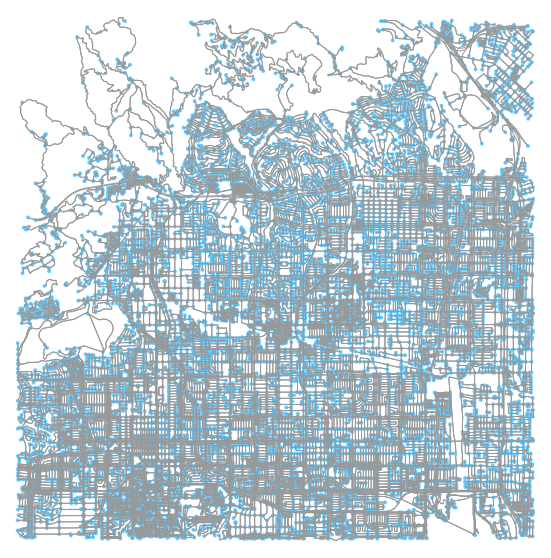

In [471]:
test.plot_map_extent()

In [478]:
for start_, end_ in list(test.G.edges()):
    test.G[start_][end_][0]['weight'] = (LA[start_][end_][0]['crime_risk']*test.safety) + test.G[start_][end_][0]['length']

KeyError: 95584344

In [492]:
# Start and end point
start = (34.218650, -118.633504)
end = (34.279100, -118.476180)
center = ((start[0]+end[0])/2, (start[1]+end[1])/2)

In [497]:
if start[0]<end[0]:
    s_edge = start[0] - (end[0]-start[0])*0.1
    n_edge = end[0] + (end[0]-start[0])*0.1
else:
    n_edge = start[0] + (start[0]-end[0])*0.1
    s_edge = end[0] - (start[0]-end[0])*0.1
if start[1]<end[1]:
    w_edge = start[1] - (end[1]-start[1])*0.1
    e_edge = end[1] + (end[1]-start[1])*0.1
else:
    e_edge = start[1] + (start[1]-end[1])*0.1
    w_edge = end[1] - (start[1]-end[1])*0.1 

    
bbox = (n_edge,s_edge,e_edge,w_edge)

print(bbox)

(34.285145, 34.212604999999996, -118.4604476, -118.6492364)


In [496]:
LA

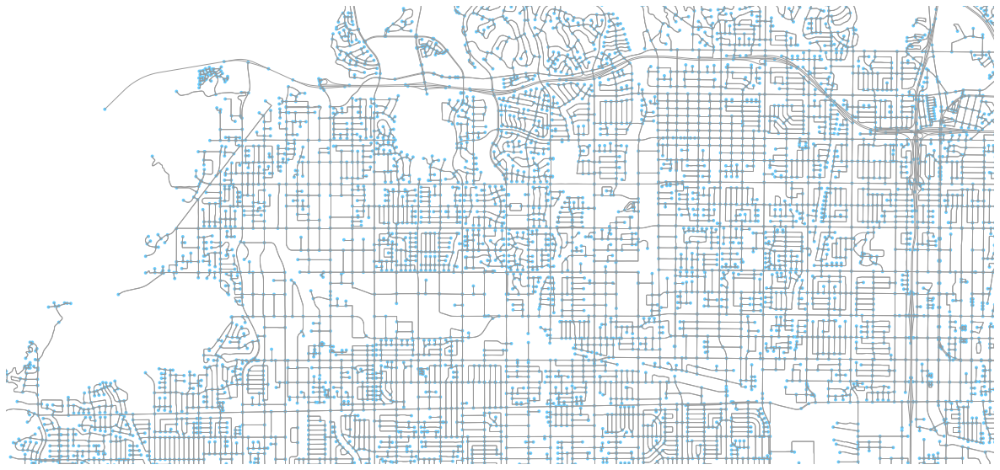

In [498]:
fig, ax = ox.plot_graph(LA, bbox=bbox, fig_height=10)
plt.show()

In [461]:
LA_network_weights[LA_network_weights['start_node'] == 3195076685]

,start_node,end_node,edge,edge_crime,start_crime_risk,end_crime_risk,mean_edge_weight


In [479]:
test_nodes = pd.DataFrame(list(test.G.nodes()))

In [462]:
LA_nodes = pd.DataFrame(list(LA.nodes()))

In [473]:
LA_nodes[LA_nodes[0] == 3195076685]

,0


In [480]:
test_nodes[test_nodes[0] == 95584344]

,0
40,95584344


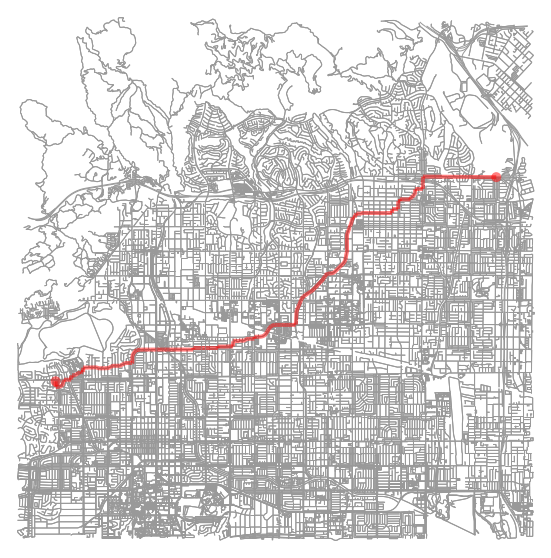

In [70]:
test.plot_shortest_route()

In [88]:
for node, distance in crime_nodes:  
    if distance>500:
        continue
    for start_, end_ in list(test.G.edges()):
        test.G[start_][end_][0]['weight'] = 1
        if (start_==node)|(end_==node):
            test.G[start_][end_][0]['weight'] += 1

In [89]:
for start_, end_ in list(test.G.edges()):
    test.G[start_][end_][0]['weight'] = (test.G[start_][end_][0]['weight']*test.safety) * test.G[start_][end_][0]['length']

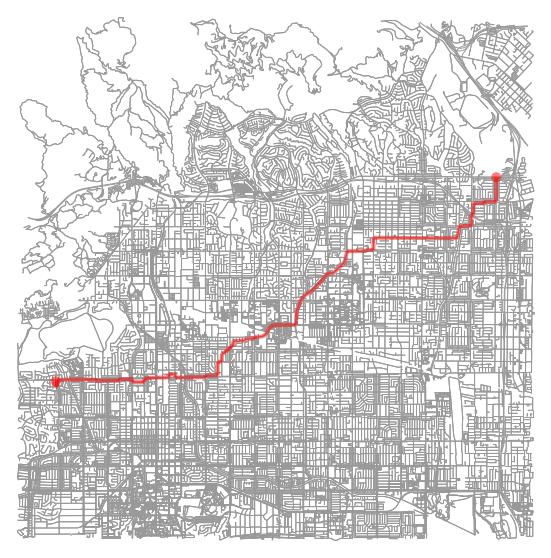

In [90]:
orig_node = ox.get_nearest_node(test.G, test.start)
dest_node = ox.get_nearest_node(test.G, test.end)

route = nx.shortest_path(test.G, 
                         orig_node, 
                         dest_node, 
                         weight='weight')
fig, ax = ox.plot_graph_route(test.G, route, node_size=0, fig_height=10)
plt.show()

<a id="appendix"></a>
## Appendix